</font> <font>Table of Contents</font> <font size="2">[Data Wrangling](#[Data_Wrangling])</font> <font size="2">[Feature Engineering](#[Feature_Engineering])</font> <font size="2">[Exploratory Data Analysis](#[Exploratory_Data_Analysis])</font> <font size="2">[Data Preprocessing](#[Data_Preprocessing])</font> <font size="2">[Modeling_1](#[Modeling_1])</font> <font size="2">[Modeling_2](#[Modeling_2])</font> <font size="2">[Modeling_Train_Results](#[Modeling_Train_Results])</font> <font size="2">[Modeling_Test_Results](#[Modeling_Test_Results])</font>

In [1]:
filename_version='3dot10'

In [2]:
import sys
source_directory = "/Users/pauljacob/Library/Python/3.8/lib/python/site-packages"

sys.path.append(source_directory)

In [3]:
#file structure
!pip3 install cookiecutter

#general
!pip3 install --upgrade pip
!pip3 install ipython-autotime --quiet


Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [4]:
%load_ext autotime

time: 318 µs (started: 2023-01-18 18:42:34 -08:00)


## Import Libraries

In [5]:
#get libraries
import pandas as pd
import os
import numpy as np
import itertools


#get visualization libraries
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
import matplotlib.patches as mpatches



#ML preprocessing
from sklearn.preprocessing import StandardScaler

#get ML functions
from sklearn.model_selection import train_test_split, cross_validate, cross_val_score, GridSearchCV, StratifiedKFold, learning_curve
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier


from sklearn import __version__ as sklearn_version
import datetime


#get ML metric functions
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score, log_loss, auc, brier_score_loss
from sklearn.metrics import roc_auc_score, roc_curve, precision_recall_curve, confusion_matrix, ConfusionMatrixDisplay, classification_report, brier_score_loss
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.metrics import log_loss

#get icr module and associated common functions
import in_vehicle_coupon_recommendation as icr
from in_vehicle_coupon_recommendation import p, rcp, rpp, rcr, sr, pl, pdc, save_and_return_data_frame, initialize_custom_notebook_settings

#sound alert
from IPython.display import Audio

time: 1.33 s (started: 2023-01-18 18:42:34 -08:00)


In [6]:
#initialize notebook
initialize_custom_notebook_settings()

%load_ext autoreload
%autoreload 1
%aimport in_vehicle_coupon_recommendation 


time: 20.4 ms (started: 2023-01-18 18:42:35 -08:00)


## Get In-Vehicle Coupon Recommendation Dataset

In [7]:
df = pd.read_csv(os.path.join('..', 'data', 'raw', 'in-vehicle-coupon-recommendation.csv'))
df = df.sample(frac=1, random_state=200)
#p(df)

time: 33 ms (started: 2023-01-18 18:42:35 -08:00)


<font size="5"><a id='[Data_Wrangling]'></a></font> <font>Table of Contents</font> <font size="2">[Data Wrangling](#[Data_Wrangling])</font> <font size="2">[Feature Engineering](#[Feature_Engineering])</font> <font size="2">[Exploratory Data Analysis](#[Exploratory_Data_Analysis])</font> <font size="2">[Data Preprocessing](#[Data_Preprocessing])</font>  <font size="2">[Modeling_1](#[Modeling_1])</font> <font size="2">[Modeling_2](#[Modeling_2])</font> <font size="2">[Modeling_Train_Results](#[Modeling_Train_Results])</font> <font size="2">[Modeling_Test_Results](#[Modeling_Test_Results])</font>

<font size="6"><a id='[Data_Wrangling]'>**Data Wrangling**</a> </font>

In [8]:
#rename 'passanger' and 'coupon' column
df = df.rename(columns={'passanger':'passenger', 'coupon':'coupon_venue_type'})


#decode string 'age' values to (explicit) string age ranges
column_name_age_value_list = list(df.loc[:, 'age'].unique())
column_name_age_value_list_cleaned_up = ['21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21']
column_name_age_value_dict = dict(zip(column_name_age_value_list, column_name_age_value_list_cleaned_up))
df.loc[:, 'age'] = df.loc[:, 'age'].replace(column_name_age_value_dict)

del column_name_age_value_dict, column_name_age_value_list, column_name_age_value_list_cleaned_up


#drop column 'toCoupon_GEQ5min' because all 1's
column_name_list_not_toCoupon_GEQ5min = [column_name for column_name in df.columns if column_name != 'toCoupon_GEQ5min']
df = df.loc[:, column_name_list_not_toCoupon_GEQ5min]

del column_name_list_not_toCoupon_GEQ5min


#rename values in columns 'Bar', 'CoffeeHouse', 'CarryAway', 'RestaurantLessThan20', and 'Restaurant20To50' to math language...
#get column name list for column values uniques that are the same as column name 'CarryAway' value uniques
column_name_list_same_unique_values = []
for column_name in df.columns:    
    value = icr.column_name_value_sets_equal(df, column_name1='CarryAway', column_name2=column_name)
    if value == 1:
        column_name_list_same_unique_values = column_name_list_same_unique_values + [column_name]
#rename values in columns 'Bar', 'CoffeeHouse', 'CarryAway', 'RestaurantLessThan20', and 'Restaurant20To50' to math language
column_name_Bar_value_list = list(df.loc[:, 'Bar'].unique())
column_name_Bar_value_list_cleaned_up = ['never', '<1', '1-3', '>8', np.nan, '4-8']
column_name_Bar_value_dict = dict(zip(column_name_Bar_value_list, column_name_Bar_value_list_cleaned_up))
df.loc[:, column_name_list_same_unique_values] = df.loc[:, column_name_list_same_unique_values].replace(column_name_Bar_value_dict)

del column_name_Bar_value_dict, column_name_Bar_value_list, column_name_Bar_value_list_cleaned_up, column_name_list_same_unique_values


#clean up columns 'direction_same' and 'direction_opp' to 'direction_same_or_opposite'
#drop column 'direction_same'
column_name_list_not_direction_same = [column_name for column_name in df.columns if column_name != 'direction_same']
df = df.loc[:, column_name_list_not_direction_same]

del column_name_list_not_direction_same

#rename 'direction_opp' to 'direction_same_or_opposite'
df = df.rename(columns={'direction_opp':'direction_same_or_opposite'})


#solution1: fill in missing values with 'no response' or 'unknown'
column_name_list = ['Bar', 'CoffeeHouse', 'CarryAway', 'RestaurantLessThan20', 'Restaurant20To50', 'car']
df.loc[:, column_name_list] = df.loc[:, column_name_list].fillna('no response')


#fix income values
income_list = df.loc[:, 'income'].drop_duplicates().to_list()
income_list_fixed = ['\$12500 - \$24999', '\$87500 - \$99999', '\$37500 - \$49999', '\$50000 - \$62499', '\$75000 - \$87499', '\$25000 - \$37499', '\$100000 or More', 'Less than \$12500', '\$62500 - \$74999']
income_dictionary = dict(zip(income_list, income_list_fixed))
df.loc[:, 'income'] = df.loc[:, 'income'].replace(income_dictionary)
p(df)



(12684, 24)


,destination,passenger,weather,temperature,time,coupon_venue_type,expiration,gender,age,maritalStatus,has_children,education,occupation,income,car,Bar,CoffeeHouse,CarryAway,RestaurantLessThan20,Restaurant20To50,toCoupon_GEQ15min,toCoupon_GEQ25min,direction_same_or_opposite,Y
11199,Home,Alone,Sunny,80,6PM,Carry out & Take away,2h,Male,21-25,Single,0,Bachelors degree,Student,\$12500 - \$24999,no response,never,no response,no response,no response,never,1,0,0,1
1474,Work,Alone,Sunny,55,7AM,Bar,1d,Male,46-49,Married partner,1,Graduate degree (Masters or Doctorate),Management,\$87500 - \$99999,no response,never,<1,<1,never,<1,1,1,1,0
10836,Home,Alone,Sunny,30,6PM,Carry out & Take away,1d,Male,26-30,Single,0,Some college - no degree,Sales & Related,\$37500 - \$49999,no response,<1,no response,>8,<1,never,0,0,1,1
4567,No Urgent Place,Alone,Sunny,80,10AM,Bar,1d,Female,21-25,Unmarried partner,0,Graduate degree (Masters or Doctorate),Education&Training&Library,\$37500 - \$49999,no response,1-3,<1,<1,<1,never,0,0,1,0
5658,No Urgent Place,Alone,Sunny,80,2PM,Restaurant(<20),2h,Female,31-35,Single,1,Bachelors degree,Production Occupations,\$37500 - \$49999,no response,never,never,>8,4-8,never,1,0,1,1
11343,Work,Alone,Sunny,80,7AM,Restaurant(20-50),2h,Female,36-40,Single,1,Bachelors degree,Food Preparation & Serving Related,\$12500 - \$24999,no response,1-3,<1,>8,never,never,0,0,0,0
9036,Home,Alone,Snowy,30,10PM,Restaurant(<20),2h,Male,26-30,Single,0,Some college - no degree,Student,\$12500 - \$24999,no response,<1,never,>8,never,1-3,1,1,1,0
11050,Home,Alone,Sunny,80,6PM,Restaurant(20-50),1d,Male,46-49,Single,0,Some college - no degree,Sales & Related,Less than \$12500,no response,<1,<1,>8,>8,>8,0,0,0,0
784,Work,Alone,Sunny,80,7AM,Carry out & Take away,2h,Female,21-25,Single,0,Graduate degree (Masters or Doctorate),Legal,\$25000 - \$37499,no response,<1,<1,<1,no response,<1,0,0,0,1
1818,No Urgent Place,Kid(s),Sunny,80,10AM,Bar,1d,Female,36-40,Married partner,1,Bachelors degree,Retired,\$50000 - \$62499,no response,1-3,never,>8,<1,never,1,0,1,0


time: 90 ms (started: 2023-01-18 18:42:35 -08:00)


### Store df_pre_feature_engineering from df

In [9]:
# df_pre_feature_engineering = df.copy()
# p(df_pre_feature_engineering)

time: 1.56 ms (started: 2023-01-18 18:42:35 -08:00)


In [10]:
column_name_list_scenario = ['destination', 'passenger', 'weather', 'temperature', 'time', 'coupon_venue_type', 'expiration', 
                             'toCoupon_GEQ15min', 'toCoupon_GEQ25min', 'direction_same_or_opposite']
pl(column_name_list_scenario)


10


['destination',
 'passenger',
 'weather',
 'temperature',
 'time',
 'coupon_venue_type',
 'expiration',
 'toCoupon_GEQ15min',
 'toCoupon_GEQ25min',
 'direction_same_or_opposite']

time: 2.53 ms (started: 2023-01-18 18:42:35 -08:00)


In [11]:
df.loc[:, column_name_list_scenario].drop_duplicates().shape

(201, 10)

time: 14.4 ms (started: 2023-01-18 18:42:35 -08:00)


In [12]:
df.loc[:, column_name_list_scenario].drop_duplicates() #there are plenty of combinations of sceanrios, what are the scenario counts??

#are some scenarios not represented and why???

,destination,passenger,weather,temperature,time,coupon_venue_type,expiration,toCoupon_GEQ15min,toCoupon_GEQ25min,direction_same_or_opposite
11199,Home,Alone,Sunny,80,6PM,Carry out & Take away,2h,1,0,0
1474,Work,Alone,Sunny,55,7AM,Bar,1d,1,1,1
10836,Home,Alone,Sunny,30,6PM,Carry out & Take away,1d,0,0,1
4567,No Urgent Place,Alone,Sunny,80,10AM,Bar,1d,0,0,1
5658,No Urgent Place,Alone,Sunny,80,2PM,Restaurant(<20),2h,1,0,1
431,No Urgent Place,Friend(s),Sunny,80,10AM,Coffee House,2h,0,0,1
11668,No Urgent Place,Partner,Rainy,55,6PM,Bar,2h,1,0,1
473,No Urgent Place,Alone,Sunny,55,2PM,Restaurant(<20),1d,0,0,1
4732,Home,Alone,Sunny,80,10PM,Restaurant(<20),2h,0,0,0
2323,No Urgent Place,Friend(s),Sunny,80,6PM,Restaurant(<20),2h,1,0,1


time: 41.4 ms (started: 2023-01-18 18:42:35 -08:00)


In [13]:
df.loc[:, column_name_list_scenario].value_counts() #yes, the most represented scenario is heading to Work, alone, sunny weather, 55 degrees, 7am, bar, 
#1 day til expiration, >25 minute away in the opposite drive direction of destination


destination      passenger  weather  temperature  time  coupon_venue_type      expiration  toCoupon_GEQ15min  toCoupon_GEQ25min  direction_same_or_opposite
Work             Alone      Sunny    55           7AM   Bar                    1d          1                  1                  1                             194
No Urgent Place  Friend(s)  Sunny    55           2PM   Carry out & Take away  1d          1                  0                  1                             181
                                     80           2PM   Coffee House           2h          1                  0                  1                             181
Work             Alone      Sunny    80           7AM   Carry out & Take away  2h          0                  0                  0                             181
No Urgent Place  Alone      Sunny    55           2PM   Restaurant(<20)        1d          0                  0                  1                             181
                 Friend(s)  S

time: 19.2 ms (started: 2023-01-18 18:42:35 -08:00)


In [14]:
#how many permutations is there?

#expiration is 2
#temperature is 3
#time is 5

#201


time: 1.18 ms (started: 2023-01-18 18:42:35 -08:00)


In [15]:
df.value_counts('expiration') #imbalance in the expiration date??? why???? how does this influence our analysis????

expiration
1d    7091
2h    5593
dtype: int64

time: 5.35 ms (started: 2023-01-18 18:42:35 -08:00)


In [16]:
7091 / (7091 + 5593)

0.5590507726269316

time: 2.84 ms (started: 2023-01-18 18:42:35 -08:00)


In [17]:
df.loc[:, column_name_list_scenario].drop_duplicates().value_counts('expiration')

expiration
1d    118
2h     83
dtype: int64

time: 12.9 ms (started: 2023-01-18 18:42:35 -08:00)


In [18]:
101 / (101 + 73)

0.5804597701149425

time: 2.75 ms (started: 2023-01-18 18:42:35 -08:00)


<font size="5"><a id='[Feature_Engineering]'></a></font> <font>Table of Contents</font> <font size="2">[Data Wrangling](#[Data_Wrangling])</font> <font size="2">[Feature Engineering](#[Feature_Engineering])</font> <font size="2">[Exploratory Data Analysis](#[Exploratory_Data_Analysis])</font> <font size="2">[Data Preprocessing](#[Data_Preprocessing])</font>  <font size="2">[Modeling_1](#[Modeling_1])</font> <font size="2">[Modeling_2](#[Modeling_2])</font> <font size="2">[Modeling_Train_Results](#[Modeling_Train_Results])</font> <font size="2">[Modeling_Test_Results](#[Modeling_Test_Results])</font>

<font size="6"><a id='[Feature_Engineering]'>**Feature Engineering**</a> </font>

## Get Category Representative Numeric Encoding for Features: expiration, time, age, income

In [19]:
#category representative numeric encoding: expiration, time, age, income

expiration_category_representative_numeric_encoding={'expiration':{'2h':2, '1d':24}}
time_category_representative_numeric_encoding={'time':{'7AM':7,'10AM':10, '2PM':14, '6PM':18, '10PM':22}}
age_category_representative_numeric_encoding={'age':{'<21':18, '21-25':23, '26-30':28, '31-35':33, '36-40':38, '41-45':43, '46-49':48, '50+':56}}
income_category_representative_numeric_encoding={'income':{'Less than \$12500':6250, '\$12500 - \$24999':18749.5, '\$25000 - \$37499':31249.5, '\$37500 - \$49999':43749.5, '\$50000 - \$62499':56249.5, '\$62500 - \$74999':68749.5, '\$75000 - \$87499':81249.5, '\$87500 - \$99999':93749.5,'\$100000 or More':150000}}

#combine category representative numeric encoding dictionaries
category_representative_numeric_encoding_dictionary = expiration_category_representative_numeric_encoding|time_category_representative_numeric_encoding|age_category_representative_numeric_encoding|income_category_representative_numeric_encoding

del expiration_category_representative_numeric_encoding, time_category_representative_numeric_encoding, age_category_representative_numeric_encoding, income_category_representative_numeric_encoding

category_representative_numeric_encoding_key_list = list(category_representative_numeric_encoding_dictionary.keys())

df_category_representative_numeric_encoding = df.loc[:, category_representative_numeric_encoding_key_list].replace(category_representative_numeric_encoding_dictionary)

del category_representative_numeric_encoding_dictionary, 

#rename columns
category_representative_numeric_encoding_substring='_category_representative_numeric_encoding'

column_name_list_category_representative_numeric_encoding = [str(column_name) + category_representative_numeric_encoding_substring for column_name in category_representative_numeric_encoding_key_list]

column_name_dictionary_category_representative_numeric_encoding = dict(zip(category_representative_numeric_encoding_key_list, column_name_list_category_representative_numeric_encoding))

df_category_representative_numeric_encoding = df_category_representative_numeric_encoding.rename(columns=column_name_dictionary_category_representative_numeric_encoding)

del column_name_dictionary_category_representative_numeric_encoding, column_name_list_category_representative_numeric_encoding, category_representative_numeric_encoding_key_list, category_representative_numeric_encoding_substring

#p(df_category_representative_numeric_encoding)

time: 30.8 ms (started: 2023-01-18 18:42:35 -08:00)


## Get Binary Encoding for Features: gender, expiration

In [20]:
#binary encoding: gender, expiration
gender_binary_encoding={'gender':{'Female':0, 'Male':1}}
expiration_binary_encoding={'expiration':{'2h':0, '1d':1}}

binary_encoding_dictionary = gender_binary_encoding|expiration_binary_encoding

del gender_binary_encoding, expiration_binary_encoding

binary_encoding_key_list = list(binary_encoding_dictionary.keys())

df_binary_encoding = df.loc[:, binary_encoding_key_list].replace(binary_encoding_dictionary)

del binary_encoding_dictionary


#rename columns
binary_encoding_substring = '_binary_encoding'
column_name_list_binary_encoding = [str(column_name) + binary_encoding_substring for column_name in binary_encoding_key_list]
column_name_dictionary_binary_encoding = dict(zip(binary_encoding_key_list, column_name_list_binary_encoding))
df_binary_encoding = df_binary_encoding.rename(columns=column_name_dictionary_binary_encoding)

del column_name_dictionary_binary_encoding, column_name_list_binary_encoding, binary_encoding_key_list, binary_encoding_substring

#p(df_binary_encoding)

time: 21.3 ms (started: 2023-01-18 18:42:36 -08:00)


## Get Ordinal Integer Encoding for Features: coupon_venue_type, education, income, age, time, temperature

In [21]:
#ordinal integer encoding: coupon_venue_type, education, income, age, time, temperature

#category ordinal features to ordinal integer encoding
coupon_venue_type_ordinal_integer_encoding={'coupon_venue_type':{'Coffee House':1, 'Bar':2, 'Carry out & Take away':3, 'Restaurant(<20)':4, 'Restaurant(20-50)':5}}
education_ordinal_integer_encoding={'education':{'Some High School':1, 'High School Graduate':2, 'Some college - no degree':3, 'Associates degree':4, 'Bachelors degree':5,'Graduate degree (Masters or Doctorate)':6}}
income_ordinal_integer_encoding={'income':{'Less than \$12500':1, '\$12500 - \$24999':2, '\$25000 - \$37499':3, '\$37500 - \$49999':4, '\$50000 - \$62499':5, '\$62500 - \$74999':6, '\$75000 - \$87499':7, '\$87500 - \$99999':8, '\$100000 or More':9}}
age_ordinal_integer_encoding={'age':{'<21':1, '21-25':2, '26-30':3, '31-35':4, '36-40':5, '41-45':6, '46-49':7, '50+':8}}
time_ordinal_integer_encoding={'time':{'7AM':1, '10AM':2, '2PM':3, '6PM':4, '10PM':5}}

#numeric to ordinal integer encoding
temperature_ordinal_integer_encoding={'temperature':{30:1, 55:2, 80:3}}


ordinal_integer_encoding_dictionary = coupon_venue_type_ordinal_integer_encoding|education_ordinal_integer_encoding|income_ordinal_integer_encoding|age_ordinal_integer_encoding|time_ordinal_integer_encoding|temperature_ordinal_integer_encoding

del coupon_venue_type_ordinal_integer_encoding, education_ordinal_integer_encoding, income_ordinal_integer_encoding, age_ordinal_integer_encoding, time_ordinal_integer_encoding, temperature_ordinal_integer_encoding

ordinal_integer_encoding_key_list = list(ordinal_integer_encoding_dictionary.keys())

df_ordinal_integer_encoding = df.loc[:, ordinal_integer_encoding_key_list].replace(ordinal_integer_encoding_dictionary)

del ordinal_integer_encoding_dictionary

#rename columns
ordinal_integer_encoding_substring='_ordinal_integer_encoding'
column_name_list_ordinal_integer_encoding=[str(column_name) + ordinal_integer_encoding_substring for column_name in ordinal_integer_encoding_key_list]
column_name_dictionary_ordinal_integer_encoding=dict(zip(ordinal_integer_encoding_key_list,column_name_list_ordinal_integer_encoding))
df_ordinal_integer_encoding=df_ordinal_integer_encoding.rename(columns=column_name_dictionary_ordinal_integer_encoding)

del column_name_dictionary_ordinal_integer_encoding, column_name_list_ordinal_integer_encoding, ordinal_integer_encoding_key_list, ordinal_integer_encoding_substring

#p(df_ordinal_integer_encoding)

time: 36.5 ms (started: 2023-01-18 18:42:36 -08:00)


## Get Venue Type Visits Per Month Yes Response to Ordinal Integer Encoding for Features: bar, coffeehouse, carryaway, restaurantlessthan20, restaurant20to50

In [22]:
#venue type visits per month yes response to ordinal integer encoding: bar, coffeehouse, carryaway, restaurantlessthan20, restaurant20to50
bar_venue_visit_frequency_yes_response_ordinal_integer_encoding={'Bar':{'never':1, '<1':2, '1-3':3, '4-8':4, '>8':5, 'no response':0}}
coffeehouse_venue_visit_frequency_yes_response_ordinal_integer_encoding={'CoffeeHouse':{'never':1, '<1':2, '1-3':3, '4-8':4, '>8':5, 'no response':0}}
carryaway_venue_visit_frequency_yes_response_ordinal_integer_encoding={'CarryAway':{'never':1, '<1':2, '1-3':3, '4-8':4, '>8':5, 'no response':0}}
restaurantlessthan20_venue_visit_frequency_yes_response_ordinal_integer_encoding={'RestaurantLessThan20':{'never':1, '<1':2, '1-3':3, '4-8':4, '>8':5, 'no response':0}}
restaurant20to50_venue_visit_frequency_yes_response_ordinal_integer_encoding={'Restaurant20To50':{'never':1, '<1':2, '1-3':3, '4-8':4, '>8':5, 'no response':0}}


venue_visit_frequency_yes_response_ordinal_integer_encoding_dictionary=bar_venue_visit_frequency_yes_response_ordinal_integer_encoding|coffeehouse_venue_visit_frequency_yes_response_ordinal_integer_encoding|carryaway_venue_visit_frequency_yes_response_ordinal_integer_encoding|restaurantlessthan20_venue_visit_frequency_yes_response_ordinal_integer_encoding|restaurant20to50_venue_visit_frequency_yes_response_ordinal_integer_encoding

del bar_venue_visit_frequency_yes_response_ordinal_integer_encoding, carryaway_venue_visit_frequency_yes_response_ordinal_integer_encoding, restaurantlessthan20_venue_visit_frequency_yes_response_ordinal_integer_encoding, restaurant20to50_venue_visit_frequency_yes_response_ordinal_integer_encoding
#del bar_venue_visit_frequency_yes_response_ordinal_integer_encoding, coffeehouse_venue_visit_frequency_yes_response_ordinal_integer_encoding, carryaway_venue_visit_frequency_yes_response_ordinal_integer_encoding, restaurantlessthan20_venue_visit_frequency_yes_response_ordinal_integer_encoding, restaurant20to50_venue_visit_frequency_yes_response_ordinal_integer_encoding

venue_visit_frequency_yes_response_ordinal_integer_encoding_key_list=list(venue_visit_frequency_yes_response_ordinal_integer_encoding_dictionary.keys())

df_venue_visit_frequency_yes_response_ordinal_integer_encoding = df.loc[:, venue_visit_frequency_yes_response_ordinal_integer_encoding_key_list].replace(venue_visit_frequency_yes_response_ordinal_integer_encoding_dictionary)

del venue_visit_frequency_yes_response_ordinal_integer_encoding_dictionary

#rename columns
venue_visit_frequency_yes_response_ordinal_integer_encoding_substring='_venue_visit_frequency_yes_response_ordinal_integer_encoding'
column_name_list_venue_visit_frequency_yes_response_ordinal_integer_encoding=[str(column_name) + venue_visit_frequency_yes_response_ordinal_integer_encoding_substring for column_name in venue_visit_frequency_yes_response_ordinal_integer_encoding_key_list]
column_name_dictionary_venue_visit_frequency_yes_response_ordinal_integer_encoding=dict(zip(venue_visit_frequency_yes_response_ordinal_integer_encoding_key_list, column_name_list_venue_visit_frequency_yes_response_ordinal_integer_encoding))
df_venue_visit_frequency_yes_response_ordinal_integer_encoding = df_venue_visit_frequency_yes_response_ordinal_integer_encoding.rename(columns=column_name_dictionary_venue_visit_frequency_yes_response_ordinal_integer_encoding)

del column_name_dictionary_venue_visit_frequency_yes_response_ordinal_integer_encoding, venue_visit_frequency_yes_response_ordinal_integer_encoding_key_list, venue_visit_frequency_yes_response_ordinal_integer_encoding_substring, column_name_list_venue_visit_frequency_yes_response_ordinal_integer_encoding

#p(df_venue_visit_frequency_yes_response_ordinal_integer_encoding)

time: 34.3 ms (started: 2023-01-18 18:42:36 -08:00)


## Get Venue Type Visits Per Month No Response to Indicator Variable for Features: bar, coffeehouse, carryaway, restaurantlessthan20, restaurant20to50

In [23]:
#venue type visits per month no response to indicator variable: bar, coffeehouse, carryaway, restaurantlessthan20, restaurant20to50
bar_venue_visit_frequency_no_response_indicator_variable={'Bar':{'never':0, '<1':0, '1-3':0, '4-8':0, '>8':0, 'no response':1}}
coffeehouse_venue_visit_frequency_no_response_indicator_variable={'CoffeeHouse':{'never':0, '<1':0, '1-3':0, '4-8':0, '>8':0, 'no response':1}}
carryaway_venue_visit_frequency_no_response_indicator_variable={'CarryAway':{'never':0, '<1':0, '1-3':0, '4-8':0, '>8':0, 'no response':1}}
restaurantlessthan20_venue_visit_frequency_no_response_indicator_variable={'RestaurantLessThan20':{'never':0, '<1':0, '1-3':0, '4-8':0, '>8':0, 'no response':1}}
restaurant20to50_venue_visit_frequency_no_response_indicator_variable={'Restaurant20To50':{'never':0, '<1':0, '1-3':0, '4-8':0, '>8':0, 'no response':1}}

venue_visit_frequency_no_response_indicator_variable_dictionary=bar_venue_visit_frequency_no_response_indicator_variable|coffeehouse_venue_visit_frequency_no_response_indicator_variable|carryaway_venue_visit_frequency_no_response_indicator_variable|restaurantlessthan20_venue_visit_frequency_no_response_indicator_variable|restaurant20to50_venue_visit_frequency_no_response_indicator_variable

del bar_venue_visit_frequency_no_response_indicator_variable, coffeehouse_venue_visit_frequency_no_response_indicator_variable, carryaway_venue_visit_frequency_no_response_indicator_variable, restaurantlessthan20_venue_visit_frequency_no_response_indicator_variable, restaurant20to50_venue_visit_frequency_no_response_indicator_variable

venue_visit_frequency_no_response_indicator_variable_key_list=list(venue_visit_frequency_no_response_indicator_variable_dictionary.keys())

df_venue_visit_frequency_no_response_indicator_variable=df.loc[:, venue_visit_frequency_no_response_indicator_variable_key_list].replace(venue_visit_frequency_no_response_indicator_variable_dictionary)

del venue_visit_frequency_no_response_indicator_variable_dictionary

#rename columns
venue_visit_frequency_no_response_indicator_variable='_venue_visit_frequency_no_response_indicator'
column_name_list_venue_visit_frequency_no_response_indicator_variable=[str(column_name) + venue_visit_frequency_no_response_indicator_variable for column_name in venue_visit_frequency_no_response_indicator_variable_key_list]
column_name_dictionary_venue_visit_frequency_no_response_indicator_variable=dict(zip(venue_visit_frequency_no_response_indicator_variable_key_list, column_name_list_venue_visit_frequency_no_response_indicator_variable))
df_venue_visit_frequency_no_response_indicator_variable=df_venue_visit_frequency_no_response_indicator_variable.rename(columns=column_name_dictionary_venue_visit_frequency_no_response_indicator_variable)

del column_name_dictionary_venue_visit_frequency_no_response_indicator_variable, column_name_list_venue_visit_frequency_no_response_indicator_variable, venue_visit_frequency_no_response_indicator_variable_key_list, venue_visit_frequency_no_response_indicator_variable

#p(df_venue_visit_frequency_no_response_indicator_variable)

time: 33.5 ms (started: 2023-01-18 18:42:36 -08:00)


In [24]:
df_venue_visit_frequency_no_response_indicator_variable

,Bar_venue_visit_frequency_no_response_indicator,CoffeeHouse_venue_visit_frequency_no_response_indicator,CarryAway_venue_visit_frequency_no_response_indicator,RestaurantLessThan20_venue_visit_frequency_no_response_indicator,Restaurant20To50_venue_visit_frequency_no_response_indicator
11199,0,1,1,1,0
1474,0,0,0,0,0
10836,0,1,0,0,0
4567,0,0,0,0,0
5658,0,0,0,0,0
...,...,...,...,...,...
11343,0,0,0,0,0
9036,0,0,0,0,0
11050,0,0,0,0,0
784,0,0,0,1,0


time: 5.3 ms (started: 2023-01-18 18:42:36 -08:00)


## Concatenate the Data Frames

In [25]:
#concatenate the data frames

#get data frame list
data_frame_list=[df, df_category_representative_numeric_encoding, df_binary_encoding, df_ordinal_integer_encoding, df_venue_visit_frequency_yes_response_ordinal_integer_encoding, df_venue_visit_frequency_no_response_indicator_variable]
del df_category_representative_numeric_encoding, df_binary_encoding, df_ordinal_integer_encoding, df_venue_visit_frequency_yes_response_ordinal_integer_encoding, df_venue_visit_frequency_no_response_indicator_variable

#concat data frames
df = pd.concat(data_frame_list, axis=1)
del data_frame_list

p(df)


(12684, 46)


,destination,passenger,weather,temperature,time,coupon_venue_type,expiration,gender,age,maritalStatus,has_children,education,occupation,income,car,Bar,CoffeeHouse,CarryAway,RestaurantLessThan20,Restaurant20To50,toCoupon_GEQ15min,toCoupon_GEQ25min,direction_same_or_opposite,Y,expiration_category_representative_numeric_encoding,time_category_representative_numeric_encoding,age_category_representative_numeric_encoding,income_category_representative_numeric_encoding,gender_binary_encoding,expiration_binary_encoding,coupon_venue_type_ordinal_integer_encoding,education_ordinal_integer_encoding,income_ordinal_integer_encoding,age_ordinal_integer_encoding,time_ordinal_integer_encoding,temperature_ordinal_integer_encoding,Bar_venue_visit_frequency_yes_response_ordinal_integer_encoding,CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding,CarryAway_venue_visit_frequency_yes_response_ordinal_integer_encoding,RestaurantLessThan20_venue_visit_frequency_yes_response_ordinal_integer_encoding,Restaurant20To50_venue_visit_frequency_yes_response_ordinal_integer_encoding,Bar_venue_visit_frequency_no_response_indicator,CoffeeHouse_venue_visit_frequency_no_response_indicator,CarryAway_venue_visit_frequency_no_response_indicator,RestaurantLessThan20_venue_visit_frequency_no_response_indicator,Restaurant20To50_venue_visit_frequency_no_response_indicator
11199,Home,Alone,Sunny,80,6PM,Carry out & Take away,2h,Male,21-25,Single,0,Bachelors degree,Student,\$12500 - \$24999,no response,never,no response,no response,no response,never,1,0,0,1,2,18,23,18749.5,1,0,3,5,2,2,4,3,1,0,0,0,1,0,1,1,1,0
1474,Work,Alone,Sunny,55,7AM,Bar,1d,Male,46-49,Married partner,1,Graduate degree (Masters or Doctorate),Management,\$87500 - \$99999,no response,never,<1,<1,never,<1,1,1,1,0,24,7,48,93749.5,1,1,2,6,8,7,1,2,1,2,2,1,2,0,0,0,0,0
10836,Home,Alone,Sunny,30,6PM,Carry out & Take away,1d,Male,26-30,Single,0,Some college - no degree,Sales & Related,\$37500 - \$49999,no response,<1,no response,>8,<1,never,0,0,1,1,24,18,28,43749.5,1,1,3,3,4,3,4,1,2,0,5,2,1,0,1,0,0,0
4567,No Urgent Place,Alone,Sunny,80,10AM,Bar,1d,Female,21-25,Unmarried partner,0,Graduate degree (Masters or Doctorate),Education&Training&Library,\$37500 - \$49999,no response,1-3,<1,<1,<1,never,0,0,1,0,24,10,23,43749.5,0,1,2,6,4,2,2,3,3,2,2,2,1,0,0,0,0,0
5658,No Urgent Place,Alone,Sunny,80,2PM,Restaurant(<20),2h,Female,31-35,Single,1,Bachelors degree,Production Occupations,\$37500 - \$49999,no response,never,never,>8,4-8,never,1,0,1,1,2,14,33,43749.5,0,0,4,5,4,4,3,3,1,1,5,4,1,0,0,0,0,0
11343,Work,Alone,Sunny,80,7AM,Restaurant(20-50),2h,Female,36-40,Single,1,Bachelors degree,Food Preparation & Serving Related,\$12500 - \$24999,no response,1-3,<1,>8,never,never,0,0,0,0,2,7,38,18749.5,0,0,5,5,2,5,1,3,3,2,5,1,1,0,0,0,0,0
9036,Home,Alone,Snowy,30,10PM,Restaurant(<20),2h,Male,26-30,Single,0,Some college - no degree,Student,\$12500 - \$24999,no response,<1,never,>8,never,1-3,1,1,1,0,2,22,28,18749.5,1,0,4,3,2,3,5,1,2,1,5,1,3,0,0,0,0,0
11050,Home,Alone,Sunny,80,6PM,Restaurant(20-50),1d,Male,46-49,Single,0,Some college - no degree,Sales & Related,Less than \$12500,no response,<1,<1,>8,>8,>8,0,0,0,0,24,18,48,6250.0,1,1,5,3,1,7,4,3,2,2,5,5,5,0,0,0,0,0
784,Work,Alone,Sunny,80,7AM,Carry out & Take away,2h,Female,21-25,Single,0,Graduate degree (Masters or Doctorate),Legal,\$25000 - \$37499,no response,<1,<1,<1,no response,<1,0,0,0,1,2,7,23,31249.5,0,0,3,6,3,2,1,3,2,2,2,0,2,0,0,0,1,0
1818,No Urgent Place,Kid(s),Sunny,80,10AM,Bar,1d,Female,36-40,Married partner,1,Bachelors degree,Retired,\$50000 - \$62499,no response,1-3,never,>8,<1,never,1,0,1,0,24,10,38,56249.5,0,1,2,5,5,5,2,3,3,1,5,2,1,0,0,0,0,0


time: 22.3 ms (started: 2023-01-18 18:42:36 -08:00)


<font size="5"><a id='[Exploratory_Data_Analysis]'></a></font> <font>Table of Contents</font> <font size="2">[Data Wrangling](#[Data_Wrangling])</font> <font size="2">[Feature Engineering](#[Feature_Engineering])</font> <font size="2">[Exploratory Data Analysis](#[Exploratory_Data_Analysis])</font> <font size="2">[Data Preprocessing](#[Data_Preprocessing])</font>  <font size="2">[Modeling_1](#[Modeling_1])</font> <font size="2">[Modeling_2](#[Modeling_2])</font> <font size="2">[Modeling_Train_Results](#[Modeling_Train_Results])</font> <font size="2">[Modeling_Test_Results](#[Modeling_Test_Results])</font>

<font size="6"><a id='[Exploratory_Data_Analysis]'>**Exploratory Data Analysis**</a> </font>

In [26]:
column_name_list_all = \
['destination',
 'passenger',
 'weather',
 'temperature',
 'time',
 'coupon_venue_type',
 'expiration',
 'gender',
 'age',
 'maritalStatus',
 'has_children',
 'education',
 'occupation',
 'income',
 'car',
 'Bar',
 'CoffeeHouse',
 'CarryAway',
 'RestaurantLessThan20',
 'Restaurant20To50',
 'toCoupon_GEQ15min',
 'toCoupon_GEQ25min',
 'direction_same_or_opposite',
 'Y',
 'expiration_category_representative_numeric_encoding',
 'time_category_representative_numeric_encoding',
 'age_category_representative_numeric_encoding',
 'income_category_representative_numeric_encoding',
 'gender_binary_encoding',
 'expiration_binary_encoding',
 'coupon_venue_type_ordinal_integer_encoding',
 'education_ordinal_integer_encoding',
 'income_ordinal_integer_encoding',
 'age_ordinal_integer_encoding',
 'time_ordinal_integer_encoding',
 'temperature_ordinal_integer_encoding',
 'Bar_venue_visit_frequency_yes_response_ordinal_integer_encoding',
 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding',
 'CarryAway_venue_visit_frequency_yes_response_ordinal_integer_encoding',
 'RestaurantLessThan20_venue_visit_frequency_yes_response_ordinal_integer_encoding',
 'Restaurant20To50_venue_visit_frequency_yes_response_ordinal_integer_encoding',
 'Bar_venue_visit_frequency_no_response_indicator',
 'CoffeeHouse_venue_visit_frequency_no_response_indicator',
 'CarryAway_venue_visit_frequency_no_response_indicator',
 'RestaurantLessThan20_venue_visit_frequency_no_response_indicator',
 'Restaurant20To50_venue_visit_frequency_no_response_indicator']

column_name_list_graphed = ['Y','income', 'expiration', 'gender', 'has_children', 'toCoupon_GEQ15min', 'toCoupon_GEQ25min', 
                            'destination', 'passenger', 'weather', 'time', 'coupon_venue_type', 'age', 'maritalStatus', 'education', 'occupation',
                            'Bar_venue_visit_frequency_yes_response_ordinal_integer_encoding',
                            'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding',
                            'CarryAway_venue_visit_frequency_yes_response_ordinal_integer_encoding',
                            'RestaurantLessThan20_venue_visit_frequency_yes_response_ordinal_integer_encoding',
                            'Restaurant20To50_venue_visit_frequency_yes_response_ordinal_integer_encoding',
                            'temperature_ordinal_integer_encoding']

column_name_list_redundant_like = ['temperature', 'Bar', 'CoffeeHouse', 'CarryAway', 'RestaurantLessThan20', 'Restaurant20To50', 
                                   'expiration_category_representative_numeric_encoding', 'time_category_representative_numeric_encoding', 
                                   'expiration_category_representative_numeric_encoding', 'age_category_representative_numeric_encoding', 
                                   'income_category_representative_numeric_encoding', 'gender_binary_encoding', 'expiration_binary_encoding', 
                                   'coupon_venue_type_ordinal_integer_encoding', 'education_ordinal_integer_encoding', 'income_ordinal_integer_encoding', 
                                   'age_ordinal_integer_encoding', 'time_ordinal_integer_encoding', 'Bar_venue_visit_frequency_no_response_indicator',
                                   'CoffeeHouse_venue_visit_frequency_no_response_indicator', 'CarryAway_venue_visit_frequency_no_response_indicator',
                                   'RestaurantLessThan20_venue_visit_frequency_no_response_indicator', 
                                   'Restaurant20To50_venue_visit_frequency_no_response_indicator']

column_name_list_remaining = [column_name for column_name in column_name_list_all if not column_name in column_name_list_graphed+column_name_list_redundant_like]
pl(column_name_list_remaining)


2


['car', 'direction_same_or_opposite']

time: 4.89 ms (started: 2023-01-18 18:42:36 -08:00)


#### Initialize Variables

In [27]:
color_list = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6']


time: 535 µs (started: 2023-01-18 18:42:36 -08:00)


#### Coupon Accepted Percentage and Frequency Distribution (Vertical Bar Plot)

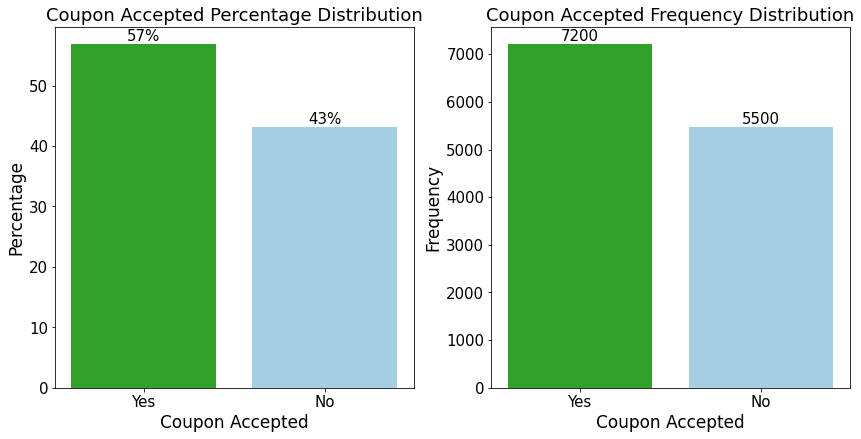

time: 389 ms (started: 2023-01-18 18:42:36 -08:00)


In [28]:
bar_orientation='vertical'
dpi=100
figure_filename = '../reports/figures/figure_coupon_accepted_percentage_and_frequency_distribution_'+ str(bar_orientation) + '_bar_plot_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'
figure_filename_axes1 = '../reports/figures/figure_coupon_accepted_percentage_and_frequency_distribution_'+ str(bar_orientation) + '_bar_plot_axes1_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'
figure_filename_axes2 = '../reports/figures/figure_coupon_accepted_percentage_and_frequency_distribution_'+ str(bar_orientation) + '_bar_plot_axes2_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

plot_save_together_separate = 'together'

figsize=(12, 6.2)
bar_width=0.8

xlabel = 'Coupon Accepted'
ylabel = 'Percentage'
title = 'Coupon Accepted '+ str(ylabel) + ' Distribution'

target_value_dictionary = {1: 'Yes', 0:'No'}

df_Y_frequency = df.loc[:, ['Y']].value_counts().reset_index().rename(columns={0:'frequency'})
df_Y_frequency.loc[:, 'percentage'] = df_Y_frequency.loc[:, 'frequency'] / df_Y_frequency.loc[:, 'frequency'].sum(axis=0) * 100
df_Y_frequency_percentage = df_Y_frequency
del df_Y_frequency

x_label_list = df_Y_frequency_percentage.loc[:, 'Y'].replace(target_value_dictionary).to_list()


if plot_save_together_separate == 'together':
    figure, (axes1, axes2) = plt.subplots(nrows=1, ncols=2, figsize=figsize)
elif plot_save_together_separate == 'separate':
    figure1, axes1 = plt.subplots(nrows=1, ncols=1, figsize=figsize)
    figure2, axes2 = plt.subplots(nrows=1, ncols=1, figsize=figsize)
    

#make percentage subplot
annotation_round_by_number = 0

percentage_list = df_Y_frequency_percentage.loc[:, 'percentage'].to_list()

axes1.bar(x=x_label_list, height=percentage_list, width=bar_width, color=[color_list[3], color_list[0]])

axes1.set_title(label=title, fontsize=18)
axes1.set_xlabel(xlabel=xlabel, fontsize=17)
axes1.set_ylabel(ylabel=ylabel, fontsize=17)
axes1.tick_params(axis='both', which='major', labelsize=15)

for rectangle, annotation in zip(axes1.patches, percentage_list):
    axes1.text(rectangle.get_x() + rectangle.get_width() / 2, rectangle.get_height(), format(round(annotation, annotation_round_by_number), '.0f') + '%', ha="center", va="bottom", fontsize=15)

#make frequency subplot
ylabel = 'Frequency'
title = 'Coupon Accepted '+ str(ylabel) + ' Distribution'
annotation_round_by_number = -2

frequency_list = df_Y_frequency_percentage.loc[:, 'frequency'].to_list()

axes2.bar(x=x_label_list, height=frequency_list, width=bar_width, color=[color_list[3], color_list[0]])

axes2.set_title(label=title, fontsize=18)
axes2.set_xlabel(xlabel=xlabel, fontsize=17)
axes2.set_ylabel(ylabel=ylabel, fontsize=17)
axes2.tick_params(axis='both', which='major', labelsize=15)

for rectangle, annotation in zip(axes2.patches, frequency_list):
    axes2.text(rectangle.get_x() + rectangle.get_width() / 2, rectangle.get_height() + 5, round(annotation, annotation_round_by_number), ha="center", va="bottom", fontsize=15)

plt.tight_layout()

if plot_save_together_separate == 'together':
    figure.savefig(figure_filename, bbox_inches='tight', dpi=dpi)
elif plot_save_together_separate == 'separate':
    figure1.savefig(figure_filename_axes1, bbox_inches='tight', dpi=dpi)
    figure2.savefig(figure_filename_axes2, bbox_inches='tight', dpi=dpi)


plt.show()

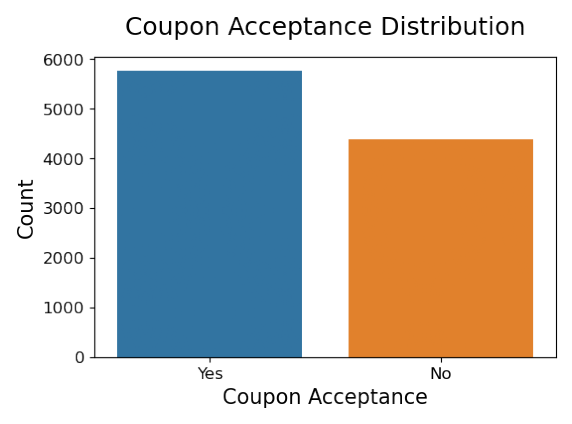

time: 72.5 ms (started: 2023-01-18 18:42:36 -08:00)


In [29]:
dpi=100
figure_filename = '../reports/figures/figure_target_variable_bar_plot_v3_dpi_' + str(dpi) + '_v' + filename_version + '.png'

figure_filename_exists = os.path.isfile(figure_filename)
if figure_filename_exists == True:
    img = mpimg.imread(figure_filename)
    plt.figure(figsize=(10, 8))
    plt.grid(False)
    plt.axis('off')
    plt.imshow(img)

else:
    #get Y_train data
    _, _, Y_train_plot, _ = train_test_split(df.drop(columns=['Y']), df.loc[:, 'Y'], test_size=.2, random_state=200)

    #get Y_train coupon accepted and not accepted count
    df_target_plot = Y_train_plot.replace({0:'No', 1:'Yes'}).value_counts().to_frame().reset_index().rename(columns={'index':'accepted_not_accepted','Y':'count'})

    axes_object = sns.barplot(data=df_target_plot, x='accepted_not_accepted', y='count')
    axes_object.set_title('Coupon Acceptance Distribution', fontdict={'fontsize':18}, pad=16)
    #axes_object.set(xlabel='Coupon Acceptance', ylabel='Count')
    plt.xlabel('Coupon Acceptance', fontsize=15)
    plt.ylabel('Count', fontsize=15)
    plt.tick_params(labelsize=12)



    #save it
    plt.savefig(figure_filename, bbox_inches='tight', dpi=dpi)
    
plt.show()

In [30]:
#sample size, population size, margin of error, confidence interval

#intialize parameters
z_score = 1.96; confidence_interval = .95

p_value = 0.5684326710816777
margin_of_error = .0381
N_population_size = 2.4 * 10**8

#known 652 surveys accepted, https://jmlr.org/papers/volume18/16-003/16-003.pdf

#calculate sample size
sample_size = (z_score**2*p_value*(1-p_value)/margin_of_error**2)/(1+(z_score**2*p_value*(1-p_value)/margin_of_error**2/N_population_size))
print('Sample size ' + str(round(sample_size)) + ' for a '+ str(round(confidence_interval*100, None)) +'% confidence interval, margin or error ' \
      + str(margin_of_error) + ', population size ' + str(round(N_population_size)) + ', p-value ' + str(round(p_value, 5))
      + ' is less than known 652 surveys.\n')

round_by_number = None
print('Therefore, '+ str(round(confidence_interval*100, None)) +'% of the time, we expect a coupon acceptance rate between ' \
      + str(round((p_value-margin_of_error/2)*100, round_by_number)) + '% and ' \
      + str(round((p_value+margin_of_error/2)*100, round_by_number)) + '%')

Sample size 649 for a 95% confidence interval, margin or error 0.0381, population size 240000000, p-value 0.56843 is less than known 652 surveys.

Therefore, 95% of the time, we expect a coupon acceptance rate between 55% and 59%
time: 2.1 ms (started: 2023-01-18 18:42:36 -08:00)


In [31]:
#sample size, population size, margin of error, confidence interval

#intialize parameters
z_score = 1.645; confidence_interval = .90

p_value = 0.5684326710816777
margin_of_error = .032
N_population_size = 2.4 * 10**8

#known 652 surveys accepted, https://jmlr.org/papers/volume18/16-003/16-003.pdf

#calculate sample size
sample_size = (z_score**2*p_value*(1-p_value)/margin_of_error**2)/(1+(z_score**2*p_value*(1-p_value)/margin_of_error**2/N_population_size))
print('Sample size ' + str(round(sample_size)) + ' for a '+ str(round(confidence_interval*100, None)) +'% confidence interval, margin or error ' \
      + str(margin_of_error) + ', population size ' + str(round(N_population_size)) + ', p-value ' + str(round(p_value, 5))
      + ' is less than known 652 surveys.\n')

round_by_number = None
print('Therefore, '+ str(round(confidence_interval*100, None)) + '% of the time, we expect a coupon acceptance rate between ' \
      + str(round((p_value-margin_of_error/2)*100, round_by_number)) + '% and ' \
      + str(round((p_value+margin_of_error/2)*100, round_by_number)) + '%')


Sample size 648 for a 90% confidence interval, margin or error 0.032, population size 240000000, p-value 0.56843 is less than known 652 surveys.

Therefore, 90% of the time, we expect a coupon acceptance rate between 55% and 58%
time: 1.87 ms (started: 2023-01-18 18:42:36 -08:00)


In [32]:
#survey coupon acceptance rate
df_Y_proportion = (df.groupby(['Y'])['Y'].agg('count') / df.shape[0])
df_Y_proportion[1]

0.5684326710816777

time: 2.99 ms (started: 2023-01-18 18:42:36 -08:00)


#### Coupon Acceptance Rate Per Feature Value Combination

In [33]:
#age, income, coffee house visit frequency --> coupon acceptace rate
df.loc[df.loc[:, 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'].isin([2, 5]) &
       df.loc[:, 'age'].isin(['21-25', '26-30', '50+']) &
       df.loc[:, 'income'].isin(['\\$50000 - \\$62499']), :]

,destination,passenger,weather,temperature,time,coupon_venue_type,expiration,gender,age,maritalStatus,has_children,education,occupation,income,car,Bar,CoffeeHouse,CarryAway,RestaurantLessThan20,Restaurant20To50,toCoupon_GEQ15min,toCoupon_GEQ25min,direction_same_or_opposite,Y,expiration_category_representative_numeric_encoding,time_category_representative_numeric_encoding,age_category_representative_numeric_encoding,income_category_representative_numeric_encoding,gender_binary_encoding,expiration_binary_encoding,coupon_venue_type_ordinal_integer_encoding,education_ordinal_integer_encoding,income_ordinal_integer_encoding,age_ordinal_integer_encoding,time_ordinal_integer_encoding,temperature_ordinal_integer_encoding,Bar_venue_visit_frequency_yes_response_ordinal_integer_encoding,CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding,CarryAway_venue_visit_frequency_yes_response_ordinal_integer_encoding,RestaurantLessThan20_venue_visit_frequency_yes_response_ordinal_integer_encoding,Restaurant20To50_venue_visit_frequency_yes_response_ordinal_integer_encoding,Bar_venue_visit_frequency_no_response_indicator,CoffeeHouse_venue_visit_frequency_no_response_indicator,CarryAway_venue_visit_frequency_no_response_indicator,RestaurantLessThan20_venue_visit_frequency_no_response_indicator,Restaurant20To50_venue_visit_frequency_no_response_indicator
431,No Urgent Place,Friend(s),Sunny,80,10AM,Coffee House,2h,Male,21-25,Single,0,Bachelors degree,Computer & Mathematical,\$50000 - \$62499,no response,1-3,<1,<1,never,never,0,0,1,1,2,10,23,56249.5,1,0,1,5,5,2,2,3,3,2,2,1,1,0,0,0,0,0
5743,No Urgent Place,Friend(s),Sunny,80,2PM,Restaurant(<20),2h,Male,21-25,Married partner,1,Some college - no degree,Computer & Mathematical,\$50000 - \$62499,no response,1-3,<1,<1,never,<1,1,0,1,1,2,14,23,56249.5,1,0,4,3,5,2,3,3,3,2,2,1,2,0,0,0,0,0
5395,No Urgent Place,Friend(s),Sunny,55,2PM,Coffee House,1d,Female,21-25,Unmarried partner,0,Bachelors degree,Education&Training&Library,\$50000 - \$62499,no response,<1,<1,<1,<1,<1,0,0,1,1,24,14,23,56249.5,0,1,1,5,5,2,3,2,2,2,2,2,2,0,0,0,0,0
1354,No Urgent Place,Partner,Sunny,80,10AM,Coffee House,2h,Male,21-25,Unmarried partner,0,Some college - no degree,Sales & Related,\$50000 - \$62499,no response,<1,>8,no response,<1,<1,0,0,1,1,2,10,23,56249.5,1,0,1,3,5,2,2,3,2,5,0,2,2,0,0,1,0,0
1362,Home,Alone,Sunny,80,6PM,Coffee House,2h,Male,21-25,Unmarried partner,0,Some college - no degree,Sales & Related,\$50000 - \$62499,no response,<1,>8,no response,<1,<1,0,0,1,1,2,18,23,56249.5,1,0,1,3,5,2,4,3,2,5,0,2,2,0,0,1,0,0
8582,Work,Alone,Sunny,80,7AM,Restaurant(<20),1d,Female,26-30,Married partner,1,Associates degree,Unemployed,\$50000 - \$62499,no response,1-3,<1,<1,<1,<1,0,0,0,1,24,7,28,56249.5,0,1,4,4,5,3,1,3,3,2,2,2,2,0,0,0,0,0
1352,No Urgent Place,Friend(s),Sunny,80,6PM,Restaurant(<20),2h,Male,21-25,Unmarried partner,0,Some college - no degree,Sales & Related,\$50000 - \$62499,no response,<1,>8,no response,<1,<1,1,0,1,1,2,18,23,56249.5,1,0,4,3,5,2,4,3,2,5,0,2,2,0,0,1,0,0
2810,No Urgent Place,Friend(s),Sunny,55,2PM,Coffee House,2h,Male,50+,Single,0,Some college - no degree,Student,\$50000 - \$62499,no response,1-3,<1,>8,>8,never,0,0,1,1,2,14,56,56249.5,1,0,1,3,5,8,3,2,3,2,5,5,1,0,0,0,0,0
2812,No Urgent Place,Alone,Sunny,55,10AM,Coffee House,2h,Male,50+,Single,0,Some college - no degree,Student,\$50000 - \$62499,no response,1-3,<1,>8,>8,never,0,0,1,1,2,10,56,56249.5,1,0,1,3,5,8,2,2,3,2,5,5,1,0,0,0,0,0
11371,No Urgent Place,Friend(s),Sunny,30,10AM,Carry out & Take away,2h,Female,26-30,Married partner,1,Associates degree,Unemployed,\$50000 - \$62499,no response,1-3,<1,<1,<1,<1,0,0,1,1,2,10,28,56249.5,0,0,3,4,5,3,2,1,3,2,2,2,2,0,0,0,0,0


time: 185 ms (started: 2023-01-18 18:42:36 -08:00)


In [34]:
age_list = ['21-25', '26-30', '50+']
coffee_house_monthly_visit_frequency_encoding_list = [2]
income_list = ['\\$50000 - \\$62499']

df.loc[df.loc[:, 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'].isin(coffee_house_monthly_visit_frequency_encoding_list) &
       df.loc[:, 'age'].isin(age_list) &
       df.loc[:, 'income'].isin(income_list), :].value_counts('Y')[1] / \
df.loc[df.loc[:, 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'].isin(coffee_house_monthly_visit_frequency_encoding_list) &
       df.loc[:, 'age'].isin(age_list) &
       df.loc[:, 'income'].isin(income_list), :].shape[0]



0.6753246753246753

time: 6 ms (started: 2023-01-18 18:42:36 -08:00)


In [35]:
age_list = ['21-25', '26-30', '50+']
coffee_house_monthly_visit_frequency_encoding_list = [2,5]
income_list = ['\\$50000 - \\$62499']


df_filtered = \
df.loc[df.loc[:, 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'].isin(coffee_house_monthly_visit_frequency_encoding_list) &
       df.loc[:, 'age'].isin(age_list) &
       df.loc[:, 'income'].isin(income_list), :]

number_of_coupons_accepted = df_filtered.value_counts('Y')[1]
print(number_of_coupons_accepted)
number_of_coupons_recommended = df_filtered.shape[0]
print(number_of_coupons_recommended)

coupon_acceptance_rate = number_of_coupons_accepted/number_of_coupons_recommended
print(coupon_acceptance_rate)

print(number_of_coupons_recommended)



255
374
0.6818181818181818
374
time: 3.95 ms (started: 2023-01-18 18:42:36 -08:00)


In [36]:
#^--- our model does something similar but it actually models better for coupon acceptance rate. likely because it's a better model, 
#     but also because it uses more features


#it's less about narrowing down by demogrpahics and more about coupon acceptance rate (i.e. conversion rate) then???

#run a final model with the least number of features??





time: 438 µs (started: 2023-01-18 18:42:36 -08:00)


In [37]:
income_list = ['\\$62500 - \\$74999', '\\$75000 - \\$87499', '\\$87500 - \\$99999']
age_list = ['<21', '31-35', '36-40', '41-45', '46-49'] #
coffee_house_monthly_visit_frequency_encoding_list = [3, 4, 1, 0] #0

df_filtered = \
df.loc[~df.loc[:, 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'].isin(coffee_house_monthly_visit_frequency_encoding_list) &
       ~df.loc[:, 'age'].isin(age_list) &
       ~df.loc[:, 'income'].isin(income_list), :]

number_of_coupons_accepted = df_filtered.value_counts('Y')[1]
print(number_of_coupons_accepted)
number_of_coupons_recommended = df_filtered.shape[0]
print(number_of_coupons_recommended)

coupon_acceptance_rate = number_of_coupons_accepted/number_of_coupons_recommended
print(coupon_acceptance_rate)

print(number_of_coupons_recommended)



1400
2064
0.6782945736434108
2064
time: 4.72 ms (started: 2023-01-18 18:42:36 -08:00)


In [38]:
income_list = ['\\$62500 - \\$74999', '\\$75000 - \\$87499', '\\$87500 - \\$99999']
age_list = ['<21', '31-35', '36-40', '41-45', '46-49']
coffee_house_monthly_visit_frequency_encoding_list = [3, 4, 1, 0] #0

number_of_coupon_accepted = \
df.loc[~df.loc[:, 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'].isin(coffee_house_monthly_visit_frequency_encoding_list) &
       ~df.loc[:, 'age'].isin(age_list) &
       ~df.loc[:, 'income'].isin(income_list), :].value_counts('Y')[1]
number_of_rows = \
df.loc[~df.loc[:, 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'].isin(coffee_house_monthly_visit_frequency_encoding_list) &
       ~df.loc[:, 'age'].isin(age_list) &
       ~df.loc[:, 'income'].isin(income_list), :].shape[0]

print(str(number_of_coupon_accepted/number_of_rows))

print(df.loc[~df.loc[:, 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'].isin(coffee_house_monthly_visit_frequency_encoding_list) &
       ~df.loc[:, 'age'].isin(age_list) &
       ~df.loc[:, 'income'].isin(income_list), :].shape[0])



0.6782945736434108
2064
time: 9.49 ms (started: 2023-01-18 18:42:36 -08:00)


In [ ]:
#faster filtering and check method???

    #check for higher conversion rates per feature first???
    
    #use only high conversion rate feature values???
    
    #filter by only high conversion rate feature values instead of all???
    
    
    

In [ ]:
#faster filtering and check method???

    #check for higher conversion rates per feature first and on less features, e.g. 2
    
    #2 features better than 3, it will be easier to explain and not give off an ooo duh!??!! <--- more general sounds better
    
    #use only high conversion rate feature values???
    
    #filter by only high conversion rate feature values instead of all???
    
    

In [ ]:
#V--- inefficient and not good use of time...permission to run on secondary compute

In [49]:
first_index, second_index = 7,8

feature_column_name_value_combination_tuple_list_collection={}



def get_value_combination_tuples_by_data_frame_and_feature_column_name(df, feature_column_name):
    
    def get_combinations_of_value_list(value_list):
        return [combination for combination_length in range(1, len(value_list) + 1) for combination in itertools.combinations(value_list, combination_length) ]

    feature_column_name_value_list=df.loc[:, feature_column_name].drop_duplicates().to_list()

    feature_column_name_value_list_combinations=get_combinations_of_value_list(value_list=feature_column_name_value_list)
    
    return feature_column_name_value_list_combinations


# get and add to collection coffee house venue visit frequency yes response ordinal encoding value combination tuple list
feature_column_name='CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'
feature_column_name_value_combination_tuple_list_collection[feature_column_name]=\
get_value_combination_tuples_by_data_frame_and_feature_column_name(df=df, feature_column_name=feature_column_name)[first_index:second_index]


# get and add to collection age value list combinations
feature_column_name='age'
feature_column_name_value_combination_tuple_list_collection[feature_column_name]=\
get_value_combination_tuples_by_data_frame_and_feature_column_name(df=df, feature_column_name=feature_column_name)


# get and add to collection income value combination tuple list
feature_column_name='income'
feature_column_name_value_combination_tuple_list_collection[feature_column_name]=\
get_value_combination_tuples_by_data_frame_and_feature_column_name(df=df, feature_column_name=feature_column_name)




feature_column_name_list=['CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding', 'age', 'income']

def get_and_save_three_feature_column_name_survey_metrics(feature_column_name_list, feature_column_name_value_combination_tuple_list_collection):
    
    df_survey_metrics_collection={}
    column_name_list=feature_column_name_list+['Acceptance Rate', 'Refusal Rate', 'Coupons Accepted', 'Coupons Refused', 'Coupon Recommended']

    for feature_0_column_name_value_combination_tuple in feature_column_name_value_combination_tuple_list_collection[feature_column_name_list[0]]:

        filename='df_feature_0_column_name_value_combination_tuple_'+str(feature_0_column_name_value_combination_tuple).replace(' ', '_')+'_'+filename_version+'.pkl'   
        value_metric_list_list=[]

        for feature_1_column_name_value_combination_tuple in feature_column_name_value_combination_tuple_list_collection[feature_column_name_list[1]]:
            for feature_2_column_name_value_combination_tuple in feature_column_name_value_combination_tuple_list_collection[feature_column_name_list[2]]:


                value_metric_list=[]

                #filter target variable by feature column name value combination tuple
                df_Y_filtered=df.loc[df.loc[:, feature_column_name_list[0]].isin(feature_0_column_name_value_combination_tuple) & 
                                     df.loc[:, feature_column_name_list[1]].isin(feature_1_column_name_value_combination_tuple) &
                                     df.loc[:, feature_column_name_list[2]].isin(feature_2_column_name_value_combination_tuple), ['Y']]

                if df_Y_filtered.empty == False:

                    #get target variable unique value list
                    target_variable_value_unique_list=list(df_Y_filtered.loc[:, 'Y'].unique())

                    #initialize booleans coupon acceptance exists and coupon refusal exists
                    coupon_acceptance_exists=True if 1 in target_variable_value_unique_list else False
                    coupon_refusal_exists=True if 0 in target_variable_value_unique_list else False

                    #initialize coupons recommended, coupons acceptance/refusal count, coupons acceptance/refusal proportion
                    coupons_recommended=df_Y_filtered.shape[0]
                    df_Y_filtered_value_counts=df_Y_filtered.value_counts()
                    df_Y_filtered_value_counts_normalized=df_Y_filtered_value_counts/coupons_recommended


                    #add each feature column name value combination tuple 
                    #get and add coupon acceptance rate
                    #get and add coupon refusal rate
                    #get and add coupons accepted
                    #get and add coupons refused
                    #get and add coupons recommended
                    value_metric_list+=[feature_0_column_name_value_combination_tuple,
                                        feature_1_column_name_value_combination_tuple,
                                        feature_2_column_name_value_combination_tuple,
                                        df_Y_filtered_value_counts_normalized[1] if coupon_acceptance_exists==True else 0,\
                                        df_Y_filtered_value_counts_normalized[0] if coupon_refusal_exists==True else 0,\
                                        df_Y_filtered_value_counts[1] if coupon_acceptance_exists==True else 0,\
                                        df_Y_filtered_value_counts[0] if coupon_refusal_exists==True else 0,
                                        coupons_recommended]

                else:
                    #coupon acceptance rate
                    #coupon refusal rate
                    #coupons accepted
                    #coupons refused
                    #coupons recommended
                    value_metric_list+=[feature_0_column_name_value_combination_tuple,
                                        feature_1_column_name_value_combination_tuple,
                                        feature_2_column_name_value_combination_tuple,
                                        None, 
                                        None, 
                                        0, 
                                        0, 
                                        0]

                print(value_metric_list)
                value_metric_list_list+=[value_metric_list]


        df_survey_metrics_collection[str(feature_0_column_name_value_combination_tuple)]=pd.DataFrame(value_metric_list_list, columns=column_name_list)
        #save data frame from collection
        _=icr.save_and_return_data_frame_v2(df=df_survey_metrics_collection[str(feature_0_column_name_value_combination_tuple)], filename=filename, data_directory_name='interim', index=False)
        
    return df_survey_metrics_collection

df_survey_metrics_collection=\
get_and_save_three_feature_column_name_survey_metrics(feature_column_name_list, feature_column_name_value_combination_tuple_list_collection)

df_survey_metrics_collection


[(0, 1), ('21-25',), ('\\$12500 - \\$24999',), 0.553030303030303, 0.44696969696969696, 73, 59, 132]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999',), 0.48863636363636365, 0.5113636363636364, 43, 45, 88]
[(0, 1), ('21-25',), ('\\$37500 - \\$49999',), 0.5727272727272728, 0.42727272727272725, 126, 94, 220]
[(0, 1), ('21-25',), ('\\$50000 - \\$62499',), 0.5789473684210527, 0.42105263157894735, 99, 72, 171]
[(0, 1), ('21-25',), ('\\$75000 - \\$87499',), None, None, 0, 0, 0]
[(0, 1), ('21-25',), ('\\$25000 - \\$37499',), 0.706766917293233, 0.2932330827067669, 94, 39, 133]
[(0, 1), ('21-25',), ('\\$100000 or More',), 0.7126436781609196, 0.28735632183908044, 62, 25, 87]
[(0, 1), ('21-25',), ('Less than \\$12500',), 0.7272727272727273, 0.2727272727272727, 64, 24, 88]
[(0, 1), ('21-25',), ('\\$62500 - \\$74999',), 0.3858267716535433, 0.6141732283464567, 49, 78, 127]
[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5272727272727272, 0.4727272727272727, 116, 104, 220]
[(0, 1), (

[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5895953757225434, 0.41040462427745666, 204, 142, 346]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5936599423631124, 0.40634005763688763, 206, 141, 347]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.4948186528497409, 0.5051813471502591, 191, 195, 386]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.6199095022624435, 0.38009049773755654, 137, 84, 221]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6, 0.4, 105, 70, 175]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6079545454545454, 0.39204545454545453, 107, 69, 176]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.42790697674418604, 0.5720930232558139, 92, 123, 215]
[(0, 1

[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6482084690553745, 0.3517915309446254, 199, 108, 307]
[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5317919075144508, 0.4682080924855491, 184, 162, 346]
[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5360230547550432, 0.46397694524495675, 186, 161, 347]
[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6659090909090909, 0.3340909090909091, 293, 147, 440]
[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5803757828810021, 0.4196242171189979, 278, 201, 479]
[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5833333333333334, 0.4166666666666667, 280, 2

[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5419847328244275, 0.4580152671755725, 355, 300, 655]
[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5896946564885496, 0.41030534351145037, 309, 215, 524]
[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5794979079497908, 0.4205020920502092, 277, 201, 478]
[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5824634655532359, 0.4175365344467641, 279, 200, 479]
[(0, 1), ('21-25',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5096525096525096, 0.49034749034749037, 264, 254, 518]
[(0, 1), ('21-25',), ('\\$12500 - \\$

[(0, 1), ('21-25',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5553719008264463, 0.4446280991735537, 336, 269, 605]
[(0, 1), ('21-25',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5577557755775577, 0.44224422442244227, 338, 268, 606]
[(0, 1), ('21-25',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6366237482117311, 0.36337625178826893, 445, 254, 699]
[(0, 1), ('21-25',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5826558265582655, 0.4173441734417344, 430, 308, 738]
[(0, 1), ('21-25',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.584573748308525, 0.41542625169147496, 432, 307, 739]
[(0, 1), ('21-25',), ('\\$37500 - \\$49999

[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5709923664122137, 0.42900763358778626, 374, 281, 655]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.573170731707317, 0.4268292682926829, 376, 280, 656]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5639344262295082, 0.4360655737704918, 344, 266, 610]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5895020188425303, 0.4104979811574697, 438, 305, 743]
[(0, 1), ('21-25',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than

[(0, 1), ('46-49',), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.4772727272727273, 0.5227272727272727, 63, 69, 132]
[(0, 1), ('46-49',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), None, None, 0, 0, 0]
[(0, 1), ('46-49',), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5909090909090909, 0.4090909090909091, 13, 9, 22]
[(0, 1), ('46-49',), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.5581395348837209, 0.4418604651162791, 24, 19, 43]
[(0, 1), ('46-49',), ('\\$50000 - \\$62499', 'Less than \\$12500'), None, None, 0, 0, 0]
[(0, 1), ('46-49',), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.36363636363636365, 0.6363636363636364, 8, 14, 22]
[(0, 1), ('46-49',), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5909090909090909, 0.4090909090909091, 13, 9, 22]
[(0, 1), ('46-49',), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5581395348837209, 0.4418604651162791, 24, 19, 43]
[(0, 1), ('46-49',), ('\\$75000 - \\$87499', 'Less than \\$12500'), None, None, 0, 0, 0]
[(0, 1), ('

[(0, 1), ('46-49',), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49230769230769234, 0.5076923076923077, 32, 33, 65]
[(0, 1), ('46-49',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5302013422818792, 0.4697986577181208, 79, 70, 149]
[(0, 1), ('46-49',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5302013422818792, 0.4697986577181208, 79, 70, 149]
[(0, 1), ('46-49',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5380116959064327, 0.4619883040935672, 92, 79, 171]
[(0, 1), ('46-49',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5364583333333334, 0.4635416666666667, 103, 89, 192]
[(0, 1), ('46-49',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5302013422818792, 0.4697986577181208, 79, 70, 149]
[(0, 1), ('46-49',),

[(0, 1), ('46-49',), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5257142857142857, 0.4742857142857143, 92, 83, 175]
[(0, 1), ('46-49',), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5076142131979695, 0.49238578680203043, 100, 97, 197]
[(0, 1), ('46-49',), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4935064935064935, 0.5064935064935064, 76, 78, 154]
[(0, 1), ('46-49',), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49714285714285716, 0.5028571428571429, 87, 88, 175]
[(0, 1), ('46-49',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5692307692307692, 0.4307692307692308, 37, 28, 65]
[(0, 1), ('46-49',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5909090909090909, 0.4090909090909091, 13, 9, 22]
[(0,

[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49714285714285716, 0.5028571428571429, 87, 88, 175]
[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5692307692307692, 0.4307692307692308, 37, 28, 65]
[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5909090909090909, 0.4090909090909091, 13, 9, 22]
[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4772727272727273, 0.5227272727272727, 21, 23, 44]
[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5581395348837209, 0.4418604651162791, 24, 19, 43]
[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$50000 - \

[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5076142131979695, 0.49238578680203043, 100, 97, 197]
[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4935064935064935, 0.5064935064935064, 76, 78, 154]
[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49714285714285716, 0.5028571428571429, 87, 88, 175]
[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5257142857142857, 0.4742857142857143, 92, 83, 175]
[(0, 1), ('46-49',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$

[(0, 1), ('26-30',), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.562015503875969, 0.437984496124031, 145, 113, 258]
[(0, 1), ('26-30',), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.6757990867579908, 0.3242009132420091, 148, 71, 219]
[(0, 1), ('26-30',), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.556910569105691, 0.44308943089430897, 137, 109, 246]
[(0, 1), ('26-30',), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5828571428571429, 0.41714285714285715, 102, 73, 175]
[(0, 1), ('26-30',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5462962962962963, 0.4537037037037037, 59, 49, 108]
[(0, 1), ('26-30',), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5167785234899329, 0.48322147651006714, 77, 72, 149]
[(0, 1), ('26-30',), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.7272727272727273, 0.2727272727272727, 80, 30, 110]
[(0, 1), ('26-30',), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.5036496350364964, 0.49635036496350365, 69, 68, 137]
[(0, 1), ('26-30',), ('

[(0, 1), ('26-30',), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5575757575757576, 0.44242424242424244, 184, 146, 330]
[(0, 1), ('26-30',), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5752895752895753, 0.4247104247104247, 149, 110, 259]
[(0, 1), ('26-30',), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4825174825174825, 0.5174825174825175, 138, 148, 286]
[(0, 1), ('26-30',), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5708502024291497, 0.4291497975708502, 141, 106, 247]
[(0, 1), ('26-30',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.6327077747989276, 0.3672922252010724, 236, 137, 373]
[(0, 1), ('26-30',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.6109839816933639, 0.3890160183066362, 267, 170, 437]
[(0, 1), ('26-30',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - 

[(0, 1), ('26-30',), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5412371134020618, 0.4587628865979381, 210, 178, 388]
[(0, 1), ('26-30',), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5904761904761905, 0.4095238095238095, 248, 172, 420]
[(0, 1), ('26-30',), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6103151862464183, 0.38968481375358166, 213, 136, 349]
[(0, 1), ('26-30',), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5372340425531915, 0.4627659574468085, 202, 174, 376]
[(0, 1), ('26-30',), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5770065075921909, 0.4229934924078091, 266, 195, 461]
[(0, 1), ('26-30',), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5923076923076923, 0.4076923076923077, 231, 

[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5969827586206896, 0.40301724137931033, 277, 187, 464]
[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6157760814249363, 0.3842239185750636, 242, 151, 393]
[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.55, 0.45, 231, 189, 420]
[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5841584158415841, 0.4158415841584158, 295, 210, 505]
[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5990783410138248, 0.4009216589861751, 260, 174, 434]
[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$2

[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5572687224669604, 0.44273127753303965, 253, 201, 454]
[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5987654320987654, 0.4012345679012346, 291, 195, 486]
[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6168674698795181, 0.38313253012048193, 256, 159, 415]
[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5542986425339367, 0.4457013574660634, 245, 197, 442]
[(0, 1), ('26-30',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less

[(0, 1), ('31-35',), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5445783132530121, 0.45542168674698796, 226, 189, 415]
[(0, 1), ('31-35',), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5664739884393064, 0.43352601156069365, 98, 75, 173]
[(0, 1), ('31-35',), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5483870967741935, 0.45161290322580644, 119, 98, 217]
[(0, 1), ('31-35',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.45348837209302323, 0.5465116279069767, 39, 47, 86]
[(0, 1), ('31-35',), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5337837837837838, 0.46621621621621623, 79, 69, 148]
[(0, 1), ('31-35',), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.5635179153094463, 0.4364820846905538, 173, 134, 307]
[(0, 1), ('31-35',), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6923076923076923, 0.3076923076923077, 45, 20, 65]
[(0, 1), ('31-35',), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.6055045871559633, 0.3944954128440367, 66, 43, 109]
[(0, 1), ('31-35',), (

[(0, 1), ('31-35',), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5603217158176944, 0.43967828418230565, 209, 164, 373]
[(0, 1), ('31-35',), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6183206106870229, 0.3816793893129771, 81, 50, 131]
[(0, 1), ('31-35',), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.4878640776699029, 0.5121359223300971, 201, 211, 412]
[(0, 1), ('31-35',), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.4294117647058823, 0.5705882352941176, 73, 97, 170]
[(0, 1), ('31-35',), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4392523364485981, 0.5607476635514018, 94, 120, 214]
[(0, 1), ('31-35',), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5075987841945289, 0.49240121580547114, 167, 162, 329]
[(0, 1), ('31-35',), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5040214477211796, 0.4959785522788204, 

[(0, 1), ('31-35',), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5254237288135594, 0.4745762711864407, 217, 196, 413]
[(0, 1), ('31-35',), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5207877461706784, 0.47921225382932164, 238, 219, 457]
[(0, 1), ('31-35',), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5116279069767442, 0.4883720930232558, 110, 105, 215]
[(0, 1), ('31-35',), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5454545454545454, 0.45454545454545453, 204, 170, 374]
[(0, 1), ('31-35',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5, 0.5, 171, 171, 342]
[(0, 1), ('31-35',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5289421157684631, 0.47105788423153694, 265, 236, 501]
[(0, 1), ('31-35',

[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5769230769230769, 0.4230769230769231, 315, 231, 546]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5694915254237288, 0.43050847457627117, 336, 254, 590]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5977011494252874, 0.40229885057471265, 208, 140, 348]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5214626391096979, 0.4785373608903021, 328, 301, 629]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5167958656330749, 0.48320413436692505, 200, 187, 387]
[(0, 1), ('31-35',), ('\\$12500 - \\$2499

[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5562913907284768, 0.44370860927152317, 252, 201, 453]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5721830985915493, 0.4278169014084507, 325, 243, 568]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.565359477124183, 0.434640522875817, 346, 266, 612]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5891891891891892, 0.41081081081081083, 218, 152, 370]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$1

[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5178947368421053, 0.48210526315789476, 246, 229, 475]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5362776025236593, 0.4637223974763407, 340, 294, 634]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5459770114942529, 0.4540229885057471, 380, 316, 696]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5309734513274337, 0.4690265486725664, 300, 265, 565]
[(0, 1), ('31-35',), ('\\$12500 - \\$24999', '\\$8750

[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.48148148148148145, 0.5185185185185185, 52, 56, 108]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.46551724137931033, 0.5344827586206896, 81, 93, 174]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5747126436781609, 0.42528735632183906, 100, 74, 174]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5862068965517241, 0.41379310344827586, 102, 72, 174]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5358851674641149, 0.46411483253588515, 112, 97, 209]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5925925925925926, 0.4074074074074074, 64, 44, 108]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5344827586206896, 0.465517241379

[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5825688073394495, 0.41743119266055045, 127, 91, 218]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.541501976284585, 0.45849802371541504, 137, 116, 253]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5855263157894737, 0.4144736842105263, 89, 63, 152]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5412844036697247, 0.45871559633027525, 118, 100, 218]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.525, 0.475, 126, 114, 240]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.49454545454545457, 0.5054545454545455, 136, 139, 275]
[(0, 1), ('

[(0, 1), ('41-45',), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5050167224080268, 0.49498327759197325, 151, 148, 299]
[(0, 1), ('41-45',), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5202020202020202, 0.4797979797979798, 103, 95, 198]
[(0, 1), ('41-45',), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.48497854077253216, 0.5150214592274678, 113, 120, 233]
[(0, 1), ('41-45',), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49356223175965663, 0.5064377682403434, 115, 118, 233]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.573394495412844, 0.42660550458715596, 125, 93, 218]
[(0, 1), ('41-45',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'

[(0, 1), ('41-45',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5236051502145923, 0.47639484978540775, 122, 111, 233]
[(0, 1), ('41-45',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5050167224080268, 0.49498327759197325, 151, 148, 299]
[(0, 1), ('41-45',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5202020202020202, 0.4797979797979798, 103, 95, 198]
[(0, 1), ('41-45',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.48497854077253216, 0.5150214592274678, 113, 120, 233]
[(0, 1), ('41-45',), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49356223175965663, 0.5064377682403434, 115, 118, 233]
[(0, 1), ('41-45',), ('\\$37500 - \\$49999',

[(0, 1), ('41-45',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.573208722741433, 0.42679127725856697, 184, 137, 321]
[(0, 1), ('41-45',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5503875968992248, 0.4496124031007752, 213, 174, 387]
[(0, 1), ('41-45',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5769230769230769, 0.4230769230769231, 165, 121, 286]
[(0, 1), ('41-45',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5451713395638629, 0.45482866043613707, 175, 146, 321]
[(0, 1), ('41-45',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 

[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5909090909090909, 0.4090909090909091, 26, 18, 44]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5909090909090909, 0.4090909090909091, 26, 18, 44]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.6615384615384615, 0.3384615384615385, 43, 22, 65]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.6818181818181818, 0.3181818181818182, 60, 28, 88]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5909090909090909, 0.4090909090909091, 26, 18, 44]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.7272727272727273, 0.2727272727272727, 16, 6, 22]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.7272727272727273, 0.2727272727272727, 16, 6, 22]
[(0, 1), ('

[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6818181818181818, 0.3181818181818182, 60, 28, 88]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5909090909090909, 0.4090909090909091, 26, 18, 44]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.7064220183486238, 0.29357798165137616, 77, 32, 109]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6615384615384615, 0.3384615384615385, 43, 22, 65]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6818181818181818, 0.3181818181818182, 60, 28, 88]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.7272727272727273, 0.2727272727272727, 16, 6, 22]
[(0, 1), ('50+',

[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6666666666666666, 0.3333333333333333, 58, 29, 87]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6818181818181818, 0.3181818181818182, 75, 35, 110]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.6212121212121212, 0.3787878787878788, 41, 25, 66]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6666666666666666, 0.3333333333333333, 58, 29, 87]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6818181818181818, 0.3181818181818182, 75, 35, 110]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'

[(0, 1), ('50+',), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6666666666666666, 0.3333333333333333, 44, 22, 66]
[(0, 1), ('50+',), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.7011494252873564, 0.2988505747126437, 61, 26, 87]
[(0, 1), ('50+',), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.7011494252873564, 0.2988505747126437, 61, 26, 87]
[(0, 1), ('50+',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.7846153846153846, 0.2153846153846154, 51, 14, 65]
[(0, 1), ('50+',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.8095238095238095, 0.19047619047619047, 17, 4, 21]
[(0, 1), ('50+',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25

[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6666666666666666, 0.3333333333333333, 102, 51, 153]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6666666666666666, 0.3333333333333333, 102, 51, 153]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6238532110091743, 0.3761467889908257, 68, 41, 109]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6439393939393939, 0.3560606060606061, 85, 47, 132]
[(0, 1), ('50+',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '

[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.45491803278688525, 0.5450819672131147, 111, 133, 244]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.4954128440366973, 0.5045871559633027, 108, 110, 218]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5105633802816901, 0.4894366197183099, 145, 139, 284]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5114503816793893, 0.48854961832061067, 134, 128, 262]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5291666666666667, 0.4708333333333333, 127, 113, 240]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.4954128440366973, 0.5045871559633027, 108, 110, 218]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.49032258064516127, 0.5096

[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.4774193548387097, 0.5225806451612903, 148, 162, 310]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.4756944444444444, 0.5243055555555556, 137, 151, 288]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.48872180451127817, 0.5112781954887218, 130, 136, 266]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.45491803278688525, 0.5450819672131147, 111, 133, 244]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.4915254237288136, 0.5084745762711864, 174, 180, 354]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5030120481927711, 0.49698795180722893

[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.4967462039045553, 0.5032537960954447, 229, 232, 461]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.49658314350797267, 0.5034168564920274, 218, 221, 439]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5059952038369304, 0.4940047961630695, 211, 206, 417]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.4860759493670886, 0.5139240506329114, 192, 203, 395]
[(0, 1), ('36-40',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.4819277108433735, 0.5180722891566265, 160, 172, 332]
[(0, 1), ('36-40',), ('\\$12500 - \\$

[(0, 1), ('36-40',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5681818181818182, 0.4318181818181818, 75, 57, 132]
[(0, 1), ('36-40',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6181818181818182, 0.38181818181818183, 68, 42, 110]
[(0, 1), ('36-40',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6477272727272727, 0.3522727272727273, 57, 31, 88]
[(0, 1), ('36-40',), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6103896103896104, 0.38961038961038963, 94, 60, 154]
[(0, 1), ('36-40',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5177664974619289, 0.48223350253807107, 204, 190, 394]
[(0, 1), ('36-40',), ('\\$37500 - \\$49999', '\\$500

[(0, 1), ('36-40',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5806451612903226, 0.41935483870967744, 126, 91, 217]
[(0, 1), ('36-40',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5759717314487632, 0.42402826855123676, 163, 120, 283]
[(0, 1), ('36-40',), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6103896103896104, 0.38961038961038963, 94, 60, 154]
[(0, 1), ('36-40',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5360576923076923, 0.4639423076923077, 223, 193, 416]
[(0, 1), ('36-40',), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \

[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.41767068273092367, 0.5823293172690763, 104, 145, 249]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.43373493975903615, 0.5662650602409639, 108, 141, 249]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.484472049689441, 0.515527950310559, 78, 83, 161]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.4658385093167702, 0.5341614906832298, 75, 86, 161]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5219512195121951, 0.47804878048780486, 107, 98, 205]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5196078431372549, 0.4803921568627451, 106, 98, 204]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.4472049689440994, 0.5527950310559007, 72, 89, 1

[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.47770700636942676, 0.5222929936305732, 150, 164, 314]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.4280442804428044, 0.5719557195571956, 116, 155, 271]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.44280442804428044, 0.5571955719557196, 120, 151, 271]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5083798882681564, 0.49162011173184356, 182, 176, 358]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.46984126984126984, 0.5301587301587302, 148, 167, 315]
[(0, 1), ('<21',), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.48253968253968255, 0.5174603174603175, 152, 163

[(0, 1), ('<21',), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6030534351145038, 0.3969465648854962, 79, 52, 131]
[(0, 1), ('<21',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6514285714285715, 0.3485714285714286, 114, 61, 175]
[(0, 1), ('<21',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6060606060606061, 0.3939393939393939, 80, 52, 132]
[(0, 1), ('<21',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.6363636363636364, 0.36363636363636365, 84, 48, 132]
[(0, 1), ('<21',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6030534351145038, 0.3969465648854962, 79, 52, 131]
[(0, 1), ('<21',), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6335877862595419, 0.366412213740458, 83, 48, 131]
[(0, 1), ('<21

[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5473684210526316, 0.45263157894736844, 156, 129, 285]
[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5614035087719298, 0.43859649122807015, 160, 125, 285]
[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5206611570247934, 0.4793388429752066, 126, 116, 242]
[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5186721991701245, 0.48132780082987553, 125, 116, 241]
[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5614035087719298, 0.43859649122807015, 160, 125, 285]
[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$50000

[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.532319391634981, 0.467680608365019, 140, 123, 263]
[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5472312703583062, 0.4527687296416938, 168, 139, 307]
[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5602605863192183, 0.43973941368078173, 172, 135, 307]
[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5227272727272727, 0.4772727272727273, 138, 126, 264]
[(0, 1), ('<21',), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999')

[(0, 1), ('21-25', '46-49'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.6771929824561403, 0.32280701754385965, 193, 92, 285]
[(0, 1), ('21-25', '46-49'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.7037037037037037, 0.2962962962962963, 171, 72, 243]
[(0, 1), ('21-25', '46-49'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5394736842105263, 0.4605263157894737, 164, 140, 304]
[(0, 1), ('21-25', '46-49'), ('\\$100000 or More', 'Less than \\$12500'), 0.6880733944954128, 0.3119266055045872, 150, 68, 218]
[(0, 1), ('21-25', '46-49'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.5125448028673835, 0.4874551971326165, 143, 136, 279]
[(0, 1), ('21-25', '46-49'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.510548523206751, 0.48945147679324896, 121, 116, 237]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5449915110356537, 0.45500848896434637, 321, 268, 589]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 

[(0, 1), ('21-25', '46-49'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6521739130434783, 0.34782608695652173, 270, 144, 414]
[(0, 1), ('21-25', '46-49'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5536842105263158, 0.4463157894736842, 263, 212, 475]
[(0, 1), ('21-25', '46-49'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6401028277634961, 0.35989717223650386, 249, 140, 389]
[(0, 1), ('21-25', '46-49'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5377777777777778, 0.4622222222222222, 242, 208, 450]
[(0, 1), ('21-25', '46-49'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5392156862745098, 0.46078431372549017, 220, 188, 408]
[(0, 1), ('21-25', '46-49'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6771929824561403, 0.32280701754385965, 193, 92, 285]
[(0, 1), ('21-25', '46-49'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 

[(0, 1), ('21-25', '46-49'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5435168738898757, 0.4564831261101243, 306, 257, 563]
[(0, 1), ('21-25', '46-49'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6121593291404612, 0.38784067085953877, 292, 185, 477]
[(0, 1), ('21-25', '46-49'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5297397769516728, 0.47026022304832715, 285, 253, 538]
[(0, 1), ('21-25', '46-49'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.530241935483871, 0.46975806451612906, 263, 233, 496]
[(0, 1), ('21-25', '46-49'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6327077747989276, 0.3672922252010724, 236, 137, 373]
[(0, 1), ('21-25', '46-49'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$125

[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5956112852664577, 0.4043887147335423, 570, 387, 957]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5989071038251366, 0.4010928961748634, 548, 367, 915]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5543032786885246, 0.4456967213114754, 541, 435, 976]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5921348314606741, 0.40786516853932586, 527, 363, 890]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5467928496319664, 0.45320715036803366, 520, 431, 951]
[

[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5685393258426966, 0.4314606741573034, 506, 384, 890]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5707547169811321, 0.42924528301886794, 484, 364, 848]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5247524752475248, 0.4752475247524752, 477, 432, 909]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5866028708133971, 0.4133971291866029, 613, 432, 1045]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$5000

[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5426278836509528, 0.4573721163490471, 541, 456, 997]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5975286849073257, 0.4024713150926743, 677, 456, 1133]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5611390284757118, 0.4388609715242881, 670, 524, 1194]
[(0, 1), ('21-25', '46-49'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5625, 0.4375, 648, 504, 1152]
[(0, 1), ('21-25', '46-49'), ('\\$12500 

[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.59, 0.41, 413, 287, 700]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.624390243902439, 0.375609756097561, 384, 231, 615]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.583203732503888, 0.416796267496112, 375, 268, 643]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5319148936170213, 0.46808510638297873, 325, 286, 611]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5927230046948356, 0.4072769953051643, 505, 347, 852]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5865771812080537, 0.4134228187919463, 437, 308, 745]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.59

[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.580387685290764, 0.41961231470923605, 509, 368, 877]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5908658420551856, 0.40913415794481445, 621, 430, 1051]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.6128364389233955, 0.38716356107660455, 592, 374, 966]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5865191146881288, 0.4134808853118712, 583, 411, 994]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5540540540540541, 0.44594594594594594, 533, 429, 962]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 

[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.610738255033557, 0.38926174496644295, 364, 232, 596]
[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5567375886524822, 0.4432624113475177, 314, 250, 564]
[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5152027027027027, 0.4847972972972973, 305, 287, 592]
[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6181818181818182, 0.38181818181818183, 476, 294, 770]
[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5772357723577236, 0.42276422764227645, 426, 312, 738]
[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'

[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5863277826468011, 0.4136722173531989, 669, 472, 1141]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5581605049594229, 0.4418394950405771, 619, 490, 1109]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6138306138306139, 0.3861693861693862, 790, 497, 1287]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.593916349809886, 0.40608365019011405, 781, 534, 1315]
[(0, 1), ('21-25', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5697583787996883, 0.4302416212003118, 731, 552, 

[(0, 1), ('21-25', '26-30'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5827996340347666, 0.4172003659652333, 637, 456, 1093]
[(0, 1), ('21-25', '26-30'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6111627906976744, 0.38883720930232557, 657, 418, 1075]
[(0, 1), ('21-25', '26-30'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5819750719079578, 0.41802492809204217, 607, 436, 1043]
[(0, 1), ('21-25', '26-30'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5583566760037348, 0.44164332399626516, 598, 473, 1071]
[(0, 1), ('21-25', '26-30'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.577079107505071, 0.422920892494929, 569, 417, 986]
[(

[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.603976801988401, 0.396023198011599, 729, 478, 1207]
[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5778723404255319, 0.4221276595744681, 679, 496, 1175]
[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5569409808811305, 0.44305901911886947, 670, 533, 1203]
[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5733452593917711, 0.426654740608229, 641, 477, 1118]
[(0, 1), ('21-25', '26-30'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 o

[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5446985446985447, 0.4553014553014553, 262, 219, 481]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5617283950617284, 0.4382716049382716, 182, 142, 324]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.40522875816993464, 0.5947712418300654, 62, 91, 153]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5632183908045977, 0.4367816091954023, 196, 152, 348]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.559652928416486, 0.4403470715835141, 258, 203, 461]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.6, 0.4, 132, 88, 220]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.45544554455445546, 0.5445544554455446, 138, 165, 303]
[(0, 1), ('21-25', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5777777777777777, 0.422222222222

[(0, 1), ('21-25', '31-35'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5912806539509536, 0.4087193460490463, 217, 150, 367]
[(0, 1), ('21-25', '31-35'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4955555555555556, 0.5044444444444445, 223, 227, 450]
[(0, 1), ('21-25', '31-35'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5940224159402242, 0.40597758405977585, 477, 326, 803]
[(0, 1), ('21-25', '31-35'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6245551601423488, 0.37544483985765126, 351, 211, 562]
[(0, 1), ('21-25', '31-35'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5534883720930233, 0.44651162790697674, 357, 288, 645]
[(0, 1), ('21-25', '31-35'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6118518518518519, 0.38814814814814813, 413, 262, 675]
[(0, 1), ('21-25', '31-35'), ('\\$50000 - \\$62499', '\\$100000 or More',

[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5515320334261838, 0.44846796657381616, 396, 322, 718]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5660377358490566, 0.4339622641509434, 270, 207, 477]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4928571428571429, 0.5071428571428571, 276, 284, 560]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5805038335158818, 0.4194961664841183, 530, 383, 913]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6011904761904762, 0.39880952380952384, 404, 268, 672]
[(0, 1), ('21-25', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$

[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5626029654036244, 0.43739703459637563, 683, 531, 1214]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5940514469453376, 0.4059485530546624, 739, 505, 1244]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5614167294649586, 0.4385832705350414, 745, 582, 1327]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5699815837937385, 0.4300184162062615, 619, 467, 1086]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5686927560366362, 0.43130724396336384, 683, 518, 12

[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5775978407557355, 0.4224021592442645, 856, 626, 1482]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5882352941176471, 0.4117647058823529, 730, 511, 1241]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5558912386706949, 0.44410876132930516, 736, 588, 1324]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5849335302806499, 0.4150664697193501, 792, 562, 1354]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50

[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5683403068340307, 0.4316596931659693, 815, 619, 1434]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5669036845507434, 0.43309631544925664, 877, 670, 1547]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.573539760731879, 0.42646023926812104, 815, 606, 1421]
[(0, 1), ('21-25', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5458776595744681, 0.4541223404255319, 821, 683, 1504]
[(0, 1), ('21-25

[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.570230607966457, 0.429769392033543, 272, 205, 477]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.6032786885245902, 0.39672131147540984, 368, 242, 610]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5776293823038398, 0.42237061769616024, 346, 253, 599]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6012024048096193, 0.39879759519038077, 300, 199, 499]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5198675496688742, 0.48013245033112584, 314, 290, 604]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5813449023861171, 0.41865509761388287, 268, 193, 461]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87

[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5910878112712975, 0.4089121887287025, 451, 312, 763]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5357142857142857, 0.4642857142857143, 465, 403, 868]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5779310344827586, 0.4220689655172414, 419, 306, 725]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5560224089635855, 0.44397759103641454, 397, 317, 714]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5716612377850163, 0.42833876221498374, 351, 263, 614]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \

[(0, 1), ('21-25', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5274261603375527, 0.47257383966244726, 375, 336, 711]
[(0, 1), ('21-25', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5384615384615384, 0.46153846153846156, 329, 282, 611]
[(0, 1), ('21-25', '41-45'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.618403247631935, 0.38159675236806495, 457, 282, 739]
[(0, 1), ('21-25', '41-45'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5580568720379147, 0.4419431279620853, 471, 373, 844]
[(0, 1), ('21-25', '41-45'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.571236559139785, 0.42876344086021506, 425, 319, 744]
[(0, 1), ('21-25', '41-45'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'

[(0, 1), ('21-25', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5963938973647711, 0.40360610263522884, 430, 291, 721]
[(0, 1), ('21-25', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5375302663438256, 0.46246973365617433, 444, 382, 826]
[(0, 1), ('21-25', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.59958071278826, 0.40041928721174, 572, 382, 954]
[(0, 1), ('21-25', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6159250585480094, 0.3840749414519906, 526, 328, 854]
[(0, 1), ('21-25', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5630865484880083, 0.4369134515119917, 540, 419, 959]
[

[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5895390070921985, 0.4104609929078014, 665, 463, 1128]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6021400778210116, 0.3978599221789883, 619, 409, 1028]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.558693733451015, 0.44130626654898497, 633, 500, 1133]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5870206489675516, 0.41297935103244837, 597, 420, 1017]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75

[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5669099756690997, 0.43309002433090027, 699, 534, 1233]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5727466288147622, 0.42725337118523776, 807, 602, 1409]
[(0, 1), ('21-25', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5764796310530361, 0.4235203689469639, 750, 551, 1301]
[(0, 1), ('21-25', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less

[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.6026871401151631, 0.39731285988483683, 314, 207, 521]
[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6110091743119266, 0.3889908256880734, 333, 212, 545]
[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5259259259259259, 0.4740740740740741, 284, 256, 540]
[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.6133333333333333, 0.38666666666666666, 230, 145, 375]
[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6142857142857143, 0.38571428571428573, 215, 135, 350]
[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6256684491978609, 0.37433155080213903, 234, 140, 374]
[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 

[(0, 1), ('21-25', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5473186119873817, 0.4526813880126183, 347, 287, 634]
[(0, 1), ('21-25', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.6205211726384365, 0.3794788273615635, 381, 233, 614]
[(0, 1), ('21-25', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5451559934318555, 0.4548440065681445, 332, 277, 609]
[(0, 1), ('21-25', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5545023696682464, 0.44549763033175355, 351, 282, 633]
[(0, 1), ('21-25', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5986238532110092, 0.4013761467889908, 261, 175, 436]
[(0, 1), ('21-25', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5985

[(0, 1), ('21-25', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5549132947976878, 0.44508670520231214, 384, 308, 692]
[(0, 1), ('21-25', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5628491620111732, 0.4371508379888268, 403, 313, 716]
[(0, 1), ('21-25', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6261859582542695, 0.3738140417457306, 330, 197, 527]
[(0, 1), ('21-25', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6333938294010889, 0.3666061705989111, 349, 202, 551]
[(0, 1), ('21-25', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5494505494505495, 0.45054945054945056, 300, 246, 546]
[(0, 1), 

[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5851472471190781, 0.4148527528809219, 457, 324, 781]
[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.591304347826087, 0.40869565217391307, 476, 329, 805]
[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.591025641025641, 0.40897435897435896, 461, 319, 780]
[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6617886178861788, 0.3382113821138211, 407, 208, 615]
[(0, 1), ('21-25', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5868852459016394, 0.4131147540983607, 358, 252, 610]
[(0, 1), ('21-25

[(0, 1), ('21-25', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.601063829787234, 0.39893617021276595, 565, 375, 940]
[(0, 1), ('21-25', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6058091286307054, 0.3941908713692946, 584, 380, 964]
[(0, 1), ('21-25', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5578727841501564, 0.4421272158498436, 535, 424, 959]
[(0, 1), ('21-25', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6059637912673056, 0.39403620873269435, 569, 370, 939]
[(0, 1), ('21-25', '50+')

[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5334821428571429, 0.46651785714285715, 478, 418, 896]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5201342281879194, 0.4798657718120805, 310, 286, 596]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5547169811320755, 0.44528301886792454, 441, 354, 795]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.547455295735901, 0.45254470426409904, 398, 329, 727]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.556657223796034, 0.443342776203966, 393, 313, 706]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.49654218533886585, 0.5034578146611342, 359, 364, 723]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$6249

[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5909090909090909, 0.4090909090909091, 338, 234, 572]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5161290322580645, 0.4838709677419355, 304, 285, 589]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5264084507042254, 0.4735915492957746, 299, 269, 568]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5334821428571429, 0.46651785714285715, 478, 418, 896]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5561643835616439, 0.4438356164383562, 609, 486, 1095]
[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or M

[(0, 1), ('21-25', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6351351351351351, 0.36486486486486486, 470, 270, 740]
[(0, 1), ('21-25', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5759577278731837, 0.4240422721268164, 436, 321, 757]
[(0, 1), ('21-25', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5855978260869565, 0.41440217391304346, 431, 305, 736]
[(0, 1), ('21-25', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5808383233532934, 0.41916167664670656, 388, 280, 668]
[(0, 1), ('21-25', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6863636363636364, 0.31363636363636366, 302, 138, 440]
[(0, 1), ('21-25', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'

[(0, 1), ('21-25', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5602605863192183, 0.43973941368078173, 516, 405, 921]
[(0, 1), ('21-25', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5545134818288394, 0.4454865181711606, 473, 380, 853]
[(0, 1), ('21-25', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5972972972972973, 0.4027027027027027, 442, 298, 740]
[(0, 1), ('21-25', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.60778859527121, 0.39221140472878996, 437, 282, 719]
[(0, 1), ('21-25', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5475543478260869, 0.452445652173913, 403, 333, 736]
[(0

[(0, 1), ('21-25', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5875634517766497, 0.41243654822335024, 463, 325, 788]
[(0, 1), ('21-25', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5739910313901345, 0.4260089686098655, 640, 475, 1115]
[(0, 1), ('21-25', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5804387568555759, 0.4195612431444241, 635, 459, 1094]
[(0, 1), ('21-25', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.540954095409541, 0.459045904590459, 601, 510, 1111]
[(0, 1), ('21-25', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000

[(0, 1), ('21-25', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5542857142857143, 0.44571428571428573, 194, 156, 350]
[(0, 1), ('21-25', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.525974025974026, 0.474025974025974, 162, 146, 308]
[(0, 1), ('21-25', '<21'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.43515850144092216, 0.5648414985590778, 151, 196, 347]
[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5839080459770115, 0.4160919540229885, 254, 181, 435]
[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5757575757575758, 0.42424242424242425, 152, 112, 264]
[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.6303854875283447, 0.36961451247165533, 278, 163, 441]
[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.6218274111675127, 0.37817258883248733, 245, 149, 394]
[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.6051136363636364

[(0, 1), ('21-25', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5508849557522124, 0.4491150442477876, 249, 203, 452]
[(0, 1), ('21-25', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6836461126005362, 0.3163538873994638, 255, 118, 373]
[(0, 1), ('21-25', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6737160120845922, 0.32628398791540786, 223, 108, 331]
[(0, 1), ('21-25', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.572972972972973, 0.42702702702702705, 212, 158, 370]
[(0, 1), ('21-25', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6690140845070423, 0.33098591549295775, 190, 94, 284]
[(0, 1), ('21-25', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5541795665634675, 0.4458204334365325, 179, 144, 323]
[(0, 1), ('21-25', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74

[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.6158536585365854, 0.38414634146341464, 404, 252, 656]
[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6091954022988506, 0.39080459770114945, 371, 238, 609]
[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5978835978835979, 0.4021164021164021, 339, 228, 567]
[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5412541254125413, 0.45874587458745875, 328, 278, 606]
[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6323155216284987, 0.36768447837150126, 497, 289, 786]
[(0, 1), ('21-25', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0

[(0, 1), ('21-25', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6071428571428571, 0.39285714285714285, 578, 374, 952]
[(0, 1), ('21-25', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5721493440968718, 0.42785065590312815, 567, 424, 991]
[(0, 1), ('21-25', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5637513171759747, 0.4362486828240253, 535, 414, 949]
[(0, 1), ('21-25', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5565410199556541, 0.4434589800443459, 502, 400, 902]
[(0, 1), ('21-25', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6024539877300613, 0.39754601226993863, 491, 324, 815]
[(0, 1), ('21

[(0, 1), ('21-25', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5725567620927937, 0.42744323790720634, 580, 433, 1013]
[(0, 1), ('21-25', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.564366632337796, 0.4356333676622039, 548, 423, 971]
[(0, 1), ('21-25', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5316831683168317, 0.46831683168316834, 537, 473, 1010]
[(0, 1), ('21-25', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5573593073593074, 0.44264069264069267, 515, 409, 924]
[(0, 1), ('21-25', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87

[(0, 1), ('21-25', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5581613508442776, 0.44183864915572235, 595, 471, 1066]
[(0, 1), ('21-25', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.580048270313757, 0.41995172968624295, 721, 522, 1243]
[(0, 1), ('21-25', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5774253731343284, 0.42257462686567165, 619, 453, 1072]
[(0, 1), ('21-25', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5796676441837733, 0.4203323558162268, 593, 430, 1023]
[(0, 1), ('21-25', '<21'),

[(0, 1), ('46-49', '26-30'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5534883720930233, 0.44651162790697674, 119, 96, 215]
[(0, 1), ('46-49', '26-30'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.6751269035532995, 0.3248730964467005, 133, 64, 197]
[(0, 1), ('46-49', '26-30'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5414364640883977, 0.4585635359116022, 98, 83, 181]
[(0, 1), ('46-49', '26-30'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5378787878787878, 0.4621212121212121, 71, 61, 132]
[(0, 1), ('46-49', '26-30'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5376344086021505, 0.46236559139784944, 150, 129, 279]
[(0, 1), ('46-49', '26-30'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6283524904214559, 0.3716475095785441, 164, 97, 261]
[(0, 1), ('46-49', '26-30'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Les

[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5941499085923218, 0.40585009140767825, 325, 222, 547]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5983935742971888, 0.40160642570281124, 298, 200, 498]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5456431535269709, 0.45435684647302904, 263, 219, 482]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5836065573770491, 0.4163934426229508, 356, 254, 610]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5864527629233511, 0.41354723707664887, 329, 232, 561]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$7499

[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5685483870967742, 0.4314516129032258, 282, 214, 496]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6129032258064516, 0.3870967741935484, 323, 204, 527]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6192468619246861, 0.3807531380753138, 296, 182, 478]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.564935064935065, 0.43506493506493504, 261, 201, 462]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6, 0.4, 375, 250, 625]
[(0, 1), ('46-49', '26-30'), ('\\

[(0, 1), ('46-49', '26-30'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5586924219910847, 0.4413075780089153, 376, 297, 673]
[(0, 1), ('46-49', '26-30'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5190258751902588, 0.4809741248097412, 341, 316, 657]
[(0, 1), ('46-49', '26-30'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5555555555555556, 0.4444444444444444, 355, 284, 639]
[(0, 1), ('46-49', '26-30'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5498575498575499, 0.45014245014245013, 386, 316, 702]
[(0, 1), ('46-49', '26-30'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5566600397614314, 0.4433399602385686, 280, 223, 503]
[(0, 1

[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5923423423423423, 0.40765765765765766, 526, 362, 888]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5630733944954128, 0.4369266055045872, 491, 381, 872]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5637910085054678, 0.4362089914945322, 464, 359, 823]
[(0, 1), ('46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5913348946135831, 0.40866510538641687, 505, 349, 854]
[(0, 1), ('46-49

[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5256723716381418, 0.4743276283618582, 215, 194, 409]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5436105476673428, 0.4563894523326572, 268, 225, 493]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5542347696879644, 0.4457652303120357, 373, 300, 673]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5695876288659794, 0.43041237113402064, 221, 167, 388]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5506607929515418, 0.44933920704845814, 250, 204, 454]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5602094240837696, 0.4397905759162304, 107, 84, 191]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$50000 - \\$6249

[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5780590717299579, 0.4219409282700422, 137, 100, 237]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5420353982300885, 0.4579646017699115, 245, 207, 452]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5559701492537313, 0.44402985074626866, 298, 238, 536]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5628491620111732, 0.4371508379888268, 403, 313, 716]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5823665893271461, 0.4176334106728538, 251, 180, 431]
[(0, 1), ('46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\

[(0, 1), ('46-49', '31-35'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5565217391304348, 0.4434782608695652, 256, 204, 460]
[(0, 1), ('46-49', '31-35'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5070140280561122, 0.49298597194388777, 253, 246, 499]
[(0, 1), ('46-49', '31-35'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.49911504424778763, 0.5008849557522124, 282, 283, 565]
[(0, 1), ('46-49', '31-35'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4642857142857143, 0.5357142857142857, 130, 150, 280]
[(0, 1), ('46-49', '31-35'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5108695652173914, 0.4891304347826087, 235, 225, 460]
[(0, 1), ('46-49', '31-35'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 

[(0, 1), ('46-49', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.47987616099071206, 0.5201238390092879, 155, 168, 323]
[(0, 1), ('46-49', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.528604118993135, 0.47139588100686497, 231, 206, 437]
[(0, 1), ('46-49', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5168986083499006, 0.4831013916500994, 260, 243, 503]
[(0, 1), ('46-49', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4954128440366973, 0.5045871559633027, 108, 110, 218]
[(0, 1), ('46-49', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.54510556621881, 0.45489443378119004, 284, 237, 521]
[(0,

[(0, 1), ('46-49', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5396419437340153, 0.46035805626598464, 422, 360, 782]
[(0, 1), ('46-49', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5318396226415094, 0.4681603773584906, 451, 397, 848]
[(0, 1), ('46-49', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5310834813499112, 0.4689165186500888, 299, 264, 563]
[(0, 1), ('46-49', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5437415881561238, 0.45625841184387617, 404, 339, 743]
[(0, 1), ('46-49', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - 

[(0, 1), ('46-49', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.6636363636363637, 0.33636363636363636, 73, 37, 110]
[(0, 1), ('46-49', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.6666666666666666, 0.3333333333333333, 88, 44, 132]
[(0, 1), ('46-49', '41-45'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.5797872340425532, 0.42021276595744683, 109, 79, 188]
[(0, 1), ('46-49', '41-45'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.8409090909090909, 0.1590909090909091, 37, 7, 44]
[(0, 1), ('46-49', '41-45'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5606060606060606, 0.4393939393939394, 74, 58, 132]
[(0, 1), ('46-49', '41-45'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.564935064935065, 0.43506493506493504, 87, 67, 154]
[(0, 1), ('46-49', '41-45'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5142857142857142, 0.4857142857142857, 108, 102, 210]
[(0, 1), ('46-49', '41-45'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.54545454545454

[(0, 1), ('46-49', '41-45'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.474025974025974, 0.525974025974026, 73, 81, 154]
[(0, 1), ('46-49', '41-45'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5301724137931034, 0.4698275862068966, 123, 109, 232]
[(0, 1), ('46-49', '41-45'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5, 0.5, 160, 160, 320]
[(0, 1), ('46-49', '41-45'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5, 0.5, 88, 88, 176]
[(0, 1), ('46-49', '41-45'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4698275862068966, 0.5301724137931034, 109, 123, 232]
[(0, 1), ('46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5581395348837209, 0.4418604651162791, 168, 133, 301]
[(0, 1), ('46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 

[(0, 1), ('46-49', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5581395348837209, 0.4418604651162791, 240, 190, 430]
[(0, 1), ('46-49', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5874125874125874, 0.4125874125874126, 168, 118, 286]
[(0, 1), ('46-49', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5481283422459893, 0.45187165775401067, 205, 169, 374]
[(0, 1), ('46-49', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5526315789473685, 0.4473684210526316, 189, 153, 342]
[(0, 1), ('46-49', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5255813953488372, 0.4744186046511628, 226, 204, 430]
[(0, 1), ('46-49', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$7499

[(0, 1), ('46-49', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5072463768115942, 0.4927536231884058, 175, 170, 345]
[(0, 1), ('46-49', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.48877805486284287, 0.5112219451371571, 196, 205, 401]
[(0, 1), ('46-49', '41-45'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4988179669030733, 0.5011820330969267, 211, 212, 423]
[(0, 1), ('46-49', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5795454545454546, 0.42045454545454547, 204, 148, 352]
[(0, 1), ('46-49', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5514705882352942, 0.4485294117647059, 225, 183, 408]
[(

[(0, 1), ('46-49', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5377532228360957, 0.4622467771639042, 292, 251, 543]
[(0, 1), ('46-49', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5401174168297456, 0.4598825831702544, 276, 235, 511]
[(0, 1), ('46-49', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5225375626043406, 0.4774624373956594, 313, 286, 599]
[(0, 1), ('46-49', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5296703296703297, 0.4703296703296703, 241, 214, 455]
[(0, 1), ('46-49', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 -

[(0, 1), ('46-49', '50+'), ('\\$37500 - \\$49999',), 0.49242424242424243, 0.5075757575757576, 65, 67, 132]
[(0, 1), ('46-49', '50+'), ('\\$50000 - \\$62499',), None, None, 0, 0, 0]
[(0, 1), ('46-49', '50+'), ('\\$75000 - \\$87499',), None, None, 0, 0, 0]
[(0, 1), ('46-49', '50+'), ('\\$25000 - \\$37499',), 0.5909090909090909, 0.4090909090909091, 13, 9, 22]
[(0, 1), ('46-49', '50+'), ('\\$100000 or More',), 0.640625, 0.359375, 41, 23, 64]
[(0, 1), ('46-49', '50+'), ('Less than \\$12500',), 0.7727272727272727, 0.22727272727272727, 34, 10, 44]
[(0, 1), ('46-49', '50+'), ('\\$62500 - \\$74999',), 0.36363636363636365, 0.6363636363636364, 8, 14, 22]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.6190476190476191, 0.38095238095238093, 65, 40, 105]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5440414507772021, 0.45595854922279794, 105, 88, 193]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.655737704918

[(0, 1), ('46-49', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.48863636363636365, 0.5113636363636364, 86, 90, 176]
[(0, 1), ('46-49', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5833333333333334, 0.4166666666666667, 140, 100, 240]
[(0, 1), ('46-49', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5229357798165137, 0.47706422018348627, 114, 104, 218]
[(0, 1), ('46-49', '50+'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5404040404040404, 0.4595959595959596, 107, 91, 198]
[(0, 1), ('46-49', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5909090909090909, 0.4090909090909091, 13, 9, 22]
[(0, 1), ('46-49', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.640625, 0.359375, 41, 23, 64]
[(0, 1), ('46-49', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.7727272727272727, 0

[(0, 1), ('46-49', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6545454545454545, 0.34545454545454546, 72, 38, 110]
[(0, 1), ('46-49', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5227272727272727, 0.4772727272727273, 46, 42, 88]
[(0, 1), ('46-49', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6578947368421053, 0.34210526315789475, 100, 52, 152]
[(0, 1), ('46-49', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5692307692307692, 0.4307692307692308, 74, 56, 130]
[(0, 1), ('46-49', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6090909090909091, 0.39090909090909093, 67, 43, 110]
[(0, 1), ('46-49', '50+'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.64942528735632

[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5316455696202531, 0.46835443037974683, 126, 111, 237]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5980066445182725, 0.4019933554817276, 180, 121, 301]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5519713261648745, 0.44802867383512546, 154, 125, 279]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5675675675675675, 0.43243243243243246, 147, 112, 259]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5975232198142415, 0.4024767801857585, 193, 130, 323]
[(0, 1), ('

[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5968586387434555, 0.4031413612565445, 114, 77, 191]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6257309941520468, 0.3742690058479532, 107, 64, 171]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6510638297872341, 0.34893617021276596, 153, 82, 235]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.596244131455399, 0.40375586854460094, 127, 86, 213]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Le

[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6264591439688716, 0.3735408560311284, 161, 96, 257]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5826086956521739, 0.41739130434782606, 201, 144, 345]
[(0, 1), ('46-49', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5670731707317073, 0.4329268292682927, 186, 142, 328]
[(0, 1), ('46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$1250

[(0, 1), ('46-49', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.49746192893401014, 0.5025380710659898, 196, 198, 394]
[(0, 1), ('46-49', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5103734439834025, 0.4896265560165975, 246, 236, 482]
[(0, 1), ('46-49', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5114345114345115, 0.4885654885654886, 246, 235, 481]
[(0, 1), ('46-49', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5168269230769231, 0.4831730769230769, 215, 201, 416]
[(0, 1), ('46-49', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.49038461538461536, 0.5096153846153846, 204, 212, 416]
[(0, 1), ('46-49', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5014164305949008, 0.4985835694050991, 177, 176, 353]
[(0, 1), ('46-49', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$874

[(0, 1), ('46-49', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.511326860841424, 0.4886731391585761, 158, 151, 309]
[(0, 1), ('46-49', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.47572815533980584, 0.5242718446601942, 147, 162, 309]
[(0, 1), ('46-49', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5173160173160173, 0.48268398268398266, 239, 223, 462]
[(0, 1), ('46-49', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5239294710327456, 0.4760705289672544, 208, 189, 397]
[(0, 1), ('46-49', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.49622166246851385, 0.5037783375314862, 197, 200, 397]
[(0, 1), ('46-49', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$1

[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.49080882352941174, 0.5091911764705882, 267, 277, 544]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5150645624103299, 0.48493543758967, 359, 338, 697]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5189873417721519, 0.4810126582278481, 328, 304, 632]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5015822784810127, 0.49841772151898733, 317, 315, 632]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5198098256735341, 0.48019017432646594, 328, 303, 631]


[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5198776758409785, 0.4801223241590214, 340, 314, 654]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5030581039755352, 0.4969418960244648, 329, 325, 654]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5206738131699847, 0.4793261868300153, 340, 313, 653]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5038284839203675, 0.49617151607963245, 329, 324, 653]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 

[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.510989010989011, 0.489010989010989, 279, 267, 546]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5189274447949527, 0.4810725552050473, 329, 305, 634]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5525210084033614, 0.4474789915966387, 263, 213, 476]
[(0, 1), ('46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5294117647058824, 0.47058823529411764, 252, 224, 476]
[(0, 1), ('46-49', '36-4

[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5314685314685315, 0.46853146853146854, 152, 134, 286]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.47, 0.53, 94, 106, 200]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4774774774774775, 0.5225225225225225, 106, 116, 222]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5596590909090909, 0.4403409090909091, 197, 155, 352]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5225563909774437, 0.4774436090225564, 139, 127, 266]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5243055555555556, 0.4756944444444444, 151, 137, 288]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5209790209790209, 0

[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5495867768595041, 0.45041322314049587, 266, 218, 484]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5226130653266332, 0.47738693467336685, 208, 190, 398]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5238095238095238, 0.47619047619047616, 220, 200, 420]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5215311004784688, 0.4784688995215311, 218, 200, 418]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5227272727272727, 0.4772727272727273, 230, 210, 440]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.485

[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5059055118110236, 0.4940944881889764, 257, 251, 508]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5056818181818182, 0.4943181818181818, 267, 261, 528]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.47285067873303166, 0.5271493212669683, 209, 233, 442]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.47629310344827586, 0.5237068965517241, 221, 243, 464]
[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5252525252525253, 0.47474747474747475, 312, 282, 594]
[(0, 1)

[(0, 1), ('46-49', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5163398692810458, 0.48366013071895425, 158, 148, 306]
[(0, 1), ('46-49', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5457142857142857, 0.4542857142857143, 191, 159, 350]
[(0, 1), ('46-49', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5456989247311828, 0.4543010752688172, 203, 169, 372]
[(0, 1), ('46-49', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.506993006993007, 0.493006993006993, 145, 141, 286]
[(0, 1), ('46-49', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5065359477124183, 0.4934640522875817, 155, 151, 306]
[(0, 1), ('46-49',

[(0, 1), ('46-49', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5431818181818182, 0.45681818181818185, 239, 201, 440]
[(0, 1), ('46-49', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5518672199170125, 0.44813278008298757, 266, 216, 482]
[(0, 1), ('46-49', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5252525252525253, 0.47474747474747475, 208, 188, 396]
[(0, 1), ('46-49', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5263157894736842, 0.47368421052631576, 220, 198, 418]
[(0, 1), ('46-49', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87

[(0, 1), ('26-30', '31-35'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5633423180592992, 0.4366576819407008, 209, 162, 371]
[(0, 1), ('26-30', '31-35'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5632911392405063, 0.43670886075949367, 267, 207, 474]
[(0, 1), ('26-30', '31-35'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.6127946127946128, 0.3872053872053872, 364, 230, 594]
[(0, 1), ('26-30', '31-35'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.5936675461741425, 0.40633245382585753, 225, 154, 379]
[(0, 1), ('26-30', '31-35'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5994318181818182, 0.4005681818181818, 211, 141, 352]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5862068965517241, 0.41379310344827586, 204, 144, 348]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.6335877862595419, 0.366412213740458, 83, 48, 131]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.

[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5609436435124509, 0.43905635648754915, 428, 335, 763]
[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5273722627737226, 0.4726277372262774, 289, 259, 548]
[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.527831094049904, 0.472168905950096, 275, 246, 521]
[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5612009237875288, 0.4387990762124711, 486, 380, 866]
[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.533026113671275, 0.46697388632872505, 347, 304, 651]
[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5336538461538461, 0.46634615384615385, 333, 291, 624]
[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$100000 or More', 'L

[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5391304347826087, 0.4608695652173913, 372, 318, 690]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5770609318996416, 0.4229390681003584, 483, 354, 837]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5790123456790124, 0.42098765432098767, 469, 341, 810]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5546218487394958, 0.44537815126050423, 330, 265, 595]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5060975609756098, 0.49390243902439024, 249, 243, 492]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or 

[(0, 1), ('26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5467836257309941, 0.45321637426900585, 374, 310, 684]
[(0, 1), ('26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5685131195335277, 0.4314868804664723, 585, 444, 1029]
[(0, 1), ('26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5698602794411177, 0.4301397205588822, 571, 431, 1002]
[(0, 1), ('26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5489199491740788, 0.45108005082592123, 432, 355, 787]
[(0, 1), ('26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5832414553472988, 0.41675854465270123, 529, 378, 907]


[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5266272189349113, 0.47337278106508873, 445, 400, 845]
[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5268948655256723, 0.4731051344743276, 431, 387, 818]
[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5616580310880829, 0.4383419689119171, 542, 423, 965]
[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5628997867803838, 0.43710021321961623, 528, 410, 938]
[(0, 1), ('26-30', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5380359612724758, 0.46196403872752423, 389, 334, 723]

[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5422715627668659, 0.45772843723313406, 635, 536, 1171]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5188284518828452, 0.4811715481171548, 496, 460, 956]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5511152416356877, 0.44888475836431224, 593, 483, 1076]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5521628498727735, 0.44783715012722647, 651, 528, 1179]
[(0, 1), ('26-30', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$2500

[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.7272727272727273, 0.2727272727272727, 80, 30, 110]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5612244897959183, 0.4387755102040816, 110, 86, 196]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5485232067510548, 0.45147679324894513, 130, 107, 237]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.6137339055793991, 0.38626609442060084, 143, 90, 233]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5283018867924528, 0.4716981132075472, 84, 75, 159]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5064935064935064, 0.4935064935064935, 78, 76, 154]
[(0, 1), ('26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.6556016597510373, 0.34439834024896265, 158, 83, 241]
[(0, 1), ('26-30', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.574923

[(0, 1), ('26-30', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5615615615615616, 0.43843843843843844, 187, 146, 333]
[(0, 1), ('26-30', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.551829268292683, 0.4481707317073171, 181, 147, 328]
[(0, 1), ('26-30', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.59375, 0.40625, 266, 182, 448]
[(0, 1), ('26-30', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.553475935828877, 0.446524064171123, 207, 167, 374]
[(0, 1), ('26-30', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5447154471544715, 0.45528455284552843, 201, 168, 369]
[(0, 1), ('26-30', '41-45'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5945945945945946, 0.40540540540540543, 220, 150, 370]
[(0, 1), ('26-30', '41-45'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0

[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5492537313432836, 0.4507462686567164, 184, 151, 335]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5622837370242214, 0.43771626297577854, 325, 253, 578]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5277777777777778, 0.4722222222222222, 266, 238, 504]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5210420841683366, 0.4789579158316633, 260, 239, 499]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.558, 0.442, 279, 221, 500]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5515151515151515, 0

[(0, 1), ('26-30', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5429292929292929, 0.45707070707070707, 430, 362, 792]
[(0, 1), ('26-30', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5646929824561403, 0.43530701754385964, 515, 397, 912]
[(0, 1), ('26-30', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5611907386990077, 0.4388092613009923, 509, 398, 907]
[(0, 1), ('26-30', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5402160864345739, 0.4597839135654262, 450, 383, 833]
[(0, 1), ('26-30', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5585042219541616, 0.44149577804583834, 463, 366, 829]
[(

[(0, 1), ('26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.581447963800905, 0.41855203619909503, 514, 370, 884]
[(0, 1), ('26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5617283950617284, 0.4382716049382716, 455, 355, 810]
[(0, 1), ('26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5577639751552795, 0.4422360248447205, 449, 356, 805]
[(0, 1), ('26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5806451612903226, 0.41935483870967744, 468, 338, 806]
[(0, 1), ('26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 

[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5726587728740581, 0.42734122712594186, 532, 397, 929]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5532163742690058, 0.44678362573099417, 473, 382, 855]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5710928319623971, 0.4289071680376028, 486, 365, 851]
[(0, 1), ('26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5672645739910314, 0.4327354260089686, 506, 386, 892]
[(0, 1), ('26-30', 

[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5691056910569106, 0.43089430894308944, 210, 159, 369]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.6416309012875536, 0.3583690987124464, 299, 167, 466]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6552706552706553, 0.34472934472934474, 230, 121, 351]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5885286783042394, 0.4114713216957606, 236, 165, 401]
[(0, 1), ('26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.6083650190114068, 0.3916349809885932, 160, 103, 263]
[(0, 1), ('26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5840978593272171, 0.41590214067278286, 191, 136, 327]
[(0, 1), ('26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 -

[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6293859649122807, 0.3706140350877193, 287, 169, 456]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5790513833992095, 0.4209486166007905, 293, 213, 506]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5728900255754475, 0.42710997442455245, 224, 167, 391]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6413934426229508, 0.35860655737704916, 313, 175, 488]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6541554959785523, 0.34584450402144773, 244, 129, 373]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.591

[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5949367088607594, 0.4050632911392405, 329, 224, 553]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.593607305936073, 0.4063926940639269, 260, 178, 438]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6268382352941176, 0.37316176470588236, 341, 203, 544]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5841750841750841, 0.4158249158249158, 347, 247, 594]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5803757828810021, 0.4196242171189979, 278, 201, 479]
[(0, 1), 

[(0, 1), ('26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5430579964850615, 0.45694200351493847, 309, 260, 569]
[(0, 1), ('26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5970961887477314, 0.4029038112522686, 329, 222, 551]
[(0, 1), ('26-30', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5861486486486487, 0.41385135135135137, 347, 245, 592]
[(0, 1), ('26-30', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.584493041749503, 0.415506958250497, 294, 209, 503]
[(0, 1), ('26-30', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5798969072164949, 0.42010309278350516, 225, 163, 388]
[(0, 1), ('26-30

[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.588, 0.412, 441, 309, 750]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6098130841121495, 0.3901869158878505, 522, 334, 856]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.611336032388664, 0.38866396761133604, 453, 288, 741]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5802781289506953, 0.4197218710493047, 459, 332, 791]
[(0, 1), ('26-30', '50+'), ('\\$12500 - \\$24999', '\

[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5445378151260504, 0.45546218487394957, 324, 271, 595]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5537848605577689, 0.44621513944223107, 278, 224, 502]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5467980295566502, 0.45320197044334976, 333, 276, 609]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.593065693430657, 0.40693430656934304, 325, 223, 548]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5551537070524413, 0.4448462929475588, 307, 246, 553]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.55, 0.45, 253, 207, 460]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499')

[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5494636471990465, 0.4505363528009535, 461, 378, 839]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5455764075067024, 0.4544235924932976, 407, 339, 746]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5409638554216868, 0.45903614457831327, 449, 381, 830]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5734720416124838, 0.4265279583875163, 441, 328, 769]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5465116279069767, 0.45348837209302323, 423, 351, 774]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \

[(0, 1), ('26-30', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5195652173913043, 0.48043478260869565, 239, 221, 460]
[(0, 1), ('26-30', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5789473684210527, 0.42105263157894735, 231, 168, 399]
[(0, 1), ('26-30', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5652173913043478, 0.43478260869565216, 286, 220, 506]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5538641686182669, 0.446135831381733, 473, 381, 854]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5494276795005203, 0.4505723204994797, 528, 433, 961]
[(0, 1), ('26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$9

[(0, 1), ('26-30', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5418641390205371, 0.45813586097946285, 343, 290, 633]
[(0, 1), ('26-30', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5351851851851852, 0.4648148148148148, 289, 251, 540]
[(0, 1), ('26-30', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5856643356643356, 0.4143356643356643, 335, 237, 572]
[(0, 1), ('26-30', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5866388308977035, 0.4133611691022965, 281, 198, 479]
[(0, 1), ('26-30', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5433884297520661, 0.45661157024793386, 263, 221, 484]


[(0, 1), ('26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5699300699300699, 0.43006993006993005, 489, 369, 858]
[(0, 1), ('26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5686274509803921, 0.43137254901960786, 435, 330, 765]
[(0, 1), ('26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5415584415584416, 0.4584415584415584, 417, 353, 770]
[(0, 1), ('26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5637305699481865, 0.43626943005181346, 544, 421, 965]
[(0, 1), ('26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 -

[(0, 1), ('26-30', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5867052023121387, 0.41329479768786126, 203, 143, 346]
[(0, 1), ('26-30', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.6699346405228758, 0.3300653594771242, 205, 101, 306]
[(0, 1), ('26-30', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5517241379310345, 0.4482758620689655, 160, 130, 290]
[(0, 1), ('26-30', '<21'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.589041095890411, 0.410958904109589, 129, 90, 219]
[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5657894736842105, 0.4342105263157895, 86, 66, 152]
[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5738396624472574, 0.42616033755274263, 136, 101, 237]
[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.700507614213198, 0.29949238578680204, 138, 59, 197]
[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.5138121546961326, 0.486

[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5594202898550724, 0.4405797101449275, 193, 152, 345]
[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.639344262295082, 0.36065573770491804, 195, 110, 305]
[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5190311418685121, 0.4809688581314879, 150, 139, 289]
[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5458715596330275, 0.4541284403669725, 119, 99, 218]
[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6282051282051282, 0.3717948717948718, 245, 145, 390]
[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5347593582887701, 0.46524064171123, 200, 174, 374]
[(0, 1), ('26-30', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74

[(0, 1), ('26-30', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5118243243243243, 0.48817567567567566, 303, 289, 592]
[(0, 1), ('26-30', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5220729366602687, 0.4779270633397313, 272, 249, 521]
[(0, 1), ('26-30', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.552536231884058, 0.447463768115942, 305, 247, 552]
[(0, 1), ('26-30', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5696465696465697, 0.4303534303534304, 274, 207, 481]
[(0, 1), ('26-30', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4924731182795699, 0.5075268817204301, 229, 236, 465]
[(0, 1), ('26-30', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.55729984

[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5760598503740648, 0.4239401496259352, 462, 340, 802]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.584070796460177, 0.415929203539823, 462, 329, 791]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5380645161290323, 0.4619354838709677, 417, 358, 775]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5482954545454546, 0.45170454545454547, 386, 318, 704]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5700680272108843, 0.42993197278911566, 419, 316, 735]
[(0, 1), ('26-

[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5585215605749486, 0.4414784394250513, 544, 430, 974]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5681063122923588, 0.4318936877076412, 513, 390, 903]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5276211950394588, 0.47237880496054113, 468, 419, 887]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5548996458087367, 0.44510035419126326, 470, 377, 847]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499',

[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5622743682310469, 0.43772563176895307, 623, 485, 1108]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5641240569991618, 0.4358759430008382, 673, 520, 1193]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5576770087509945, 0.4423229912490056, 701, 556, 1257]
[(0, 1), ('26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$

[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5161290322580645, 0.4838709677419355, 288, 270, 558]
[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5209302325581395, 0.4790697674418605, 112, 103, 215]
[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.49846153846153846, 0.5015384615384615, 162, 163, 325]
[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5281173594132029, 0.4718826405867971, 216, 193, 409]
[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.51252408477842, 0.48747591522157996, 266, 253, 519]
[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5113636363636364, 0.48863636363636365, 90, 86, 176]
[(0, 1), ('31-35', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$

[(0, 1), ('31-35', '41-45'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5269645608628659, 0.47303543913713403, 342, 307, 649]
[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5569007263922519, 0.4430992736077482, 230, 183, 413]
[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5726315789473684, 0.42736842105263156, 272, 203, 475]
[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5620328849028401, 0.43796711509715996, 376, 293, 669]
[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6134969325153374, 0.38650306748466257, 200, 126, 326]
[(0, 1), ('31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \

[(0, 1), ('31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5489130434782609, 0.45108695652173914, 404, 332, 736]
[(0, 1), ('31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5801526717557252, 0.4198473282442748, 228, 165, 393]
[(0, 1), ('31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.506900878293601, 0.493099121706399, 404, 393, 797]
[(0, 1), ('31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5022026431718062, 0.4977973568281938, 228, 226, 454]
[(0, 1), ('31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4929078014184397, 0.5070921985815603, 278, 286, 564]
[(

[(0, 1), ('31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5087440381558028, 0.4912559618441971, 320, 309, 629]
[(0, 1), ('31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5151883353584447, 0.4848116646415553, 424, 399, 823]
[(0, 1), ('31-35', '41-45'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5265536723163842, 0.47344632768361583, 466, 419, 885]
[(0, 1), ('31-35', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5371352785145889, 0.46286472148541113, 405, 349, 754]
[(0, 1), ('31-35', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5266203703703703, 0.47337962962962965, 455, 409, 864]
[(0,

[(0, 1), ('31-35', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5304740406320542, 0.46952595936794583, 470, 416, 886]
[(0, 1), ('31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5366079703429101, 0.4633920296570899, 579, 500, 1079]
[(0, 1), ('31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5475543478260869, 0.452445652173913, 403, 333, 736]
[(0, 1), ('31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5354609929078015, 0.4645390070921986, 453, 393, 846]
[(0, 1), ('31-35', '41-45'), ('\\$12500 

[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.555984555984556, 0.444015444015444, 144, 115, 259]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5808656036446469, 0.4191343963553531, 255, 184, 439]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.6545454545454545, 0.34545454545454546, 144, 76, 220]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5954545454545455, 0.40454545454545454, 131, 89, 220]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.6019736842105263, 0.3980263157894737, 183, 121, 304]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5328947368421053, 0.46710526315789475, 162, 142, 304]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - 

[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5938461538461538, 0.40615384615384614, 193, 132, 325]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5538461538461539, 0.4461538461538462, 180, 145, 325]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.601980198019802, 0.39801980198019804, 304, 201, 505]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5762376237623762, 0.42376237623762375, 291, 214, 505]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6293706293706294, 0.3706293706293706, 180, 106, 286]
[(0, 1), ('31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.55

[(0, 1), ('31-35', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5377574370709383, 0.4622425629290618, 235, 202, 437]
[(0, 1), ('31-35', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5688073394495413, 0.43119266055045874, 124, 94, 218]
[(0, 1), ('31-35', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5771543086172345, 0.4228456913827655, 288, 211, 499]
[(0, 1), ('31-35', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5511022044088176, 0.44889779559118237, 275, 224, 499]
[(0, 1), ('31-35', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5857142857142857, 0.4142857142857143, 164, 116, 280]
[(0, 1), ('31-35', '50+'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.59782608

[(0, 1), ('31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5504201680672269, 0.4495798319327731, 262, 214, 476]
[(0, 1), ('31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5685975609756098, 0.43140243902439024, 373, 283, 656]
[(0, 1), ('31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.522140221402214, 0.477859778597786, 283, 259, 542]
[(0, 1), ('31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5325077399380805, 0.4674922600619195, 172, 151, 323]
[(0, 1), ('31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.49226006191950467, 0.5077399380804953, 159, 164, 323]
[(0, 1), ('3

[(0, 1), ('31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5080645161290323, 0.49193548387096775, 252, 244, 496]
[(0, 1), ('31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5562130177514792, 0.4437869822485207, 376, 300, 676]
[(0, 1), ('31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5369822485207101, 0.4630177514792899, 363, 313, 676]
[(0, 1), ('31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5514223194748359, 0.4485776805251641, 252, 205, 457]
[(0, 1), ('31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499

[(0, 1), ('31-35', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5313807531380753, 0.4686192468619247, 254, 224, 478]
[(0, 1), ('31-35', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.4699140401146132, 0.5300859598853869, 164, 185, 349]
[(0, 1), ('31-35', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5052410901467506, 0.4947589098532495, 241, 236, 477]
[(0, 1), ('31-35', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5276872964169381, 0.4723127035830619, 324, 290, 614]
[(0, 1), ('31-35', '36-40'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.54, 0.46, 189, 161, 350]
[(0, 1), ('31-35', '36-40'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5134408602150538, 0.48655913978494625, 191, 181, 372]
[(0, 1), ('31-35', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5023255813953489, 0.49767441860465117, 108, 107, 215]
[(0, 1), ('31-35', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5393586005830904, 0.460641

[(0, 1), ('31-35', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5057471264367817, 0.4942528735632184, 264, 258, 522]
[(0, 1), ('31-35', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5, 0.5, 129, 129, 258]
[(0, 1), ('31-35', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.46785714285714286, 0.5321428571428571, 131, 149, 280]
[(0, 1), ('31-35', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5367088607594936, 0.46329113924050636, 212, 183, 395]
[(0, 1), ('31-35', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.513189448441247, 0.486810551558753, 214, 203, 417]
[(0, 1), ('31-35', '36-40'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5163398692810458, 0.48366013071895425, 79, 74, 153]
[(0, 1), ('31-35', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.55258126195

[(0, 1), ('31-35', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5485008818342152, 0.4514991181657848, 311, 256, 567]
[(0, 1), ('31-35', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5314091680814941, 0.4685908319185059, 313, 276, 589]
[(0, 1), ('31-35', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5476923076923077, 0.4523076923076923, 178, 147, 325]
[(0, 1), ('31-35', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.564935064935065, 0.43506493506493504, 261, 201, 462]
[(0, 1), ('31-35', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5043352601156069, 0.4956647398843931, 349, 343, 692]
[(0, 1), ('31-35', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More')

[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5316239316239316, 0.4683760683760684, 311, 274, 585]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.515650741350906, 0.4843492586490939, 313, 294, 607]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5457063711911357, 0.45429362880886426, 394, 328, 722]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.532258064516129, 0.46774193548387094, 396, 348, 744]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.54375, 0.45625, 261, 219, 480]
[(0, 1), ('31-35', '36-4

[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5514541387024608, 0.44854586129753915, 493, 401, 894]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5403930131004366, 0.4596069868995633, 495, 421, 916]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5521472392638037, 0.44785276073619634, 360, 292, 652]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5614702154626109, 0.4385297845373891, 443, 346, 789]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - 

[(0, 1), ('31-35', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5297297297297298, 0.4702702702702703, 588, 522, 1110]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5285599356395817, 0.47144006436041835, 657, 586, 1243]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5209486166007905, 0.4790513833992095, 659, 606, 1265]
[(0, 1), ('31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5

[(0, 1), ('31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5351351351351351, 0.4648648648648649, 198, 172, 370]
[(0, 1), ('31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.4702702702702703, 0.5297297297297298, 174, 196, 370]
[(0, 1), ('31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5168067226890757, 0.4831932773109244, 246, 230, 476]
[(0, 1), ('31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5347003154574133, 0.46529968454258674, 339, 295, 634]
[(0, 1), ('31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5071633237822349, 0.49283667621776506, 177, 172, 349]
[(0, 1), ('31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5139949109414759, 0.4860050890585242, 202, 191, 393]
[(0, 1), ('31-35', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000

[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.550755939524838, 0.44924406047516197, 255, 208, 463]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5522682445759369, 0.4477317554240631, 280, 227, 507]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5603864734299517, 0.4396135265700483, 348, 273, 621]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5609022556390978, 0.43909774436090226, 373, 292, 665]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5552631578947368, 0.44473684210526315, 211, 169, 380]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5254

[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5145161290322581, 0.4854838709677419, 319, 301, 620]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5, 0.5, 308, 308, 616]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5180878552971576, 0.4819121447028424, 401, 373, 774]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.4887525562372188, 0.5112474437627812, 239, 250, 489]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.49530956848030017, 0.5046904315196998, 264, 269, 533]
[(0, 1), ('31-35', '<21'), ('\\$12500 

[(0, 1), ('31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5690072639225182, 0.43099273607748184, 470, 356, 826]
[(0, 1), ('31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5693160813308688, 0.43068391866913125, 308, 233, 541]
[(0, 1), ('31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5736766809728183, 0.4263233190271817, 401, 298, 699]
[(0, 1), ('31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5383631713554987, 0.4616368286445013, 421, 361, 782]
[(0, 1), ('31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5399515738498789, 0.4600484261501211, 446, 380, 826]
[(0, 1), ('31-

[(0, 1), ('31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5678160919540229, 0.432183908045977, 494, 376, 870]
[(0, 1), ('31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5402298850574713, 0.45977011494252873, 470, 400, 870]
[(0, 1), ('31-35', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5485564304461942, 0.45144356955380577, 418, 344, 762]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5286225402504472, 0.47137745974955275, 591, 527, 1118]
[(0, 1), ('31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 

[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5277777777777778, 0.4722222222222222, 133, 119, 252]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5862068965517241, 0.41379310344827586, 102, 72, 174]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.49489795918367346, 0.5051020408163265, 97, 99, 196]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5867346938775511, 0.413265306122449, 115, 81, 196]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5229357798165137, 0.47706422018348627, 114, 104, 218]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5321100917431193, 0.46788990825688076, 116, 102, 218]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 o

[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5458333333333333, 0.45416666666666666, 131, 109, 240]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5763358778625954, 0.42366412213740456, 151, 111, 262]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.583969465648855, 0.41603053435114506, 153, 109, 262]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5660377358490566, 0.4339622641509434, 180, 138, 318]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6208333333333333, 0.37916666666666665, 149, 91, 240]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0

[(0, 1), ('41-45', '50+'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5503355704697986, 0.44966442953020136, 164, 134, 298]
[(0, 1), ('41-45', '50+'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5570469798657718, 0.4429530201342282, 166, 132, 298]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5751633986928104, 0.42483660130718953, 176, 130, 306]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5816993464052288, 0.41830065359477125, 178, 128, 306]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5662983425414365, 0.43370165745856354, 205, 157, 362]
[(0, 1), ('41-45', '50+'), ('\\$12500 - \\$24999', '\\$

[(0, 1), ('41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5664335664335665, 0.43356643356643354, 162, 124, 286]
[(0, 1), ('41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5526315789473685, 0.4473684210526316, 189, 153, 342]
[(0, 1), ('41-45', '50+'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5584795321637427, 0.4415204678362573, 191, 151, 342]
[(0, 1), ('41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5796703296703297, 0.42032967032967034, 211, 153, 364]
[(0, 1), ('41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6293706293706294, 0.3706293706293706, 180, 106, 286]
[(0, 1), ('41

[(0, 1), ('41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6004901960784313, 0.39950980392156865, 245, 163, 408]
[(0, 1), ('41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5581395348837209, 0.4418604651162791, 240, 190, 430]
[(0, 1), ('41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.59375, 0.40625, 209, 143, 352]
[(0, 1), ('41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5784313725490197, 0.4215686274509804, 236, 172, 408]
[(0, 1), ('41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\

[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5287356321839081, 0.47126436781609193, 184, 164, 348]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4730290456431535, 0.5269709543568465, 114, 127, 241]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.498371335504886, 0.501628664495114, 153, 154, 307]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.475, 0.525, 152, 168, 320]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.49238578680203043, 0.5076142131979695, 97, 100, 197]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.44398340248962653, 0.5560165975103735, 107, 134, 241]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'),

[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5144927536231884, 0.4855072463768116, 213, 201, 414]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5067024128686327, 0.4932975871313673, 189, 184, 373]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.48704663212435234, 0.5129533678756477, 188, 198, 386]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5057034220532319, 0.49429657794676807, 133, 130, 263]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.46579804560260585, 0.5342019543973942, 143, 164, 307]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 

[(0, 1), ('41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.507380073800738, 0.492619926199262, 275, 267, 542]
[(0, 1), ('41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5250596658711217, 0.47494033412887826, 220, 199, 419]
[(0, 1), ('41-45', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5069444444444444, 0.4930555555555556, 219, 213, 432]
[(0, 1), ('41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.563953488372093, 0.436046511627907, 291, 225, 516]
[(0, 1), ('41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6005089058524173, 0.3994910941475827, 236, 157, 393]
[(0, 1), ('41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'),

[(0, 1), ('41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5212765957446809, 0.4787234042553192, 294, 270, 564]
[(0, 1), ('41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5419501133786848, 0.4580498866213152, 239, 202, 441]
[(0, 1), ('41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.51340206185567, 0.4865979381443299, 249, 236, 485]
[(0, 1), ('41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5242290748898678, 0.47577092511013214, 238, 216, 454]
[(0, 1), ('41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.4979919678714859, 0.5020080321285141, 248, 250, 498]
[(0,

[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.502092050209205, 0.497907949790795, 360, 357, 717]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5441389290882779, 0.4558610709117221, 376, 315, 691]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5251700680272109, 0.4748299319727891, 386, 349, 735]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5408496732026143, 0.4591503267973856, 331, 281, 612]
[(0, 1), ('41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or Mo

[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.4812680115273775, 0.5187319884726225, 167, 180, 347]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.4187192118226601, 0.5812807881773399, 85, 118, 203]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.43866171003717475, 0.5613382899628253, 118, 151, 269]
[(0, 1), ('41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.48295454545454547, 0.5170454545454546, 85, 91, 176]
[(0, 1), ('41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5568181818181818, 0.4431818181818182, 98, 78, 176]
[(0, 1), ('41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.47474747474747475, 0.5252525252525253, 94, 104, 198]
[(0, 1), ('41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5289256198347108, 0.47107438016528924, 128, 114, 242]
[(0, 1), ('41-45', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.4963768115942029, 0.

[(0, 1), ('41-45', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6181318681318682, 0.38186813186813184, 225, 139, 364]
[(0, 1), ('41-45', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.65, 0.35, 143, 77, 220]
[(0, 1), ('41-45', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.6153846153846154, 0.38461538461538464, 176, 110, 286]
[(0, 1), ('41-45', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5984251968503937, 0.4015748031496063, 152, 102, 254]
[(0, 1), ('41-45', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.578125, 0.421875, 185, 135, 320]
[(0, 1), ('41-45', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5852272727272727, 0.4147727272727273, 103, 73, 176]
[(0, 1), ('41-45', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.572538860103627, 0.4274611398963731, 221,

[(0, 1), ('41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4707792207792208, 0.5292207792207793, 145, 163, 308]
[(0, 1), ('41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5302325581395348, 0.4697674418604651, 228, 202, 430]
[(0, 1), ('41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5262096774193549, 0.4737903225806452, 261, 235, 496]
[(0, 1), ('41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5085227272727273, 0.4914772727272727, 179, 173, 352]
[(0, 1), ('41-45', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.48704663212435234, 0.5129533678756477, 188, 198, 386]
[(0, 1), ('41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.627840

[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5101123595505618, 0.4898876404494382, 227, 218, 445]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.54673721340388, 0.4532627865961199, 310, 257, 567]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5418641390205371, 0.45813586097946285, 343, 290, 633]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5337423312883436, 0.4662576687116564, 261, 228, 489]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5162523900573613, 0.4837476099426386, 270, 253, 523]
[(0, 1), ('41-45

[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4763358778625954, 0.5236641221374045, 312, 343, 655]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4949928469241774, 0.5050071530758226, 346, 353, 699]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5550786838340487, 0.4449213161659514, 388, 311, 699]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5513513513513514, 0.4486486486486487, 306, 249, 555]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '

[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5306577480490524, 0.4693422519509476, 476, 421, 897]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5232403718459495, 0.4767596281540505, 394, 359, 753]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5120711562897078, 0.48792884371029227, 403, 384, 787]
[(0, 1), ('41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$

[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.6239669421487604, 0.3760330578512397, 151, 91, 242]
[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5568181818181818, 0.4431818181818182, 98, 78, 176]
[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6101694915254238, 0.3898305084745763, 108, 69, 177]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5053763440860215, 0.4946236559139785, 188, 184, 372]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.4897119341563786, 0.5102880658436214, 119, 124, 243]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5048543689320388, 0.49514563106796117, 156, 153, 309]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or Mor

[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.536723163841808, 0.4632768361581921, 190, 164, 354]
[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4756944444444444, 0.5243055555555556, 137, 151, 288]
[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5178997613365155, 0.4821002386634845, 217, 202, 419]
[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5404761904761904, 0.4595238095238095, 227, 193, 420]
[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4915254237288136, 0.5084745762711864, 174, 180, 354]
[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.55608

[(0, 1), ('50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6106870229007634, 0.3893129770992366, 80, 51, 131]
[(0, 1), ('50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6818181818181818, 0.3181818181818182, 90, 42, 132]
[(0, 1), ('50+', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.732824427480916, 0.26717557251908397, 96, 35, 131]
[(0, 1), ('50+', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6751269035532995, 0.3248730964467005, 133, 64, 197]
[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5031055900621118, 0.4968944099378882, 243, 240, 483]
[(0, 1), ('50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$6

[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.573076923076923, 0.4269230769230769, 149, 111, 260]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6091954022988506, 0.39080459770114945, 159, 102, 261]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6096938775510204, 0.3903061224489796, 239, 153, 392]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5705521472392638, 0.4294478527607362, 186, 140, 326]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.599388379204893, 0.40061162079510704, 196, 131, 327]
[(0, 1), ('50+

[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5515873015873016, 0.44841269841269843, 278, 226, 504]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5646123260437376, 0.43538767395626243, 284, 219, 503]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5727272727272728, 0.42727272727272725, 252, 188, 440]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5320855614973262, 0.4679144385026738, 199, 175, 374]
[(0, 1), ('50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'

[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5555555555555556, 0.4444444444444444, 125, 100, 225]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.526829268292683, 0.47317073170731705, 108, 97, 205]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.484472049689441, 0.515527950310559, 78, 83, 161]
[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.4797979797979798, 0.5202020202020202, 95, 103, 198]
[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.48863636363636365, 0.5113636363636364, 86, 90, 176]
[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4715909090909091, 0.5284090909090909, 83, 93, 176]
[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5227272727272727, 0.4772727272727273, 115, 105, 220]
[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5458333333333333, 0.45416666666666666, 131,

[(0, 1), ('50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.6454545454545455, 0.35454545454545455, 71, 39, 110]
[(0, 1), ('50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6692307692307692, 0.33076923076923076, 87, 43, 130]
[(0, 1), ('50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6363636363636364, 0.36363636363636365, 70, 40, 110]
[(0, 1), ('50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.6060606060606061, 0.3939393939393939, 40, 26, 66]
[(0, 1), ('50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6839080459770115, 0.3160919540229885, 119, 55, 174]
[(0, 1), ('50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6623376623376623, 0.33766233766233766, 102, 52, 154]
[(0, 1), ('50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.654545454

[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5701219512195121, 0.4298780487804878, 187, 141, 328]
[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.551948051948052, 0.44805194805194803, 170, 138, 308]
[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5303030303030303, 0.4696969696969697, 140, 124, 264]
[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5670731707317073, 0.4329268292682927, 186, 142, 328]
[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5492957746478874, 0.4507042253521127, 156, 128, 284]
[(0, 1), ('50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5265151515151515, 

[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5826330532212886, 0.4173669467787115, 208, 149, 357]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5667655786350149, 0.4332344213649852, 191, 146, 337]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5494880546075085, 0.45051194539249145, 161, 132, 293]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5798319327731093, 0.42016806722689076, 207, 150, 357]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5654952076677316, 0.43450479233226835, 177, 136, 313]
[(0, 1), ('50+', '<2

[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5167785234899329, 0.48322147651006714, 231, 216, 447]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5401174168297456, 0.4598825831702544, 276, 235, 511]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5274949083503055, 0.4725050916496945, 259, 232, 491]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5123042505592841, 0.48769574944071586, 229, 218, 447]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$

[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5459882583170255, 0.45401174168297453, 279, 232, 511]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5603603603603604, 0.43963963963963965, 311, 244, 555]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.554954954954955, 0.44504504504504505, 308, 247, 555]
[(0, 1), ('50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5910112359550562, 0.40898876404494383, 263, 182, 445]
[(0, 1), ('50+', '<21'), ('\\$12500 -

[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.452, 0.548, 113, 137, 250]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5324384787472036, 0.46756152125279643, 238, 209, 447]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5157068062827225, 0.48429319371727747, 197, 185, 382]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5055555555555555, 0.49444444444444446, 182, 178, 360]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5153203342618384, 0.48467966573816157, 185, 174, 359]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5044510385756676, 0.49554896142433236, 170, 167, 337]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.474264705882

[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.4980544747081712, 0.5019455252918288, 256, 258, 514]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.47884187082405344, 0.5211581291759465, 215, 234, 449]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5185909980430529, 0.48140900195694714, 265, 246, 511]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5184426229508197, 0.48155737704918034, 253, 235, 488]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5011820330969267, 0.4988179669030733, 212, 211, 423]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.

[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5052910052910053, 0.4947089947089947, 382, 374, 756]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.4934876989869754, 0.5065123010130246, 341, 350, 691]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4872944693572496, 0.5127055306427504, 326, 343, 669]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.49251497005988026, 0.5074850299401198, 329, 339, 668]
[(0, 1), ('36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.48606811145510836, 0.5139318885448917, 314, 332, 646]
[(0, 1), ('

[(0, 1), ('36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5403050108932462, 0.4596949891067538, 248, 211, 459]
[(0, 1), ('36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5480349344978166, 0.4519650655021834, 251, 207, 458]
[(0, 1), ('36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5412844036697247, 0.45871559633027525, 236, 200, 436]
[(0, 1), ('36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5256064690026954, 0.4743935309973046, 195, 176, 371]
[(0, 1), ('36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5633802816901409, 0.43661971830985913, 320, 248, 568]
[(0, 1), ('3

[(0, 1), ('36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5252854812398042, 0.47471451876019577, 322, 291, 613]
[(0, 1), ('36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5127737226277372, 0.48722627737226276, 281, 267, 548]
[(0, 1), ('36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5449664429530201, 0.45503355704697984, 406, 339, 745]
[(0, 1), ('36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5408022130013831, 0.45919778699861685, 391, 332, 723]
[(0, 1), ('36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$3749

[(0, 1), ('21-25', '46-49', '26-30'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5827725437415882, 0.41722745625841184, 433, 310, 743]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.6111929307805597, 0.38880706921944036, 415, 264, 679]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5753012048192772, 0.4246987951807229, 382, 282, 664]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5198776758409785, 0.4801223241590214, 340, 314, 654]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5663082437275986, 0.4336917562724014, 158, 121, 279]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5957894736842105, 0.40421052631578946, 283, 192, 475]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.6447688564476886, 0.35523114355231145, 265, 146, 411]
[(0, 1), ('21-

[(0, 1), ('21-25', '46-49', '26-30'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5389221556886228, 0.46107784431137727, 360, 308, 668]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6254071661237784, 0.3745928338762215, 384, 230, 614]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5662251655629139, 0.4337748344370861, 342, 262, 604]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5246179966044142, 0.47538200339558573, 309, 280, 589]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6262798634812287, 0.37372013651877134, 367, 219, 586]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5849387040280211, 0.415061295971979, 334, 237, 571]
[(0, 1), ('21-25', '46-

[(0, 1), ('21-25', '46-49', '26-30'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5851851851851851, 0.4148148148148148, 474, 336, 810]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.54, 0.46, 432, 368, 800]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6112600536193029, 0.38873994638069703, 456, 290, 746]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5625, 0.4375, 414, 322, 736]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5284327323162274, 0.47156726768377255, 381, 340, 721]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or 

[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5874831763122477, 0.41251682368775233, 873, 613, 1486]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5630081300813008, 0.4369918699186992, 831, 645, 1476]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6012658227848101, 0.3987341772151899, 855, 567, 1422]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5757790368271954, 0.42422096317280455, 813, 599, 1412]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5583

[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5766526019690577, 0.42334739803094235, 820, 602, 1422]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5509915014164306, 0.4490084985835694, 778, 634, 1412]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5988977342314759, 0.4011022657685242, 978, 655, 1633]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5840543881334982, 0.41594561186650186, 945, 673, 1618]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$

[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5705521472392638, 0.4294478527607362, 930, 700, 1630]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5554179566563467, 0.44458204334365325, 897, 718, 1615]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5974945533769063, 0.4025054466230937, 1097, 739, 1836]
[(0, 1), ('21-25', '46-49', '26-30'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5777656078860898, 0.422234392113

[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5766062602965404, 0.4233937397034596, 350, 257, 607]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5708502024291497, 0.4291497975708502, 423, 318, 741]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5973741794310722, 0.4026258205689278, 273, 184, 457]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5106761565836299, 0.4893238434163701, 287, 275, 562]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.572961373390558, 0.4270386266094421, 534, 398, 932]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5440210249671484, 0.4559789750328515, 414, 347, 761]
[(0, 1), ('21-25', '

[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5282837967401726, 0.47171620325982744, 551, 492, 1043]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5496688741721855, 0.4503311258278146, 332, 272, 604]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5834348355663824, 0.4165651644336175, 479, 342, 821]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5780104712041885, 0.42198952879581153, 552, 403, 955]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5991058122205664, 0.4008941877794337, 402, 269, 671]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\

[(0, 1), ('21-25', '46-49', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5767234988880652, 0.42327650111193477, 778, 571, 1349]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5896713615023474, 0.4103286384976526, 628, 437, 1065]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5487179487179488, 0.4512820512820513, 642, 528, 1170]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5846538782318599, 0.4153461217681401, 701, 498, 1199]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5483128834355828, 0.4516871165644172, 715, 589, 1304]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$37500 - \\$49999', '\\$5

[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5616547334924423, 0.4383452665075577, 706, 551, 1257]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5646643109540636, 0.4353356890459364, 799, 616, 1415]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5738284703801945, 0.4261715296198055, 649, 482, 1131]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5364077669902912, 0.46359223300970875, 663, 573, 1236]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.57075

[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5821529745042493, 0.4178470254957507, 822, 590, 1412]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5510876730388925, 0.44891232696110744, 836, 681, 1517]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5789133247089263, 0.42108667529107374, 895, 651, 1546]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5505754088431254, 0.4494245911568746, 909, 742, 1651]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87

[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5572998430141287, 0.4427001569858713, 1065, 846, 1911]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5623847572218807, 0.43761524277811925, 915, 712, 1627]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5610448608745031, 0.4389551391254969, 988, 773, 1761]
[(0, 1), ('21-25', '46-49', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5694189602446483, 0.4305810397553

[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5620437956204379, 0.43795620437956206, 231, 180, 411]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.47026022304832715, 0.5297397769516728, 253, 285, 538]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5655339805825242, 0.4344660194174757, 466, 358, 824]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5422222222222223, 0.4577777777777778, 366, 309, 675]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.572289156626506, 0.42771084337349397, 475, 355, 830]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5523809523809524, 0.44761904761904764, 464, 376, 840]
[(0, 1), ('21-25

[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5166002656042497, 0.48339973439575035, 389, 364, 753]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5704918032786885, 0.42950819672131146, 348, 262, 610]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5435483870967742, 0.45645161290322583, 337, 283, 620]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.559748427672956, 0.44025157232704404, 267, 210, 477]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.478476821192053, 0.5215231788079471, 289, 315, 604]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$

[(0, 1), ('21-25', '46-49', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6021361815754339, 0.3978638184245661, 451, 298, 749]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5399543378995434, 0.4600456621004566, 473, 403, 876]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5797101449275363, 0.42028985507246375, 440, 319, 759]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5214446952595937, 0.4785553047404063, 462, 424, 886]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5275908479138627, 0.47240915208613726, 392, 351, 743]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$37500 - \\$49999', '\\$2500

[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5980975029726516, 0.40190249702734837, 503, 338, 841]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5423553719008265, 0.45764462809917356, 525, 443, 968]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5515151515151515, 0.4484848484848485, 455, 370, 825]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5317365269461077, 0.4682634730538922, 444, 391, 835]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5585858585858

[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5630885122410546, 0.4369114877589454, 598, 464, 1062]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5475746268656716, 0.45242537313432835, 587, 485, 1072]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5877287405812702, 0.41227125941872983, 546, 383, 929]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5378787878787878, 0.4621212121212121, 568, 488, 1056]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$12500 - \\$24999', '\\$87500 

[(0, 1), ('21-25', '46-49', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5651144435674822, 0.43488555643251775, 716, 551, 1267]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5520751761942052, 0.44792482380579485, 705, 572, 1277]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5684357541899442, 0.43156424581005587, 814, 618, 1432]
[(0, 1), ('21-25', '46-49', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5565081839438816, 0.4434918160561

[(0, 1), ('21-25', '46-49', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.49921011058451814, 0.5007898894154819, 316, 317, 633]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5511551155115512, 0.44884488448844884, 167, 136, 303]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5982532751091703, 0.4017467248908297, 274, 184, 458]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5947136563876652, 0.4052863436123348, 270, 184, 454]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6091954022988506, 0.39080459770114945, 265, 170, 435]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.49557522123893805, 0.504424778761062, 224, 228, 452]
[(0, 1), ('21-25', '46-49', 

[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5602409638554217, 0.4397590361445783, 372, 292, 664]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5689922480620155, 0.4310077519379845, 367, 278, 645]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6472945891783567, 0.3527054108216433, 323, 176, 499]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6625, 0.3375, 318, 162, 480]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5573440643863179, 0.4426559356136821, 277, 220, 497]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '

[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.596875, 0.403125, 573, 387, 960]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5445240532241555, 0.4554759467758444, 532, 445, 977]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5501043841336117, 0.4498956158663883, 527, 431, 958]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5944700460829493, 0.4055299539170507, 387, 264, 651]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5919629057187017, 0.4080370942812983, 383

[(0, 1), ('21-25', '46-49', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5489721886336155, 0.45102781136638453, 454, 373, 827]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.609181141439206, 0.39081885856079407, 491, 315, 806]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5467800729040098, 0.4532199270959903, 450, 373, 823]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5534825870646766, 0.4465174129353234, 445, 359, 804]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6222684703433923, 0.3

[(0, 1), ('21-25', '46-49', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5805142083897158, 0.41948579161028415, 429, 310, 739]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5782312925170068, 0.4217687074829932, 425, 310, 735]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.597752808988764, 0.40224719101123596, 532, 358, 890]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6022253129346314, 0.39777468706536856, 433, 286, 719]
[(0, 1), ('21-25', '46-49', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '

[(0, 1), ('21-25', '46-49', '36-40'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5011135857461024, 0.49888641425389757, 225, 224, 449]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.6515837104072398, 0.34841628959276016, 144, 77, 221]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.6436781609195402, 0.3563218390804598, 112, 62, 174]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.7545454545454545, 0.24545454545454545, 83, 27, 110]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.3825503355704698, 0.6174496644295302, 57, 92, 149]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.6481012658227848, 0.3518987341772152, 256, 139, 395]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.6858006042296072, 0.31419939577039274, 227, 104, 331]
[(0, 1), ('21-25', '4

[(0, 1), ('21-25', '46-49', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5232198142414861, 0.47678018575851394, 169, 154, 323]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5405405405405406, 0.4594594594594595, 140, 119, 259]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6712871287128713, 0.3287128712871287, 339, 166, 505]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5753676470588235, 0.42463235294117646, 313, 231, 544]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5916666666666667, 0.4083333333333333, 284, 196, 480]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.581986143187067, 0.418013856812933, 252, 181, 433]
[(0, 1), ('21-25', '46-49', 

[(0, 1), ('21-25', '46-49', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6345177664974619, 0.36548223350253806, 250, 144, 394]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5173210161662818, 0.48267898383371827, 224, 209, 433]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5284552845528455, 0.4715447154471545, 195, 174, 369]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.640650406504065, 0.359349593495935, 394, 221, 615]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5626911314984709, 0.43730886850152906, 368, 286, 654]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \

[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5268924302788844, 0.47310756972111556, 529, 475, 1004]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5824, 0.4176, 728, 522, 1250]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5446082234290147, 0.4553917765709853, 702, 587, 1289]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5493877551020409, 0.4506122448979592, 673, 552, 1225]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5441426146010186, 0.455857385398

[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5265306122448979, 0.47346938775510206, 645, 580, 1225]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5610184372256365, 0.43898156277436345, 639, 500, 1139]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5203735144312394, 0.4796264855687606, 613, 565, 1178]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5242369838420108, 0.4757630161579892, 584, 530, 1114]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87

[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5403726708074534, 0.45962732919254656, 696, 592, 1288]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5566600397614314, 0.4433399602385686, 840, 669, 1509]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5940425531914894, 0.40595744680851065, 698, 477, 1175]
[(0, 1), ('21-25', '46-49', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5535420098846787, 0.446457990115321

[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4642313546423135, 0.5357686453576864, 305, 352, 657]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5462184873949579, 0.453781512605042, 455, 378, 833]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5332326283987915, 0.46676737160120846, 353, 309, 662]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5714285714285714, 0.42857142857142855, 492, 369, 861]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.562874251497006, 0.437125748502994, 470, 365, 835]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.552, 0.448, 414, 336, 750]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999'

[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5305907172995781, 0.4694092827004219, 503, 445, 948]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.49554013875123887, 0.5044598612487612, 500, 509, 1009]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.514978601997147, 0.48502139800285304, 361, 340, 701]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5555555555555556, 0.4444444444444444, 500, 400, 900]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5469107551487414, 0.45308924485125857, 478, 396, 874]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$

[(0, 1), ('21-25', '46-49', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.557628979143798, 0.442371020856202, 508, 403, 911]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5472154963680388, 0.45278450363196127, 452, 374, 826]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6164556962025316, 0.38354430379746834, 487, 303, 790]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6113475177304964, 0.38865248226950355, 431, 274, 705]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5587467362924282, 0.4412532637075718, 428, 338, 766]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499

[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5663322185061316, 0.4336677814938685, 508, 389, 897]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5566502463054187, 0.4433497536945813, 452, 360, 812]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5470737913486005, 0.4529262086513995, 430, 356, 786]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5776649746192893, 0.42233502538071066, 569, 416, 985]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5689655172413793, 0.4

[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5248359887535146, 0.4751640112464855, 560, 507, 1067]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5132382892057027, 0.48676171079429736, 504, 478, 982]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5825726141078839, 0.4174273858921162, 702, 503, 1205]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5521327014218009, 0.44786729857819907, 699, 567, 1266]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$9999

[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.561046511627907, 0.438953488372093, 772, 604, 1376]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5560165975103735, 0.44398340248962653, 670, 535, 1205]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5937726285300506, 0.4062273714699493, 820, 561, 1381]
[(0, 1), ('21-25', '46-49', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5665742024965326, 0.4334257975034674, 817, 625

[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5619834710743802, 0.4380165289256198, 476, 371, 847]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5622119815668203, 0.4377880184331797, 488, 380, 868]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5870488322717622, 0.4129511677282378, 553, 389, 942]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5714285714285714, 0.42857142857142855, 416, 312, 728]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.522972972972973, 0.47702702702702704, 387, 353, 740]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5984719864176571, 0.40152801358234297, 705, 473, 1178]
[(0, 1), ('21-25',

[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.6015473887814313, 0.3984526112185687, 933, 618, 1551]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5953627524308153, 0.40463724756918473, 796, 541, 1337]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5685693106004448, 0.4314306893995552, 767, 582, 1349]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5686131386861314, 0.4313868613138686, 779, 591, 1370]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5844875346260388, 0.4155124653739612, 844, 600, 1444]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\

[(0, 1), ('21-25', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5504322766570605, 0.4495677233429395, 573, 468, 1041]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5272067714631197, 0.4727932285368803, 436, 391, 827]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5960474308300395, 0.4039525691699605, 754, 511, 1265]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5677368833202819, 0.43226311667971806, 725, 552, 1277]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5531514581373471, 0.4468485418626529, 588, 475, 1063]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$100

[(0, 1), ('21-25', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5688775510204082, 0.43112244897959184, 892, 676, 1568]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5576070901033974, 0.4423929098966027, 755, 599, 1354]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5689112649465072, 0.43108873505349277, 904, 685, 1589]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5578181818181818, 0.4421818181818182, 767, 608, 1375]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.532

[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5767340251228836, 0.4232659748771163, 1056, 775, 1831]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5572436245252306, 0.44275637547476937, 1027, 816, 1843]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5884514435695538, 0.4115485564304462, 1121, 784, 1905]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5696400625978091, 0.4303599374021909, 1092, 825, 1917]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\

[(0, 1), ('21-25', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5586808923375364, 0.44131910766246363, 1152, 910, 2062]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5492424242424242, 0.45075757575757575, 1015, 833, 1848]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5619146722164412, 0.4380853277835588, 1080, 842, 1922]
[(0, 1), ('21-25', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5708989805375347, 0.4291010194

[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5955497382198953, 0.40445026178010474, 455, 309, 764]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5684830633284241, 0.43151693667157587, 386, 293, 679]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5861664712778429, 0.4138335287221571, 500, 353, 853]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5990037359900373, 0.40099626400996263, 481, 322, 803]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5808219178082191, 0.4191780821917808, 424, 306, 730]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5274869109947644, 0.4725130890052356, 403, 361, 764]
[(0, 1), ('21-25

[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5476387738193869, 0.4523612261806131, 661, 546, 1207]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5860165593376265, 0.4139834406623735, 637, 450, 1087]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5959498553519769, 0.40405014464802314, 618, 419, 1037]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5819502074688797, 0.41804979253112035, 561, 403, 964]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5410821643286573, 0.4589178356713427, 540, 458, 998]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\

[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5799689440993789, 0.4200310559006211, 747, 541, 1288]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5889192886456909, 0.4110807113543092, 861, 601, 1462]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5963172804532578, 0.40368271954674223, 842, 570, 1412]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5862584017923824, 0.41374159820761763, 785, 554, 1339]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.

[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5545243619489559, 0.44547563805104406, 717, 576, 1293]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5615446500402252, 0.43845534995977475, 698, 545, 1243]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6001780943900267, 0.39982190560997327, 674, 449, 1123]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5876190476190476, 0.4123809523809524, 617, 433, 1050]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.549

[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5951468710089399, 0.40485312899106, 932, 634, 1566]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.569375, 0.430625, 911, 689, 1600]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5592665356908972, 0.4407334643091028, 854, 673, 1527]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5653351387948544, 0.4346648612051456, 835, 642, 1477]
[(0, 1), ('21-25', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 

[(0, 1), ('21-25', '26-30', '50+'), ('\\$25000 - \\$37499',), 0.6038461538461538, 0.39615384615384613, 157, 103, 260]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$100000 or More',), 0.7397959183673469, 0.2602040816326531, 145, 51, 196]
[(0, 1), ('21-25', '26-30', '50+'), ('Less than \\$12500',), 0.6194331983805668, 0.3805668016194332, 153, 94, 247]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$62500 - \\$74999',), 0.40350877192982454, 0.5964912280701754, 69, 102, 171]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5869565217391305, 0.41304347826086957, 297, 209, 506]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5945945945945946, 0.40540540540540543, 418, 285, 703]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.5984703632887189, 0.40152963671128106, 313, 210, 523]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5889423076923077, 0.4110576923

[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5841446453407511, 0.41585535465924894, 420, 299, 719]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6229007633587786, 0.37709923664122136, 408, 247, 655]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5892351274787535, 0.41076487252124644, 416, 290, 706]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.526984126984127, 0.473015873015873, 332, 298, 630]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6272617611580217, 0.37273823884197826, 520, 309, 829]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6, 0.4, 528, 352, 880]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\

[(0, 1), ('21-25', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6139303482587065, 0.38606965174129354, 617, 388, 1005]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5918560606060606, 0.4081439393939394, 625, 431, 1056]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5520408163265306, 0.4479591836734694, 541, 439, 980]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.6179435483870968, 0.38205645161290325, 613, 379, 992]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5775109170305677, 0.42248908296943233, 529, 387, 916]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$499

[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5709459459459459, 0.42905405405405406, 676, 508, 1184]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5928571428571429, 0.40714285714285714, 664, 456, 1120]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5901771336553945, 0.40982286634460546, 733, 509, 1242]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6120543293718166, 0.38794567062818336, 721, 457, 1178]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.593165174938

[(0, 1), ('21-25', '26-30', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5879059350503919, 0.41209406494960804, 525, 368, 893]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5970009372071228, 0.4029990627928772, 637, 430, 1067]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5927083333333333, 0.40729166666666666, 569, 391, 960]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5853314527503526, 0.4146685472496474, 830, 588, 1418]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'

[(0, 1), ('21-25', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5862676056338029, 0.4137323943661972, 666, 470, 1136]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6132841328413284, 0.38671586715867157, 831, 524, 1355]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5840500390930414, 0.41594996090695857, 747, 532, 1279]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5676691729323309, 0.4323308270676692, 755, 575, 1330]
[(0, 1), ('21-25', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$6249

[(0, 1), ('21-25', '26-30', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.6385321100917432, 0.3614678899082569, 348, 197, 545]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.6025408348457351, 0.397459165154265, 332, 219, 551]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5291750503018109, 0.4708249496981891, 263, 234, 497]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$100000 or More', 'Less than \\$12500'), 0.6576576576576577, 0.34234234234234234, 292, 152, 444]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.5717948717948718, 0.4282051282051282, 223, 167, 390]
[(0, 1), ('21-25', '26-30', '36-40'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.5227272727272727, 0.4772727272727273, 207, 189, 396]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5553453169347209, 0.4446546830652791, 587, 470, 1057

[(0, 1), ('21-25', '26-30', '36-40'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5869918699186992, 0.41300813008130083, 361, 254, 615]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5576504713560552, 0.4423495286439449, 769, 610, 1379]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.552930883639545, 0.44706911636045493, 632, 511, 1143]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5647143890093999, 0.43528561099060015, 781, 602, 1383]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5807210031347962, 0.41927899686520376, 741, 535, 1276]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '

[(0, 1), ('21-25', '26-30', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5834068843777581, 0.4165931156222418, 661, 472, 1133]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5662862159789289, 0.43371378402107114, 645, 494, 1139]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5308755760368664, 0.46912442396313364, 576, 509, 1085]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5899490167516388, 0.41005098324836126, 810, 563, 1373]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5757795503988398, 0.4242204496011603, 794, 585, 1379]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$37500 - \\$49999', '

[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5682520074119827, 0.43174799258801727, 920, 699, 1619]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5563076923076923, 0.4436923076923077, 904, 721, 1625]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5691699604743083, 0.4308300395256917, 864, 654, 1518]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5911111111111111, 0.4088888888888889, 798, 552, 1350]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5766961

[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5820076796489303, 0.41799232035106965, 1061, 762, 1823]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5607687959299039, 0.4392312040700961, 992, 777, 1769]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5498591549295775, 0.4501408450704225, 976, 799, 1775]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.580568720379147, 0.4194312796208531, 980, 708, 1688]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500

[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5661097852028639, 0.433890214797136, 1186, 909, 2095]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5568776772965255, 0.4431223227034745, 1170, 931, 2101]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5667001003009027, 0.43329989969909727, 1130, 864, 1994]
[(0, 1), ('21-25', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5844223732357554, 0.415577626764

[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5034883720930232, 0.4965116279069767, 433, 427, 860]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5755182625863771, 0.4244817374136229, 583, 430, 1013]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.565121412803532, 0.434878587196468, 512, 394, 906]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5836298932384342, 0.41637010676156583, 656, 468, 1124]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.603082851637765, 0.3969171483622351, 626, 412, 1038]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5698924731182796, 0.43010752688172044, 583, 440, 1023]
[(0, 1), ('21-25', '26-30', 

[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.536, 0.464, 536, 464, 1000]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.506198347107438, 0.493801652892562, 490, 478, 968]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5863746958637469, 0.41362530413625304, 723, 510, 1233]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5582922824302134, 0.44170771756978655, 680, 538, 1218]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5345699831365935, 0.4654300168634064, 634, 552, 1186]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More

[(0, 1), ('21-25', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5971731448763251, 0.4028268551236749, 676, 456, 1132]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5666965085049239, 0.4333034914950761, 633, 484, 1117]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5848690591658584, 0.4151309408341416, 603, 428, 1031]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6265466816647919, 0.3734533183352081, 557, 332, 889]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5881006864988558, 0.41189931350114417, 514, 360, 874]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499

[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.563392107472712, 0.436607892527288, 671, 520, 1191]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5784244144783535, 0.42157558552164653, 815, 594, 1409]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5743670886075949, 0.42563291139240506, 726, 538, 1264]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5908319185059423, 0.4091680814940577, 696, 482, 1178]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5614789337919175, 

[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5298295454545454, 0.47017045454545453, 746, 662, 1408]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5851763299462044, 0.41482367005379556, 979, 694, 1673]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5685557586837294, 0.43144424131627057, 933, 708, 1641]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5473554735547356, 0.45264452644526443, 890, 736, 1626]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$

[(0, 1), ('21-25', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.576900412492634, 0.4230995875073659, 979, 718, 1697]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5564803804994055, 0.44351961950059454, 936, 746, 1682]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5676691729323309, 0.4323308270676692, 906, 690, 1596]
[(0, 1), ('21-25', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5788313120176406, 0.4211686879823594, 1050,

[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5236593059936908, 0.47634069400630913, 332, 302, 634]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5645355850422196, 0.43546441495778043, 468, 361, 829]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5527123848515865, 0.44728761514841353, 540, 437, 977]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5763779527559055, 0.42362204724409447, 366, 269, 635]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5114795918367347, 0.4885204081632653, 401, 383, 784]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5534591194968553, 0.44654088050314467, 264, 213, 477]
[(0, 1), ('21-

[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5367435158501441, 0.46325648414985593, 745, 643, 1388]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5458891013384322, 0.4541108986615679, 571, 475, 1046]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5744908896034298, 0.4255091103965702, 536, 397, 933]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5624421831637373, 0.4375578168362627, 608, 473, 1081]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5872801082543978, 0.41271989174560214, 434, 305, 739]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$

[(0, 1), ('21-25', '31-35', '41-45'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5573333333333333, 0.44266666666666665, 627, 498, 1125]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5563258232235702, 0.4436741767764298, 642, 512, 1154]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5767234988880652, 0.42327650111193477, 778, 571, 1349]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5678022712090849, 0.43219772879091517, 850, 647, 1497]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5852813852813853, 0.41471

[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5751258087706685, 0.4248741912293314, 800, 591, 1391]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5422077922077922, 0.4577922077922078, 835, 705, 1540]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5517529215358932, 0.44824707846410683, 661, 537, 1198]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5445765230312035, 0.4554234769687964, 733, 613, 1346]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.566098945

[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5407591785936527, 0.45924082140634725, 869, 738, 1607]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5577136514983352, 0.4422863485016648, 1005, 797, 1802]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5806020066889632, 0.4193979933110368, 868, 627, 1495]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5492700729927007, 0.45072992700729925, 903, 741, 1644]
[(0, 1), ('21-25', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 

[(0, 1), ('21-25', '31-35', '50+'), ('\\$50000 - \\$62499',), 0.602803738317757, 0.397196261682243, 129, 85, 214]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$75000 - \\$87499',), 0.20930232558139536, 0.7906976744186046, 9, 34, 43]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$25000 - \\$37499',), 0.6008403361344538, 0.39915966386554624, 143, 95, 238]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$100000 or More',), 0.5967741935483871, 0.4032258064516129, 222, 150, 372]
[(0, 1), ('21-25', '31-35', '50+'), ('Less than \\$12500',), 0.7337662337662337, 0.2662337662337662, 113, 41, 154]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$62500 - \\$74999',), 0.44041450777202074, 0.5595854922279793, 85, 108, 193]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5641711229946524, 0.4358288770053476, 211, 163, 374]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5742251223491027, 0.4257748776508972, 352, 261, 613]
[(0, 1), ('21-25', '31-35', '5

[(0, 1), ('21-25', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5492307692307692, 0.45076923076923076, 357, 293, 650]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5810650887573965, 0.41893491124260357, 491, 354, 845]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5822267620020429, 0.4177732379979571, 570, 409, 979]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6057818659658344, 0.39421813403416556, 461, 300, 761]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.54125, 0.45875, 433, 367, 800]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5504451038575667, 0.4495548961424332, 371, 303, 674]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$37500 - \

[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5695695695695696, 0.43043043043043044, 569, 430, 999]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5719329214474845, 0.42806707855251547, 648, 485, 1133]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5890710382513661, 0.41092896174863386, 539, 376, 915]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5356394129979035, 0.4643605870020964, 511, 443, 954]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5422705314009661, 0.4577294685990338, 449, 379, 828]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\

[(0, 1), ('21-25', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5692921236291126, 0.4307078763708873, 571, 432, 1003]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5885350318471337, 0.41146496815286626, 462, 323, 785]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5266990291262136, 0.4733009708737864, 434, 390, 824]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5884808013355592, 0.41151919866444076, 705, 493, 1198]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.608163265306122

[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5768169273229071, 0.42318307267709293, 627, 460, 1087]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5879292403746098, 0.4120707596253902, 565, 396, 961]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.537, 0.463, 537, 463, 1000]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5473145780051151, 0.45268542199488493, 428, 354, 782]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5534934497816594, 0.4465065502183406, 507, 409,

[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5499565595134666, 0.45004344048653344, 633, 518, 1151]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5927868852459016, 0.4072131147540984, 904, 621, 1525]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5601023017902813, 0.4398976982097187, 876, 688, 1564]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5698365527488856, 0.43016344725111444, 767, 579, 1346]
[(0, 1), ('21-25', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49

[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5536842105263158, 0.4463157894736842, 263, 212, 475]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4228571428571429, 0.5771428571428572, 74, 101, 175]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5619266055045872, 0.4380733944954128, 245, 191, 436]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5616698292220114, 0.43833017077798864, 296, 231, 527]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.6174242424242424, 0.38257575757575757, 163, 101, 264]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.46153846153846156, 0.5384615384615384, 150, 175, 325]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5512082853855006, 0.4487917146144994, 479, 390, 869]
[(0, 1), ('21-

[(0, 1), ('21-25', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5888030888030888, 0.4111969111969112, 305, 213, 518]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5043177892918825, 0.49568221070811747, 292, 287, 579]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5844529750479847, 0.41554702495201534, 609, 433, 1042]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6110397946084724, 0.3889602053915276, 476, 303, 779]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5511904761904762, 0.4488095238095238, 463, 377, 840]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6057471264367816, 0.39425287356321836, 527, 343, 870]
[(0, 1), ('21-25', 

[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5741056218057922, 0.42589437819420783, 674, 500, 1174]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5938529088913282, 0.4061470911086718, 541, 370, 911]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5432098765432098, 0.4567901234567901, 528, 444, 972]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.590818363273453, 0.4091816367265469, 592, 410, 1002]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5446848541862653, 0.4553151458137347, 579, 484, 1063]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$5000

[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5734924623115578, 0.4265075376884422, 913, 679, 1592]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5444646098003629, 0.455535390199637, 900, 753, 1653]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5727866904337493, 0.42721330956625075, 964, 719, 1683]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5452981651376146, 0.4547018348623853, 951, 793, 1744]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.552329

[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.520997375328084, 0.479002624671916, 794, 730, 1524]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5591343734272773, 0.4408656265727227, 1111, 876, 1987]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5672853828306265, 0.43271461716937354, 978, 746, 1724]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5406162464985994, 0.45938375350140054, 965, 820, 1785]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$

[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5705521472392638, 0.4294478527607362, 1209, 910, 2119]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5486238532110091, 0.45137614678899085, 1196, 984, 2180]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5545122587376109, 0.44548774126238916, 1063, 854, 1917]
[(0, 1), ('21-25', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5547808764940239, 0.4452191235

[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5646186440677966, 0.4353813559322034, 533, 411, 944]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5304010349288486, 0.46959896507115134, 410, 363, 773]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5691699604743083, 0.4308300395256917, 576, 436, 1012]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5667259786476868, 0.4332740213523132, 637, 487, 1124]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5678571428571428, 0.43214285714285716, 477, 363, 840]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5276273022751896, 0.4723726977248104, 487, 436, 923]
[(0, 1), ('21-25', '31-35',

[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5109289617486339, 0.4890710382513661, 374, 358, 732]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.47116564417177914, 0.5288343558282208, 384, 431, 815]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5577689243027888, 0.44223107569721115, 700, 555, 1255]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5561277033985582, 0.44387229660144184, 540, 431, 971]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5218216318785579, 0.4781783681214421, 550, 504, 1054]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\

[(0, 1), ('21-25', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5765407554671969, 0.4234592445328032, 580, 426, 1006]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.54178145087236, 0.45821854912764004, 590, 499, 1089]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5341614906832298, 0.4658385093167702, 430, 375, 805]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5991967871485944, 0.40080321285140563, 746, 499, 1245]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5692771084337349, 0.4307228915662651, 756, 572, 1328]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499',

[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5694645441389291, 0.4305354558610709, 787, 595, 1382]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5533661740558292, 0.4466338259441708, 674, 544, 1218]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5526315789473685, 0.4473684210526316, 735, 595, 1330]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5497131931166348, 0.4502868068833652, 575, 471, 1046]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.518157661647475

[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5335504885993485, 0.46644951140065144, 819, 716, 1535]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5267785771382894, 0.47322142286171065, 659, 592, 1251]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5282465150403521, 0.47175348495964786, 720, 643, 1363]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5530586766541823, 0.4469413233458177, 886, 716, 1602]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$499

[(0, 1), ('21-25', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5573047858942065, 0.44269521410579343, 885, 703, 1588]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5729699034639409, 0.42703009653605906, 1009, 752, 1761]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.565112926477655, 0.434887073522345, 1176, 905, 2081]
[(0, 1), ('21-25', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'),

[(0, 1), ('21-25', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5222222222222223, 0.4777777777777778, 282, 258, 540]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5944584382871536, 0.40554156171284633, 236, 161, 397]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5675675675675675, 0.43243243243243246, 231, 176, 407]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6121212121212121, 0.3878787878787879, 202, 128, 330]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.46547314578005117, 0.5345268542199488, 182, 209, 391]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6055555555555555, 0.39444444444444443, 327, 213, 540]
[(0, 1), ('21-25', '41-45', '

[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6211382113821138, 0.37886178861788616, 382, 233, 615]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5355029585798816, 0.46449704142011833, 362, 314, 676]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6032, 0.3968, 377, 248, 625]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5204081632653061, 0.47959183673469385, 357, 329, 686]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5385878489326765, 0.4614121510673235, 328, 281, 609]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More',

[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5950196592398427, 0.40498034076015726, 454, 309, 763]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5266990291262136, 0.4733009708737864, 434, 390, 824]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5950668036998972, 0.40493319630010277, 579, 394, 973]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6138392857142857, 0.3861607142857143, 550, 346, 896]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.553814002089864

[(0, 1), ('21-25', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6282420749279539, 0.37175792507204614, 654, 387, 1041]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5753176043557169, 0.4246823956442831, 634, 468, 1102]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5902439024390244, 0.4097560975609756, 605, 420, 1025]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5797101449275363, 0.42028985507246375, 600, 435, 1035]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6210762331838565, 0

[(0, 1), ('21-25', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5916666666666667, 0.4083333333333333, 639, 441, 1080]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5789473684210527, 0.42105263157894735, 539, 392, 931]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6233062330623306, 0.37669376693766937, 690, 417, 1107]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5736301369863014, 0.4263698630136986, 670, 498, 1168]
[(0, 1), ('21-25', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499',

[(0, 1), ('21-25', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.44015444015444016, 0.5598455598455598, 114, 145, 259]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.613682092555332, 0.386317907444668, 305, 192, 497]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.672, 0.328, 252, 123, 375]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5393013100436681, 0.4606986899563319, 247, 211, 458]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$100000 or More', 'Less than \\$12500'), 0.6403508771929824, 0.35964912280701755, 219, 123, 342]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.5035294117647059, 0.4964705882352941, 214, 211, 425]
[(0, 1), ('21-25', '41-45', '36-40'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.5313531353135313, 0.46864686468646866, 161, 142, 303]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$1250

[(0, 1), ('21-25', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6180758017492711, 0.3819241982507289, 424, 262, 686]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5448634590377113, 0.45513654096228867, 419, 350, 769]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5656877897990726, 0.43431221020092736, 366, 281, 647]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.605683836589698, 0.39431616341030196, 341, 222, 563]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6530612244897959, 0.3469387755102041, 288, 153, 441]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5400763358778626, 0.4599236641221374, 283, 241, 524]
[(0, 1), ('21-25', '41-

[(0, 1), ('21-25', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.617611580217129, 0.3823884197828709, 512, 317, 829]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.555921052631579, 0.4440789473684211, 507, 405, 912]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6017587939698492, 0.39824120603015073, 479, 317, 796]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5392491467576792, 0.46075085324232085, 474, 405, 879]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5561426684280053, 0.4438573315719947, 421, 336, 757]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$75000 

[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5755446240337315, 0.4244553759662684, 819, 604, 1423]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5405046480743692, 0.4594953519256308, 814, 692, 1506]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5654676258992806, 0.43453237410071943, 786, 604, 1390]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5302104548540394, 0.4697895451459606, 781, 692, 1473]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.53886

[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5554722638680659, 0.444527736131934, 741, 593, 1334]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5194071983062809, 0.48059280169371915, 736, 681, 1417]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5601208459214502, 0.4398791540785498, 927, 728, 1655]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5701239399869537, 0.4298760600130463, 874, 659, 1533]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87

[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5722379603399433, 0.42776203966005666, 1010, 755, 1765]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5438311688311688, 0.45616883116883117, 1005, 843, 1848]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5515643105446119, 0.4484356894553882, 952, 774, 1726]
[(0, 1), ('21-25', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5428233904311872, 0.45717660956

[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.500805152979066, 0.499194847020934, 311, 310, 621]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.453168044077135, 0.546831955922865, 329, 397, 726]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.55622009569378, 0.4437799043062201, 465, 371, 836]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5269286754002911, 0.47307132459970885, 362, 325, 687]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5671296296296297, 0.43287037037037035, 490, 374, 864]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5481220657276995, 0.4518779342723005, 467, 385, 852]
[(0, 1), ('21-25', '41-45', '<21'),

[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5063469675599436, 0.4936530324400564, 359, 350, 709]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4631449631449631, 0.5368550368550369, 377, 437, 814]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5510204081632653, 0.4489795918367347, 567, 462, 1029]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5496613995485328, 0.4503386004514673, 487, 399, 886]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5095862764883956, 0.49041372351160445, 505, 486, 991]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99

[(0, 1), ('21-25', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6203501094091903, 0.3796498905908096, 567, 347, 914]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5740922473012757, 0.4259077526987242, 585, 434, 1019]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5764840182648402, 0.4235159817351598, 505, 371, 876]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5578703703703703, 0.44212962962962965, 482, 382, 864]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6263345195729537, 0.3736654804270463, 528, 315, 843]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '

[(0, 1), ('21-25', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5723612622415669, 0.4276387377584331, 526, 393, 919]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.53125, 0.46875, 544, 480, 1024]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5924132364810331, 0.4075867635189669, 734, 505, 1239]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5967153284671532, 0.4032846715328467, 654, 442, 1096]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.559533721898418, 0.440466278101582, 

[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5555555555555556, 0.4444444444444444, 780, 624, 1404]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5742035742035742, 0.4257964257964258, 739, 548, 1287]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5438218390804598, 0.4561781609195402, 757, 635, 1392]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5420336269015212, 0.45796637309847876, 677, 572, 1249]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49

[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5578050079914758, 0.44219499200852425, 1047, 830, 1877]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5462962962962963, 0.4537037037037037, 944, 784, 1728]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5539011316259679, 0.4460988683740322, 930, 749, 1679]
[(0, 1), ('21-25', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 

[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6045751633986928, 0.3954248366013072, 185, 121, 306]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6396103896103896, 0.36038961038961037, 197, 111, 308]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.45907473309608543, 0.5409252669039146, 129, 152, 281]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6257425742574257, 0.37425742574257426, 316, 189, 505]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6469428007889546, 0.3530571992110454, 328, 179, 507]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5416666666666666, 0.4583333333333333, 260, 220, 480]
[(0, 1), ('21-25', '50+', '36-4

[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5754716981132075, 0.42452830188679247, 427, 315, 742]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.576978417266187, 0.42302158273381296, 401, 294, 695]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5925394548063128, 0.40746054519368724, 413, 284, 697]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5149253731343284, 0.48507462686567165, 345, 325, 670]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5950782997762863, 0.40492170022371365, 532, 362, 894]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$6

[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5529775715390565, 0.44702242846094353, 715, 578, 1293]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5529695024077047, 0.44703049759229535, 689, 557, 1246]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.561698717948718, 0.43830128205128205, 701, 547, 1248]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5184275184275184, 0.48157248157248156, 633, 588, 1221]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.550855991

[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6012422360248447, 0.3987577639751553, 484, 321, 805]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6146220570012392, 0.3853779429987608, 496, 311, 807]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5487179487179488, 0.4512820512820513, 428, 352, 780]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.618421052631579, 0.3815789473684211, 470, 290, 760]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.548431105047749, 0.451

[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5809426229508197, 0.41905737704918034, 567, 409, 976]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5940425531914894, 0.40595744680851065, 698, 477, 1175]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6057142857142858, 0.3942857142857143, 530, 345, 875]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5757071547420965, 0.4242928452579035, 692, 510, 1202]
[(0, 1), ('21-25', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 

[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5383177570093458, 0.4616822429906542, 288, 247, 535]
[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.5431034482758621, 0.45689655172413796, 252, 212, 464]
[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5119453924914675, 0.4880546075085324, 150, 143, 293]
[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5872340425531914, 0.4127659574468085, 276, 194, 470]
[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5855855855855856, 0.4144144144144144, 260, 184, 444]
[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.5764705882352941, 0.4235294117647059, 245, 180, 425]
[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.47619047619047616, 0.5238095238095238, 200, 220, 420]
[(0, 1), ('21-25', '50+', '<21'), ('\\$875

[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.6185567010309279, 0.38144329896907214, 300, 185, 485]
[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6187363834422658, 0.3812636165577342, 284, 175, 459]
[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6113636363636363, 0.3886363636363636, 269, 171, 440]
[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5149425287356322, 0.4850574712643678, 224, 211, 435]
[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6446540880503144, 0.3553459119496855, 410, 226, 636]
[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.640194489465154, 0.35980551053484605, 395, 222, 617]
[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 

[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.573394495412844, 0.42660550458715596, 500, 372, 872]
[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5685814771395076, 0.43141852286049237, 485, 368, 853]
[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5188679245283019, 0.4811320754716981, 440, 408, 848]
[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5694635488308115, 0.4305364511691884, 414, 313, 727]
[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5677603423680456, 0.4322396576319544, 398, 303, 701]
[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$7500

[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5549389567147613, 0.4450610432852386, 500, 401, 901]
[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5498866213151927, 0.4501133786848073, 485, 397, 882]
[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5017103762827823, 0.4982896237172178, 440, 437, 877]
[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5807050092764379, 0.41929499072356213, 626, 452, 1078]
[(0, 1), ('21-25', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5769593956562795, 0.4230406

[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5921483097055616, 0.4078516902944384, 543, 374, 917]
[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6298472385428907, 0.3701527614571093, 536, 315, 851]
[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6262019230769231, 0.3737980769230769, 521, 311, 832]
[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5755743651753326, 0.4244256348246675, 476, 351, 827]
[(0, 1), ('21-25', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6265508684863523, 0.373449131513

[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5503355704697986, 0.44966442953020136, 574, 469, 1043]
[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5458984375, 0.4541015625, 559, 465, 1024]
[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6081632653061224, 0.39183673469387753, 745, 480, 1225]
[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5737704918032787, 0.4262295081967213, 700, 520, 1220]
[(0, 1), ('21-25', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62

[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5468164794007491, 0.45318352059925093, 292, 242, 534]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.5382978723404256, 0.46170212765957447, 253, 217, 470]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.45790554414784396, 0.5420944558521561, 223, 264, 487]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5072933549432739, 0.49270664505672607, 313, 304, 617]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5239852398523985, 0.47601476014760147, 284, 258, 542]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4669421487603306, 0.5330578512396694, 113, 129, 242]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5690721649484536, 0.4309278350515464, 276, 209, 485]
[(0, 1), ('21-25', '36-40

[(0, 1), ('21-25', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5833333333333334, 0.4166666666666667, 399, 285, 684]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5772357723577236, 0.42276422764227645, 355, 260, 615]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.573502722323049, 0.426497277676951, 316, 235, 551]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5035211267605634, 0.4964788732394366, 286, 282, 568]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6037296037296037, 0.3962703962703963, 518, 340, 858]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6032745591939547, 0.3967254408060453, 479, 315, 794]
[(0, 1), ('21-25', '36-40', '<21'),

[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5812417437252312, 0.4187582562747688, 440, 317, 757]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5297157622739018, 0.4702842377260982, 410, 364, 774]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5755813953488372, 0.42441860465116277, 396, 292, 688]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5191489361702127, 0.4808510638297872, 366, 339, 705]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5101404056162246, 0.48985959438377535, 327, 314, 641]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499

[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.531582682753726, 0.46841731724627395, 749, 660, 1409]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5042075736325385, 0.4957924263674614, 719, 707, 1426]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5322061191626409, 0.4677938808373591, 661, 581, 1242]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.526001705029838, 0.473998294970162, 617, 556, 1173]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.521190261496844

[(0, 1), ('21-25', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5873170731707317, 0.41268292682926827, 602, 423, 1025]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5858480749219563, 0.4141519250780437, 563, 398, 961]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5449897750511248, 0.4550102249488753, 533, 445, 978]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5818385650224215, 0.41816143497757846, 519, 373, 892]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5379537953795379, 

[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5479662317728319, 0.45203376822716806, 714, 589, 1303]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5429497568881686, 0.45705024311183146, 670, 564, 1234]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5639810426540285, 0.43601895734597157, 833, 644, 1477]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5913725490196079, 0.40862745098039216, 754, 521, 1275]
[(0, 1), ('21-25', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$624

[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999',), 0.6370106761565836, 0.36298932384341637, 179, 102, 281]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$87500 - \\$99999',), 0.5909090909090909, 0.4090909090909091, 39, 27, 66]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$37500 - \\$49999',), 0.5612244897959183, 0.4387755102040816, 220, 172, 392]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$50000 - \\$62499',), 0.676923076923077, 0.3230769230769231, 44, 21, 65]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$75000 - \\$87499',), 0.4186046511627907, 0.5813953488372093, 54, 75, 129]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$25000 - \\$37499',), 0.4921259842519685, 0.5078740157480315, 125, 129, 254]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$100000 or More',), 0.589873417721519, 0.41012658227848103, 233, 162, 395]
[(0, 1), ('46-49', '26-30', '31-35'), ('Less than \\$12500',), 0.5109489051094891, 0.48905109489051096, 70, 67, 137]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$62500 - \\$74999'

[(0, 1), ('46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5332197614991482, 0.46678023850085176, 313, 274, 587]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5393258426966292, 0.4606741573033708, 384, 328, 712]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5767878077373975, 0.4232121922626026, 492, 361, 853]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5529411764705883, 0.4470588235294118, 329, 266, 595]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5474576271186441, 0.45254237288135596, 323, 267, 590]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5269230769230769, 0.47307692307692306, 137, 123, 260]
[(0, 1), ('46-49

[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5526315789473685, 0.4473684210526316, 336, 272, 608]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5783132530120482, 0.42168674698795183, 576, 420, 996]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.559620596205962, 0.44037940379403795, 413, 325, 738]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5552523874488404, 0.44474761255115963, 407, 326, 733]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5927189988623436, 0.4072810011376564, 521, 358, 879]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$875

[(0, 1), ('46-49', '26-30', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5373665480427047, 0.4626334519572954, 453, 390, 843]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5733063700707786, 0.42669362992922144, 567, 422, 989]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5701219512195121, 0.4298780487804878, 561, 423, 984]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5482093663911846, 0.45179063360881544, 398, 328, 726]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5401709401709401, 0.4598290598290598, 632, 538, 1170]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$37500 - \\$49999', '\\$7500

[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.566826593557231, 0.433173406442769, 827, 632, 1459]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5646492434662999, 0.43535075653370015, 821, 633, 1454]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5501672240802675, 0.4498327759197324, 658, 538, 1196]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5729244577412117, 0.42707554225878835, 766, 571, 1337]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5649466192

[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.578114246386786, 0.42188575361321407, 840, 613, 1453]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5665271966527197, 0.43347280334728033, 677, 518, 1195]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5638655462184874, 0.4361344537815126, 671, 519, 1190]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5875748502994012, 0.4124251497005988, 785, 551, 1336]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$875

[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5726962457337884, 0.4273037542662116, 839, 626, 1465]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5705479452054795, 0.42945205479452053, 833, 627, 1460]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5574043261231281, 0.4425956738768719, 670, 532, 1202]
[(0, 1), ('46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5723270440251572, 0.42767295597484

[(0, 1), ('46-49', '26-30', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5871886120996441, 0.4128113879003559, 165, 116, 281]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.6342281879194631, 0.36577181208053694, 189, 109, 298]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.585635359116022, 0.4143646408839779, 106, 75, 181]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5454545454545454, 0.45454545454545453, 108, 90, 198]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5313351498637602, 0.46866485013623976, 195, 172, 367]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5703125, 0.4296875, 219, 165, 384]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.5093632958801498, 0.49063670411985016, 136, 131, 267]
[(0, 1), ('46-49', '26-30', '41-45')

[(0, 1), ('46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5150375939849624, 0.4849624060150376, 274, 258, 532]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5681293302540416, 0.43187066974595845, 246, 187, 433]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6, 0.4, 270, 180, 450]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5615615615615616, 0.43843843843843844, 187, 146, 333]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.54, 0.46, 189, 161, 350]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5906432748538012, 0.4093567251461988, 303, 210, 513]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$3

[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5367047308319739, 0.4632952691680261, 329, 284, 613]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5708762886597938, 0.42912371134020616, 443, 333, 776]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5462822458270106, 0.4537177541729894, 360, 299, 659]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5355029585798816, 0.46449704142011833, 362, 314, 676]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5680473372781065, 0.4319526627218935, 384, 292, 676]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$375

[(0, 1), ('46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5566037735849056, 0.44339622641509435, 354, 282, 636]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5683297180043384, 0.4316702819956616, 524, 398, 922]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5478260869565217, 0.45217391304347826, 441, 364, 805]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5389294403892944, 0.4610705596107056, 443, 379, 822]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.56569343

[(0, 1), ('46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5413333333333333, 0.45866666666666667, 406, 344, 750]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5695509309967142, 0.4304490690032859, 520, 393, 913]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5612903225806452, 0.43870967741935485, 522, 408, 930]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5399753997539976, 0.46002460024600245, 439, 374, 813]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5578313253

[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5551294343240653, 0.4448705656759348, 579, 464, 1043]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5481132075471699, 0.4518867924528302, 581, 479, 1060]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.528101802757158, 0.471898197242842, 498, 445, 943]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.54375, 0.45625, 522, 438, 960]
[(0, 1), ('46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\

[(0, 1), ('46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.6708333333333333, 0.32916666666666666, 161, 79, 240]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5789473684210527, 0.42105263157894735, 143, 104, 247]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5324675324675324, 0.4675324675324675, 82, 72, 154]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5649122807017544, 0.43508771929824563, 161, 124, 285]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5501432664756447, 0.4498567335243553, 192, 157, 349]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5412621359223301, 0.4587378640776699, 223, 189, 412]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.6120481927710844, 0.38795180722891565, 254, 161, 415]
[(0, 1), ('46-49', '26-30', '50

[(0, 1), ('46-49', '26-30', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5252918287937743, 0.47470817120622566, 135, 122, 257]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6384615384615384, 0.36153846153846153, 166, 94, 260]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5543071161048689, 0.44569288389513106, 148, 119, 267]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5, 0.5, 87, 87, 174]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6099071207430341, 0.39009287925696595, 197, 126, 323]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5424242424242425, 0.4575757575757576, 179, 151, 330]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$50000 - \\$62499', '\\

[(0, 1), ('46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.632183908045977, 0.367816091954023, 220, 128, 348]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5690140845070423, 0.4309859154929577, 202, 153, 355]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5381679389312977, 0.4618320610687023, 141, 121, 262]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.610705596107056, 0.38929440389294406, 251, 160, 411]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5574162679425837, 0.44258373205741625, 233, 185, 418]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499',

[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6014580801944107, 0.3985419198055893, 495, 328, 823]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5746987951807229, 0.42530120481927713, 477, 353, 830]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5644504748982361, 0.4355495251017639, 416, 321, 737]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.60984393757503, 0.39015606242497, 508, 325, 833]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6040540540540541, 0.3959

[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6026344676180022, 0.3973655323819978, 549, 362, 911]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5784313725490197, 0.4215686274509804, 531, 387, 918]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5696969696969697, 0.4303030303030303, 470, 355, 825]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6102062975027145, 0.38979370249728557, 562, 359, 921]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'

[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5957873620862588, 0.40421263791374124, 594, 403, 997]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5737051792828686, 0.4262948207171315, 576, 428, 1004]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5653128430296378, 0.43468715697036225, 515, 396, 911]
[(0, 1), ('46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.602780536246276, 0.3972194637537239, 607

[(0, 1), ('46-49', '26-30', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.6168582375478927, 0.3831417624521073, 161, 100, 261]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.5336322869955157, 0.4663677130044843, 119, 104, 223]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.48026315789473684, 0.5197368421052632, 73, 79, 152]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.5871794871794872, 0.4128205128205128, 229, 161, 390]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.53125, 0.46875, 187, 165, 352]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.501779359430605, 0.498220640569395, 141, 140, 281]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$100000 or More', 'Less than \\$12500'), 0.6089743589743589, 0.391025641025641, 190, 122, 312]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$10000

[(0, 1), ('46-49', '26-30', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5904522613065326, 0.40954773869346733, 235, 163, 398]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5779816513761468, 0.42201834862385323, 189, 138, 327]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5086505190311419, 0.4913494809688581, 147, 142, 289]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5749525616698292, 0.4250474383301708, 303, 224, 527]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5635964912280702, 0.43640350877192985, 257, 199, 456]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5143540669856459, 0.48564593301435405, 215, 203, 418]
[(0, 1), ('46-49', '26-3

[(0, 1), ('46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5852417302798982, 0.41475826972010177, 230, 163, 393]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5295774647887324, 0.4704225352112676, 188, 167, 355]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5801011804384486, 0.41989881956155145, 344, 249, 593]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5708812260536399, 0.42911877394636017, 298, 224, 522]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5289256198347108, 0.47107438016528924, 256, 228, 484]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$1000

[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5628415300546448, 0.4371584699453552, 618, 480, 1098]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5569620253164557, 0.4430379746835443, 572, 455, 1027]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5358948432760364, 0.4641051567239636, 530, 459, 989]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5590872045639772, 0.4409127954360228, 686, 541, 1227]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.55363321799

[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5619967793880838, 0.43800322061191627, 698, 544, 1242]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5448504983388704, 0.45514950166112955, 656, 548, 1204]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5383936451897617, 0.4616063548102383, 610, 523, 1133]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5661512027491409, 0.4338487972508591, 659, 505, 1164]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87

[(0, 1), ('46-49', '26-30', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5441860465116279, 0.4558139534883721, 585, 490, 1075]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.553012048192771, 0.4469879518072289, 459, 371, 830]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5606604450825556, 0.43933955491744436, 781, 612, 1393]
[(0, 1), ('46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5453874538745388, 0.45461254612546126, 739, 616, 1355]
[(0, 1), ('46-49', '26-30',

[(0, 1), ('46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5606469002695418, 0.4393530997304582, 208, 163, 371]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5669456066945606, 0.4330543933054393, 271, 207, 478]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.6187363834422658, 0.3812636165577342, 284, 175, 459]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5375, 0.4625, 215, 185, 400]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5470085470085471, 0.452991452991453, 192, 159, 351]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5657894736842105, 0.4342105263157895, 86, 66, 152]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5752895752895753, 0.4247104247104247, 149, 110, 259]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499

[(0, 1), ('46-49', '26-30', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5245901639344263, 0.47540983606557374, 256, 232, 488]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5613079019073569, 0.43869209809264303, 206, 161, 367]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6293103448275862, 0.3706896551724138, 219, 129, 348]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5190311418685121, 0.4809688581314879, 150, 139, 289]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5291666666666667, 0.4708333333333333, 127, 113, 240]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6197802197802198, 0.3802197802197802, 282, 173, 455]
[(0, 1), ('46-49', '26-30', '<21

[(0, 1), ('46-49', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5331599479843954, 0.4668400520156047, 410, 359, 769]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5375, 0.4625, 387, 333, 720]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.564, 0.436, 423, 327, 750]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5706134094151213, 0.42938659058487877, 400, 301, 701]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5155763239875389, 0.48442367601246106, 331, 311, 642]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 

[(0, 1), ('46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5226781857451404, 0.4773218142548596, 484, 442, 926]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5479603087100331, 0.4520396912899669, 497, 410, 907]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5623700623700624, 0.4376299376299376, 541, 421, 962]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5874867444326617, 0.41251325556733826, 554, 389, 943]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5486425339366516, 0

[(0, 1), ('46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5631313131313131, 0.43686868686868685, 446, 346, 792]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5661846496106785, 0.43381535038932145, 509, 390, 899]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5757142857142857, 0.42428571428571427, 403, 297, 700]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5837173579109063, 0.4162826420890937, 380, 271, 651]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5253378378378378, 0.47

[(0, 1), ('46-49', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5488308115543329, 0.4511691884456671, 399, 328, 727]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5539568345323741, 0.4460431654676259, 462, 372, 834]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5456570155902004, 0.45434298440979953, 490, 408, 898]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5752855659397715, 0.42471443406022846, 554, 409, 963]
[(0, 1), ('46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\

[(0, 1), ('46-49', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5964285714285714, 0.4035714285714286, 167, 113, 280]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.5696969696969697, 0.4303030303030303, 282, 213, 495]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.7522935779816514, 0.24770642201834864, 82, 27, 109]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5809128630705395, 0.4190871369294606, 140, 101, 241]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.48013245033112584, 0.5198675496688742, 145, 157, 302]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5029013539651838, 0.49709864603481624, 260, 257, 517]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.4580152671755725, 0.5419847328244275, 60, 71, 131]
[(0, 1), ('46-49', '

[(0, 1), ('46-49', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5469953775038521, 0.4530046224961479, 355, 294, 649]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5893536121673004, 0.41064638783269963, 155, 108, 263]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5070422535211268, 0.49295774647887325, 360, 350, 710]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.49382716049382713, 0.5061728395061729, 160, 164, 324]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4780701754385965, 0.5219298245614035, 218, 238, 456]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5102040816326531, 0.4897959183673469, 275, 264, 539]
[(0, 1), ('46-49', '31

[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5439642324888226, 0.45603576751117736, 365, 306, 671]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5789473684210527, 0.42105263157894735, 165, 120, 285]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.505464480874317, 0.49453551912568305, 370, 362, 732]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.4913294797687861, 0.5086705202312138, 170, 176, 346]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4769874476987448, 0.5230125523012552, 228, 250, 478]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$750

[(0, 1), ('46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5507745266781411, 0.44922547332185886, 640, 522, 1162]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5670103092783505, 0.4329896907216495, 440, 336, 776]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5484581497797357, 0.45154185022026433, 498, 410, 908]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5600403632694249, 0.4399596367305752, 555, 436, 991]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.54585930

[(0, 1), ('46-49', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5257623554153522, 0.47423764458464773, 500, 451, 951]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5309734513274337, 0.4690265486725664, 300, 265, 565]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.532051282051282, 0.46794871794871795, 415, 365, 780]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5439814814814815, 0.45601851851851855, 470, 394, 864]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5056433408577

[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5217391304347826, 0.4782608695652174, 576, 528, 1104]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5374554102259215, 0.4625445897740785, 452, 389, 841]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5241521068859198, 0.47584789311408016, 510, 463, 973]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5281090289608177, 0.47189097103918226, 310, 277, 587]
[(0, 1), ('46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - 

[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5460122699386503, 0.4539877300613497, 178, 148, 326]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.4815950920245399, 0.5184049079754601, 157, 169, 326]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5121951219512195, 0.4878048780487805, 210, 200, 410]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5433715220949263, 0.45662847790507366, 332, 279, 611]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5644699140401146, 0.4355300859598854, 197, 152, 349]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5175202156334232, 0.48247978436657685, 192, 179, 371]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.45348837209302323, 0.5465116279069767, 39, 47, 86]
[(0, 1), ('46-49', '31-35', '5

[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4855072463768116, 0.5144927536231884, 201, 213, 414]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5338753387533876, 0.46612466124661245, 394, 344, 738]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5441176470588235, 0.45588235294117646, 259, 217, 476]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5100401606425703, 0.4899598393574297, 254, 244, 498]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5627769571639586, 0.43722304283604135, 381, 296, 677]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5379113018597997, 0.46208869814020026, 376, 323, 699]
[(0, 1), ('46-49', '31-35', '50+

[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5548172757475083, 0.44518272425249167, 167, 134, 301]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.576, 0.424, 360, 265, 625]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6198347107438017, 0.38016528925619836, 225, 138, 363]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5714285714285714, 0.42857142857142855, 220, 165, 385]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6152482269503546, 0.38475177304964536, 347, 217, 564]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More',

[(0, 1), ('46-49', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5709876543209876, 0.42901234567901236, 185, 139, 324]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5847619047619048, 0.41523809523809524, 307, 218, 525]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5390070921985816, 0.46099290780141844, 304, 260, 564]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5102389078498294, 0.48976109215017066, 299, 287, 586]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5061728395061729, 0.49382716049382713, 164, 160, 324]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$75000 - \\$87499', '\\$100000 or More',

[(0, 1), ('46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5538461538461539, 0.4461538461538462, 324, 261, 585]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5255354200988468, 0.4744645799011532, 319, 288, 607]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5674300254452926, 0.43256997455470736, 446, 340, 786]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5457920792079208, 0.4542079207920792, 441, 367, 808]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5604395604395604, 0

[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5809806835066865, 0.41901931649331353, 391, 282, 673]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5553956834532374, 0.4446043165467626, 386, 309, 695]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5796766743648961, 0.42032332563510394, 251, 182, 433]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5865257595772787, 0.4134742404227213, 444, 313, 757]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 

[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5490384615384616, 0.45096153846153847, 571, 469, 1040]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5329566854990584, 0.4670433145009416, 566, 496, 1062]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.53875, 0.46125, 431, 369, 800]
[(0, 1), ('46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5524475524475524, 0.44755244755244755, 553, 448, 1001]
[(0, 1), (

[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5780141843971631, 0.4219858156028369, 163, 119, 282]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5306748466257669, 0.46932515337423314, 173, 153, 326]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5319693094629157, 0.4680306905370844, 416, 366, 782]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.4992343032159265, 0.5007656967840735, 326, 327, 653]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5180572851805728, 0.48194271481942713, 416, 387, 803]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5306971904266389, 0.46930280957336107, 510, 451, 961]
[(0, 1), ('46-49

[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5171192443919717, 0.48288075560802834, 438, 409, 847]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5293532338308458, 0.47064676616915424, 532, 473, 1005]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5343839541547278, 0.4656160458452722, 373, 325, 698]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5161725067385444, 0.4838274932614555, 383, 359, 742]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5231788079470199, 0.4768211920529801, 237, 216, 453]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\

[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.47282608695652173, 0.5271739130434783, 174, 194, 368]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5352697095435685, 0.46473029045643155, 258, 224, 482]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5095057034220533, 0.49049429657794674, 268, 258, 526]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4977168949771689, 0.502283105022831, 109, 110, 219]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5506329113924051, 0.44936708860759494, 348, 284, 632]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$25000

[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5339366515837104, 0.4660633484162896, 708, 618, 1326]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5387634936211972, 0.46123650637880276, 549, 470, 1019]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5258701787394168, 0.47412982126058323, 559, 504, 1063]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.546304163126593, 0.453695836873407, 643, 534, 1177]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5348075

[(0, 1), ('46-49', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5277777777777778, 0.4722222222222222, 285, 255, 540]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5429799426934098, 0.45702005730659023, 379, 319, 698]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5530660377358491, 0.44693396226415094, 469, 379, 848]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5271210013908206, 0.4728789986091794, 379, 340, 719]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\

[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5299295774647887, 0.47007042253521125, 602, 534, 1136]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.538370720188902, 0.46162927981109797, 456, 391, 847]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5230078563411896, 0.4769921436588103, 466, 425, 891]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5256849315068494, 0.4743150684931507, 307, 277, 584]
[(0, 1), ('46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \

[(0, 1), ('46-49', '31-35', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.5300751879699248, 0.4699248120300752, 141, 125, 266]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5240963855421686, 0.4759036144578313, 174, 158, 332]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5012048192771085, 0.4987951807228916, 208, 207, 415]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5126903553299492, 0.4873096446700508, 101, 96, 197]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.39086294416243655, 0.6091370558375635, 77, 120, 197]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.49846153846153846, 0.5015384615384615, 162, 163, 325]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5277777777777778, 0.4722222222222222, 266, 238, 504]
[(0, 1), ('46-49', '31-35', '<

[(0, 1), ('46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5319444444444444, 0.46805555555555556, 383, 337, 720]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5025510204081632, 0.49744897959183676, 197, 195, 392]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5021834061135371, 0.4978165938864629, 230, 228, 458]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5518867924528302, 0.4481132075471698, 468, 380, 848]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5423076923076923, 0.4576923076923077, 282, 238, 520]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.537542662116041, 0.46245733788395904, 315, 271, 586]
[(0, 1), ('46-49', '31-35', '<21

[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5152582159624414, 0.4847417840375587, 439, 413, 852]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.48282442748091603, 0.517175572519084, 253, 271, 524]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4847457627118644, 0.5152542372881356, 286, 304, 590]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5346938775510204, 0.46530612244897956, 524, 456, 980]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5184049079754601, 0.4815950920245399, 338, 314, 652]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999

[(0, 1), ('46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4799301919720768, 0.5200698080279232, 275, 298, 573]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5327102803738317, 0.4672897196261682, 513, 450, 963]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5306122448979592, 0.46938775510204084, 546, 483, 1029]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5135520684736091, 0.4864479315263909, 360, 341, 701]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5272727272727272, 0.4

[(0, 1), ('46-49', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5453416149068323, 0.4546583850931677, 439, 366, 805]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5303983228511531, 0.469601677148847, 253, 224, 477]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5442073170731707, 0.4557926829268293, 357, 299, 656]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5637755102040817, 0.4362244897959184, 442, 342, 784]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5331632653061225, 0.466836

[(0, 1), ('46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5420660276890309, 0.4579339723109691, 509, 430, 939]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5567010309278351, 0.44329896907216493, 594, 473, 1067]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5342080599812559, 0.46579194001874413, 570, 497, 1067]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5453474676089517, 0.4546525323910483, 463, 386, 849]
[(0, 1), ('46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '

[(0, 1), ('46-49', '41-45', '50+'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5, 0.5, 88, 88, 176]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$100000 or More', 'Less than \\$12500'), 0.5885167464114832, 0.41148325358851673, 123, 86, 209]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.4980237154150198, 0.5019762845849802, 126, 127, 253]
[(0, 1), ('46-49', '41-45', '50+'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.5378787878787878, 0.4621212121212121, 71, 61, 132]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.527536231884058, 0.47246376811594204, 182, 163, 345]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.6056338028169014, 0.39436619718309857, 129, 84, 213]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5446808510638298, 0.4553191489361702, 128, 107, 235

[(0, 1), ('46-49', '41-45', '50+'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5387205387205387, 0.4612794612794613, 160, 137, 297]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5629820051413882, 0.4370179948586118, 219, 170, 389]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5304136253041363, 0.46958637469586373, 218, 193, 411]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5381062355658198, 0.4618937644341801, 233, 200, 433]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5313725490196078, 0.46862745098039216, 271, 239, 510]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$499

[(0, 1), ('46-49', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5644820295983086, 0.4355179704016913, 267, 206, 473]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6022727272727273, 0.3977272727272727, 212, 140, 352]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5429292929292929, 0.45707070707070707, 215, 181, 396]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5827505827505828, 0.4172494172494173, 250, 179, 429]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5348837209302325, 0.46511627906976744, 253, 220, 473]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'

[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5509803921568628, 0.44901960784313727, 281, 229, 510]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5809768637532133, 0.4190231362467866, 226, 163, 389]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5665236051502146, 0.4334763948497854, 264, 202, 466]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5676229508196722, 0.4323770491803279, 277, 211, 488]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5263157894736842, 0.473

[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5796766743648961, 0.42032332563510394, 251, 182, 433]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5666666666666667, 0.43333333333333335, 289, 221, 510]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5676691729323309, 0.4323308270676692, 302, 230, 532]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5295138888888888, 0.4704861111111111, 305, 271, 576]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 

[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5467741935483871, 0.4532258064516129, 339, 281, 620]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5706214689265536, 0.4293785310734463, 404, 304, 708]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5412234042553191, 0.4587765957446808, 407, 345, 752]
[(0, 1), ('46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5578446909667195, 0.4421553090332805, 352, 279

[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5316455696202531, 0.46835443037974683, 294, 259, 553]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5555555555555556, 0.4444444444444444, 215, 172, 387]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5143487858719646, 0.4856512141280353, 233, 220, 453]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5194174757281553, 0.48058252427184467, 214, 198, 412]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5022421524663677, 0.4977578475336323, 224, 222, 446]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5178571428571429, 0.48214285714285715, 145, 135, 280]
[(0, 1), ('46-49', 

[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5165094339622641, 0.4834905660377358, 219, 205, 424]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.48367346938775513, 0.5163265306122449, 237, 253, 490]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4876543209876543, 0.5123456790123457, 158, 166, 324]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.518918918918919, 0.4810810810810811, 384, 356, 740]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5265700483091788, 0.47342995169082125, 436, 392, 828]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$3750

[(0, 1), ('46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.49615975422427033, 0.5038402457757296, 323, 328, 651]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5030927835051546, 0.49690721649484537, 244, 241, 485]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5304606240713224, 0.46953937592867756, 357, 316, 673]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5074424898511503, 0.4925575101488498, 375, 364, 739]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5165794066317626, 0.48342059336823734, 296, 277, 573]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$1000

[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5321543408360129, 0.4678456591639871, 331, 291, 622]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5072674418604651, 0.49273255813953487, 349, 339, 688]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5172413793103449, 0.4827586206896552, 270, 252, 522]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5035971223021583, 0.49640287769784175, 280, 276, 556]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5155279503105

[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5198902606310014, 0.48010973936899864, 379, 350, 729]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5328596802841918, 0.46714031971580816, 300, 263, 563]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5499334221038615, 0.45006657789613846, 413, 338, 751]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5275397796817626, 0.4724602203182375, 431, 386, 817]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 -

[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5087179487179487, 0.49128205128205127, 496, 479, 975]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5495716034271726, 0.4504283965728274, 449, 368, 817]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5288788221970555, 0.4711211778029445, 467, 416, 883]
[(0, 1), ('46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5411436541143654, 0.45885634588563456

[(0, 1), ('46-49', '41-45', '<21'), ('\\$100000 or More', 'Less than \\$12500'), 0.5367965367965368, 0.46320346320346323, 124, 107, 231]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.5172413793103449, 0.4827586206896552, 165, 154, 319]
[(0, 1), ('46-49', '41-45', '<21'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.44696969696969696, 0.553030303030303, 59, 73, 132]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.4743083003952569, 0.525691699604743, 240, 266, 506]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5, 0.5, 198, 198, 396]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.46411483253588515, 0.5358851674641149, 194, 224, 418]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.49793388429752067, 0.5020

[(0, 1), ('46-49', '41-45', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5496828752642706, 0.4503171247357294, 260, 213, 473]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5384615384615384, 0.46153846153846156, 154, 132, 286]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5102639296187683, 0.4897360703812317, 174, 167, 341]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5104895104895105, 0.48951048951048953, 292, 280, 572]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.48484848484848486, 0.5151515151515151, 288, 306, 594]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.507575757575757

[(0, 1), ('46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5353535353535354, 0.46464646464646464, 265, 230, 495]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5248713550600344, 0.4751286449399657, 306, 277, 583]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5050505050505051, 0.494949494949495, 200, 196, 396]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4878048780487805, 0.5121951219512195, 220, 231, 451]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5971074380165289, 0.40289256198347106, 289, 195, 484]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 

[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.522439585730725, 0.47756041426927504, 454, 415, 869]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5102639296187683, 0.4897360703812317, 348, 334, 682]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4993215739484396, 0.5006784260515604, 368, 369, 737]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5563093622795116, 0.44369063772048845, 410, 327, 737]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5527272727272727, 0.4

[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.49616648411829134, 0.5038335158817087, 453, 460, 913]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.47796143250688705, 0.522038567493113, 347, 379, 726]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5151515151515151, 0.48484848484848486, 459, 432, 891]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5107252298263534, 0.48927477017364657, 500, 479, 979]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'

[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5178753830439223, 0.4821246169560776, 507, 472, 979]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5135895032802249, 0.48641049671977504, 548, 519, 1067]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5022727272727273, 0.49772727272727274, 442, 438, 880]
[(0, 1), ('46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49411764705882355, 0.5058823529411764, 462,

[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5192660550458715, 0.48073394495412847, 283, 262, 545]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5347912524850894, 0.46520874751491054, 269, 234, 503]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.4880174291938998, 0.5119825708061002, 224, 235, 459]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5304659498207885, 0.46953405017921146, 148, 131, 279]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5395095367847411, 0.4604904632152589, 198, 169, 367]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5555555555555556, 0.4444444444444444, 215, 172, 387]
[(0, 1), ('46-49', '50+', '36-

[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.6051282051282051, 0.39487179487179486, 236, 154, 390]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5520231213872833, 0.4479768786127168, 191, 155, 346]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5822368421052632, 0.41776315789473684, 177, 127, 304]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5035335689045937, 0.49646643109540634, 285, 281, 566]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5122324159021406, 0.4877675840978593, 335, 319, 654]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$499

[(0, 1), ('46-49', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.607773851590106, 0.392226148409894, 172, 111, 283]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5313807531380753, 0.4686192468619247, 127, 112, 239]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6237623762376238, 0.37623762376237624, 189, 114, 303]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.555984555984556, 0.444015444015444, 144, 115, 259]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5990783410138248, 0.4009216589861751, 130, 87, 217]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\

[(0, 1), ('46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5254237288135594, 0.4745762711864407, 310, 280, 590]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5401459854014599, 0.45985401459854014, 296, 252, 548]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.498015873015873, 0.501984126984127, 251, 253, 504]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5309734513274337, 0.4690265486725664, 360, 318, 678]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5440251572327044, 0.

[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5340659340659341, 0.46593406593406594, 243, 212, 455]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5876685934489403, 0.4123314065510597, 305, 214, 519]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5473684210526316, 0.45263157894736844, 260, 215, 475]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5681293302540416, 0.43187066974595845, 246, 187, 433]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$9999

[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.541994750656168, 0.458005249343832, 413, 349, 762]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5447058823529412, 0.45529411764705885, 463, 387, 850]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5464632454923717, 0.4535367545076283, 394, 327, 721]
[(0, 1), ('46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5790408525754884, 0.42095914742451157, 326, 237, 5

[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5590277777777778, 0.4409722222222222, 161, 127, 288]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5714285714285714, 0.42857142857142855, 188, 141, 329]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5526315789473685, 0.4473684210526316, 147, 119, 266]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5122950819672131, 0.48770491803278687, 125, 119, 244]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5486111111111112, 0.4513888888888889, 158, 130, 288]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5623100303951368, 0.4376899696048632, 185, 144, 329]
[(0, 1), ('46-49', '50+', '<21'), ('\\$1250

[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5180995475113123, 0.4819004524886878, 229, 213, 442]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5300207039337475, 0.4699792960662526, 256, 227, 483]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5119047619047619, 0.4880952380952381, 215, 205, 420]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4849246231155779, 0.5150753768844221, 193, 205, 398]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5482695810564663, 0.4517304189435337, 301, 248, 549]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000

[(0, 1), ('46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5487012987012987, 0.4512987012987013, 169, 139, 308]
[(0, 1), ('46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5876010781671159, 0.4123989218328841, 218, 153, 371]
[(0, 1), ('46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5616045845272206, 0.4383954154727794, 196, 153, 349]
[(0, 1), ('46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.541958041958042, 0.458041958041958, 155, 131, 286]
[(0, 1), ('46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6018306636155606, 0.39816933638443935, 263, 174, 437]
[(0, 1), ('46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or 

[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5480225988700564, 0.4519774011299435, 194, 160, 354]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5827338129496403, 0.4172661870503597, 243, 174, 417]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5594936708860759, 0.44050632911392407, 221, 174, 395]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5421686746987951, 0.4578313253012048, 180, 152, 332]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5962732919254659, 0.40372670807

[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5216535433070866, 0.47834645669291337, 265, 243, 508]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5499124343257443, 0.4500875656742557, 314, 257, 571]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5318761384335154, 0.4681238615664845, 292, 257, 549]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5164609053497943, 0.4835390946502058, 251, 235, 486]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$5000

[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5341365461847389, 0.46586345381526106, 399, 348, 747]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5461254612546126, 0.45387453874538747, 444, 369, 813]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5629742033383915, 0.4370257966616085, 371, 288, 659]
[(0, 1), ('46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5478806907378336, 0.4521193092621664, 349, 288, 637]
[

[(0, 1), ('46-49', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5384615384615384, 0.46153846153846156, 105, 90, 195]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.6022727272727273, 0.3977272727272727, 106, 70, 176]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.603448275862069, 0.39655172413793105, 105, 69, 174]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.6060606060606061, 0.3939393939393939, 40, 26, 66]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5, 0.5, 33, 33, 66]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.6111111111111112, 0.3888888888888889, 187, 119, 306]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.6161616161616161, 0.3838383838383838, 122, 76, 198]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$62500 - 

[(0, 1), ('46-49', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5815384615384616, 0.41846153846153844, 189, 136, 325]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5714285714285714, 0.42857142857142855, 124, 93, 217]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5391705069124424, 0.4608294930875576, 117, 100, 217]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5929978118161926, 0.40700218818380746, 271, 186, 457]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5902578796561605, 0.40974212034383956, 206, 143, 349]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5702005730659025, 0.4297994269340974, 199, 150, 349]
[(0, 1), ('46-49', '36-40', '<2

[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5126475548060708, 0.4873524451939292, 304, 289, 593]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.4927835051546392, 0.5072164948453608, 239, 246, 485]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.47835051546391755, 0.5216494845360825, 232, 253, 485]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5324137931034483, 0.4675862068965517, 386, 339, 725]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.520259319286872, 0.47974068071312803, 321, 296, 617]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999

[(0, 1), ('46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5023201856148491, 0.4976798143851508, 433, 429, 862]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.494199535962877, 0.505800464037123, 426, 436, 862]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5023255813953489, 0.49767441860465117, 432, 428, 860]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.4941860465116279, 0.5058139534883721, 425, 435, 860]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4787234042553192, 0.5

[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5430210325047801, 0.4569789674952199, 284, 239, 523]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5654761904761905, 0.43452380952380953, 285, 219, 504]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5515873015873016, 0.44841269841269843, 278, 226, 504]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5378787878787878, 0.4621212121212121, 213, 183, 396]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5380710659898477, 0.461

[(0, 1), ('46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5416666666666666, 0.4583333333333333, 416, 352, 768]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5318181818181819, 0.4681818181818182, 351, 309, 660]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5319148936170213, 0.46808510638297873, 350, 308, 658]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5468354430379747, 0.4531645569620253, 432, 358, 790]
[(0, 1), ('46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '

[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5429141716566867, 0.45708582834331335, 272, 229, 501]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5496688741721855, 0.4503311258278146, 332, 272, 604]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5783926218708827, 0.42160737812911725, 439, 320, 759]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.5688487584650113, 0.43115124153498874, 252, 191, 443]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.553941908713693, 0.4460580912863071, 267, 215, 482]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5841836734693877, 0.41581632653061223, 229, 163, 392]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.6857142857142857, 0.3142857142857143, 120, 55, 175]
[(0, 1), ('26-

[(0, 1), ('26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5961538461538461, 0.40384615384615385, 341, 231, 572]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5826513911620295, 0.41734860883797054, 356, 255, 611]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.525030525030525, 0.47496947496947495, 430, 389, 819]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5513347022587269, 0.4486652977412731, 537, 437, 974]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5319148936170213, 0.46808510638297873, 350, 308, 658]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5236728837876614, 0.4763271162123386, 365, 332, 697]
[(0, 1), ('26-30'

[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.551926298157454, 0.4480737018425461, 659, 535, 1194]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5466342254663422, 0.45336577453365773, 674, 559, 1233]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5310796074154853, 0.46892039258451473, 487, 430, 917]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5541044776119403, 0.4458955223880597, 594, 478, 1072]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5747126436781609, 0.42528735632183906, 400, 296, 696]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$375

[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5674453654860587, 0.4325546345139412, 753, 574, 1327]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.559841740850643, 0.4401582591493571, 566, 445, 1011]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5564681724845996, 0.44353182751540043, 542, 432, 974]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5748449955713021, 0.42515500442869797, 649, 480, 1129]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.56826

[(0, 1), ('26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5227272727272727, 0.4772727272727273, 621, 567, 1188]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49770642201834864, 0.5022935779816514, 434, 438, 872]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5267770204479065, 0.47322297955209347, 541, 486, 1027]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.531858407079646, 0.46814159292035395, 601, 529, 1130]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.556118754

[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5540720961281709, 0.4459279038718291, 830, 668, 1498]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.549772283669486, 0.450227716330514, 845, 692, 1537]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5389025389025389, 0.4610974610974611, 658, 563, 1221]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5559593023255814, 0.4440406976744186, 765, 611, 1376]
[(0, 1), ('26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \

[(0, 1), ('26-30', '31-35', '50+'), ('\\$25000 - \\$37499',), 0.4827586206896552, 0.5172413793103449, 112, 120, 232]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$100000 or More',), 0.6058981233243967, 0.3941018766756032, 226, 147, 373]
[(0, 1), ('26-30', '31-35', '50+'), ('Less than \\$12500',), 0.574585635359116, 0.425414364640884, 104, 77, 181]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$62500 - \\$74999',), 0.509090909090909, 0.4909090909090909, 56, 54, 110]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.6283422459893048, 0.3716577540106952, 235, 139, 374]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.6091549295774648, 0.3908450704225352, 346, 222, 568]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.6534954407294833, 0.3465045592705167, 215, 114, 329]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5725190839694656, 0.42748091603053434,

[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5933734939759037, 0.4066265060240964, 394, 270, 664]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5834738617200674, 0.41652613827993257, 346, 247, 593]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5586034912718204, 0.44139650872817954, 224, 177, 401]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5481927710843374, 0.45180722891566266, 273, 225, 498]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5507487520798668, 0.4492512479201331, 331, 270, 601]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5997304582210242, 0.4002695417789757, 445, 297, 742]
[(0, 1), ('26-30', '31-35', '50+'

[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5628970775095299, 0.4371029224904701, 443, 344, 787]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6002155172413793, 0.39978448275862066, 557, 371, 928]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5542763157894737, 0.4457236842105263, 337, 271, 608]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5555555555555556, 0.4444444444444444, 395, 316, 711]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5974178403755869, 0.4025821596244131, 509, 343, 852]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999

[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5809859154929577, 0.41901408450704225, 495, 357, 852]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5723431498079385, 0.42765685019206146, 447, 334, 781]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6132930513595166, 0.3867069486404834, 609, 384, 993]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6084598698481561, 0.3915401301518438, 561, 361, 922]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6013698630136987, 

[(0, 1), ('26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5657492354740061, 0.43425076452599387, 555, 426, 981]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5487959442332065, 0.4512040557667934, 433, 356, 789]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5722943722943723, 0.4277056277056277, 661, 494, 1155]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5654981549815498, 0.4345018450184502, 613, 471, 1084]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5504484304932735, 0

[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5541284403669725, 0.44587155963302755, 604, 486, 1090]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5456329735034348, 0.45436702649656524, 556, 463, 1019]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.524788391777509, 0.4752116082224909, 434, 393, 827]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5661157024793388, 0.43388429752066116, 548, 420, 968]
[(0, 1), ('26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'

[(0, 1), ('26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5356489945155393, 0.4643510054844607, 293, 254, 547]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5170278637770898, 0.48297213622291024, 167, 156, 323]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.532520325203252, 0.46747967479674796, 262, 230, 492]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.5898305084745763, 0.4101694915254237, 348, 242, 590]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.5722379603399433, 0.42776203966005666, 202, 151, 353]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.555921052631579, 0.4440789473684211, 169, 135, 304]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.47540983606557374, 0.5245901639344263, 203, 224, 427]
[(0, 1), ('26-

[(0, 1), ('26-30', '31-35', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5321992709599028, 0.46780072904009723, 438, 385, 823]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.49829351535836175, 0.5017064846416383, 292, 294, 586]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4823091247672253, 0.5176908752327747, 259, 278, 537]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5526315789473685, 0.4473684210526316, 378, 306, 684]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5433070866141733, 0.4566929133858268, 345, 290, 635]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5, 0.5, 199, 199, 398]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$25000 - \\

[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5830346475507766, 0.4169653524492234, 488, 349, 837]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5774111675126904, 0.42258883248730966, 455, 333, 788]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5607985480943739, 0.43920145190562615, 309, 242, 551]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5367727771679474, 0.4632272228320527, 489, 422, 911]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5089020771513353, 0.4910979228486647, 343, 331, 674]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$75000 

[(0, 1), ('26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5445462114904246, 0.45545378850957535, 654, 547, 1201]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5603864734299517, 0.4396135265700483, 928, 728, 1656]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.551092318534179, 0.448907681465821, 782, 637, 1419]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5467153284671533, 0.45328467153284674, 749, 621, 1370]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.57218

[(0, 1), ('26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5505226480836237, 0.44947735191637633, 790, 645, 1435]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5375626043405676, 0.46243739565943237, 644, 554, 1198]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5632716049382716, 0.4367283950617284, 730, 566, 1296]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5384073291050036, 0.4615926708949965, 764, 655, 1419]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.53357664

[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5363511659807956, 0.46364883401920437, 782, 676, 1458]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5208845208845209, 0.47911547911547914, 636, 585, 1221]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5473843821076573, 0.45261561789234267, 722, 597, 1319]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5490591397849462, 0.45094086021505375, 817, 671, 1488]
[(0, 1), ('26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$500

[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.48955223880597015, 0.5104477611940299, 164, 171, 335]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5, 0.5, 154, 154, 308]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.6086956521739131, 0.391304347826087, 238, 153, 391]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5384615384615384, 0.46153846153846156, 245, 210, 455]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5564784053156147, 0.4435215946843854, 335, 267, 602]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5977808599167822, 0.40221914008321774, 431, 290, 721]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5572354211663066, 0.4427645788336933, 258, 205, 463]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$37500 - \\$49999',

[(0, 1), ('26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5795454545454546, 0.42045454545454547, 510, 370, 880]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5861664712778429, 0.4138335287221571, 500, 353, 853]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5495798319327732, 0.4504201680672269, 327, 268, 595]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5242537313432836, 0.47574626865671643, 281, 255, 536]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5755725190839694, 0.42442748091603055, 377, 278, 655]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5138539042821159, 0.48614609571788414, 204, 193, 397]
[(0, 1), ('26-30', '31-35', '<21'

[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5604217356042174, 0.4395782643957826, 691, 542, 1233]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5646766169154229, 0.43532338308457713, 681, 525, 1206]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5358649789029536, 0.4641350210970464, 508, 440, 948]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5660731021555764, 0.4339268978444236, 604, 463, 1067]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.541782729805014, 0.4582172701949861, 389, 329, 718]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'

[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5424382716049383, 0.4575617283950617, 703, 593, 1296]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5460992907801419, 0.45390070921985815, 693, 576, 1269]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5646643109540636, 0.4353356890459364, 799, 616, 1415]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5684438040345822, 0.4315561959654179, 789, 599, 1388]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.545132743362831

[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5546528803545052, 0.44534711964549484, 751, 603, 1354]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5584024114544084, 0.44159758854559156, 741, 586, 1327]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5313376987839102, 0.4686623012160898, 568, 501, 1069]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5589225589225589, 0.44107744107744107, 664, 524, 1188]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5473870682019486,

[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.542726679712981, 0.4572733202870189, 832, 701, 1533]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5168627450980392, 0.4831372549019608, 659, 616, 1275]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5416068866571019, 0.4583931133428981, 755, 639, 1394]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5483452303698897, 0.4516547696301103, 845, 696, 1541]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999',

[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.550251256281407, 0.44974874371859297, 876, 716, 1592]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5533546325878594, 0.44664536741214056, 866, 699, 1565]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5302218821729151, 0.46977811782708495, 693, 614, 1307]
[(0, 1), ('26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5532959326788219, 0.4467040673211781, 789

[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6036960985626283, 0.39630390143737165, 294, 193, 487]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5799086757990868, 0.4200913242009132, 254, 184, 438]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5535420098846787, 0.4464579901153213, 336, 271, 607]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5865384615384616, 0.41346153846153844, 366, 258, 624]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5654450261780105, 0.43455497382198954, 324, 249, 573]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5419847328244275, 0.4580152671755725, 284, 240, 524]
[(0, 1), ('26-30', '41-45', '

[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5952712100139083, 0.4047287899860918, 428, 291, 719]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5791044776119403, 0.4208955223880597, 388, 282, 670]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5589660743134087, 0.4410339256865913, 346, 273, 619]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5952732644017725, 0.40472673559822747, 403, 274, 677]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5891364902506964, 0.41086350974930363, 423, 295, 718]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$4999

[(0, 1), ('26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5650224215246636, 0.4349775784753363, 378, 291, 669]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5436893203883495, 0.4563106796116505, 336, 282, 618]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5770750988142292, 0.42292490118577075, 438, 321, 759]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5605633802816902, 0.4394366197183099, 398, 312, 710]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5402124430955993, 0.4597875569044006, 356, 303, 659]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', 'L

[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5566343042071198, 0.44336569579288027, 516, 411, 927]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.541095890410959, 0.4589041095890411, 474, 402, 876]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5643896976483762, 0.43561030235162373, 504, 389, 893]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5610278372591007, 0.43897216274089934, 524, 410, 934]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5804597701149425, 0.

[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5710872162485066, 0.42891278375149344, 478, 359, 837]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5930470347648262, 0.4069529652351738, 580, 398, 978]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.581270182992465, 0.418729817007535, 540, 389, 929]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5671981776765376, 0.4328018223234624, 498, 380, 878]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '

[(0, 1), ('26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5748031496062992, 0.4251968503937008, 584, 432, 1016]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5616580310880829, 0.4383419689119171, 542, 423, 965]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5824847250509165, 0.4175152749490835, 572, 410, 982]
[(0, 1), ('26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5786901270772239, 0.42130987292277616, 592, 4

[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5612708018154312, 0.43872919818456885, 371, 290, 661]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5457413249211357, 0.45425867507886436, 346, 288, 634]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5351351351351351, 0.4648648648648649, 396, 344, 740]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5574229691876751, 0.4425770308123249, 398, 316, 714]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5372168284789643, 0.4627831715210356, 332, 286, 618]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5194585448392555, 0.4805414551607445, 307, 284, 591]
[(0, 1), ('26-30',

[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5436991869918699, 0.4563008130081301, 535, 449, 984]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5605427974947808, 0.4394572025052192, 537, 421, 958]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5464037122969838, 0.45359628770301624, 471, 391, 862]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5341317365269461, 0.4658682634730539, 446, 389, 835]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5646900269541779, 0.4353099730458221, 419, 323, 742]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$8

[(0, 1), ('26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5654676258992806, 0.43453237410071943, 393, 302, 695]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5508982035928144, 0.4491017964071856, 368, 300, 668]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.527972027972028, 0.47202797202797203, 302, 270, 572]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5567765567765568, 0.4432234432234432, 304, 242, 546]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5534188034188035, 0.4465811965811966, 518, 418, 936]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 -

[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5512277730736664, 0.4487722269263336, 651, 530, 1181]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5424610051993067, 0.45753899480069327, 626, 528, 1154]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5293005671077504, 0.4706994328922495, 560, 498, 1058]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5496894409937888, 0.4503105590062112, 708, 580, 1288]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.541633624

[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5461598138091543, 0.4538401861908456, 704, 585, 1289]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5666666666666667, 0.43333333333333335, 731, 559, 1290]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5589865399841647, 0.4410134600158353, 706, 557, 1263]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5484147386461011, 0.45158526135389887, 640, 527, 1167]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87

[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5545335085413929, 0.4454664914586071, 844, 678, 1522]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5455820476858345, 0.4544179523141655, 778, 648, 1426]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5571428571428572, 0.44285714285714284, 780, 620, 1400]
[(0, 1), ('26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5511288180610889, 0.44887118193891

[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5825545171339563, 0.4174454828660436, 374, 268, 642]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5508241758241759, 0.4491758241758242, 401, 327, 728]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5571955719557196, 0.44280442804428044, 453, 360, 813]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5754950495049505, 0.4245049504950495, 465, 343, 808]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5383502170767004, 0.46164978292329956, 372, 319, 691]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5393586005830904, 0.4606413994169096, 370, 316, 686]
[(0, 1), ('26-30', '41-45', '

[(0, 1), ('26-30', '41-45', '<21'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5411089866156787, 0.4588910133843212, 283, 240, 523]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5640703517587939, 0.435929648241206, 449, 347, 796]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5396825396825397, 0.4603174603174603, 476, 406, 882]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.546018614270941, 0.45398138572905894, 528, 439, 967]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5613305613305614, 0.4386694386694387, 540, 422, 962]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'

[(0, 1), ('26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5288035450516987, 0.4711964549483013, 358, 319, 677]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5919220055710307, 0.40807799442896936, 425, 293, 718]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6129032258064516, 0.3870967741935484, 437, 276, 713]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5771812080536913, 0.4228187919463087, 344, 252, 596]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5786802030456852, 0.4213197969543147, 342, 249, 591]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499

[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5487465181058496, 0.45125348189415043, 591, 486, 1077]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5724381625441696, 0.4275618374558304, 648, 484, 1132]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5467980295566502, 0.45320197044334976, 555, 460, 1015]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5475247524752476, 0.4524752475247525, 553, 457, 1010]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5613861386138614

[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5410235580828595, 0.45897644191714054, 666, 565, 1231]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.562208398133748, 0.43779160186625193, 723, 563, 1286]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5389221556886228, 0.46107784431137727, 630, 539, 1169]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5395189003436426, 0.46048109965635736, 628, 536, 1164]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$

[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5601194921583271, 0.4398805078416729, 750, 589, 1339]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5632022471910112, 0.43679775280898875, 802, 622, 1424]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5490066225165563, 0.4509933774834437, 829, 681, 1510]
[(0, 1), ('26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5524625267665952, 0.4475374732334047, 774, 62

[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.609504132231405, 0.390495867768595, 295, 189, 484]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.57421875, 0.42578125, 294, 218, 512]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5500878734622144, 0.44991212653778556, 313, 256, 569]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5456349206349206, 0.45436507936507936, 275, 229, 504]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5400981996726678, 0.45990180032733224, 330, 281, 611]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5936952714535902, 0.4063047285464098, 339, 232, 571]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$87500 -

[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5787781350482315, 0.4212218649517685, 360, 262, 622]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5504807692307693, 0.4495192307692308, 458, 374, 832]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5463258785942492, 0.4536741214057508, 513, 426, 939]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5806451612903226, 0.41935483870967744, 522, 377, 899]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5620280474649406, 0.43797195253505933, 521, 406, 927]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49

[(0, 1), ('26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5499181669394435, 0.4500818330605565, 336, 275, 611]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5232067510548524, 0.4767932489451477, 248, 226, 474]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6042031523642732, 0.3957968476357268, 345, 226, 571]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5921658986175116, 0.4078341013824885, 257, 177, 434]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5541125541125541, 0.4458874458874459, 256, 206, 462]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499',

[(0, 1), ('26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.577023498694517, 0.42297650130548303, 442, 324, 766]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5554156171284634, 0.4445843828715365, 441, 353, 794]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5694117647058824, 0.43058823529411766, 484, 366, 850]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5501138952164009, 0.4498861047835991, 483, 395, 878]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5330634278002699, 

[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5651408450704225, 0.43485915492957744, 642, 494, 1136]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5506872852233677, 0.4493127147766323, 641, 523, 1164]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5782918149466192, 0.42170818505338076, 650, 474, 1124]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5728476821192053, 0.4271523178807947, 692, 516, 1208]
[(0, 1), ('26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$4999

[(0, 1), ('26-30', '50+', '<21'), ('\\$12500 - \\$24999',), 0.5587301587301587, 0.44126984126984126, 176, 139, 315]
[(0, 1), ('26-30', '50+', '<21'), ('\\$87500 - \\$99999',), 0.5050505050505051, 0.494949494949495, 100, 98, 198]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999',), 0.6057142857142858, 0.3942857142857143, 106, 69, 175]
[(0, 1), ('26-30', '50+', '<21'), ('\\$50000 - \\$62499',), 0.6590909090909091, 0.3409090909090909, 29, 15, 44]
[(0, 1), ('26-30', '50+', '<21'), ('\\$75000 - \\$87499',), 0.5277777777777778, 0.4722222222222222, 57, 51, 108]
[(0, 1), ('26-30', '50+', '<21'), ('\\$25000 - \\$37499',), 0.5544041450777202, 0.44559585492227977, 107, 86, 193]
[(0, 1), ('26-30', '50+', '<21'), ('\\$100000 or More',), 0.7241379310344828, 0.27586206896551724, 126, 48, 174]
[(0, 1), ('26-30', '50+', '<21'), ('Less than \\$12500',), 0.5414364640883977, 0.4585635359116022, 98, 83, 181]
[(0, 1), ('26-30', '50+', '<21'), ('\\$62500 - \\$74999',), 0.5, 0.5, 33, 33, 66]
[(0, 1), (

[(0, 1), ('26-30', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.591324200913242, 0.408675799086758, 259, 179, 438]
[(0, 1), ('26-30', '50+', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5191011235955056, 0.48089887640449436, 231, 214, 445]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5871559633027523, 0.41284403669724773, 192, 135, 327]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.587378640776699, 0.41262135922330095, 242, 170, 412]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.6641221374045801, 0.33587786259541985, 261, 132, 393]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5825, 0.4175, 233, 167, 400]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 -

[(0, 1), ('26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5483443708609271, 0.45165562913907287, 414, 341, 755]
[(0, 1), ('26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5883152173913043, 0.4116847826086957, 433, 303, 736]
[(0, 1), ('26-30', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5561904761904762, 0.4438095238095238, 292, 233, 525]
[(0, 1), ('26-30', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5606557377049181, 0.43934426229508194, 342, 268, 610]
[(0, 1), ('26-30', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.61082910321489, 0.38917089678510997, 361, 230, 591]
[(0, 1), ('26-30', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000

[(0, 1), ('26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5453431372549019, 0.45465686274509803, 445, 371, 816]
[(0, 1), ('26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5800438596491229, 0.4199561403508772, 529, 383, 912]
[(0, 1), ('26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5821831869510665, 0.4178168130489335, 464, 333, 797]
[(0, 1), ('26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5422885572139303, 0.4577114427860697, 436, 368, 804]
[(0, 1), ('26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5728744939271255, 0.4271255060

[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6150306748466258, 0.38496932515337423, 401, 251, 652]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5660091047040972, 0.4339908952959029, 373, 286, 659]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6125, 0.3875, 392, 248, 640]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5944645006016848, 0.4055354993983153, 494, 337, 831]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5991620111731844, 0.40083798882681565, 429, 287, 716]
[(0

[(0, 1), ('26-30', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5759345794392523, 0.42406542056074764, 493, 363, 856]
[(0, 1), ('26-30', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.566304347826087, 0.43369565217391304, 521, 399, 920]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5977142857142858, 0.4022857142857143, 523, 352, 875]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6026315789473684, 0.3973684210526316, 458, 302, 760]
[(0, 1), ('26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \

[(0, 1), ('26-30', '36-40', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.5243445692883895, 0.4756554307116105, 140, 127, 267]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5172413793103449, 0.4827586206896552, 90, 84, 174]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.6118421052631579, 0.3881578947368421, 279, 177, 456]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.5430622009569378, 0.4569377990430622, 227, 191, 418]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5446153846153846, 0.4553846153846154, 177, 148, 325]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$100000 or More', 'Less than \\$12500'), 0.6123595505617978, 0.38764044943820225, 218, 138, 356]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.6387832699619772, 0.3612167300380228, 168, 95, 263]
[(0, 1), ('26-30', '36-40', '<21'), ('

[(0, 1), ('26-30', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5522088353413654, 0.44779116465863456, 275, 223, 498]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5973534971644613, 0.40264650283553877, 316, 213, 529]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6100917431192661, 0.38990825688073394, 266, 170, 436]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5376884422110553, 0.4623115577889447, 214, 184, 398]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5957446808510638, 0.40425531914893614, 336, 228, 564]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5399239543726235, 0.4600760456273764, 284, 242, 526]
[(0, 1), ('26-30', '36-40', '<21'

[(0, 1), ('26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.524390243902439, 0.47560975609756095, 301, 273, 574]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5716216216216217, 0.4283783783783784, 423, 317, 740]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5284900284900285, 0.47150997150997154, 371, 331, 702]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5270935960591133, 0.4729064039408867, 321, 288, 609]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.565625, 0.434375, 362, 278, 640]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More

[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5351736420302761, 0.46482635796972394, 601, 522, 1123]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5563258232235702, 0.4436741767764298, 642, 512, 1154]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5579641847313855, 0.4420358152686145, 592, 469, 1061]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5278592375366569, 0.47214076246334313, 540, 483, 1023]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5586206896551724

[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5301724137931034, 0.4698275862068966, 738, 654, 1392]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5296381832178599, 0.4703618167821401, 688, 611, 1299]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5481203007518797, 0.4518796992481203, 729, 601, 1330]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5489086499595797, 0.4510913500404204, 679, 558, 1237]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$999

[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5298563869992441, 0.47014361300075586, 701, 622, 1323]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.548770816812054, 0.4512291831879461, 692, 569, 1261]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5516997167138811, 0.448300283286119, 779, 633, 1412]
[(0, 1), ('26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5478841870824054, 0.4521158129175947, 738, 60

[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5902964959568733, 0.40970350404312667, 219, 152, 371]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5069444444444444, 0.4930555555555556, 219, 213, 432]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5255023183925811, 0.47449768160741884, 340, 307, 647]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5535168195718655, 0.44648318042813456, 181, 146, 327]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5012722646310432, 0.49872773536895676, 197, 196, 393]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.538787023977433, 0.461212976022567, 382, 327, 709]
[(0, 1), ('31-35', '41-45', '50

[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5725677830940988, 0.4274322169059011, 359, 268, 627]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5700712589073634, 0.42992874109263657, 480, 362, 842]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6149425287356322, 0.3850574712643678, 321, 201, 522]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5731292517006803, 0.4268707482993197, 337, 251, 588]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5192604006163328, 0.48073959938366717, 337, 312, 649]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$4

[(0, 1), ('31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5443686006825939, 0.45563139931740615, 319, 267, 586]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5493133583021224, 0.45068664169787764, 440, 361, 801]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5405046480743692, 0.4594953519256308, 407, 346, 753]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5727482678983834, 0.42725173210161665, 248, 185, 433]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5290581162324649, 0.4709418837675351, 264, 235, 499]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$8749

[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5285714285714286, 0.4714285714285714, 333, 297, 630]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5372781065088758, 0.46272189349112425, 454, 391, 845]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5468577728776185, 0.4531422271223815, 496, 411, 907]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5415384615384615, 0.4584615384615385, 352, 298, 650]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5468208092485549, 0.4

[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5523138832997988, 0.4476861167002012, 549, 445, 994]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5786350148367952, 0.42136498516320475, 390, 284, 674]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5748031496062992, 0.4251968503937008, 511, 378, 889]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5378947368421053, 0.46210526315789474, 511, 439, 950]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 

[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5344687753446877, 0.46553122465531227, 659, 574, 1233]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5512239347234814, 0.4487760652765186, 608, 495, 1103]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5526315789473685, 0.4473684210526316, 609, 493, 1102]
[(0, 1), ('31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5351027397260274, 0.4648972602739726, 625, 5

[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4782608695652174, 0.5217391304347826, 220, 240, 460]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5213872832369942, 0.47861271676300576, 451, 414, 865]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.536, 0.464, 268, 232, 500]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5085034013605442, 0.4914965986394558, 299, 289, 588]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5372023809523809, 0.46279761904761907, 361, 311, 672]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5157894736842106, 0.4842105263157895, 392, 368, 760]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500

[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5261958997722096, 0.47380410022779046, 231, 208, 439]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5268456375838926, 0.47315436241610737, 471, 423, 894]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.538160469667319, 0.461839530332681, 550, 472, 1022]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5385259631490787, 0.46147403685092125, 643, 551, 1194]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5548854041013269, 0.4451145958986731, 460, 369, 829]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$

[(0, 1), ('31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5195035460992907, 0.4804964539007092, 586, 542, 1128]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.528178243774574, 0.47182175622542594, 403, 360, 763]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5304812834224599, 0.46951871657754013, 496, 439, 935]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.537590113285273, 0.4624098867147271, 522, 449, 971]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5594059405940595, 0.4405940594059406, 339, 267, 606]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 -

[(0, 1), ('31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5303347280334728, 0.4696652719665272, 507, 449, 956]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5319148936170213, 0.46808510638297873, 600, 528, 1128]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.546526867627785, 0.4534731323722149, 417, 346, 763]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5264394829612221, 0.4735605170387779, 448, 403, 851]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5406050

[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5069565217391304, 0.4930434782608696, 583, 567, 1150]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5095541401273885, 0.49044585987261147, 400, 385, 785]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5151515151515151, 0.48484848484848486, 493, 464, 957]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5271889400921659, 0.4728110599078341, 572, 513, 1085]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 -

[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.516750418760469, 0.483249581239531, 617, 577, 1194]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5340909090909091, 0.4659090909090909, 846, 738, 1584]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5245215311004785, 0.47547846889952156, 877, 795, 1672]
[(0, 1), ('31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5309869931140015, 0.4690130068859984

[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5615514333895447, 0.43844856661045534, 333, 260, 593]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.55470737913486, 0.44529262086513993, 436, 350, 786]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.565, 0.435, 226, 174, 400]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5490196078431373, 0.45098039215686275, 280, 230, 510]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5008130081300813, 0.4991869918699187, 308, 307, 615]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5086633663366337, 0.49133663366336633, 411, 397, 808]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999

[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.463898916967509, 0.5361010830324909, 257, 297, 554]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4683734939759036, 0.5316265060240963, 311, 353, 664]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.517208413001912, 0.48279158699808794, 541, 505, 1046]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5015151515151515, 0.4984848484848485, 331, 329, 660]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5, 0.5, 385, 385, 770]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less

[(0, 1), ('31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5775, 0.4225, 462, 338, 800]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.567032967032967, 0.432967032967033, 516, 394, 910]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.583969465648855, 0.41603053435114506, 306, 218, 524]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5359605911330049, 0.4640394088669951, 544, 471, 1015]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5310015898251192, 0.46899841017488075, 334, 295, 629]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\

[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5293040293040293, 0.4706959706959707, 578, 514, 1092]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5407279029462738, 0.4592720970537262, 624, 530, 1154]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5390625, 0.4609375, 414, 354, 768]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5330296127562643, 0.46697038724373574, 468, 410, 878]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5379812695109261, 0.4620187304890739,

[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5087719298245614, 0.49122807017543857, 667, 644, 1311]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49405405405405406, 0.505945945945946, 457, 468, 925]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5256312165263963, 0.4743687834736037, 687, 620, 1307]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5229357798165137, 0.47706422018348627, 741, 676, 1417]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$9999

[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5264873675631622, 0.47351263243683783, 646, 581, 1227]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5305343511450382, 0.46946564885496184, 695, 615, 1310]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5274647887323943, 0.4725352112676056, 749, 671, 1420]
[(0, 1), ('31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5212765957446809, 0.4787234042553192, 

[(0, 1), ('31-35', '50+', '36-40'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.5945945945945946, 0.40540540540540543, 154, 105, 259]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5147679324894515, 0.48523206751054854, 122, 115, 237]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$100000 or More', 'Less than \\$12500'), 0.6091127098321343, 0.3908872901678657, 254, 163, 417]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.5620253164556962, 0.4379746835443038, 222, 173, 395]
[(0, 1), ('31-35', '50+', '36-40'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.6753246753246753, 0.3246753246753247, 104, 50, 154]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.524451939291737, 0.47554806070826305, 311, 282, 593]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5606407322654462, 0.43935926773455375, 2

[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5196335078534031, 0.4803664921465969, 397, 367, 764]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5390455531453362, 0.4609544468546638, 497, 425, 922]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5565345080763583, 0.4434654919236417, 379, 302, 681]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5265553869499241, 0.47344461305007585, 347, 312, 659]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5291666666666667, 0.4708333333333333, 254, 226, 480]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99

[(0, 1), ('31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5428134556574924, 0.45718654434250766, 355, 299, 654]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5738498789346247, 0.4261501210653753, 237, 176, 413]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5901926444833625, 0.4098073555166375, 337, 234, 571]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5028011204481793, 0.49719887955182074, 359, 355, 714]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5263761467889908, 0.4736238532110092, 459, 413, 872]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'

[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5140291806958474, 0.48597081930415265, 458, 433, 891]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5319351763584366, 0.4680648236415634, 558, 491, 1049]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5445544554455446, 0.45544554455445546, 440, 368, 808]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5190839694656488, 0.48091603053435117, 408, 378, 786]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.53950722175021

[(0, 1), ('31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5433255269320844, 0.4566744730679157, 464, 390, 854]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5509164969450102, 0.44908350305498984, 541, 441, 982]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5579078455790785, 0.44209215442092153, 448, 355, 803]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5326504481434059, 0.4673495518565941, 416, 365, 781]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5518518518518518, 0.448

[(0, 1), ('31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5545927209705372, 0.44540727902946275, 640, 514, 1154]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5365853658536586, 0.4634146341463415, 550, 475, 1025]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5569620253164557, 0.4430379746835443, 484, 385, 869]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5282874617737003, 0.4717125382262997, 691, 617, 1308]
[(0, 1), ('31-35', '50+', '36-40'), ('\\$12500 - \\$24999', 

[(0, 1), ('31-35', '50+', '<21'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5482625482625483, 0.4517374517374517, 142, 117, 259]
[(0, 1), ('31-35', '50+', '<21'), ('\\$100000 or More', 'Less than \\$12500'), 0.5958904109589042, 0.4041095890410959, 261, 177, 438]
[(0, 1), ('31-35', '50+', '<21'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.5753424657534246, 0.4246575342465753, 252, 186, 438]
[(0, 1), ('31-35', '50+', '<21'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.6079545454545454, 0.39204545454545453, 107, 69, 176]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.515625, 0.484375, 297, 279, 576]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5269058295964125, 0.4730941704035874, 235, 211, 446]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4730941704035874, 0.5269058295964125, 211, 235, 446

[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5335413416536662, 0.4664586583463339, 342, 299, 641]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.4960998439937597, 0.5039001560062403, 318, 323, 641]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5220883534136547, 0.4779116465863454, 390, 357, 747]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5399568034557235, 0.46004319654427644, 500, 426, 926]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5346385542168675, 0.46536144578313254, 355, 309, 664]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$3

[(0, 1), ('31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5569800569800569, 0.443019943019943, 391, 311, 702]
[(0, 1), ('31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5362903225806451, 0.4637096774193548, 266, 230, 496]
[(0, 1), ('31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.557037037037037, 0.44296296296296295, 376, 299, 675]
[(0, 1), ('31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.559322033898305, 0.4406779661016949, 231, 182, 413]
[(0, 1), ('31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5375302663438256, 0.46246973365617433, 222, 191, 413]
[(0, 1), ('31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 -

[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5780730897009967, 0.4219269102990033, 522, 381, 903]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5681063122923588, 0.4318936877076412, 513, 390, 903]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5741029641185648, 0.42589703588143524, 368, 273, 641]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5405679513184585, 0.4594320486815416, 533, 453, 986]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5359116022099447, 0.46408839779

[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5188916876574308, 0.4811083123425693, 412, 382, 794]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5490533562822719, 0.4509466437177281, 638, 524, 1162]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5477777777777778, 0.45222222222222225, 493, 407, 900]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5377777777777778, 0.4622222222222222, 484, 416, 900]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$

[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5328798185941043, 0.4671201814058957, 470, 412, 882]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5568, 0.4432, 696, 554, 1250]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5496, 0.4504, 687, 563, 1250]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.548582995951417, 0.451417004048583, 542, 446, 988]
[(0, 1), ('31-35', '50+', '<21'), ('\\$12500 - 

[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.497737556561086, 0.502262443438914, 330, 333, 663]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5156445556946183, 0.48435544430538174, 412, 387, 799]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.49390243902439024, 0.5060975609756098, 243, 249, 492]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.48443579766536965, 0.5155642023346303, 249, 265, 514]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5226700251889169, 0.47732997481108314, 415, 379, 794]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.4842105263157895, 0.5157894736842106, 322, 343, 665]
[(0, 1), ('31-35', '36-40', '

[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.49643705463182897, 0.503562945368171, 418, 424, 842]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.48905109489051096, 0.5109489051094891, 335, 350, 685]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5180863477246208, 0.48191365227537925, 444, 413, 857]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5297079556898288, 0.4702920443101712, 526, 467, 993]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5204081632653061, 0.47959183673469385, 357, 329, 686]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$

[(0, 1), ('31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5521201413427562, 0.44787985865724383, 625, 507, 1132]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5527272727272727, 0.44727272727272727, 456, 369, 825]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5454545454545454, 0.45454545454545453, 462, 385, 847]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5598335067637877, 0.44016649323621226, 538, 423, 961]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5534079348931842, 0.44659206510681587, 544, 439, 983]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62

[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5207843137254902, 0.4792156862745098, 664, 611, 1275]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5113636363636364, 0.48863636363636365, 495, 473, 968]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5060606060606061, 0.49393939393939396, 501, 489, 990]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5226449275362319, 0.4773550724637681, 577, 527, 1104]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5177619893428064,

[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5295250320924262, 0.4704749679075738, 825, 733, 1558]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5243804956035172, 0.4756195043964828, 656, 595, 1251]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5200314218381775, 0.4799685781618225, 662, 611, 1273]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5320836337418889, 0.467916366258111, 738, 649, 1387]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$9999

[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5344827586206896, 0.46551724137931033, 868, 756, 1624]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5309842041312273, 0.4690157958687728, 874, 772, 1646]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5265123226288275, 0.47348767737117253, 705, 634, 1339]
[(0, 1), ('31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5335593220338983, 0.46644067796610167, 78

[(0, 1), ('41-45', '50+', '36-40'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.6212121212121212, 0.3787878787878788, 82, 50, 132]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.48917748917748916, 0.5108225108225108, 226, 236, 462]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5434782608695652, 0.45652173913043476, 225, 189, 414]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.504885993485342, 0.495114006514658, 155, 152, 307]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5201072386058981, 0.47989276139410186, 194, 179, 373]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.515970515970516, 0.48402948402948404, 210, 197, 407]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$249

[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5284090909090909, 0.4715909090909091, 279, 249, 528]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.48295454545454547, 0.5170454545454546, 255, 273, 528]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.54375, 0.45625, 261, 219, 480]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5494505494505495, 0.45054945054945056, 300, 246, 546]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5448275862068965, 0.45517241379310347, 316, 264, 580]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\

[(0, 1), ('41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5431309904153354, 0.45686900958466453, 340, 286, 626]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5741444866920152, 0.42585551330798477, 302, 224, 526]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5285171102661597, 0.4714828897338403, 278, 248, 526]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5476878612716763, 0.4523121387283237, 379, 313, 692]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5760135135135135, 0.4239864864864865, 341, 251, 592]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$6249

[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.49711815561959655, 0.5028818443804035, 345, 349, 694]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5168350168350169, 0.4831649831649832, 307, 287, 594]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5368421052631579, 0.4631578947368421, 408, 352, 760]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5052631578947369, 0.49473684210526314, 384, 376, 760]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5242424242424243, 0.

[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5213379469434832, 0.4786620530565167, 452, 415, 867]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5397653194263363, 0.4602346805736636, 414, 353, 767]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5181598062953995, 0.48184019370460046, 428, 398, 826]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5371900826446281, 0.4628099173553719, 390, 336, 726]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'

[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5515515515515516, 0.44844844844844844, 551, 448, 999]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5275275275275275, 0.4724724724724725, 527, 472, 999]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5439377085650723, 0.4560622914349277, 489, 410, 899]
[(0, 1), ('41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5412647374062165, 0.4587352625937835, 505, 42

[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5010224948875256, 0.49897750511247446, 245, 244, 489]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.49816176470588236, 0.5018382352941176, 271, 273, 544]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.48699763593380613, 0.5130023640661938, 206, 217, 423]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4606741573033708, 0.5393258426966292, 205, 240, 445]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5406162464985994, 0.45938375350140054, 193, 164, 357]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.49868073878627966, 0.5013192612137203, 189, 190, 379]
[(0, 1), ('41-45', '50+', '<21'), ('\\

[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5095320623916811, 0.4904679376083189, 294, 283, 577]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5063291139240507, 0.4936708860759494, 320, 312, 632]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.49902152641878667, 0.5009784735812133, 255, 256, 511]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.47654784240150094, 0.5234521575984991, 254, 279, 533]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5146771037181996, 0.48532289628180036, 263, 248, 511]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$

[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5613636363636364, 0.43863636363636366, 247, 193, 440]
[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5792811839323467, 0.42071881606765327, 274, 199, 473]
[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5515151515151515, 0.4484848484848485, 273, 222, 495]
[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5561497326203209, 0.44385026737967914, 208, 166, 374]
[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5508021390374331, 0.44919786096256686, 309, 252, 561]
[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$2500

[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5170157068062827, 0.4829842931937173, 395, 369, 764]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5132192846034215, 0.4867807153965785, 330, 313, 643]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5100286532951289, 0.4899713467048711, 356, 342, 698]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5597920277296361, 0.44020797227036396, 323, 254, 577]
[(0, 1), ('41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5522151898734177, 0.4477848101

[(0, 1), ('41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5909090909090909, 0.4090909090909091, 273, 189, 462]
[(0, 1), ('41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6060606060606061, 0.3939393939393939, 300, 195, 495]
[(0, 1), ('41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5783365570599613, 0.42166344294003866, 299, 218, 517]
[(0, 1), ('41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5909090909090909, 0.4090909090909091, 234, 162, 396]
[(0, 1), ('41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6196660482374768, 0.38033395176

[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5734265734265734, 0.42657342657342656, 410, 305, 715]
[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5808080808080808, 0.41919191919191917, 345, 249, 594]
[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5584415584415584, 0.44155844155844154, 344, 272, 616]
[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5716486902927581, 0.4283513097072419, 371, 278, 649]
[(0, 1), ('41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50

[(0, 1), ('41-45', '36-40', '<21'), ('\\$25000 - \\$37499',), 0.601010101010101, 0.398989898989899, 119, 79, 198]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$100000 or More',), 0.5571428571428572, 0.44285714285714284, 117, 93, 210]
[(0, 1), ('41-45', '36-40', '<21'), ('Less than \\$12500',), 0.6363636363636364, 0.36363636363636365, 28, 16, 44]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$62500 - \\$74999',), 0.4772727272727273, 0.5227272727272727, 42, 46, 88]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.43034825870646765, 0.5696517412935324, 173, 229, 402]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.46028513238289204, 0.539714867617108, 226, 265, 491]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.5075268817204301, 0.4924731182795699, 236, 229, 465]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.4553072625698324, 0.5446927374301676, 1

[(0, 1), ('41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5555555555555556, 0.4444444444444444, 280, 224, 504]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5716612377850163, 0.42833876221498374, 351, 263, 614]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5575079872204473, 0.4424920127795527, 349, 277, 626]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5652173913043478, 0.43478260869565216, 260, 200, 460]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5436507936507936, 0.45634920634920634, 274, 230, 504]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5483234714003945, 0.4516765285996055, 278, 229, 507]
[(0, 1), ('41-45', '36-40', 

[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5314465408805031, 0.46855345911949686, 338, 298, 636]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5482573726541555, 0.4517426273458445, 409, 337, 746]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5369393139841688, 0.4630606860158311, 407, 351, 758]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5371621621621622, 0.46283783783783783, 318, 274, 592]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5220125786163522, 0.4779874213836478, 332, 304, 636]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$4

[(0, 1), ('41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.4809989142236699, 0.5190010857763301, 443, 478, 921]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4688741721854305, 0.5311258278145695, 354, 401, 755]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.522083805209513, 0.47791619479048697, 461, 422, 883]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5128491620111731, 0.4871508379888268, 459, 436, 895]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5075445816186557, 0

[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.541374474053296, 0.4586255259467041, 386, 327, 713]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5429616087751371, 0.4570383912248629, 297, 250, 547]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5686777920410783, 0.4313222079589217, 443, 336, 779]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5552855407047388, 0.44471445929526127, 457, 366, 823]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5601217656012176, 0.43

[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5498084291187739, 0.4501915708812261, 574, 470, 1044]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5523917995444191, 0.44760820045558086, 485, 393, 878]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5412147505422994, 0.45878524945770066, 499, 423, 922]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5426966292134832, 0.45730337078651684, 483, 407, 890]
[(0, 1), ('41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$499

[(0, 1), ('50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5138888888888888, 0.4861111111111111, 185, 175, 360]
[(0, 1), ('50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5307262569832403, 0.4692737430167598, 190, 168, 358]
[(0, 1), ('50+', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.5253164556962026, 0.47468354430379744, 166, 150, 316]
[(0, 1), ('50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.468, 0.532, 117, 133, 250]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.47733333333333333, 0.5226666666666666, 179, 196, 375]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5107033639143731, 0.4892966360856269, 167, 160, 327]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4797979797979798, 0.5202020202020202, 95, 103, 198]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 -

[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.49794238683127573, 0.5020576131687243, 121, 122, 243]
[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5704989154013015, 0.42950108459869846, 263, 198, 461]
[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5704057279236276, 0.4295942720763723, 239, 180, 419]
[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5382436260623229, 0.46175637393767704, 190, 163, 353]
[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5851318944844125, 0.4148681055155875, 244, 173, 417]
[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5555555555555556, 0.4444444444444444, 195, 156, 351]
[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 

[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5227963525835866, 0.47720364741641336, 344, 314, 658]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5320121951219512, 0.4679878048780488, 349, 307, 656]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5293159609120521, 0.47068403908794787, 325, 289, 614]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5036496350364964, 0.49635036496350365, 276, 272, 548]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5141776937618148, 0.48582230623818523, 272, 257, 529]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\

[(0, 1), ('50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5148095909732017, 0.48519040902679833, 365, 344, 709]
[(0, 1), ('50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5420439844760673, 0.4579560155239327, 419, 354, 773]
[(0, 1), ('50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5233380480905233, 0.4766619519094767, 370, 337, 707]
[(0, 1), ('50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5203007518796993, 0.47969924812030074, 346, 319, 665]
[(0, 1), ('50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5319767441860465, 0.468023255

[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.553941908713693, 0.4460580912863071, 267, 215, 482]
[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5842857142857143, 0.4157142857142857, 409, 291, 700]
[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5678233438485805, 0.43217665615141954, 360, 274, 634]
[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5675675675675675, 0.43243243243243246, 336, 256, 592]
[(0, 1), ('50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5779661016949152, 0.422033898305

[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5635876840696118, 0.4364123159303882, 421, 326, 747]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5836909871244635, 0.41630901287553645, 408, 291, 699]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5671406003159558, 0.43285939968404424, 359, 274, 633]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5668358714043993, 0.43316412859560066, 335, 256, 591]
[(0, 1), ('50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000

[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5810593900481541, 0.4189406099518459, 362, 261, 623]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.6100278551532033, 0.38997214484679665, 438, 280, 718]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6008676789587852, 0.39913232104121477, 277, 184, 461]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5171717171717172, 0.48282828282828283, 256, 239, 495]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5290697674418605, 0.47093023255813954, 273, 243, 516]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5711947626841244, 0.4288052373158756, 349, 262, 611]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.53107

[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5492577597840755, 0.4507422402159244, 407, 334, 741]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.49806451612903224, 0.5019354838709678, 386, 389, 775]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5777511961722488, 0.4222488038277512, 483, 353, 836]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5310344827586206, 0.4689655172413793, 462, 408, 870]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4910277324632953, 0.5089722675367048, 301, 312, 613]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5923217550274223, 0.4076

[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5734265734265734, 0.42657342657342656, 574, 427, 1001]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5551075268817204, 0.44489247311827956, 413, 331, 744]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5038560411311054, 0.4961439588688946, 392, 386, 778]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5869737887212073, 0.4130262112787927, 739, 520, 1259]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5768463073852296, 0.4231536926147705, 578, 424, 1002]
[(0, 1), ('21-25', '4

[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5563282336578581, 0.44367176634214184, 800, 638, 1438]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5714285714285714, 0.42857142857142855, 876, 657, 1533]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5706246482836241, 0.4293753517163759, 1014, 763, 1777]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5822649572649573, 0.41773504273504275, 1090, 782, 1872]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$

[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5372208436724566, 0.4627791563275434, 866, 746, 1612]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5518453427065027, 0.44815465729349735, 942, 765, 1707]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5633587786259542, 0.4366412213740458, 1107, 858, 1965]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5791638108293352, 0.42083618917066484, 845, 614, 1459]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000

[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5681246857717446, 0.4318753142282554, 1130, 859, 1989]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5481957488877904, 0.45180425111220957, 1109, 914, 2023]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5368063420158551, 0.46319365798414497, 948, 818, 1766]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5502418054809243, 0.4497581945190758, 1024, 837, 1861]
[(0, 1), ('21-25', '46-49', '26-

[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.45524296675191817, 0.5447570332480819, 178, 213, 391]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5902964959568733, 0.40970350404312667, 438, 304, 742]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5616438356164384, 0.4383561643835616, 369, 288, 657]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5814771395076201, 0.41852286049237986, 496, 357, 853]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5922330097087378, 0.4077669902912621, 488, 336, 824]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5748587570621468, 0.4251412429378531, 407, 301, 708]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.515

[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5926605504587156, 0.4073394495412844, 646, 444, 1090]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.6013195098963242, 0.3986804901036758, 638, 423, 1061]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5894179894179894, 0.4105820105820106, 557, 388, 945]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5434565434565435, 0.4565434565434565, 544, 457, 1001]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5741293532338309, 0.42587064676616915, 577, 428, 1005]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.582991803278688

[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5852534562211982, 0.4147465437788018, 635, 450, 1085]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5451358457493427, 0.4548641542506573, 622, 519, 1141]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5278048780487805, 0.4721951219512195, 541, 484, 1025]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.594847775175644, 0.405152224824356, 762, 519, 1281]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5602094240837696, 0.4397905759162304, 749, 588, 1337]
[(0, 1), ('21-25', '46-49', 

[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5666429080541696, 0.4333570919458304, 795, 608, 1403]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5359835503769705, 0.46401644962302946, 782, 677, 1459]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5848396501457725, 0.4151603498542274, 1003, 712, 1715]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5766103814884302, 0.42338961851156975, 922, 677, 1599]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$

[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6045197740112994, 0.3954802259887006, 749, 490, 1239]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5683397683397683, 0.43166023166023165, 736, 559, 1295]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5555555555555556, 0.4444444444444444, 655, 524, 1179]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5626086956521739, 0.4373913043478261, 647, 503, 1150]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 

[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5821179454660749, 0.4178820545339252, 918, 659, 1577]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.554194733619106, 0.44580526638089407, 905, 728, 1633]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5878552971576227, 0.41214470284237725, 910, 638, 1548]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5592269326683291, 0.4407730673316708, 897, 707, 1604]
[(0, 1), ('21-25', '46-49', '26-3

[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.6052227342549923, 0.39477726574500765, 394, 257, 651]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.6463815789473685, 0.3536184210526316, 393, 215, 608]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.612012987012987, 0.387987012987013, 377, 239, 616]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5355871886120996, 0.46441281138790036, 301, 261, 562]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5614567526555387, 0.4385432473444613, 370, 289, 659]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5691056910569106, 0.43089430894308944, 210, 159, 369]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5419847328244275, 0

[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5839653304442037, 0.4160346695557963, 539, 384, 923]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5327963176064442, 0.4672036823935558, 463, 406, 869]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5734430082256169, 0.42655699177438305, 488, 363, 851]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6027227722772277, 0.3972772277227723, 487, 321, 808]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5772058823529411, 0.4227941176470588, 471, 345, 816]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5183727034120735, 0.4816272965

[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6297273526824978, 0.3702726473175022, 716, 421, 1137]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5909510618651893, 0.4090489381348107, 640, 443, 1083]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5719523373052245, 0.42804766269477545, 624, 467, 1091]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5944656488549618, 0.40553435114503816, 623, 425, 1048]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5628997867803838, 0.43710021321961623, 528, 410, 938]
[(0, 1), ('21-25', '46-49', '26-

[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5613079019073569, 0.43869209809264303, 824, 644, 1468]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5867992766726944, 0.4132007233273056, 649, 457, 1106]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6095954844778928, 0.39040451552210725, 648, 415, 1063]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5901027077497666, 0.4098972922502334, 632, 439, 1071]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$

[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5749202975557917, 0.4250797024442083, 541, 400, 941]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5857519788918206, 0.41424802110817943, 666, 471, 1137]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6001558846453624, 0.39984411535463754, 770, 513, 1283]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5840433772269559, 0.4159566227730441, 754, 537, 1291]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'

[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5799031476997578, 0.42009685230024213, 958, 694, 1652]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5674698795180723, 0.43253012048192774, 942, 718, 1660]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5819418676561534, 0.41805813234384664, 941, 676, 1617]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5879757308328737, 0.4120242691671263, 1066, 747, 1813]
[(0, 1), ('21-25', '46-49', '26-30', '50+

[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5819209039548022, 0.4180790960451977, 824, 592, 1416]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5803830528148578, 0.4196169471851422, 1000, 723, 1723]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5995180722891567, 0.4004819277108434, 1244, 831, 2075]
[(0, 1), ('21-25', '46-49', '26-30', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$1000

[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5503663003663004, 0.44963369963369965, 601, 491, 1092]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5420560747663551, 0.45794392523364486, 464, 392, 856]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5599284436493739, 0.4400715563506261, 626, 492, 1118]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5784883720930233, 0.42151162790697677, 597, 435, 1032]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5597989949748744, 0.4402010050251256, 557, 438, 995]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.515057113187

[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5641025641025641, 0.4358974358974359, 902, 697, 1599]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5366943203573707, 0.46330567964262925, 841, 726, 1567]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5612382234185733, 0.4387617765814266, 834, 652, 1486]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.575, 0.425, 805, 595, 1400]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5612619222303742, 0.4387380777696258, 765, 598, 1363]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'

[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6067039106145251, 0.39329608938547483, 543, 352, 895]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5585168018539977, 0.44148319814600234, 482, 381, 863]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5351089588377724, 0.4648910411622276, 442, 384, 826]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6093344857389801, 0.39066551426101986, 705, 452, 1157]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5724444444444444, 0.4275555555555556, 644, 481, 1125]
[(0, 1), ('21-25', '46-49'

[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5533290239172592, 0.4466709760827408, 856, 691, 1547]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5403973509933775, 0.4596026490066225, 816, 694, 1510]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5791268758526603, 0.4208731241473397, 849, 617, 1466]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5661301609517145, 0.4338698390482855, 809, 620, 1429]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000

[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5685131195335277, 0.4314868804664723, 975, 740, 1715]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5572109654350417, 0.4427890345649583, 935, 743, 1678]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5690954773869347, 0.43090452261306533, 906, 686, 1592]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5949702183984117, 0.40502978160158837, 899, 612, 1511]
[(0, 1), ('21-25', '46-49', '26-30'

[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5737113402061855, 0.4262886597938144, 1113, 827, 1940]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5727699530516432, 0.4272300469483568, 976, 728, 1704]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5803921568627451, 0.4196078431372549, 1332, 963, 2295]
[(0, 1), ('21-25', '46-49', '26-30', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0

[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5739130434782609, 0.4260869565217391, 528, 392, 920]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5953216374269006, 0.4046783625730994, 509, 346, 855]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5545796737766625, 0.4454203262233375, 442, 355, 797]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5133418043202033, 0.4866581956797967, 404, 383, 787]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6082191780821918, 0.3917808219178082, 666, 429, 1095]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5776277724204436, 0.422372227579

[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5661417322834645, 0.4338582677165354, 719, 551, 1270]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5801324503311258, 0.4198675496688742, 876, 634, 1510]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5930795847750865, 0.4069204152249135, 857, 588, 1445]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5695746214852199, 0.4304253785147801, 790, 597, 1387]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5461147421931736, 0.4538852578068264, 752, 625, 1377]
[(0, 1), ('21-25', '46-49', 

[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5807560137457045, 0.41924398625429554, 676, 488, 1164]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5528596187175043, 0.44714038128249567, 638, 516, 1154]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5978161965423112, 0.4021838034576888, 657, 442, 1099]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5684113865932048, 0.4315886134067952, 619, 470, 1089]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5354025218234724, 0.46459747817652763, 552, 479, 1031]
[(0, 1), ('21-25', '46-49', '

[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6006514657980456, 0.3993485342019544, 922, 613, 1535]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.579672131147541, 0.42032786885245904, 884, 641, 1525]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5569188820722563, 0.4430811179277437, 817, 650, 1467]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5691868758915835, 0.43081312410841655, 798, 604, 1402]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 

[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5814180929095355, 0.41858190709046456, 1189, 856, 2045]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5656019656019656, 0.43439803439803437, 1151, 884, 2035]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5483055134041477, 0.4516944865958523, 1084, 893, 1977]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5570083682008368, 0.4429916317991632, 1065, 847, 1912]
[(0, 1), ('21-25', '46-49', '26-30', '<

[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.555365296803653, 0.444634703196347, 973, 779, 1752]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5672690763052208, 0.4327309236947791, 1130, 862, 1992]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5618037135278514, 0.43819628647214853, 1059, 826, 1885]
[(0, 1), ('21-25', '46-49', '26-30', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.590780809

[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5758157389635317, 0.42418426103646834, 300, 221, 521]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4956647398843931, 0.5043352601156069, 343, 349, 692]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5747232472324724, 0.4252767527675277, 623, 461, 1084]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5368983957219251, 0.46310160427807484, 502, 433, 935]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5651041666666666, 0.4348958333333333, 651, 501, 1152]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.55563966691900

[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5907626208378088, 0.4092373791621912, 550, 381, 931]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5381125226860254, 0.4618874773139746, 593, 509, 1102]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5509065550906556, 0.4490934449093445, 395, 322, 717]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5395033860045146, 0.4604966139954853, 478, 408, 886]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5661641541038526, 0.4338358458961474, 676, 518, 1194]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\

[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.590955806783145, 0.4090441932168551, 575, 398, 973]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5402097902097902, 0.4597902097902098, 618, 526, 1144]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5533596837944664, 0.44664031620553357, 420, 339, 759]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5471153846153847, 0.4528846153846154, 569, 471, 1040]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.566412213740458, 0.433587786259542, 371, 284, 655]
[(0, 1), ('21-25', '46-49', '

[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5674786043449638, 0.4325213956550362, 862, 657, 1519]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5598341232227488, 0.44016587677725116, 945, 743, 1688]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5732924021488872, 0.42670759785111284, 747, 556, 1303]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5359565807327001, 0.46404341926729986, 790, 684, 1474]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\

[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5648562300319488, 0.4351437699680511, 884, 681, 1565]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5339861751152074, 0.46601382488479265, 927, 809, 1736]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.53960029607698, 0.46039970392302, 729, 622, 1351]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5342105263157895, 0.46578947368421053, 812, 708, 1520]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12

[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5306748466257669, 0.46932515337423314, 865, 765, 1630]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5489983757444504, 0.4510016242555495, 1014, 833, 1847]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.578125, 0.421875, 814, 594, 1408]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5427485750474984, 0.4572514249525016, 857, 722, 1579]
[(0, 1), ('21-25', '46-49', '31-35', '41-45'), ('\\$87500

[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5979228486646885, 0.4020771513353116, 403, 271, 674]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.6537530266343826, 0.34624697336561744, 270, 143, 413]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5274261603375527, 0.47257383966244726, 250, 224, 474]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5357686453576864, 0.4642313546423135, 352, 305, 657]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5625, 0.4375, 207, 161, 368]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4416243654822335, 0.5583756345177665, 87, 110, 197]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5652173913043478, 0.43478260869565216, 234,

[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.519872813990461, 0.48012718600953896, 327, 302, 629]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.6044260027662517, 0.39557399723374825, 437, 286, 723]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5318877551020408, 0.46811224489795916, 417, 367, 784]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5430210325047801, 0.4569789674952199, 284, 239, 523]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5421052631578948, 0.45789473684210524, 412, 348, 760]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5721596724667349, 0.4278403275

[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5935386927122465, 0.4064613072877536, 790, 541, 1331]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5531609195402298, 0.4468390804597701, 770, 622, 1392]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5632183908045977, 0.4367816091954023, 637, 494, 1131]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5811855670103093, 0.41881443298969073, 451, 325, 776]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5810955961331902, 0.4189044038668099, 541, 390, 931]
[(0, 1), ('21-25', '46-49', '31-35

[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6174496644295302, 0.3825503355704698, 644, 399, 1043]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5652173913043478, 0.43478260869565216, 624, 480, 1104]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5824436536180309, 0.41755634638196915, 491, 352, 843]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5821643286573146, 0.41783567134268534, 581, 417, 998]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6009174311926605, 0.39908256880733944, 524, 348, 872]
[(0, 1), ('21-25', '46-49', '31-35',

[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5871066768994628, 0.4128933231005372, 765, 538, 1303]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5502555366269165, 0.4497444633730835, 646, 528, 1174]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5537998495109104, 0.44620015048908956, 736, 593, 1329]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5646067415730337, 0.4353932584269663, 603, 465, 1068]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$874

[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5662491760052736, 0.4337508239947264, 859, 658, 1517]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5780254777070064, 0.42197452229299365, 726, 530, 1256]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5783132530120482, 0.42168674698795183, 816, 595, 1411]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5906614785992218, 0.4093385214007782, 759, 526, 1285]
[(0, 1), ('21-25', '46-49', '31-35', '50+')

[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5788461538461539, 0.42115384615384616, 903, 657, 1560]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.576592082616179, 0.423407917383821, 1005, 738, 1743]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5460088691796009, 0.4539911308203991, 985, 819, 1804]
[(0, 1), ('21-25', '46-49', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5521710

[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5393258426966292, 0.4606741573033708, 528, 451, 979]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5512630014858841, 0.4487369985141159, 371, 302, 673]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5391539153915391, 0.4608460846084608, 599, 512, 1111]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5055487053020962, 0.49445129469790383, 410, 401, 811]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5429616087751371, 0.4570383912248629, 594, 500, 1094]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5439469320066335,

[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5650661099512874, 0.4349338900487126, 812, 625, 1437]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.530921052631579, 0.46907894736842104, 807, 713, 1520]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5394440270473329, 0.46055597295266715, 718, 613, 1331]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5405405405405406, 0.4594594594594595, 780, 663, 1443]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5479331574318381, 0.4520668425681618, 623, 514, 1137]
[(0, 1), ('21-25',

[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5467571644042232, 0.45324283559577677, 725, 601, 1326]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5495495495495496, 0.45045045045045046, 793, 650, 1443]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5593667546174143, 0.44063324538258575, 636, 501, 1137]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5172131147540984, 0.48278688524590163, 631, 589, 1220]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5588470776621297, 0.4411529223378703, 698, 551, 1249]
[(0, 1), ('21-25',

[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5445646573930963, 0.45543534260690366, 1057, 884, 1941]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5504587155963303, 0.44954128440366975, 900, 735, 1635]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5506582713222667, 0.44934172867773325, 962, 785, 1747]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5657181571815718, 0.4342818428184282, 835, 641, 1476]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$250

[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.524022346368715, 0.4759776536312849, 938, 852, 1790]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5262803234501348, 0.47371967654986524, 781, 703, 1484]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5663316582914573, 0.43366834170854274, 1127, 863, 1990]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5412445730824892, 0.45875542691751087, 1122, 951, 2073]
[(0, 1), ('21-25', '46-49', '31-

[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5735632183908046, 0.4264367816091954, 998, 742, 1740]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5447065277015908, 0.4552934722984092, 993, 830, 1823]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5510876730388925, 0.44891232696110744, 836, 681, 1517]
[(0, 1), ('21-25', '46-49', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 

[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5623100303951368, 0.4376899696048632, 740, 576, 1316]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5621840242669363, 0.4378159757330637, 556, 433, 989]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5246800731261426, 0.4753199268738574, 574, 520, 1094]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5419847328244275, 0.4580152671755725, 355, 300, 655]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5829694323144105, 0.4170305676855895, 534, 382, 916]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5776930409914204, 0.4223069590

[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5300546448087432, 0.46994535519125685, 582, 516, 1098]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.51621271076524, 0.48378728923476005, 398, 373, 771]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4748858447488584, 0.5251141552511416, 416, 460, 876]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5599705665930832, 0.44002943340691686, 761, 598, 1359]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5591085271317829, 0.44089147286821706, 577, 455, 1032]
[(0, 1), ('21-25', '46-49', '31

[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5349248452696729, 0.4650751547303271, 605, 526, 1131]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5685936151855048, 0.4314063848144953, 659, 500, 1159]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5356012658227848, 0.46439873417721517, 677, 587, 1264]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5261472785485592, 0.47385272145144075, 493, 444, 937]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5901408450704225, 0.4098591549295775, 838, 582, 1420]
[(0, 1), ('21-25', '46-49', '31-3

[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5770958083832335, 0.42290419161676646, 771, 565, 1336]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5475364330326162, 0.45246356696738377, 789, 652, 1441]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5430879712746858, 0.45691202872531417, 605, 509, 1114]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5429029671210907, 0.4570970328789094, 677, 570, 1247]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500',

[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5518558951965066, 0.4481441048034934, 1011, 821, 1832]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5495016611295681, 0.4504983388704319, 827, 678, 1505]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5488400488400489, 0.45115995115995117, 899, 739, 1638]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5591259640102828, 0.44087403598971725, 870, 686, 1556]
[(0, 1), ('21-25', '46-49', '31-35', '<21'

[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5497431106959365, 0.45025688930406355, 1177, 964, 2141]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5575522098105876, 0.4424477901894123, 1148, 911, 2059]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5388170055452866, 0.4611829944547135, 1166, 998, 2164]
[(0, 1), ('21-25', '46-49', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.534

[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.5302593659942363, 0.4697406340057637, 184, 163, 347]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5401273885350318, 0.45987261146496816, 424, 361, 785]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5695364238410596, 0.4304635761589404, 344, 260, 604]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5362637362637362, 0.46373626373626375, 244, 211, 455]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.578688524590164, 0.42131147540983604, 353, 257, 610]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5600624024960998, 0.43993759750390016, 359, 282, 64

[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6512396694214876, 0.3487603305785124, 394, 211, 605]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5552325581395349, 0.44476744186046513, 382, 306, 688]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.579225352112676, 0.42077464788732394, 329, 239, 568]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5592654424040067, 0.44073455759599334, 335, 264, 599]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.56, 0.44, 560, 440, 1000]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.540540540540540

[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.58796992481203, 0.4120300751879699, 391, 274, 665]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6201834862385321, 0.3798165137614679, 338, 207, 545]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5191082802547771, 0.48089171974522293, 326, 302, 628]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6097560975609756, 0.3902439024390244, 500, 320, 820]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6385714285714286, 0.36142857142857143, 447, 253, 700]
[(0, 1), ('21-25', '46-49', '41-45',

[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5611285266457681, 0.438871473354232, 537, 420, 957]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5495951417004049, 0.45040485829959515, 543, 445, 988]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5826839826839827, 0.4173160173160173, 673, 482, 1155]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.572512647554806, 0.4274873524451939, 679, 507, 1186]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499',

[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6388261851015802, 0.3611738148984199, 566, 320, 886]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5717234262125903, 0.4282765737874097, 554, 415, 969]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5901060070671378, 0.4098939929328622, 501, 348, 849]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5761363636363637, 0.4238636363636364, 507, 373, 880]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62

[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.609984399375975, 0.39001560062402496, 782, 500, 1282]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5641025641025641, 0.4358974358974359, 770, 595, 1365]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5759036144578313, 0.42409638554216866, 717, 528, 1245]
[(0, 1), ('21-25', '46-49', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5666144200626959, 0.4333855799373041, 723, 553, 1276]
[(0, 1), ('21-25', '46-49', '41-45', '50+'),

[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5747800586510264, 0.4252199413489736, 196, 145, 341]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.6761363636363636, 0.32386363636363635, 119, 57, 176]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.43416370106761565, 0.5658362989323843, 122, 159, 281]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.608540925266904, 0.3914590747330961, 342, 220, 562]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.6675062972292192, 0.33249370277078083, 265, 132, 397]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5338645418326693, 0.46613545816733065, 268, 234, 502]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$100000 or More', 'Less than \\$12500'), 0.6311688311

[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5508365508365508, 0.4491634491634492, 428, 349, 777]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5735294117647058, 0.4264705882352941, 351, 261, 612]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5483333333333333, 0.45166666666666666, 329, 271, 600]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5363427697016068, 0.4636572302983933, 701, 606, 1307]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5170068027210885, 0.48299319727891155, 532, 497, 1029]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999

[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5408450704225352, 0.4591549295774648, 384, 326, 710]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5717781402936378, 0.4282218597063622, 701, 525, 1226]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5593080724876441, 0.44069192751235586, 679, 535, 1214]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5738798856053384, 0.4261201143946616, 602, 447, 1049]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.524263431542461, 0.475736568457539, 605, 549, 1154]
[(0, 1), ('21-25', '46-

[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5678688524590164, 0.4321311475409836, 866, 659, 1525]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5331288343558283, 0.4668711656441718, 869, 761, 1630]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5406143344709897, 0.4593856655290102, 792, 673, 1465]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5299380591878872, 0.4700619408121129, 770, 683, 1453]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - 

[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.526989426822482, 0.4730105731775181, 947, 850, 1797]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5330882352941176, 0.46691176470588236, 870, 762, 1632]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5493400377121307, 0.45065996228786925, 874, 717, 1591]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.55890603085554, 0.44109396914446003, 797, 629, 1426]
[(0, 1), ('21-25', '46-49', '41-45

[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5663217309501412, 0.4336782690498589, 602, 461, 1063]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5859714463066419, 0.41402855369335817, 944, 667, 1611]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5518648018648019, 0.44813519813519814, 947, 769, 1716]
[(0, 1), ('21-25', '46-49', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5609284332688588, 0.43907156673114117, 870, 681, 1551]
[(0, 1), ('21-25', '46-49', '41-45

[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5665101721439749, 0.433489827856025, 362, 277, 639]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5401234567901234, 0.45987654320987653, 350, 298, 648]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.5324675324675324, 0.4675324675324675, 246, 216, 462]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.4617996604414261, 0.5382003395585738, 272, 317, 589]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5202020202020202, 0.4797979797979798, 309, 285, 594]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5517241379310345, 0.4482758620689655, 240, 195, 435]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.479020979020979, 0.5

[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5941828254847645, 0.40581717451523547, 429, 293, 722]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5704514363885089, 0.42954856361149113, 417, 314, 731]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5743119266055046, 0.42568807339449544, 313, 232, 545]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5044642857142857, 0.4955357142857143, 339, 333, 672]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.568935427574171, 0.43106457242582896, 326, 247, 573]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5395189003436426, 0.460481099

[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5702479338842975, 0.4297520661157025, 759, 572, 1331]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5720524017467249, 0.4279475982532751, 655, 490, 1145]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.535377358490566, 0.46462264150943394, 681, 591, 1272]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5571923743500866, 0.44280762564991333, 643, 511, 1154]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.522248243559719, 0.477751756440281, 669, 612, 1281]
[(0, 1), ('21-25', '46-49', '41-45

[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6051423324150597, 0.3948576675849403, 659, 430, 1089]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5633223684210527, 0.43667763157894735, 685, 531, 1216]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5640776699029126, 0.43592233009708736, 581, 449, 1030]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5476419634263715, 0.4523580365736285, 569, 470, 1039]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6222466960352423, 0.3777533039647577, 565, 343, 908]
[(0, 1), ('21-25', '46-49', '41-45'

[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5444444444444444, 0.45555555555555555, 686, 574, 1260]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5418994413407822, 0.4581005586592179, 582, 492, 1074]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5263157894736842, 0.47368421052631576, 570, 513, 1083]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5546021840873635, 0.4453978159126365, 711, 571, 1282]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499

[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5234375, 0.4765625, 737, 671, 1408]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5180032733224222, 0.48199672667757776, 633, 589, 1222]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5756756756756757, 0.4243243243243243, 852, 628, 1480]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5463596764156814, 0.4536403235843186, 878, 729, 1607]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$

[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5838052095130238, 0.4161947904869762, 1031, 735, 1766]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5583729529846804, 0.4416270470153196, 1057, 836, 1893]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5582893966022261, 0.44171060339777385, 953, 754, 1707]
[(0, 1), ('21-25', '46-49', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5483

[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5534653465346535, 0.44653465346534654, 559, 451, 1010]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5528455284552846, 0.44715447154471544, 544, 440, 984]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5641569459172853, 0.43584305408271473, 532, 411, 943]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5031982942430704, 0.4968017057569296, 472, 466, 938]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5498281786941581, 0.45017182130584193, 320, 262, 582]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5778331257783312, 0.42216

[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5684430512016719, 0.4315569487983281, 544, 413, 957]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5682062298603652, 0.4317937701396348, 529, 402, 931]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5808988764044943, 0.4191011235955056, 517, 373, 890]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5163841807909605, 0.48361581920903957, 457, 428, 885]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5722983257229832, 0.4277016742770167, 376, 281, 657]
[(0, 1), ('21-25', '46-49', '50+

[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5341365461847389, 0.46586345381526106, 266, 232, 498]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5557986870897156, 0.4442013129102845, 254, 203, 457]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.649171270718232, 0.35082872928176795, 470, 254, 724]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5702364394993046, 0.4297635605006954, 410, 309, 719]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5870206489675516, 0.41297935103244837, 398, 280, 678]
[(0, 1), ('21-25', '46-49', '50+', '3

[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6078914919852034, 0.3921085080147966, 493, 318, 811]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5372208436724566, 0.4627791563275434, 433, 373, 806]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6089171974522293, 0.3910828025477707, 478, 307, 785]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5358974358974359, 0.4641025641025641, 418, 362, 780]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '

[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5856401384083045, 0.4143598615916955, 677, 479, 1156]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5360556038227628, 0.4639443961772372, 617, 534, 1151]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.545045045045045, 0.45495495495495497, 605, 505, 1110]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5962236746550472, 0.4037763253449528, 821, 556, 1377]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '

[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5511140235910879, 0.4488859764089122, 841, 685, 1526]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5582491582491582, 0.4417508417508417, 829, 656, 1485]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5579163810829335, 0.4420836189170665, 814, 645, 1459]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.595450852965069, 0.40454914703493094, 733, 498, 1231]
[(0, 1), ('21-25', '46-49', '50+', '36-40'), 

[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.48232848232848236, 0.5176715176715176, 232, 249, 481]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5178571428571429, 0.48214285714285715, 319, 297, 616]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5241379310344828, 0.47586206896551725, 228, 207, 435]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4772727272727273, 0.5227272727272727, 126, 138, 264]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.572354211663067, 0.42764578833693306, 265, 198, 463]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5676855895196506, 0.43231441048034935, 260, 198, 458]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5580808080808081, 0.4419191919

[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5132275132275133, 0.48677248677248675, 291, 276, 567]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5619694397283531, 0.4380305602716469, 331, 258, 589]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5964467005076142, 0.4035532994923858, 470, 318, 788]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5938697318007663, 0.4061302681992337, 465, 318, 783]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5908460471567267, 0.4091539528432732, 426, 295, 721]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5271002710027101, 0.47289972899729, 389, 3

[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6082004555808656, 0.3917995444191344, 534, 344, 878]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5553072625698324, 0.4446927374301676, 497, 398, 895]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6059564719358533, 0.3940435280641466, 529, 344, 873]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5528089887640449, 0.44719101123595506, 492, 398, 890]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5471014492753623, 0.4528985507246377, 453, 375, 828]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\

[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6607142857142857, 0.3392857142857143, 518, 266, 784]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6004993757802747, 0.3995006242197253, 481, 320, 801]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5981055480378891, 0.401894451962111, 442, 297, 739]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5953678474114441, 0.40463215258855584, 437, 297, 734]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6786296900489397, 0.32137030995106036, 416, 197, 613]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$750

[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5445462114904246, 0.45545378850957535, 654, 547, 1201]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5818490245971162, 0.4181509754028838, 686, 493, 1179]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5426421404682275, 0.45735785953177255, 649, 547, 1196]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5379188712522046, 0.4620811287477954, 610, 524, 1134]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$

[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5939914163090129, 0.40600858369098713, 692, 473, 1165]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5541455160744501, 0.44585448392554994, 655, 527, 1182]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.55, 0.45, 616, 504, 1120]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5479820627802691, 0.45201793721973094, 611, 504, 1115]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 -

[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5592727272727273, 0.44072727272727275, 769, 606, 1375]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.555978674790556, 0.44402132520944404, 730, 583, 1313]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5542813455657493, 0.44571865443425074, 725, 583, 1308]
[(0, 1), ('21-25', '46-49', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5733244857332

[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5361990950226244, 0.4638009049773756, 474, 410, 884]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.527511961722488, 0.47248803827751196, 441, 395, 836]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5185185185185185, 0.48148148148148145, 378, 351, 729]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4635416666666667, 0.5364583333333334, 356, 412, 768]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5265339966832504, 0.4734660033167496, 635, 571, 1206]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5121412803532008, 0.48785871

[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5625, 0.4375, 270, 210, 480]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6590330788804071, 0.34096692111959287, 259, 134, 393]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5486111111111112, 0.4513888888888889, 237, 195, 432]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5353846153846153, 0.4646153846153846, 174, 151, 325]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6610942249240122, 0.33890577507598785, 435, 223, 658]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5925394548063128, 0.40746054519368724, 413, 284, 697]
[(0, 1

[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5870786516853933, 0.41292134831460675, 627, 441, 1068]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.586888657648283, 0.413111342351717, 564, 397, 961]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.542, 0.458, 542, 458, 1000]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5815991237677984, 0.4184008762322015, 531, 382, 913]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5346638655462185, 0.4653361344537815, 509, 443, 952]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$87500 - \\$99

[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5082604470359572, 0.49173955296404276, 523, 506, 1029]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49891540130151846, 0.5010845986984815, 460, 462, 922]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5745019920318725, 0.4254980079681275, 721, 534, 1255]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5401854714064915, 0.4598145285935085, 699, 595, 1294]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'

[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.564437194127243, 0.4355628058727569, 692, 534, 1226]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5621090259159964, 0.43789097408400357, 629, 490, 1119]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5564892623716153, 0.44351073762838467, 596, 475, 1071]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5778443113772455, 0.4221556886227545, 772, 564, 1336]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 

[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5622521808088818, 0.43774781919111816, 709, 552, 1261]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5597920277296361, 0.44020797227036396, 646, 508, 1154]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.554249547920434, 0.445750452079566, 613, 493, 1106]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5754923413566739, 0.424507658643326, 789, 582, 1371]
[(0, 1), ('21-25', '46-49', '36-40', '<21'), (

[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.6085365853658536, 0.39146341463414636, 499, 321, 820]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6217821782178218, 0.3782178217821782, 314, 191, 505]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5385934819897084, 0.4614065180102916, 314, 269, 583]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5335463258785943, 0.46645367412140576, 334, 292, 626]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5564625850340136, 0.4435374149659864, 409, 326, 735]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.5333333333333333, 0.4666666666666667, 224, 196, 420]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4497991

[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5673289183222958, 0.4326710816777042, 514, 392, 906]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5802955665024631, 0.41970443349753694, 589, 426, 1015]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5771428571428572, 0.4228571428571429, 404, 296, 700]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.519280205655527, 0.480719794344473, 404, 374, 778]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5939248601119105, 0.4060751398880895, 743, 508, 1251]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5961538461538461, 0.

[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5520361990950227, 0.4479638009049774, 732, 594, 1326]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.562369337979094, 0.43763066202090595, 807, 628, 1435]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5553571428571429, 0.4446428571428571, 622, 498, 1120]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5191986644407346, 0.48080133555926546, 622, 576, 1198]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5751047277079593, 0.4248952722920407, 961, 710, 1671]
[(0, 1), ('21-25', 

[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5408759124087591, 0.4591240875912409, 741, 629, 1370]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5860010851871947, 0.4139989148128052, 1080, 763, 1843]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5857329842931938, 0.4142670157068063, 895, 633, 1528]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5572851805728518, 0.4427148194271482, 895, 711, 1606]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$1

[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5652463382157124, 0.4347536617842876, 849, 653, 1502]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5624595469255663, 0.4375404530744337, 869, 676, 1545]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5354282193468884, 0.4645717806531115, 869, 754, 1623]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5229357798165137, 0.47706422018348627, 684, 624, 1308]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\

[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5736253494874185, 0.42637465051258155, 1231, 915, 2146]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5712725286728564, 0.4287274713271436, 1046, 785, 1831]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5479308538501834, 0.45206914614981664, 1046, 863, 1909]
[(0, 1), ('21-25', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5778350515463917, 0.42216494845360825, 1121, 819, 1940]
[(0, 1), ('21-25', '26-30',

[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5676190476190476, 0.43238095238095237, 298, 227, 525]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5913272010512484, 0.40867279894875164, 450, 311, 761]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.6214953271028038, 0.37850467289719625, 532, 324, 856]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.6195488721804512, 0.3804511278195489, 412, 253, 665]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5513428120063191, 0.4486571879936809, 349, 284, 633]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5650969529085873, 0.43490304709141275, 408, 314, 722]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.576036866359447,

[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5510805500982319, 0.4489194499017682, 561, 457, 1018]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.577717879604672, 0.4222821203953279, 643, 470, 1113]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5672451193058569, 0.43275488069414314, 523, 399, 922]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5168539325842697, 0.48314606741573035, 460, 430, 890]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5893254262416605, 0.4106745737583395, 795, 554, 1349]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.582901554404145, 0.4170984455

[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5866666666666667, 0.41333333333333333, 792, 558, 1350]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5798101811906816, 0.4201898188093184, 672, 487, 1159]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5403726708074534, 0.45962732919254656, 609, 518, 1127]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6012759170653907, 0.39872408293460926, 754, 500, 1254]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5654664484451718, 0.43453355155482815, 691, 531, 1222]
[(0, 1), ('21-25', '26-30', '

[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5933456561922366, 0.4066543438077634, 963, 660, 1623]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5656819610307983, 0.43431803896920174, 900, 691, 1591]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.56575682382134, 0.43424317617866004, 912, 700, 1612]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5823081429408319, 0.4176918570591681, 994, 713, 1707]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$8

[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5320027529249828, 0.4679972470750172, 773, 680, 1453]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5810126582278481, 0.4189873417721519, 918, 662, 1580]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5523255813953488, 0.4476744186046512, 855, 693, 1548]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5416359616801769, 0.45836403831982314, 735, 622, 1357]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More

[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5807792207792207, 0.4192207792207792, 1118, 807, 1925]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5857819905213271, 0.414218009478673, 1236, 874, 2110]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5815528921313184, 0.4184471078686816, 1116, 803, 1919]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5580286168521462, 0.4419713831478537, 1053, 834, 1887]
[(0, 1), ('21-25', '26-30', '31-35', '5

[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5788538427365615, 0.42114615726343846, 1303, 948, 2251]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5850422195416164, 0.4149577804583836, 1455, 1032, 2487]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5739495798319327, 0.4260504201680672, 1366, 1014, 2380]
[(0, 1), ('21-25', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5774

[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5416359616801769, 0.45836403831982314, 735, 622, 1357]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5569487983281086, 0.4430512016718913, 533, 424, 957]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5734710087370929, 0.42652899126290705, 722, 537, 1259]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5919145690312738, 0.4080854309687262, 776, 535, 1311]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.587906976744186, 0.41209302325581393, 632, 443, 1075]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.548356807511

[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5424636572302984, 0.4575363427697016, 709, 598, 1307]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5924032140248356, 0.40759678597516436, 811, 558, 1369]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5614422369389257, 0.4385577630610743, 763, 596, 1359]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5512021371326803, 0.44879786286731965, 619, 504, 1123]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5551425030978935, 0.4448574969021066, 896, 718, 1614]
[(0, 1), ('21-25', 

[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5575221238938053, 0.4424778761061947, 1008, 800, 1808]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.549618320610687, 0.45038167938931295, 864, 708, 1572]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5652709359605911, 0.43472906403940886, 918, 706, 1624]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5724431818181818, 0.4275568181818182, 806, 602, 1408]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5648464163822525, 0.4351535836177474, 662, 510, 1172]
[(0, 1), ('21-25', '26

[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5565438373570522, 0.4434561626429479, 876, 698, 1574]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5294117647058824, 0.47058823529411764, 828, 736, 1564]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5724431818181818, 0.4275568181818182, 1209, 903, 2112]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5676972281449894, 0.43230277185501065, 1065, 811, 1876]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\

[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5442661913250149, 0.45573380867498514, 916, 767, 1683]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5590778097982709, 0.4409221902017291, 970, 765, 1735]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5689739813451153, 0.43102601865488466, 1159, 878, 2037]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5680379746835443, 0.4319620253164557, 1436, 1092, 2528]
[(0, 1), ('21-25', '26-30', '31-

[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5546610169491526, 0.44533898305084746, 1309, 1051, 2360]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5599613152804642, 0.4400386847195358, 1158, 910, 2068]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5598273832875638, 0.44017261671243624, 1427, 1122, 2549]
[(0, 1), ('21-25', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More

[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.51165371809101, 0.48834628190899, 461, 440, 901]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5897615708274895, 0.4102384291725105, 841, 585, 1426]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5731394354148845, 0.4268605645851155, 670, 499, 1169]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.54614733276884, 0.45385266723116, 645, 536, 1181]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5909822866344605, 0.40901771336553944, 734, 508, 1242]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5653907496012759, 0.43460925039872406,

[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5055793991416309, 0.4944206008583691, 589, 576, 1165]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5733727810650887, 0.42662721893491123, 969, 721, 1690]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5568736915561758, 0.44312630844382417, 798, 635, 1433]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5349480968858131, 0.46505190311418687, 773, 672, 1445]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5723771580345286, 0.42762284196547146, 862, 644, 1506]
[(0, 1), ('21-25', '26-30',

[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5646711012564671, 0.43532889874353287, 764, 589, 1353]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5413919413919414, 0.4586080586080586, 739, 626, 1365]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5806451612903226, 0.41935483870967744, 828, 598, 1426]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5584144645340751, 0.4415855354659249, 803, 635, 1438]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5351397121083827, 0.46486028789161726, 632, 549, 1181]
[(0, 1), ('21-25', '26-30', '

[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5914034179181771, 0.40859658208182287, 1142, 789, 1931]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5748841996911992, 0.4251158003088008, 1117, 826, 1943]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.561091340450771, 0.4389086595492289, 946, 740, 1686]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5741898806139852, 0.42581011938601476, 1010, 749, 1759]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More

[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5671018276762402, 0.43289817232375977, 1086, 829, 1915]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5505967825635704, 0.4494032174364297, 1061, 866, 1927]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5329341317365269, 0.46706586826347307, 890, 780, 1670]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5785876993166287, 0.4214123006833713, 1270, 925, 2195]
[(0, 1), ('21-25', '26-30', '31-35', '<2

[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5521942905837239, 0.4478057094162761, 1296, 1051, 2347]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5805832693783577, 0.41941673062164236, 1513, 1093, 2606]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5683728036669213, 0.43162719633307867, 1488, 1130, 2618]
[(0, 1), ('21-25', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0

[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5848724714160071, 0.415127528583993, 665, 472, 1137]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5983754512635379, 0.4016245487364621, 663, 445, 1108]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5888468809073724, 0.4111531190926276, 623, 435, 1058]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5419847328244275, 0.4580152671755725, 568, 480, 1048]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5849297573435505, 0.41507024265644954, 458, 325, 783]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5977011494252874, 0.402298

[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5478927203065134, 0.4521072796934866, 572, 472, 1044]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5725190839694656, 0.42748091603053434, 600, 448, 1048]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5868498527968596, 0.41315014720314036, 598, 421, 1019]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5758513931888545, 0.4241486068111455, 558, 411, 969]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5245046923879041, 0.4754953076120959, 503, 456, 959]
[(0, 1), ('21-25', '26-30', 

[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5973154362416108, 0.40268456375838924, 712, 480, 1192]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5884413309982487, 0.4115586690017513, 672, 470, 1142]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5450530035335689, 0.4549469964664311, 617, 515, 1132]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6019766397124887, 0.39802336028751123, 670, 443, 1113]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.557570262919311, 0.44242973708068906, 615, 488, 1103]
[(0, 1), ('21-25', '26-30', '41

[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5721125074805505, 0.4278874925194494, 956, 715, 1671]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5650832819247378, 0.43491671807526217, 916, 705, 1621]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5741206030150754, 0.4258793969849246, 914, 678, 1592]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6017069701280228, 0.39829302987197723, 846, 560, 1406]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$3749

[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5926544240400667, 0.4073455759599332, 1065, 732, 1797]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5651930609960828, 0.4348069390039172, 1010, 777, 1787]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6012443438914027, 0.3987556561085973, 1063, 705, 1768]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5733788395904437, 0.42662116040955633, 1008, 750, 1758]
[(0, 1), ('21-25', '26-30', '41-45', 

[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5701570680628272, 0.42984293193717277, 1089, 821, 1910]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5639784946236559, 0.4360215053763441, 1049, 811, 1860]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.600764087870105, 0.39923591212989495, 1258, 836, 2094]
[(0, 1), ('21-25', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.57

[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5620915032679739, 0.43790849673202614, 774, 603, 1377]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5468615649183147, 0.4531384350816853, 636, 527, 1163]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5609408410548824, 0.4390591589451176, 787, 616, 1403]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5687453042824944, 0.43125469571750563, 757, 574, 1331]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5606796116504854, 0.4393203883495146, 693, 543, 1236]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.52323717948

[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5714285714285714, 0.42857142857142855, 704, 528, 1232]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5337620578778135, 0.4662379421221865, 664, 580, 1244]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5810344827586207, 0.4189655172413793, 674, 486, 1160]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5409556313993175, 0.4590443686006826, 634, 538, 1172]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5292479108635098, 0.47075208913649025, 570, 507, 1077]
[(0, 1), ('21-25', '

[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5583722481654436, 0.4416277518345564, 837, 662, 1499]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5505698005698005, 0.4494301994301994, 773, 631, 1404]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5578078078078078, 0.4421921921921922, 743, 589, 1332]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5967479674796748, 0.4032520325203252, 734, 496, 1230]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5903083700440529, 0.40969162995594716, 670, 465, 1135]
[(0, 1), ('21-25', '26-

[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5847362514029181, 0.4152637485970819, 1042, 740, 1782]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5797273266152935, 0.4202726733847066, 978, 709, 1687]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5520894643908181, 0.44791053560918187, 938, 761, 1699]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5869969040247678, 0.4130030959752322, 948, 667, 1615]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100

[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.579225352112676, 0.42077464788732394, 987, 717, 1704]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5518648018648019, 0.44813519813519814, 947, 769, 1716]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5447254780999383, 0.4552745219000617, 883, 738, 1621]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5506778566817302, 0.44932214331826986, 853, 696, 1549]
[(0, 1), ('21-25', '26-30', '41-45'

[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5573217726396917, 0.44267822736030826, 1157, 919, 2076]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.562375249500998, 0.437624750499002, 1127, 877, 2004]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.56951871657754, 0.4304812834224599, 1278, 966, 2244]
[(0, 1), ('21-25', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.

[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5576923076923077, 0.4423076923076923, 493, 391, 884]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5185185185185185, 0.48148148148148145, 476, 442, 918]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.557037037037037, 0.44296296296296295, 376, 299, 675]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5845464725643897, 0.4154535274356103, 522, 371, 893]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5961995249406176, 0.40380047505938244, 502, 340, 842]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5661157024793388, 0.433884297

[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5325994919559696, 0.4674005080440305, 629, 552, 1181]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5962187711006077, 0.4037812288993923, 883, 598, 1481]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5802197802197803, 0.4197802197802198, 792, 573, 1365]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5539671193709793, 0.44603288062902074, 775, 624, 1399]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5875190258751902, 0.4124809741248097, 772, 542, 1314]
[(0, 1), ('21-25', '26-30', '4

[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5243516761543326, 0.4756483238456673, 829, 752, 1581]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5757575757575758, 0.42424242424242425, 1083, 798, 1881]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5620396600566572, 0.43796033994334277, 992, 773, 1765]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5419677598665925, 0.45803224013340743, 975, 824, 1799]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 o

[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5539772727272727, 0.4460227272727273, 780, 628, 1408]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5332817337461301, 0.46671826625387, 689, 603, 1292]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5390813859790492, 0.46091861402095086, 669, 572, 1241]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5586017820424949, 0.44139821795750517, 815, 644, 1459]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499',

[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5753926701570681, 0.4246073298429319, 1099, 811, 1910]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5618729096989966, 0.43812709030100333, 1008, 786, 1794]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5668387837062536, 0.43316121629374643, 988, 755, 1743]
[(0, 1), ('21-25', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5829145728643216, 0.41708542713567837, 1044, 747, 1791]
[(0, 1), ('21-25', '26-30', '41-45', '<

[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5552941176470588, 0.4447058823529412, 472, 378, 850]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5456026058631922, 0.4543973941368078, 335, 279, 614]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5667447306791569, 0.4332552693208431, 484, 370, 854]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.6002604166666666, 0.3997395833333333, 461, 307, 768]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5796737766624843, 0.4203262233375157, 462, 335, 797]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5135908440629471, 0.4864091559370529, 359, 340, 699]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5563725490196079, 0.

[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.631768953068592, 0.36823104693140796, 525, 306, 831]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5757162346521146, 0.4242837653478854, 422, 311, 733]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5551181102362205, 0.4448818897637795, 423, 339, 762]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6288343558282209, 0.37116564417177916, 410, 242, 652]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6035242290748899, 0.3964757709251101, 411, 270, 681]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5283018867924528, 0.471698113207547

[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5339308578745199, 0.4660691421254802, 417, 364, 781]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.626733921815889, 0.37326607818411095, 497, 296, 793]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5669064748201439, 0.4330935251798561, 394, 301, 695]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5455801104972375, 0.4544198895027624, 395, 329, 724]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6253630203291385, 0.37463697967086157, 646, 387, 1033]
[(0, 1), ('21-25', '26-30', '50+', '3

[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5982042648709316, 0.40179573512906847, 1066, 716, 1782]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5718527315914489, 0.42814726840855105, 963, 721, 1684]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5627553998832457, 0.43724460011675426, 964, 749, 1713]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5783650891210818, 0.42163491087891825, 941, 686, 1627]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37

[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5514256619144603, 0.4485743380855397, 1083, 881, 1964]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5885627530364372, 0.41143724696356276, 1163, 813, 1976]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.564430244941427, 0.4355697550585729, 1060, 818, 1878]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5563712637650761, 0.44362873623492394, 1061, 846, 1907]
[(0, 1), ('21-25', '26-30', '50+', '3

[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5738239403819283, 0.4261760596180717, 1232, 915, 2147]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.590513068731849, 0.409486931268151, 1220, 846, 2066]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5675813008130082, 0.4324186991869919, 1117, 851, 1968]
[(0, 1), ('21-25', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.559839

[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5663157894736842, 0.4336842105263158, 538, 412, 950]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.583904109589041, 0.4160958904109589, 682, 486, 1168]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.6065276518585675, 0.39347234814143245, 669, 434, 1103]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5787578757875788, 0.42124212421242124, 643, 468, 1111]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5439613526570048, 0.45603864734299515, 563, 472, 1035]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5636363636363636, 0.4363636363636363

[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5569837189374465, 0.44301628106255353, 650, 517, 1167]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5780399274047187, 0.4219600725952813, 637, 465, 1102]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5504504504504505, 0.44954954954954957, 611, 499, 1110]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5135396518375241, 0.4864603481624758, 531, 503, 1034]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5916666666666667, 0.4083333333333333, 781, 539, 1320]
[(0, 1), ('21-25', '26-30', '50+', '<2

[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6220183486238532, 0.3779816513761468, 678, 412, 1090]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5938069216757741, 0.40619307832422585, 652, 446, 1098]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5596868884540117, 0.44031311154598823, 572, 450, 1022]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6185866408518877, 0.3814133591481123, 639, 394, 1033]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5841170323928945, 0.4158829676071055, 559, 398, 957]
[(0, 1), ('21-25', '26-30', '50+', '<21'),

[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5880721220527045, 0.4119278779472954, 848, 594, 1442]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5668965517241379, 0.43310344827586206, 822, 628, 1450]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.584115523465704, 0.41588447653429605, 809, 576, 1385]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6073706591070163, 0.3926293408929837, 857, 554, 1411]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 

[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.546031746031746, 0.45396825396825397, 860, 715, 1575]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5844892812105927, 0.4155107187894073, 927, 659, 1586]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5609271523178808, 0.4390728476821192, 847, 663, 1510]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5408432147562582, 0.45915678524374176, 821, 697, 1518]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$1

[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.568868407578085, 0.431131592421915, 1111, 842, 1953]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5815677966101694, 0.4184322033898305, 1098, 790, 1888]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5897435897435898, 0.41025641025641024, 1242, 864, 2106]
[(0, 1), ('21-25', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.58579289644822

[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5386715195632393, 0.46132848043676067, 592, 507, 1099]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5894736842105263, 0.4105263157894737, 616, 429, 1045]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5560040363269425, 0.4439959636730575, 551, 440, 991]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5251572327044025, 0.4748427672955975, 501, 453, 954]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5466549295774648, 0.4533450704225352, 621, 515, 1136]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5344444444444445, 0.465555555

[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5785123966942148, 0.4214876033057851, 910, 663, 1573]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5562870309414089, 0.4437129690585912, 845, 674, 1519]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5364372469635628, 0.46356275303643724, 795, 687, 1482]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5625920471281296, 0.4374079528718704, 764, 594, 1358]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5784, 0.4216, 723, 527, 1250]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 

[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5635987590486039, 0.4364012409513961, 1090, 844, 1934]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5482340537691092, 0.4517659462308909, 1040, 857, 1897]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5290287574606619, 0.47097124253933803, 975, 868, 1843]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5487264673311185, 0.4512735326688815, 991, 815, 1806]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \

[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5557418273260687, 0.44425817267393125, 663, 530, 1193]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5302768166089965, 0.46972318339100344, 613, 543, 1156]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5937295885042456, 0.40627041149575444, 909, 622, 1531]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5714285714285714, 0.42857142857142855, 844, 633, 1477]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$125

[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5645246946362188, 0.4354753053637812, 1063, 820, 1883]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5456533624931657, 0.45434663750683435, 998, 831, 1829]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5757746478873239, 0.42422535211267604, 1022, 753, 1775]
[(0, 1), ('21-25', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5560720511330621, 0.4439279488669378, 957, 764, 1721]
[(0, 1), ('21-25', '26-30', '36-40', '

[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5046040515653776, 0.4953959484346225, 274, 269, 543]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.544839255499154, 0.45516074450084604, 322, 269, 591]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5922330097087378, 0.4077669902912621, 244, 168, 412]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.467680608365019, 0.532319391634981, 123, 140, 263]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5655021834061136, 0.4344978165938865, 259, 199, 458]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5550239234449761, 0.4449760765550239, 348, 279, 627]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.6201298701298701, 0.37

[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5372112917023096, 0.4627887082976903, 628, 541, 1169]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5541176470588235, 0.44588235294117645, 471, 379, 850]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5842026825633383, 0.4157973174366617, 392, 279, 671]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5726190476190476, 0.42738095238095236, 481, 359, 840]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6218809980806143, 0.3781190019193858, 324, 197, 521]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5191693290734825, 0.4808306709

[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.562374245472837, 0.43762575452716296, 559, 435, 994]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5955555555555555, 0.40444444444444444, 402, 273, 675]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5166666666666667, 0.48333333333333334, 403, 377, 780]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.584524810765349, 0.415475189234651, 695, 494, 1189]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6183908045977011, 0.3816091954022989, 538, 332, 870]
[(0, 1), ('21-25', '31-35', '41-45'

[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.566944266495836, 0.433055733504164, 885, 676, 1561]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5861513687600645, 0.4138486312399356, 728, 514, 1242]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5412026726057907, 0.45879732739420936, 729, 618, 1347]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5814350797266514, 0.4185649202733485, 1021, 735, 1756]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$374

[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5565819861431871, 0.44341801385681295, 723, 576, 1299]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5653298835705045, 0.4346701164294955, 874, 672, 1546]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5615160349854227, 0.43848396501457726, 963, 752, 1715]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5773638968481375, 0.42263610315186245, 806, 590, 1396]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$2

[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5805882352941176, 0.4194117647058824, 987, 713, 1700]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5473684210526316, 0.45263157894736844, 988, 817, 1805]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5757089352594971, 0.42429106474050293, 1076, 793, 1869]
[(0, 1), ('21-25', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5

[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5383043922369765, 0.4616956077630235, 527, 452, 979]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5626016260162602, 0.4373983739837398, 346, 269, 615]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.48787061994609165, 0.5121293800539084, 362, 380, 742]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5535168195718655, 0.44648318042813456, 724, 584, 1308]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5184466019417475, 0.4815533980582524, 534, 496, 1030]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.54763749031758

[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5257352941176471, 0.4742647058823529, 572, 516, 1088]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5400552486187845, 0.4599447513812155, 391, 333, 724]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4782608695652174, 0.5217391304347826, 407, 444, 851]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5522609340252038, 0.4477390659747961, 745, 604, 1349]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5725888324873096, 0.42741116751269037, 564, 421, 985]
[(0, 1), ('21-25', '31-

[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.509493670886076, 0.49050632911392406, 322, 310, 632]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.584070796460177, 0.415929203539823, 660, 470, 1130]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5377883850437549, 0.462211614956245, 676, 581, 1257]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5543113101903695, 0.44568868980963045, 495, 398, 893]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5456329735034348, 0.45436702649656524, 556, 463, 1019]
[(0, 1), ('21-25', '31-35', 

[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.568698347107438, 0.431301652892562, 1101, 835, 1936]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5414444983034415, 0.4585555016965584, 1117, 946, 2063]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5509123013537375, 0.4490876986462625, 936, 763, 1699]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5437763713080169, 0.45622362869198313, 1031, 865, 1896]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000

[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5576756287944492, 0.44232437120555074, 1286, 1020, 2306]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5690010298661174, 0.4309989701338826, 1105, 837, 1942]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.541807636539391, 0.458192363460609, 1121, 948, 2069]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5638297872340425, 0.43617021276595747, 1166, 902, 2068]
[(0, 1), ('21-25', '31-35', '

[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5538391640163562, 0.4461608359836438, 1219, 982, 2201]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5500644606789858, 0.44993553932101416, 1280, 1047, 2327]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5527777777777778, 0.44722222222222224, 1194, 966, 2160]
[(0, 1), ('21-25', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$7499

[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5528882220555139, 0.44711177794448614, 737, 596, 1333]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5580168776371308, 0.4419831223628692, 529, 419, 948]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5177757520510483, 0.4822242479489517, 568, 529, 1097]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5455696202531646, 0.4544303797468354, 431, 359, 790]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5821185617103984, 0.41788143828960156, 599, 430, 1029]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5697278911564626, 0.4302721

[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5495004541326067, 0.45049954586739327, 605, 496, 1101]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5152, 0.4848, 644, 606, 1250]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5416666666666666, 0.4583333333333333, 676, 572, 1248]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5118110236220472, 0.4881889763779528, 715, 682, 1397]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5009881422924901, 0.4990118577075099, 507, 505, 1012]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500

[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5552304316020483, 0.44476956839795173, 759, 608, 1367]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5847457627118644, 0.4152542372881356, 759, 539, 1298]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6035049288061336, 0.3964950711938664, 551, 362, 913]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5555555555555556, 0.4444444444444444, 590, 472, 1062]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5867924528301887, 0.41320754716981134, 622, 438, 1060]
[(0, 1), ('21-25', '31-35', '41-4

[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5541561712846348, 0.44584382871536526, 880, 708, 1588]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.575031525851198, 0.424968474148802, 912, 674, 1586]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5481268011527377, 0.45187319884726224, 951, 784, 1735]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5503703703703704, 0.44962962962962966, 743, 607, 1350]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$374

[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5441975308641975, 0.45580246913580247, 1102, 923, 2025]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5451219512195122, 0.4548780487804878, 894, 746, 1640]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5820330969267139, 0.41796690307328604, 1231, 884, 2115]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5609540636042403, 0.43904593639575973, 1270, 994, 2264]
[(0, 1), ('21-25', '31-35', '41-45', '

[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.548051948051948, 0.45194805194805193, 1266, 1044, 2310]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5599525128611001, 0.4400474871388999, 1415, 1112, 2527]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5578547297297297, 0.4421452702702703, 1321, 1047, 2368]
[(0, 1), ('21-25', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$

[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5274888558692422, 0.4725111441307578, 355, 318, 673]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.6119791666666666, 0.3880208333333333, 470, 298, 768]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5388535031847134, 0.46114649681528663, 423, 362, 785]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.563302752293578, 0.43669724770642204, 307, 238, 545]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5331905781584583, 0.4668094218415418, 498, 436, 934]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5598326359832636, 0.440167364016

[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5297297297297298, 0.4702702702702703, 588, 522, 1110]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5536105032822757, 0.44638949671772427, 759, 612, 1371]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5576534052596089, 0.4423465947403911, 827, 656, 1483]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5720032180209171, 0.42799678197908286, 711, 532, 1243]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.526984126984127, 0.473015873015873, 664, 596, 1260]
[(0, 1), ('21-25', '31-35', 

[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5915492957746479, 0.4084507042253521, 840, 580, 1420]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5518441196938065, 0.44815588030619347, 793, 644, 1437]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5655806182121972, 0.4344193817878028, 677, 520, 1197]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5600961538461539, 0.43990384615384615, 699, 549, 1248]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$3749

[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5554323725055432, 0.4445676274944568, 1002, 802, 1804]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5664961636828645, 0.43350383631713557, 886, 678, 1564]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5692124105011933, 0.4307875894988067, 954, 722, 1676]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5783456624075319, 0.42165433759246806, 860, 627, 1487]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'

[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5657015590200446, 0.43429844097995546, 762, 585, 1347]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5802238805970149, 0.4197761194029851, 933, 675, 1608]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5688073394495413, 0.43119266055045874, 744, 564, 1308]
[(0, 1), ('21-25', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5781420765027322, 0.42185792349726775, 1058, 772, 1830]
[(0, 1), ('21-25', '31-35', '50+', '36-40'),

[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5636856368563685, 0.4363143631436314, 208, 161, 369]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5697211155378487, 0.4302788844621514, 286, 216, 502]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.5933609958506224, 0.4066390041493776, 143, 98, 241]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.425, 0.575, 119, 161, 280]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.6099865047233468, 0.3900134952766532, 452, 289, 741]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.64375, 0.35625, 309, 171, 480]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5491329479768786, 0.4508670520231214, 285, 234, 519]
[(0, 1), ('21-25', '31-35', '50+'

[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5285087719298246, 0.47149122807017546, 241, 215, 456]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6259541984732825, 0.37404580152671757, 574, 343, 917]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5753138075313807, 0.4246861924686193, 550, 406, 956]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5856115107913669, 0.4143884892086331, 407, 288, 695]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5857487922705314, 0.4142512077294686, 485, 343, 828]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5455271565495208, 0.4544

[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5178389398572885, 0.48216106014271154, 508, 473, 981]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5069444444444444, 0.4930555555555556, 365, 355, 720]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5910245554614734, 0.4089754445385267, 698, 483, 1181]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5524590163934426, 0.44754098360655736, 674, 546, 1220]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5537017726798749, 0.44629822732012514, 531, 428, 959]
[(0, 1), ('21-25', '31-35', '50+', '<21'), (

[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5396706586826348, 0.46032934131736525, 721, 615, 1336]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5755244755244755, 0.4244755244755245, 823, 607, 1430]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5439074200136147, 0.4560925799863853, 799, 670, 1469]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.543046357615894, 0.45695364238410596, 656, 552, 1208]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less t

[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5493697478991597, 0.45063025210084034, 1046, 858, 1904]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5496043822276324, 0.45039561777236764, 903, 740, 1643]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5554335894621295, 0.4445664105378705, 1012, 810, 1822]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5566944266495836, 0.4433055733504164, 869, 692, 1561]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\

[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5675675675675675, 0.43243243243243246, 1134, 864, 1998]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5449189985272459, 0.45508100147275404, 1110, 927, 2037]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5444819819819819, 0.455518018018018, 967, 809, 1776]
[(0, 1), ('21-25', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.547407019381

[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5481586402266289, 0.4518413597733711, 774, 638, 1412]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5488245931283906, 0.4511754068716094, 607, 499, 1106]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5124250214224507, 0.4875749785775493, 598, 569, 1167]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.526378896882494, 0.473621103117506, 439, 395, 834]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5636523266022827, 0.4363476733977173, 642, 497, 1139]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5630593978844589, 0.4369406021

[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5208175624526874, 0.47918243754731266, 688, 633, 1321]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5133004926108374, 0.48669950738916257, 521, 494, 1015]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5311143270622286, 0.46888567293777134, 734, 648, 1382]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5554238292827505, 0.44457617071724953, 937, 750, 1687]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5554305008441193, 0.4445694991558807, 987, 790, 1777]
[(0, 1), ('21-25', '31-35'

[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5922431865828093, 0.4077568134171908, 565, 389, 954]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.547783251231527, 0.4522167487684729, 556, 459, 1015]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5890804597701149, 0.4109195402298851, 615, 429, 1044]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5484162895927602, 0.4515837104072398, 606, 499, 1105]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5494367959949937, 0.45056320400500627, 439, 360, 799]
[(0, 1), ('21-25', '31-35', '36-40

[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5415300546448087, 0.45846994535519126, 991, 839, 1830]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5406824146981627, 0.45931758530183725, 824, 700, 1524]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5489614243323442, 0.45103857566765576, 925, 760, 1685]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5496736765772299, 0.4503263234227701, 758, 621, 1379]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$3

[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5541913632514818, 0.4458086367485182, 1309, 1053, 2362]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5554474708171206, 0.44455252918287935, 1142, 914, 2056]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5554520037278659, 0.4445479962721342, 1192, 954, 2146]
[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5627186406796602, 0.43728135932033985, 1126, 875, 2001]
[(0, 1), ('21-25', '31-35', '36-40', '

[(0, 1), ('21-25', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5483528161530287, 0.45164718384697133, 1548, 1275, 2823]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999',), 0.504885993485342, 0.495114006514658, 155, 152, 307]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999',), 0.5194805194805194, 0.4805194805194805, 80, 74, 154]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999',), 0.528344671201814, 0.47165532879818595, 233, 208, 441]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499',), 0.5959302325581395, 0.40406976744186046, 205, 139, 344]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$75000 - \\$87499',), 0.5454545454545454, 0.45454545454545453, 36, 30, 66]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$25000 - \\$3749

[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5489021956087824, 0.45109780439121755, 275, 226, 501]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5569917743830788, 0.44300822561692127, 474, 377, 851]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5780952380952381, 0.4219047619047619, 607, 443, 1050]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.569364161849711, 0.430635838150289, 591, 447, 1038]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5910543130990416, 0.40894568690095845, 555, 384, 939]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5276073619631901, 0.47239263

[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5629194630872483, 0.43708053691275167, 671, 521, 1192]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5809698078682525, 0.41903019213174747, 635, 458, 1093]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5265017667844523, 0.4734982332155477, 596, 536, 1132]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5593952483801296, 0.4406047516198704, 518, 408, 926]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5492341356673961, 0.45076586433260396, 502, 412, 914]
[(0, 1), ('21-25', '41-45', '

[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5674641148325359, 0.4325358851674641, 593, 452, 1045]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5887949260042283, 0.41120507399577166, 557, 389, 946]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5258883248730964, 0.47411167512690355, 518, 467, 985]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5792291220556746, 0.4207708779443255, 541, 393, 934]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More',

[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5573622402890696, 0.44263775971093045, 617, 490, 1107]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5742725880551302, 0.42572741194486985, 750, 556, 1306]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6284658040665434, 0.37153419593345655, 680, 402, 1082]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5718108831400536, 0.4281891168599465, 641, 480, 1121]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500',

[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5787878787878787, 0.4212121212121212, 955, 695, 1650]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5728862973760933, 0.4271137026239067, 786, 586, 1372]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5945098039215686, 0.4054901960784314, 758, 517, 1275]
[(0, 1), ('21-25', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5633879781420765, 0.43661202185792347, 1031, 799, 1830]
[(0, 1), ('21-25', '41

[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$100000 or More', 'Less than \\$12500'), 0.647196261682243, 0.352803738317757, 277, 151, 428]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.5337423312883436, 0.4662576687116564, 261, 228, 489]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.5365853658536586, 0.4634146341463415, 198, 171, 369]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5129943502824859, 0.48700564971751414, 454, 431, 885]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5282555282555282, 0.47174447174447176, 430, 384, 814]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4917293233082707, 0.5082706766917293, 327, 338, 665]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24

[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5159301130524152, 0.4840698869475848, 502, 471, 973]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5478260869565217, 0.45217391304347826, 630, 520, 1150]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5383951682484901, 0.4616048317515099, 624, 535, 1159]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5399422521655438, 0.4600577478344562, 561, 478, 1039]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.4954545454545455, 0.5045454545454545, 545, 555, 1100]
[(0, 1), ('21-25', '41-45', '50+', '<2

[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.6124721603563474, 0.38752783964365256, 550, 348, 898]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5997794928335171, 0.4002205071664829, 544, 363, 907]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6111817026683609, 0.38881829733163914, 481, 306, 787]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5483490566037735, 0.4516509433962264, 465, 383, 848]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6199261992619927, 0.3800738007380074, 672, 412, 1084]
[(0, 1), ('21-25', '41-45', '50+', '<21'),

[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5996292863762743, 0.40037071362372567, 647, 432, 1079]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5535087719298246, 0.44649122807017544, 631, 509, 1140]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5891544117647058, 0.4108455882352941, 641, 447, 1088]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5439512619669278, 0.4560487380330722, 625, 524, 1149]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$6

[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5379581151832461, 0.4620418848167539, 822, 706, 1528]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5718251214434421, 0.42817487855655795, 824, 617, 1441]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5760787282361847, 0.4239212717638153, 761, 560, 1321]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5390738060781476, 0.4609261939218524, 745, 637, 1382]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$1

[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5537190082644629, 0.4462809917355372, 871, 702, 1573]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5972305839855508, 0.4027694160144491, 992, 669, 1661]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5667828106852497, 0.4332171893147503, 976, 746, 1722]
[(0, 1), ('21-25', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.569912609238451

[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5631067961165048, 0.4368932038834951, 580, 450, 1030]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5699421965317919, 0.4300578034682081, 493, 372, 865]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5189873417721519, 0.4810126582278481, 492, 456, 948]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5523465703971119, 0.44765342960288806, 459, 372, 831]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5010940919037199, 0.4989059080962801, 458, 456, 914]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4953271028037383, 0.50467289719626

[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5554044867437118, 0.44459551325628827, 817, 654, 1471]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.55895865237366, 0.44104134762633995, 730, 576, 1306]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5248380129589633, 0.47516198704103674, 729, 660, 1389]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5471698113207547, 0.4528301886792453, 696, 576, 1272]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5129151291512916, 0.4870848708487085, 695, 660, 1355]
[(0, 1), ('21-25', '41-45', '36-

[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5601092896174863, 0.43989071038251365, 410, 322, 732]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5897435897435898, 0.41025641025641024, 575, 400, 975]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5234014502307185, 0.47659854976928145, 794, 723, 1517]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5448863636363637, 0.4551136363636364, 959, 801, 1760]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5359212050984936,

[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5693681318681318, 0.43063186813186816, 829, 627, 1456]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5380116959064327, 0.4619883040935672, 828, 711, 1539]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5393013100436681, 0.4606986899563319, 741, 633, 1374]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5649963689179376, 0.43500363108206247, 778, 599, 1377]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$3749

[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5328467153284672, 0.46715328467153283, 876, 768, 1644]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5733875063484002, 0.4266124936515998, 1129, 840, 1969]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5497076023391813, 0.4502923976608187, 1128, 924, 2052]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5516693163751988, 0.4483306836248013, 1041, 846, 1887]
[(0, 1), ('21-25', '41-45', '36-40', '<

[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5650717703349283, 0.4349282296650718, 1181, 909, 2090]
[(0, 1), ('21-25', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5493579454253612, 0.45064205457463885, 1369, 1123, 2492]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999',), 0.49166666666666664, 0.5083333333333333, 177, 183, 360]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999',), 0.4772727272727273, 0.5227272727272727, 126, 138, 264]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$37500 - \\$49999',), 0.5298329355608592, 0.4701670644391408, 222, 197, 419]
[(0, 1), ('21-25', '50+', '36-40

[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.45977011494252873, 0.5402298850574713, 200, 235, 435]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6018766756032171, 0.39812332439678283, 449, 297, 746]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6056737588652482, 0.3943262411347518, 427, 278, 705]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5353982300884956, 0.4646017699115044, 363, 315, 678]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.60882800608828, 0.3911719939117199, 400, 257, 657]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5333333333333333, 0.4666666666666667, 336, 294,

[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.535175879396985, 0.4648241206030151, 426, 370, 796]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5974193548387097, 0.40258064516129033, 463, 312, 775]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5334224598930482, 0.46657754010695185, 399, 349, 748]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5332390381895332, 0.4667609618104668, 377, 330, 707]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6149312377210217, 0.3850687622789784, 626, 392, 1018]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\

[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5216465578424414, 0.47835344215755854, 735, 674, 1409]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5211988304093568, 0.4788011695906433, 713, 655, 1368]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.545823195458232, 0.45417680454176806, 673, 560, 1233]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5451476793248945, 0.4548523206751055, 646, 539, 1185]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Les

[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5703380588876772, 0.4296619411123228, 523, 394, 917]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.571917808219178, 0.4280821917808219, 501, 375, 876]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.572463768115942, 0.427536231884058, 474, 354, 828]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5947712418300654, 0.40522875816993464, 637, 434, 1071]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or 

[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5599022004889975, 0.4400977995110024, 916, 720, 1636]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5605015673981191, 0.4394984326018809, 894, 701, 1595]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5604395604395604, 0.43956043956043955, 867, 680, 1547]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5935436537050623, 0.40645634629493765, 809, 554, 1363]
[(0, 1), ('21-25', '50+', '36-40', '<21'), ('\\$875

[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5369458128078818, 0.4630541871921182, 109, 94, 203]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5, 0.5, 132, 132, 264]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5981651376146789, 0.4018348623853211, 326, 219, 545]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5309033280507132, 0.46909667194928684, 335, 296, 631]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5396825396825397, 0.4603174603174603, 408, 348, 756]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5643776824034334, 0.4356223175965665, 526, 406, 932]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5497382198952879, 0.450261780104712, 

[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5374800637958532, 0.4625199362041467, 337, 290, 627]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5822102425876011, 0.41778975741239893, 432, 310, 742]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5666251556662516, 0.43337484433374845, 455, 348, 803]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5495495495495496, 0.45045045045045046, 244, 200, 444]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5281899109792285, 0.47181008902077154, 534, 477, 1011]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.495398773006135, 0.

[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5549019607843138, 0.44509803921568625, 283, 227, 510]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.532033426183844, 0.467966573816156, 573, 504, 1077]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5041782729805014, 0.4958217270194986, 362, 356, 718]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4942233632862644, 0.5057766367137355, 385, 394, 779]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5369127516778524, 0.46308724832214765, 480, 414, 894]
[(0, 1), ('46-49', '26-30'

[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5496651785714286, 0.45033482142857145, 985, 807, 1792]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.540125610607118, 0.45987438939288205, 774, 659, 1433]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5334672021419009, 0.46653279785809904, 797, 697, 1494]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5543816034804226, 0.44561839651957735, 892, 717, 1609]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$10

[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.542361574382922, 0.45763842561707807, 813, 686, 1499]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5358974358974359, 0.4641025641025641, 836, 724, 1560]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5558208955223881, 0.44417910447761194, 931, 744, 1675]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5495391705069125, 0.4504608294930876, 954, 782, 1736]
[(0, 1), ('46-49', '26-30', '31-3

[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5575539568345323, 0.44244604316546765, 930, 738, 1668]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5511856564488143, 0.44881434355118566, 953, 776, 1729]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5416058394160584, 0.4583941605839416, 742, 628, 1370]
[(0, 1), ('46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'),

[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6247723132969034, 0.37522768670309653, 343, 206, 549]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.606, 0.394, 303, 197, 500]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5451895043731778, 0.45481049562682213, 374, 312, 686]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5884433962264151, 0.4115566037735849, 499, 349, 848]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5758564437194127, 0.42414355628058725, 353, 260, 613]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5549645390070922, 0.4450354609929078, 313, 251, 564]
[

[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5950155763239875, 0.40498442367601245, 573, 390, 963]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5831509846827133, 0.41684901531728663, 533, 381, 914]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5490909090909091, 0.4509090909090909, 604, 496, 1100]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5776545166402536, 0.4223454833597464, 729, 533, 1262]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5676728334956183, 0.4323271665043817, 583, 444, 1027]
[(0, 1), ('46-49', '26-30', '

[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5570934256055363, 0.4429065743944637, 483, 384, 867]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5332278481012658, 0.46677215189873417, 337, 295, 632]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5818639798488665, 0.4181360201511335, 462, 332, 794]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5438775510204081, 0.4561224489795918, 533, 447, 980]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5295381310418904, 0.47046186895810954, 493, 438, 931]
[(0, 1), ('46-49', '26-30', '31-35', '5

[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5512073272273106, 0.4487926727726894, 662, 539, 1201]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5341614906832298, 0.4658385093167702, 516, 450, 966]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5621818181818182, 0.43781818181818183, 773, 602, 1375]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.552790346907994, 0.44720965309200605, 733, 593, 1326]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500',

[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5694117647058824, 0.43058823529411766, 968, 732, 1700]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5727002967359051, 0.42729970326409494, 772, 576, 1348]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5635103926096998, 0.43648960739030024, 732, 567, 1299]
[(0, 1), ('46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5507518796992481, 0.4492481203007519, 586, 478, 1064]
[(0, 1), ('46-49', '26-30', '31-35', '50+'

[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$62500 - \\$74999',), 0.48484848484848486, 0.5151515151515151, 64, 68, 132]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5873362445414847, 0.4126637554585153, 269, 189, 458]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5561613958560524, 0.44383860414394766, 510, 407, 917]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.5868794326241135, 0.41312056737588654, 331, 233, 564]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5450901803607214, 0.45490981963927857, 272, 227, 499]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5507246376811594, 0.4492753623188406, 380, 310, 690]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5896168108776267, 0.41038

[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5459418070444104, 0.4540581929555896, 713, 593, 1306]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5292397660818714, 0.47076023391812866, 543, 483, 1026]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5185185185185185, 0.48148148148148145, 518, 481, 999]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5589519650655022, 0.4410480349344978, 640, 505, 1145]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5500894454382826, 0.44991055456171736, 615, 503, 1118]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5310262529832935,

[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5356371490280778, 0.46436285097192226, 496, 430, 926]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5198358413132695, 0.4801641586867305, 380, 351, 731]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5611764705882353, 0.4388235294117647, 477, 373, 850]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5385964912280702, 0.4614035087719298, 307, 263, 570]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5193370165745856, 0.48066298342541436, 282, 261, 543]
[(0, 1), ('46-49', '26

[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5475339528234453, 0.4524660471765547, 766, 633, 1399]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5400874635568513, 0.45991253644314867, 741, 631, 1372]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.558288770053476, 0.44171122994652406, 1044, 826, 1870]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.549685534591195, 0.45031446540880504, 874, 716, 1590]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$2

[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5424657534246575, 0.4575342465753425, 792, 668, 1460]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.559244126659857, 0.440755873340143, 1095, 863, 1958]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5512514898688915, 0.44874851013110845, 925, 753, 1678]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5451241671714112, 0.45487583282858873, 900, 751, 1651]
[(0, 1), ('46-49', '26-30', '3

[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5629860031104199, 0.4370139968895801, 1086, 843, 1929]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5482456140350878, 0.4517543859649123, 1125, 927, 2052]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5432098765432098, 0.4567901234567901, 1100, 925, 2025]
[(0, 1), ('46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999')

[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5550314465408805, 0.4449685534591195, 353, 283, 636]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5664596273291925, 0.4335403726708075, 456, 349, 805]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5957671957671957, 0.4042328042328042, 563, 382, 945]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5683229813664596, 0.43167701863354035, 366, 278, 644]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5696400625978091, 0.4303599374021909, 364, 275, 639]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5327963176064442, 0.467203682

[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5660377358490566, 0.4339622641509434, 690, 529, 1219]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5864606328182487, 0.41353936718175127, 797, 562, 1359]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5671077504725898, 0.43289224952741023, 600, 458, 1058]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5679012345679012, 0.43209876543209874, 598, 455, 1053]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5432579890880749, 0.4567420109119252, 697, 586, 1283]
[(0, 1), ('46-49', '26-30

[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5682261208576999, 0.4317738791423002, 583, 443, 1026]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5690499510284035, 0.4309500489715965, 581, 440, 1021]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5333333333333333, 0.4666666666666667, 384, 336, 720]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5709302325581396, 0.4290697674418605, 491, 369, 860]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5412844036697247, 0.45871559633027525, 590, 500, 1090]
[(0, 1), ('46-49', '26-30', '31-35', '

[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5132827324478179, 0.48671726755218214, 541, 513, 1054]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.55134074558535, 0.4486592544146501, 843, 686, 1529]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5518372703412073, 0.44816272965879267, 841, 683, 1524]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.526573998364677, 0.473426001635323, 644, 579, 1223]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\

[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5573248407643312, 0.4426751592356688, 875, 695, 1570]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5342789598108747, 0.4657210401891253, 678, 591, 1269]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5571327182398864, 0.44286728176011353, 785, 624, 1409]
[(0, 1), ('46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5627376425855514, 0.4372623574144487, 888, 690, 1578]
[(0, 1), ('46-49', '26-30', '31-35', '<21'),

[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5717439293598234, 0.4282560706401766, 259, 194, 453]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5658914728682171, 0.43410852713178294, 292, 224, 516]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.6010830324909747, 0.3989169675090253, 333, 221, 554]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.5804347826086956, 0.41956521739130437, 267, 193, 460]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5427251732101617, 0.45727482678983833, 235, 198, 433]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5721518987341773, 0.4278481012658228, 226, 169, 395]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.6818181818181818,

[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5244648318042814, 0.47553516819571867, 343, 311, 654]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5785813630041725, 0.42141863699582754, 416, 303, 719]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5549132947976878, 0.44508670520231214, 384, 308, 692]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5317725752508361, 0.4682274247491639, 318, 280, 598]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5681293302540416, 0.43187066974595845, 246, 187, 433]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6093418259023354, 0.39065817409

[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5824039653035935, 0.41759603469640644, 470, 337, 807]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5615384615384615, 0.43846153846153846, 438, 342, 780]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5422740524781341, 0.4577259475218659, 372, 314, 686]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5758157389635317, 0.42418426103646834, 300, 221, 521]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6100178890876565, 0.38998211091234347, 341, 218, 559]
[(0, 1), ('46-49', '26-30', '41-45

[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5796954314720812, 0.4203045685279188, 571, 414, 985]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5626304801670147, 0.4373695198329854, 539, 419, 958]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5866900175131349, 0.4133099824868651, 670, 472, 1142]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5763358778625954, 0.42366412213740456, 604, 444, 1048]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$374

[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5824790307548928, 0.4175209692451072, 625, 448, 1073]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5669216061185468, 0.43307839388145314, 593, 453, 1046]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5886178861788618, 0.4113821138211382, 724, 506, 1230]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.579225352112676, 0.42077464788732394, 658, 478, 1136]
[(0, 1), ('46-49', '26-30', '41-45', '5

[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5734214390602056, 0.4265785609397944, 781, 581, 1362]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5638801261829653, 0.4361198738170347, 715, 553, 1268]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5788667687595712, 0.4211332312404288, 756, 550, 1306]
[(0, 1), ('46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5715254

[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5381083562901745, 0.46189164370982555, 586, 503, 1089]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5525830258302583, 0.4474169741697417, 599, 485, 1084]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5386243386243387, 0.4613756613756614, 509, 436, 945]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5234042553191489, 0.4765957446808511, 492, 448, 940]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5622377622377622, 0.43776223776223777, 402, 313, 715]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.55924170616113

[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.562058526740666, 0.437941473259334, 557, 434, 991]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5481220657276995, 0.4518779342723005, 467, 385, 852]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5312868949232585, 0.46871310507674147, 450, 397, 847]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5667060212514758, 0.4332939787485242, 480, 367, 847]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5498812351543944, 0.4501187648456057, 463, 379, 842]
[(0, 1), ('46-49', '26-30', '

[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5370558375634518, 0.46294416243654823, 529, 456, 985]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5707964601769911, 0.42920353982300885, 516, 388, 904]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5568627450980392, 0.44313725490196076, 426, 339, 765]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5381578947368421, 0.4618421052631579, 409, 351, 760]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5776315789473684, 0.42236842105263156, 439, 321, 760]
[(0, 1), ('46-49', '26-30

[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5412926391382405, 0.45870736086175945, 603, 511, 1114]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5682226211849192, 0.43177737881508077, 633, 481, 1114]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5554553651938684, 0.44454463480613166, 616, 493, 1109]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5422680412371134, 0.4577319587628866, 526, 444, 970]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$250

[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5483045425463852, 0.45169545745361483, 857, 706, 1563]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.538623595505618, 0.461376404494382, 767, 657, 1424]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5562757807896288, 0.44372421921037125, 944, 753, 1697]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5478723404255319, 0.4521276595744681, 927, 765, 1692]
[(0, 1), ('46-49', '26-30', '41-45',

[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5515021459227468, 0.44849785407725323, 771, 627, 1398]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5507531106745253, 0.4492468893254748, 841, 686, 1527]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5404312668463612, 0.45956873315363883, 802, 682, 1484]
[(0, 1), ('46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.

[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5646817248459959, 0.4353182751540041, 550, 424, 974]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5319410319410319, 0.4680589680589681, 433, 381, 814]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5282791817087846, 0.4717208182912154, 439, 392, 831]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5493975903614458, 0.4506024096385542, 456, 374, 830]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5454545454545454, 0.45454545454545453, 462, 385, 847]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5021834061135371, 0.497816593886462

[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5658031088082901, 0.43419689119170984, 546, 419, 965]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5699626865671642, 0.4300373134328358, 611, 461, 1072]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5827205882352942, 0.4172794117647059, 634, 454, 1088]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5571120689655172, 0.44288793103448276, 517, 411, 928]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5534391534391534, 0.44656084656084655, 523, 422, 945]
[(0, 1), ('46-49', '26-30', 

[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5804597701149425, 0.41954022988505746, 404, 292, 696]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5750350631136045, 0.42496493688639553, 410, 303, 713]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5298372513562387, 0.4701627486437613, 293, 260, 553]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5840597758405978, 0.41594022415940224, 469, 334, 803]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5792682926829268, 0.42073170731707316, 475, 345, 820]
[(0, 1), ('46-49', '26-30', '41-45', 

[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5369047619047619, 0.4630952380952381, 451, 389, 840]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5630667765869745, 0.43693322341302554, 683, 530, 1213]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5375118708452041, 0.4624881291547958, 566, 487, 1053]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5345794392523364, 0.4654205607476635, 572, 498, 1070]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or Mor

[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5546482412060302, 0.4453517587939699, 883, 709, 1592]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5525170913610938, 0.44748290863890616, 889, 720, 1609]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5327812284334024, 0.46721877156659763, 772, 677, 1449]
[(0, 1), ('46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5426621160409556, 0.45733788395904434, 795, 670, 1465]
[(0, 1), ('46-49', '26-30', '41-45', '<21'

[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$25000 - \\$37499',), 0.5255813953488372, 0.4744186046511628, 113, 102, 215]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$100000 or More',), 0.6785714285714286, 0.32142857142857145, 133, 63, 196]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('Less than \\$12500',), 0.5966850828729282, 0.40331491712707185, 108, 73, 181]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$62500 - \\$74999',), 0.42424242424242425, 0.5757575757575758, 28, 38, 66]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5871559633027523, 0.41284403669724773, 256, 180, 436]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5497311827956989, 0.45026881720430106, 409, 335, 744]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.5723270440251572, 0.4276729559748428, 273, 204, 477]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500

[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5243393602225312, 0.4756606397774687, 377, 342, 719]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5671428571428572, 0.4328571428571429, 397, 303, 700]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5430656934306569, 0.4569343065693431, 372, 313, 685]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.512280701754386, 0.48771929824561405, 292, 278, 570]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5609167671893848, 0.4390832328106152, 465, 364, 829]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5405405405405406, 0.4594594594594

[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5265760197775031, 0.47342398022249693, 426, 383, 809]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5812154696132596, 0.41878453038674035, 526, 379, 905]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5645569620253165, 0.43544303797468353, 446, 344, 790]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5432258064516129, 0.4567741935483871, 421, 354, 775]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5462633451957295, 0.45373665480427045, 307, 255, 562]
[(0, 1), ('46-49', '26-30', '50+

[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5504358655043586, 0.44956413449564137, 442, 361, 803]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6028921023359288, 0.3971078976640712, 542, 357, 899]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5892857142857143, 0.4107142857142857, 462, 322, 784]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5682704811443433, 0.4317295188556567, 437, 332, 769]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '

[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5628299894403379, 0.4371700105596621, 533, 414, 947]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5585501858736059, 0.44144981412639406, 601, 475, 1076]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5814234016887817, 0.41857659831121835, 482, 347, 829]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5630252100840336, 0.4369747899159664, 402, 312, 714]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\

[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5652463382157124, 0.4347536617842876, 849, 653, 1502]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5541358439811701, 0.44586415601882984, 824, 663, 1487]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5422740524781341, 0.4577259475218659, 744, 628, 1372]
[(0, 1), ('46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.574

[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.5505050505050505, 0.4494949494949495, 218, 178, 396]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5313531353135313, 0.46864686468646866, 161, 142, 303]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$100000 or More', 'Less than \\$12500'), 0.6231155778894473, 0.3768844221105528, 248, 150, 398]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.6262295081967213, 0.3737704918032787, 191, 114, 305]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.516728624535316, 0.483271375464684, 139, 130, 269]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5507765830346476, 0.44922341696535245, 461, 376, 837]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$624

[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5351239669421488, 0.46487603305785125, 259, 225, 484]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5946502057613169, 0.4053497942386831, 289, 197, 486]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5561861520998865, 0.4438138479001135, 490, 391, 881]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5481481481481482, 0.45185185185185184, 518, 427, 945]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5522813688212928, 0.44771863117870725, 581, 471, 1052]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$9999

[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5687134502923976, 0.43128654970760233, 389, 295, 684]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5628834355828221, 0.4371165644171779, 367, 285, 652]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6070336391437309, 0.3929663608562691, 397, 257, 654]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.558252427184466, 0.441747572815534, 345, 273, 618]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5485714285714286, 0.4514285714285714, 288, 237, 525]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\

[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5777777777777777, 0.4222222222222222, 650, 475, 1125]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5927505330490405, 0.4072494669509595, 556, 382, 938]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5587583148558758, 0.44124168514412415, 504, 398, 902]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5525339925834364, 0.44746600741656367, 447, 362, 809]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less tha

[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5689019896831246, 0.43109801031687545, 772, 585, 1357]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5450416351249053, 0.4549583648750946, 720, 601, 1321]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5668934240362812, 0.4331065759637188, 750, 573, 1323]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5774647887323944, 0.4225352112676056, 656, 480, 1136]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$125

[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.569005397070162, 0.4309946029298381, 738, 559, 1297]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5628214548126378, 0.4371785451873622, 766, 595, 1361]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5804843304843305, 0.41951566951566954, 815, 589, 1404]
[(0, 1), ('46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5781845919145691,

[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5721868365180467, 0.4278131634819533, 539, 403, 942]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.537746806039489, 0.462253193960511, 463, 398, 861]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5329113924050632, 0.4670886075949367, 421, 369, 790]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5670731707317073, 0.4329268292682927, 465, 355, 820]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5647530040053405, 0.43524699599465955, 423, 326, 749]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5194610778443114, 0.4805389221556886,

[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5535561268209083, 0.4464438731790917, 646, 521, 1167]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5248618784530387, 0.47513812154696133, 570, 516, 1086]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5442522889114955, 0.4557477110885046, 535, 448, 983]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5700636942675159, 0.4299363057324841, 537, 405, 942]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5354239256678281, 0.4645760743321719, 461, 400, 861]
[(0, 1), ('46-49', '26-30', '36-4

[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5300668151447662, 0.46993318485523383, 714, 633, 1347]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5266457680250783, 0.47335423197492166, 672, 604, 1276]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.532051282051282, 0.46794871794871795, 747, 657, 1404]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.549523110785033, 0.450476889214967, 749, 614, 1363]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$8

[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5657620041753654, 0.4342379958246347, 542, 416, 958]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5313568985176739, 0.46864310148232613, 466, 411, 877]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5598086124401914, 0.44019138755980863, 468, 368, 836]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5632780082987552, 0.4367219917012448, 543, 421, 964]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\

[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.557705597788528, 0.44229440221147204, 807, 640, 1447]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5559593023255814, 0.4440406976744186, 765, 611, 1376]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.532046332046332, 0.46795366795366794, 689, 606, 1295]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.55103668261563, 0.44896331738437, 691, 563, 1254]
[(0, 1), ('46-49', '26-30', '36-40', '<21'), ('\\

[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5, 0.5, 218, 218, 436]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.525, 0.475, 273, 247, 520]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5357142857142857, 0.4642857142857143, 405, 351, 756]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5648854961832062, 0.4351145038167939, 222, 171, 393]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5114345114345115, 0.4885654885654886, 246, 235, 481]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5714285714285714, 0.42857142857142855, 112, 84, 196]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5964285714285714, 0.4035714285714286, 167, 113, 280]
[(0, 1), ('46-49', '31-

[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5979381443298969, 0.4020618556701031, 348, 234, 582]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5552238805970149, 0.44477611940298506, 372, 298, 670]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6156351791530945, 0.38436482084690554, 189, 118, 307]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5157318741450069, 0.4842681258549932, 377, 354, 731]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5271739130434783, 0.47282608695652173, 194, 174, 368]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4780701754385965, 0.5219298245614

[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5169385194479298, 0.48306148055207027, 412, 385, 797]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5276497695852534, 0.47235023041474655, 229, 205, 434]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.4846743295019157, 0.5153256704980843, 253, 269, 522]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5388059701492537, 0.46119402985074626, 361, 309, 670]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5079155672823219, 0.4920844327176781, 385, 373, 758]
[(0, 1), ('46-49', '31-35', '41-45'

[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5436720142602496, 0.4563279857397504, 610, 512, 1122]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5239669421487604, 0.47603305785123967, 634, 576, 1210]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5324675324675324, 0.4675324675324675, 451, 396, 847]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5514096185737977, 0.44859038142620233, 665, 541, 1206]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 

[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5163461538461539, 0.48365384615384616, 537, 503, 1040]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5429292929292929, 0.45707070707070707, 645, 543, 1188]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.524294670846395, 0.475705329153605, 669, 607, 1276]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5323110624315444, 0.46768893756845564, 486, 427, 913]
[(0, 1), ('46-49', '31-35', '41-45', '50+'

[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5600350569675723, 0.43996494303242767, 639, 502, 1141]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5394629780309195, 0.46053702196908053, 663, 566, 1229]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5542725173210161, 0.4457274826789838, 480, 386, 866]
[(0, 1), ('46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.555353

[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5461783439490446, 0.4538216560509554, 343, 285, 628]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5047923322683706, 0.4952076677316294, 316, 310, 626]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5128205128205128, 0.48717948717948717, 420, 399, 819]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5182481751824818, 0.48175182481751827, 213, 198, 411]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4836852207293666, 0.5163147792706334, 252, 269, 521]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5283797729618163, 

[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5511247443762781, 0.4488752556237219, 539, 439, 978]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.53125, 0.46875, 578, 510, 1088]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.507366482504604, 0.49263351749539597, 551, 535, 1086]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5121188428459734, 0.4878811571540266, 655, 624, 1279]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5143513203214696, 0.4856486796785304, 448, 423, 871]
[(0, 1), ('46-49', '31-35', '41-45', '36-40

[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5430157261794635, 0.4569842738205365, 587, 494, 1081]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5646359583952452, 0.43536404160475484, 380, 293, 673]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.558891454965358, 0.44110854503464203, 484, 382, 866]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5289351851851852, 0.4710648148148148, 457, 407, 864]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5092402464065708, 0.49075975359342916, 496, 478, 974]
[(0, 1), ('46-49', '31-35', 

[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.505332239540607, 0.4946677604593929, 616, 603, 1219]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5043156596794082, 0.4956843403205919, 409, 402, 811]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5313741064336776, 0.4686258935663225, 669, 590, 1259]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5171658144631117, 0.4828341855368882, 708, 661, 1369]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\

[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5112293144208038, 0.48877068557919623, 865, 827, 1692]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5124610591900312, 0.48753894080996885, 658, 626, 1284]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5159106296547055, 0.48408937034529453, 762, 715, 1477]
[(0, 1), ('46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5248924400737554, 0.47510755992624465, 854, 773, 1627]
[(0, 1), ('46-49', '31-35', '41-4

[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$75000 - \\$87499',), 0.4351145038167939, 0.5648854961832062, 57, 74, 131]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$25000 - \\$37499',), 0.555984555984556, 0.444015444015444, 144, 115, 259]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$100000 or More',), 0.5454545454545454, 0.45454545454545453, 258, 215, 473]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('Less than \\$12500',), 0.5454545454545454, 0.45454545454545453, 24, 20, 44]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$62500 - \\$74999',), 0.48863636363636365, 0.5113636363636364, 86, 90, 176]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.4784688995215311, 0.5215311004784688, 200, 218, 418]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5236541598694943, 0.4763458401305057, 321, 292, 613]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\

[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5271966527196653, 0.47280334728033474, 378, 339, 717]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5284640171858217, 0.4715359828141783, 492, 439, 931]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5139442231075697, 0.4860557768924303, 258, 244, 502]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5047318611987381, 0.4952681388012618, 320, 314, 634]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.546742209631728, 0.45325779036827196, 579, 480, 1059]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5476190476190477, 0.45238095238

[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.51552210724365, 0.48447789275634995, 548, 515, 1063]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.4952681388012618, 0.5047318611987381, 314, 320, 634]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4908616187989556, 0.5091383812010444, 376, 390, 766]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5331654072208228, 0.46683459277917716, 635, 556, 1191]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.526246719160105, 0.473753280839895, 401, 361, 762]
[(0, 1), ('46-49', '31-35', '41-45',

[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.47724317295188556, 0.5227568270481144, 367, 402, 769]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.52428810720268, 0.47571189279731996, 626, 568, 1194]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5188536953242836, 0.48114630467571645, 688, 638, 1326]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5061315496098104, 0.4938684503901895, 454, 443, 897]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '

[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5465924895688457, 0.4534075104311544, 393, 326, 719]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5434083601286174, 0.4565916398713826, 507, 426, 933]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5598491988689915, 0.44015080113100846, 594, 467, 1061]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5253924284395198, 0.47460757156048017, 569, 514, 1083]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 

[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.531055900621118, 0.468944099378882, 684, 604, 1288]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5253521126760563, 0.47464788732394364, 746, 674, 1420]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5312916111850865, 0.46870838881491345, 798, 704, 1502]
[(0, 1), ('46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5263

[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.6071428571428571, 0.39285714285714285, 238, 154, 392]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5459183673469388, 0.45408163265306123, 214, 178, 392]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5351089588377724, 0.4648910411622276, 442, 384, 826]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5050215208034433, 0.4949784791965567, 352, 345, 697]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5218417945690673, 0.4781582054309327, 442, 405, 847]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5389863547758285, 0.46101364

[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5678160919540229, 0.432183908045977, 247, 188, 435]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5126436781609195, 0.48735632183908045, 223, 212, 435]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5512082853855006, 0.4487917146144994, 479, 390, 869]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.576068376068376, 0.4239316239316239, 337, 248, 585]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.535042735042735, 0.46495726495726497, 313, 272, 585]
[(0, 1), ('46-49', '31-35', '50+', 

[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5340768277571252, 0.46592317224287483, 431, 376, 807]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5496957403651116, 0.45030425963488846, 542, 444, 986]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5346153846153846, 0.4653846153846154, 417, 363, 780]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5544354838709677, 0.44556451612903225, 275, 221, 496]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5060483870967742, 0.4939516129032258, 251, 245, 496]
[(0, 1), ('46-49', '31-35', '50+',

[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5561312607944733, 0.4438687392055268, 644, 514, 1158]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5354058721934369, 0.46459412780656306, 620, 538, 1158]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5469107551487414, 0.45308924485125857, 478, 396, 874]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5158730158730159, 0.48412698412698413, 585, 549, 1134]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$3749

[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5464435146443515, 0.4535564853556485, 653, 542, 1195]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5560407569141194, 0.44395924308588064, 764, 610, 1374]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.54, 0.46, 729, 621, 1350]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5222222222222223, 0.4777777777777778, 705, 645, 1350]
[(0, 1), ('46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\

[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$50000 - \\$62499',), 0.6923076923076923, 0.3076923076923077, 45, 20, 65]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$75000 - \\$87499',), 0.3230769230769231, 0.676923076923077, 21, 44, 65]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$25000 - \\$37499',), 0.5492227979274611, 0.45077720207253885, 106, 87, 193]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$100000 or More',), 0.5776081424936387, 0.4223918575063613, 227, 166, 393]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('Less than \\$12500',), 0.6590909090909091, 0.3409090909090909, 58, 30, 88]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$62500 - \\$74999',), 0.5181818181818182, 0.4818181818181818, 57, 53, 110]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5095238095238095, 0.49047619047619045, 214, 206, 420]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5373406193078324, 0.46265938069

[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5375552282768777, 0.46244477172312226, 365, 314, 679]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5240641711229946, 0.47593582887700536, 196, 178, 374]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5241379310344828, 0.47586206896551725, 228, 207, 435]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5559502664298401, 0.44404973357015987, 313, 250, 563]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5688073394495413, 0.43119266055045874, 434, 329, 763]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5786026200873362, 0.42139737991266374, 2

[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5563829787234043, 0.44361702127659575, 523, 417, 940]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5574803149606299, 0.44251968503937006, 354, 281, 635]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5688622754491018, 0.4311377245508982, 475, 360, 835]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5057283142389526, 0.49427168576104746, 309, 302, 611]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5331529093369418, 0.4668470906630582, 394, 345, 739]
[(0, 1), ('46-49', '31-35', '50+', '<21'), 

[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5106060606060606, 0.4893939393939394, 337, 323, 660]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5527544351073763, 0.44724556489262374, 592, 479, 1071]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5522193211488251, 0.44778067885117495, 423, 343, 766]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5355329949238579, 0.46446700507614214, 422, 366, 788]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less

[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.547486033519553, 0.45251396648044695, 392, 324, 716]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5298102981029811, 0.470189701897019, 391, 347, 738]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5600436681222707, 0.43995633187772926, 513, 403, 916]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5458422174840085, 0.4541577825159915, 512, 426, 938]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 -

[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5176093916755603, 0.4823906083244397, 485, 452, 937]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5329815303430079, 0.46701846965699206, 606, 531, 1137]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5462450592885375, 0.45375494071146244, 691, 574, 1265]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5489795918367347, 0.45102040816326533, 538, 442, 980]
[(0, 1), ('46-49', '31-35', '50+', '<21'), ('\\$87500

[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5386416861826698, 0.4613583138173302, 460, 394, 854]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5297619047619048, 0.47023809523809523, 267, 237, 504]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5127737226277372, 0.48722627737226276, 281, 267, 548]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5212355212355212, 0.47876447876447875, 135, 124, 259]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5673289183222958, 0.4326710816777042, 257, 196, 453]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.5737704918032787, 0.4262295081967213, 350, 260, 610]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6038461538461538, 0.

[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5307692307692308, 0.46923076923076923, 207, 183, 390]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5092165898617511, 0.49078341013824883, 221, 213, 434]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5484460694698354, 0.4515539305301645, 300, 247, 547]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5313028764805414, 0.4686971235194585, 314, 277, 591]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5020746887966805, 0.4979253112033195, 121, 120, 241]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5695006747638327, 0.430499325236167

[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.536741214057508, 0.46325878594249204, 504, 435, 939]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5280135823429541, 0.47198641765704585, 311, 278, 589]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5415549597855228, 0.4584450402144772, 404, 342, 746]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5251046025104602, 0.47489539748953974, 502, 454, 956]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5345911949685535, 0.46540880503144655, 595, 518, 1113]
[(0, 1), ('46-49', '31-35', '36-40

[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5329608938547487, 0.4670391061452514, 477, 418, 895]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5228966986155484, 0.47710330138445156, 491, 448, 939]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5418250950570342, 0.45817490494296575, 570, 482, 1052]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5328467153284672, 0.46715328467153283, 584, 512, 1096]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$1250

[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5290215588723052, 0.4709784411276949, 638, 568, 1206]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5216, 0.4784, 652, 598, 1250]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.51, 0.49, 459, 441, 900]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5428571428571428, 0.45714285714285713, 760, 640, 1400]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$5

[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5287595287595288, 0.47124047124047125, 763, 680, 1443]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5406230910201588, 0.4593769089798412, 885, 752, 1637]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5251989389920424, 0.47480106100795755, 792, 716, 1508]
[(0, 1), ('46-49', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.53955696

[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5181518151815182, 0.48184818481848185, 314, 292, 606]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5442764578833693, 0.4557235421166307, 252, 211, 463]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.4865979381443299, 0.51340206185567, 236, 249, 485]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5868852459016394, 0.4131147540983607, 179, 126, 305]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5877862595419847, 0.4122137404580153, 231, 162, 393]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5758928571428571, 0.4241071428571

[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5799614643545279, 0.42003853564547206, 301, 218, 519]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5268022181146026, 0.4731977818853974, 285, 256, 541]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5533333333333333, 0.44666666666666666, 415, 335, 750]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5815485996705108, 0.4184514003294893, 353, 254, 607]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5357710651828299, 0.4642289348171701, 337, 292, 629]
[(0, 1), ('46-49', '41-45', '50+

[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5297079556898288, 0.4702920443101712, 526, 467, 993]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5458823529411765, 0.4541176470588235, 464, 386, 850]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5137614678899083, 0.48623853211009177, 448, 424, 872]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.516245487364621, 0.48375451263537905, 429, 402, 831]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$8749

[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5106382978723404, 0.48936170212765956, 360, 345, 705]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5460704607046071, 0.453929539295393, 403, 335, 738]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5092105263157894, 0.49078947368421055, 387, 373, 760]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.526742301458671, 0.473257698541329, 325, 292, 617]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Le

[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5380116959064327, 0.4619883040935672, 552, 474, 1026]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5356151711378353, 0.46438482886216464, 579, 502, 1081]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5384615384615384, 0.46153846153846156, 560, 480, 1040]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.512241054613936, 0.487758945386064, 544, 518, 1062]
[(0, 1), ('46-49', '41-45', '50+', '36-40'), 

[(0, 1), ('46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5413313825896123, 0.4586686174103877, 740, 627, 1367]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999',), 0.4793388429752066, 0.5206611570247934, 116, 126, 242]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999',), 0.461038961038961, 0.538961038961039, 71, 83, 154]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999',), 0.5252525252525253, 0.47474747474747475, 104, 94, 198]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$50000 - \\$62499',), 0.7878787878787878, 0.21212121212121213, 52, 14, 66]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$75000 - \\$87499',), 0.5454545454545454, 0.45454545454545453, 48, 40, 88]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$25000 - \\$37499',), 0.6168831168

[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5167464114832536, 0.48325358851674644, 216, 202, 418]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5466666666666666, 0.4533333333333333, 246, 204, 450]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5121457489878543, 0.48785425101214575, 253, 241, 494]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49696969696969695, 0.503030303030303, 164, 166, 330]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5795454545454546, 0.42045454545454547, 204, 148, 352]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.6004784688995215, 0.39952153110047844, 251

[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5578034682080925, 0.4421965317919075, 386, 306, 692]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5339673913043478, 0.46603260869565216, 393, 343, 736]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5314685314685315, 0.46853146853146854, 304, 268, 572]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5262345679012346, 0.4737654320987654, 341, 307, 648]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5434782608695652, 0.45652173913043476, 275, 231, 506]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\

[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5508274231678487, 0.4491725768321513, 466, 380, 846]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5527859237536656, 0.4472140762463343, 377, 305, 682]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5289256198347108, 0.47107438016528924, 384, 342, 726]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5461741424802111, 0.45382585751978893, 414, 344, 758]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 

[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5625, 0.4375, 297, 231, 528]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5966386554621849, 0.40336134453781514, 426, 288, 714]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5712401055408971, 0.4287598944591029, 433, 325, 758]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5791245791245792, 0.4208754208754209, 344, 250, 594]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.56865671641

[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5817941952506597, 0.4182058047493404, 441, 317, 758]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5586034912718204, 0.44139650872817954, 448, 354, 802]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5626959247648903, 0.4373040752351097, 359, 279, 638]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5546218487394958, 0.44537815126050423, 396, 318, 714]
[(0, 1), ('46-49', '41-45', '50+', '<21'), ('\\$87500 -

[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.5848214285714286, 0.41517857142857145, 262, 186, 448]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6234309623430963, 0.37656903765690375, 149, 90, 239]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5606557377049181, 0.43934426229508194, 171, 134, 305]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5844155844155844, 0.4155844155844156, 180, 128, 308]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5542521994134897, 0.44574780058651026, 189, 152, 341]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.5757575757575758, 0.42424242424242425, 76, 56, 132]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.494949494949495, 0.50

[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5636363636363636, 0.43636363636363634, 217, 168, 385]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5299334811529933, 0.4700665188470067, 239, 212, 451]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5206611570247934, 0.4793388429752066, 126, 116, 242]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5822050290135397, 0.41779497098646035, 301, 216, 517]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5540308747855918, 0.44596912521440824, 323, 260, 583]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5614973262032086, 0.4385026737967914

[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5319148936170213, 0.46808510638297873, 275, 242, 517]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5094339622641509, 0.49056603773584906, 297, 286, 583]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4919786096256685, 0.5080213903743316, 184, 190, 374]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5531587057010786, 0.44684129429892144, 359, 290, 649]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5328671328671328, 0.4671328671328671, 381, 334, 715]
[(0, 1), ('46-49', '41-45', '36-40', '

[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4886621315192744, 0.5113378684807256, 431, 451, 882]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5237683664649957, 0.4762316335350043, 606, 551, 1157]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5134914145543745, 0.48650858544562553, 628, 595, 1223]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5078895463510849, 0.4921104536489152, 515, 499, 1014]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', 

[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.49831932773109244, 0.5016806722689076, 593, 597, 1190]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5012964563526361, 0.49870354364736386, 580, 577, 1157]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.4922322158626329, 0.5077677841373671, 602, 621, 1223]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4822485207100592, 0.5177514792899408, 489, 525, 1014]
[(0, 1), ('46-49', '41-45', '36-40', '<2

[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5271614384085692, 0.4728385615914308, 689, 618, 1307]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5245901639344263, 0.47540983606557374, 576, 522, 1098]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5172413793103449, 0.4827586206896552, 585, 546, 1131]
[(0, 1), ('46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.529691

[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5282167042889391, 0.4717832957110609, 234, 209, 443]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5411255411255411, 0.4588744588744589, 250, 212, 462]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5358090185676393, 0.46419098143236076, 202, 175, 377]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.48348348348348347, 0.5165165165165165, 161, 172, 333]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5589225589225589, 0.44107744107744107, 332, 262, 594]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5579567779960707, 0.44204322200392926, 284

[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5214723926380368, 0.4785276073619632, 425, 390, 815]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.4980544747081712, 0.5019455252918288, 384, 387, 771]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.511968085106383, 0.488031914893617, 385, 367, 752]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5201037613488976, 0.4798962386511025, 401, 370, 771]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5145772594752187, 0.48542274052478135, 353, 333, 686]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('

[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5919540229885057, 0.40804597701149425, 309, 213, 522]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.597254004576659, 0.40274599542334094, 261, 176, 437]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6074561403508771, 0.3925438596491228, 277, 179, 456]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6361556064073226, 0.36384439359267734, 278, 159, 437]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6030534351145038, 0.3969465648854962, 237, 156, 393]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$7

[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5442708333333334, 0.4557291666666667, 418, 350, 768]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5207182320441989, 0.47928176795580113, 377, 347, 724]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.514866979655712, 0.48513302034428796, 329, 310, 639]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5555555555555556, 0.4444444444444444, 500, 400, 900]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\

[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5294117647058824, 0.47058823529411764, 468, 416, 884]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5359911406423035, 0.4640088593576966, 484, 419, 903]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5468599033816425, 0.45314009661835747, 566, 469, 1035]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5730994152046783, 0.4269005847953216, 490, 365, 855]
[(0, 1), ('46-49', '50+', '36-40', '<21'), ('\\$12500 -

[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('Less than \\$12500',), 0.574585635359116, 0.425414364640884, 104, 77, 181]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$62500 - \\$74999',), 0.48295454545454547, 0.5170454545454546, 85, 91, 176]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5981735159817352, 0.4018264840182648, 262, 176, 438]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5887573964497042, 0.41124260355029585, 398, 278, 676]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.6384439359267735, 0.36155606407322655, 279, 158, 437]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5506692160611855, 0.44933078393881454, 288, 235, 523]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5559105431309904, 0.4440894568690096, 348, 278, 626]
[(0, 1), (

[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5441988950276243, 0.4558011049723757, 394, 330, 724]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.521557719054242, 0.47844228094575797, 375, 344, 719]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5571428571428572, 0.44285714285714284, 624, 496, 1120]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5489721886336155, 0.45102781136638453, 454, 373, 827]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5291970802919708, 0.4708029197080292, 435, 387, 822]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.576271186440678, 0.423728813559

[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5768194070080862, 0.42318059299191374, 642, 471, 1113]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5622743682310469, 0.43772563176895307, 623, 485, 1108]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5558282208588957, 0.4441717791411043, 453, 362, 815]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5407303370786517, 0.4592696629213483, 385, 327, 712]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5731981981981982, 0.42680180180180183, 509, 379, 888]
[(0, 1), ('26-30', '31-35', '41-4

[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5796726959517657, 0.42032730404823426, 673, 488, 1161]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5657439446366782, 0.4342560553633218, 654, 502, 1156]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5799614643545279, 0.42003853564547206, 903, 654, 1557]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5799050632911392, 0.4200949367088608, 733, 531, 1264]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$

[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.579923273657289, 0.420076726342711, 907, 657, 1564]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5798583792289536, 0.42014162077104644, 737, 534, 1271]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5671406003159558, 0.43285939968404424, 718, 548, 1266]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5800839832033593, 0.41991601679664065, 967, 700, 1667]
[(0, 1), ('26-30', '31-35', '41-45', '50

[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5708084644601193, 0.42919153553988065, 1052, 791, 1843]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5690322580645162, 0.4309677419354839, 882, 668, 1550]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5828505214368482, 0.4171494785631518, 1006, 720, 1726]
[(0, 1), ('26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5584

[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5526570048309178, 0.4473429951690821, 572, 463, 1035]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5399239543726235, 0.4600760456273764, 568, 484, 1052]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5567632850241546, 0.44323671497584544, 461, 367, 828]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.559679037111334, 0.440320962888666, 558, 439, 997]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5787610619469027, 0.42123893805309737, 654, 476, 1130]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5808080808080808

[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5548037889039242, 0.44519621109607577, 820, 658, 1478]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5685909373060211, 0.4314090626939789, 916, 695, 1611]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5671641791044776, 0.43283582089552236, 722, 551, 1273]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5565891472868217, 0.4434108527131783, 718, 572, 1290]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5296167247386759, 0.47038327526132406, 760, 675, 1435]
[(0, 1), ('26-3

[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5453575240128068, 0.45464247598719315, 511, 426, 937]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5672897196261683, 0.4327102803738318, 607, 463, 1070]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5341563786008231, 0.46584362139917695, 649, 566, 1215]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.523538961038961, 0.476461038961039, 645, 587, 1232]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5044742729306487, 0.4955257270693512, 451, 443, 894]
[(0, 1), ('26-30', '31-35',

[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5250227479526842, 0.4749772520473157, 577, 522, 1099]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5487728130899937, 0.4512271869100063, 872, 717, 1589]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5404732254047323, 0.45952677459526775, 868, 738, 1606]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5315457413249212, 0.46845425867507884, 674, 594, 1268]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than

[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5383104125736738, 0.46168958742632615, 822, 705, 1527]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.553012048192771, 0.4469879518072289, 918, 742, 1660]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5549480590486605, 0.44505194095133954, 1015, 814, 1829]
[(0, 1), ('26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5347144456886898, 0.4652855543113102, 955, 831, 1786]
[(0, 1), ('26-30', '31-35', '41-45',

[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5642933049946866, 0.4357066950053135, 531, 410, 941]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.5326460481099656, 0.46735395189003437, 310, 272, 582]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5297906602254429, 0.47020933977455714, 329, 292, 621]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5515267175572519, 0.4484732824427481, 289, 235, 524]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5895765472312704, 0.41042345276872966, 181, 126, 307]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4758269720101781, 0.5241730279898219, 187, 206, 393]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5166666666666667,

[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5404255319148936, 0.4595744680851064, 381, 324, 705]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.550561797752809, 0.449438202247191, 392, 320, 712]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5750577367205543, 0.42494226327944573, 498, 368, 866]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5463510848126233, 0.4536489151873767, 277, 230, 507]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5421245421245421, 0.45787545787545786, 296, 250, 546]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5824284304047384, 0.4175715695952

[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.567703952901598, 0.432296047098402, 675, 514, 1189]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5469879518072289, 0.4530120481927711, 454, 376, 830]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5443037974683544, 0.45569620253164556, 473, 396, 869]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5691056910569106, 0.43089430894308944, 560, 424, 984]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5659824046920822, 0.4340175953079179, 579, 444, 1023]
[(0, 1), ('26-30', '31-35', '41-45',

[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5763141228625712, 0.4236858771374288, 910, 669, 1579]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5741656365883807, 0.4258343634116193, 929, 689, 1618]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.562351072279587, 0.43764892772041303, 708, 551, 1259]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.551336898395722, 0.4486631016042781, 1031, 839, 1870]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'

[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5454545454545454, 0.45454545454545453, 1116, 930, 2046]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5305275637225845, 0.46947243627741553, 895, 792, 1687]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.52954808806489, 0.4704519119351101, 914, 812, 1726]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5437262357414449, 0.45627376425855515, 1001, 840, 1841]
[(0, 1), ('26-30', '31-35', '41-45', '<

[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5305755395683454, 0.4694244604316547, 885, 783, 1668]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5439077936333699, 0.45609220636663006, 991, 831, 1822]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5500253936008126, 0.4499746063991874, 1083, 886, 1969]
[(0, 1), ('26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.529927

[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.564963503649635, 0.43503649635036495, 387, 298, 685]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5405405405405406, 0.4594594594594595, 320, 272, 592]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5720973782771536, 0.42790262172284643, 611, 457, 1068]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5644028103044496, 0.43559718969555034, 482, 372, 854]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.545335085413929, 0.45466491458607095, 415, 346, 761]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.6012332990750257, 0.39876670092

[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5618860510805501, 0.4381139489194499, 858, 669, 1527]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5552170601675552, 0.44478293983244477, 729, 584, 1313]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5426229508196722, 0.45737704918032784, 662, 558, 1220]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5810055865921788, 0.41899441340782123, 832, 600, 1432]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5713218820014937, 0.42867811799850636, 765, 574, 1339]
[(0, 1), ('26-30', '31-35', '

[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5646100116414435, 0.43538998835855647, 485, 374, 859]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5642023346303502, 0.4357976653696498, 580, 448, 1028]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5524861878453039, 0.44751381215469616, 700, 567, 1267]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5536211699164345, 0.44637883008356544, 795, 641, 1436]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.577491961414791,

[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5387029288702929, 0.46129707112970714, 515, 441, 956]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5191193511008111, 0.48088064889918886, 448, 415, 863]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5748837209302325, 0.42511627906976746, 618, 457, 1075]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5610997963340122, 0.43890020366598775, 551, 431, 982]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$1250

[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5469613259668509, 0.4530386740331492, 891, 738, 1629]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5385159010600706, 0.4614840989399293, 762, 653, 1415]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5257186081694403, 0.4742813918305598, 695, 627, 1322]
[(0, 1), ('26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5638852672750978, 0.4361147327249022, 865, 669, 1534]
[(0, 1), ('26-30', '31-35', '50+', '36-40'

[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5633528265107213, 0.43664717348927873, 289, 224, 513]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5476190476190477, 0.4523809523809524, 299, 247, 546]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5504885993485342, 0.4495114006514658, 169, 138, 307]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4743935309973046, 0.5256064690026954, 176, 195, 371]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5135135135135135, 0.4864864864864865, 266, 252, 518]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5759878419452887, 0.42401215805471126, 379, 279, 658]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5271867612293144, 0.472813238770

[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5612708018154312, 0.43872919818456885, 371, 290, 661]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5242537313432836, 0.47574626865671643, 281, 255, 536]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5828402366863905, 0.4171597633136095, 394, 282, 676]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5396825396825397, 0.4603174603174603, 238, 203, 441]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5243243243243243, 0.4756756756756757, 194, 176, 370]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5880923450789793, 0.41190765492102066, 484,

[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5171957671957672, 0.4828042328042328, 391, 365, 756]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5625, 0.4375, 504, 392, 896]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5264750378214826, 0.4735249621785174, 348, 313, 661]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5152542372881356, 0.4847457627118644, 304, 286, 590]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5695110258868649, 0.4304889741131352, 594, 449, 1043]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '

[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5806218365871294, 0.4193781634128706, 803, 580, 1383]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.563588850174216, 0.436411149825784, 647, 501, 1148]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5598885793871866, 0.4401114206128134, 603, 474, 1077]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5836601307189543, 0.41633986928104577, 893, 637, 1530]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less 

[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.569557080474111, 0.430442919525889, 913, 690, 1603]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5533625730994152, 0.4466374269005848, 757, 611, 1368]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5497301464919044, 0.4502698535080956, 713, 584, 1297]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5731428571428572, 0.4268571428571429, 1003, 747, 1750]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12

[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5506666666666666, 0.4493333333333333, 826, 674, 1500]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5714285714285714, 0.42857142857142855, 1116, 837, 1953]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5696068012752391, 0.4303931987247609, 1072, 810, 1882]
[(0, 1), ('26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5561627200

[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.564327485380117, 0.43567251461988304, 772, 596, 1368]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5441176470588235, 0.45588235294117646, 592, 496, 1088]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5418671799807507, 0.45813282001924927, 563, 476, 1039]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5361963190184049, 0.4638036809815951, 437, 378, 815]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5486381322957199, 0.45136186770428016, 564, 464, 1028]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5768888888888889, 0.42311

[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5544794188861986, 0.44552058111380144, 687, 552, 1239]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5286757038581856, 0.47132429614181437, 507, 452, 959]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5400313971742543, 0.4599686028257457, 688, 586, 1274]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5480833893745797, 0.4519166106254203, 815, 672, 1487]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5681818181818182, 0.4318181818181818, 900, 684, 1584]
[(0, 1), ('26-30', '31-35', '

[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5635416666666667, 0.43645833333333334, 541, 419, 960]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5308823529411765, 0.46911764705882353, 361, 319, 680]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5703764320785597, 0.42962356792144024, 697, 525, 1222]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5694799658994032, 0.43052003410059675, 668, 505, 1173]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5464725643896976, 0.45352743561030234, 488, 405, 893]
[(0, 1), ('26-30', '31-35', '36-

[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5285467128027682, 0.47145328719723184, 611, 545, 1156]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5577149587750294, 0.44228504122497053, 947, 751, 1698]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5409026798307476, 0.4590973201692525, 767, 651, 1418]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5390796201607012, 0.46092037983929873, 738, 631, 1369]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or

[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.536723163841808, 0.4632768361581921, 950, 820, 1770]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5553235908141962, 0.44467640918580376, 1064, 852, 1916]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5543652919121586, 0.44563470808784145, 1035, 832, 1867]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5387523629489603, 0.4612476370510397, 855, 732, 1587]
[(0, 1), ('26-30', '31-35', '36-40', '<

[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5448628544862855, 0.45513714551371454, 1172, 979, 2151]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5497512437810945, 0.4502487562189055, 1326, 1086, 2412]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.545790934320074, 0.45420906567992597, 1180, 982, 2162]
[(0, 1), ('26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$7

[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5561097256857855, 0.44389027431421446, 223, 178, 401]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5579399141630901, 0.44206008583690987, 390, 309, 699]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5545905707196029, 0.445409429280397, 447, 359, 806]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.581772784019975, 0.418227215980025, 466, 335, 801]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5728021978021978, 0.4271978021978022, 417, 311, 728]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5449010654490106, 0.455098934550

[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5763723150357996, 0.4236276849642005, 483, 355, 838]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5528031290743155, 0.4471968709256845, 424, 343, 767]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5429553264604811, 0.4570446735395189, 474, 399, 873]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5679723502304147, 0.43202764976958524, 493, 375, 868]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5584905660377358, 0.44150943396226416, 444, 351, 795]
[(0, 1), ('26-30', '41-45', '50+

[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5497787610619469, 0.4502212389380531, 497, 407, 904]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5731601731601732, 0.42683982683982685, 662, 493, 1155]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5562730627306273, 0.4437269372693727, 603, 481, 1084]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5479723046488625, 0.4520276953511375, 554, 457, 1011]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', 

[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5575313807531381, 0.4424686192468619, 533, 423, 956]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.55461592670895, 0.44538407329105, 787, 632, 1419]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.57001414427157, 0.42998585572843, 806, 608, 1414]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5645041014168531, 0.4354958985831469, 757, 584, 1341]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$8

[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5705052878965923, 0.4294947121034078, 971, 731, 1702]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5591661557326794, 0.44083384426732064, 912, 719, 1631]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5539152759948652, 0.44608472400513477, 863, 695, 1558]
[(0, 1), ('26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.56793

[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.558926487747958, 0.441073512252042, 479, 378, 857]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.581901489117984, 0.41809851088201605, 508, 365, 873]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5545571245186136, 0.4454428754813864, 432, 347, 779]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5424657534246575, 0.4575342465753425, 396, 334, 730]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5647425897035881, 0.43525741029641185, 362, 279, 641]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5702479338842975, 0.4297520661157025, 414, 

[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5368731563421829, 0.4631268436578171, 546, 471, 1017]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5268595041322314, 0.4731404958677686, 510, 458, 968]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5566311713455954, 0.44336882865440463, 575, 458, 1033]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5477642276422764, 0.45223577235772355, 539, 445, 984]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5202247191011236, 0.4797752808988764, 463, 427, 890]
[(0, 1), ('26-30', '41-45', '50+', '<21'), 

[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5762081784386617, 0.42379182156133827, 465, 342, 807]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6005025125628141, 0.39949748743718594, 478, 318, 796]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5726495726495726, 0.42735042735042733, 402, 300, 702]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5604900459418071, 0.43950995405819293, 366, 287, 653]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6002785515320335, 0.3997214484679666, 431, 287, 718]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('

[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5920915712799167, 0.40790842872008326, 569, 392, 961]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5844298245614035, 0.4155701754385965, 533, 379, 912]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.558679706601467, 0.441320293398533, 457, 361, 818]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5715555555555556, 0.42844444444444446, 643, 482, 1125]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than 

[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5831548893647395, 0.41684511063526053, 817, 584, 1401]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5776627218934911, 0.4223372781065089, 781, 571, 1352]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5604133545310016, 0.4395866454689984, 705, 553, 1258]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.576138147566719, 0.423861852433281, 734, 540, 1274]
[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 

[(0, 1), ('26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5627296587926509, 0.4372703412073491, 1072, 833, 1905]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999',), 0.5067264573991032, 0.49327354260089684, 226, 220, 446]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999',), 0.4943181818181818, 0.5056818181818182, 87, 89, 176]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999',), 0.5482954545454546, 0.45170454545454547, 193, 159, 352]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499',), 0.6221198156682027, 0.3778801843317972, 135, 82, 217]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499',), 0.5344827586206896, 0.46551724137931033, 93, 81, 174]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$25000 - \\$37499

[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5893886966551326, 0.41061130334486734, 511, 356, 867]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5645604395604396, 0.43543956043956045, 411, 317, 728]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5563480741797432, 0.44365192582025675, 390, 311, 701]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5499412455934195, 0.4500587544065805, 468, 383, 851]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5691747572815534, 0.4308252427184466, 469, 355, 824]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5386861313868613, 0.4613138686

[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5296167247386759, 0.47038327526132406, 456, 405, 861]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5215827338129496, 0.4784172661870504, 435, 399, 834]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5603822762814944, 0.43961772371850566, 645, 506, 1151]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5385375494071146, 0.4614624505928854, 545, 467, 1012]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.531979695431472, 0.46802030456852795, 524, 461, 985]
[(0, 1), ('26-30', '41-45', '3

[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5293146160198183, 0.47068538398018167, 641, 570, 1211]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.547556142668428, 0.452443857331572, 829, 685, 1514]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5581708137188971, 0.4418291862811029, 830, 657, 1487]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5415430267062314, 0.45845697329376855, 730, 618, 1348]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$8749

[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5514131088394468, 0.4485868911605532, 917, 746, 1663]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5360892388451444, 0.46391076115485563, 817, 707, 1524]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5317301269205077, 0.4682698730794923, 796, 701, 1497]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5545755237045203, 0.4454244762954796, 1006, 808, 1814]
[(0, 1), ('26-30', '41-45', '36-40', '<

[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5356945213060321, 0.4643054786939679, 968, 839, 1807]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5443820224719101, 0.4556179775280899, 969, 811, 1780]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5424870466321243, 0.4575129533678757, 1047, 883, 1930]
[(0, 1), ('26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.539148

[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.544290288153682, 0.45570971184631803, 510, 427, 937]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5325, 0.4675, 426, 374, 800]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5401459854014599, 0.45985401459854014, 370, 315, 685]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5466507177033493, 0.4533492822966507, 457, 379, 836]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5849056603773585, 0.41509433962264153, 465, 330, 795]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5512820512820513, 0.44871794871794873, 430, 350, 780]
[(0, 1), ('

[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5638766519823789, 0.43612334801762115, 512, 396, 908]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5341545352743561, 0.4658454647256439, 477, 416, 893]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5399014778325123, 0.4600985221674877, 548, 467, 1015]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5445969125214408, 0.4554030874785592, 635, 531, 1166]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5715555555555556, 0.42844444444444446, 643, 482, 1125]
[(0, 1), ('26-30', '50+', '36-40', '<21'

[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.603988603988604, 0.396011396011396, 424, 278, 702]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.6017699115044248, 0.39823008849557523, 340, 225, 565]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5545454545454546, 0.44545454545454544, 305, 245, 550]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5990621336459554, 0.40093786635404455, 511, 342, 853]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5963687150837989, 0.4036312849162011, 427, 289, 716]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$50

[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5428571428571428, 0.45714285714285713, 608, 512, 1120]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5330620549338759, 0.4669379450661241, 524, 459, 983]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5708989805375347, 0.42910101946246526, 616, 463, 1079]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.564755838641189, 0.43524416135881105, 532, 410, 942]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$625

[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5688665710186513, 0.43113342898134865, 793, 601, 1394]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5670170827858082, 0.43298291721419185, 863, 659, 1522]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5624548736462094, 0.4375451263537906, 779, 606, 1385]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5430656934306569, 0.4569343065693431, 744, 626, 1370]
[(0, 1), ('26-30', '50+', '36-40', '<21'), ('\\$125

[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$75000 - \\$87499',), 0.41284403669724773, 0.5871559633027523, 45, 64, 109]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$25000 - \\$37499',), 0.5232067510548524, 0.4767932489451477, 124, 113, 237]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$100000 or More',), 0.5441860465116279, 0.4558139534883721, 234, 196, 430]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('Less than \\$12500',), 0.7727272727272727, 0.22727272727272727, 68, 20, 88]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$62500 - \\$74999',), 0.49242424242424243, 0.5075757575757576, 65, 67, 132]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5258358662613982, 0.47416413373860183, 173, 156, 329]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5154975530179445, 0.48450244698205547, 316, 297, 613]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 

[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5430555555555555, 0.45694444444444443, 391, 329, 720]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5, 0.5, 359, 359, 718]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5148188803512623, 0.48518111964873767, 469, 442, 911]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5325131810193322, 0.46748681898066785, 303, 266, 569]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4893964110929853, 0.5106035889070146, 300, 313, 613]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5274302213666987, 0.47256977863330124, 548, 491, 1039]
[(0,

[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5279503105590062, 0.4720496894409938, 595, 532, 1127]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5464968152866242, 0.4535031847133758, 429, 356, 785]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5138721351025332, 0.48612786489746684, 426, 403, 829]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5511247443762781, 0.4488752556237219, 539, 439, 978]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5244618395303327, 0.4755381604696673, 536, 486, 1022]
[(0, 1), ('31-35', '41-45', '50+', 

[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5285106382978724, 0.4714893617021277, 621, 554, 1175]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5343567251461988, 0.4656432748538012, 731, 637, 1368]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.550682261208577, 0.449317738791423, 565, 461, 1026]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.525233644859813, 0.4747663551401869, 562, 508, 1070]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$3749

[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5343406593406593, 0.46565934065934067, 778, 678, 1456]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5493716337522442, 0.4506283662477558, 612, 502, 1114]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5259067357512953, 0.4740932642487047, 609, 549, 1158]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5410353535353535, 0.45896464646464646, 857, 727, 1584]
[(0, 1), ('31-35', '41-45', '50+', '36-

[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5502183406113537, 0.4497816593886463, 756, 618, 1374]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5526483726866624, 0.4473516273133376, 866, 701, 1567]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5329073482428115, 0.4670926517571885, 834, 731, 1565]
[(0, 1), ('31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5164698

[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5226586102719033, 0.4773413897280967, 346, 316, 662]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5402750491159135, 0.45972495088408644, 275, 234, 509]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.567479674796748, 0.432520325203252, 349, 266, 615]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5657418576598311, 0.43425814234016885, 469, 360, 829]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.592274678111588, 0.40772532188841204, 276, 190, 466]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.556390977443609, 0.44360902255639095, 296,

[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.563231850117096, 0.43676814988290397, 481, 373, 854]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5627340823970037, 0.43726591760299627, 601, 467, 1068]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5787234042553191, 0.42127659574468085, 408, 297, 705]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5551232166018158, 0.44487678339818415, 428, 343, 771]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5205479452054794, 0.4794520547945205, 456, 420, 876]
[(0, 1), ('31-35', '41-45', '50+', '<21

[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5847880299251871, 0.415211970074813, 469, 333, 802]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5479603087100331, 0.4520396912899669, 497, 410, 907]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5313463514902363, 0.4686536485097636, 517, 456, 973]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5311475409836065, 0.46885245901639344, 324, 286, 610]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5388349514563107, 0.46116504854368934, 444, 380, 824]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$250

[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5354017501988863, 0.46459824980111375, 673, 584, 1257]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5369127516778524, 0.46308724832214765, 480, 414, 894]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5415162454873647, 0.4584837545126354, 600, 508, 1108]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5452898550724637, 0.45471014492753625, 602, 502, 1104]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less 

[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5507487520798668, 0.4492512479201331, 662, 540, 1202]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5626911314984709, 0.43730886850152906, 736, 572, 1308]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5345864661654135, 0.46541353383458645, 711, 619, 1330]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5465376023827252, 0.45346239761727475, 734, 609, 1343]
[(0, 1), ('31-35', '41-45', '50+', '<21'), ('\\$8750

[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.49809885931558934, 0.5019011406844106, 262, 264, 526]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5586734693877551, 0.4413265306122449, 219, 173, 392]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.43859649122807015, 0.5614035087719298, 125, 160, 285]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5164113785557987, 0.48358862144420134, 236, 221, 457]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5222929936305732, 0.47770700636942676, 328, 300, 628]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5045454545454545, 0.4954545454545455, 111, 109, 220]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.474025974025974,

[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5468451242829828, 0.45315487571701724, 286, 237, 523]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5704433497536946, 0.4295566502463054, 579, 436, 1015]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5963756177924218, 0.40362438220757824, 362, 245, 607]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5712230215827339, 0.4287769784172662, 397, 298, 695]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.583547557840617, 0.41645244215938304, 454, 324, 778]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5646651270207852, 0.435334872979

[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5207156308851224, 0.4792843691148776, 553, 509, 1062]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5137614678899083, 0.48623853211009177, 336, 318, 654]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5, 0.5, 371, 371, 742]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5187878787878788, 0.4812121212121212, 428, 397, 825]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5071193866374589, 0.4928806133625411, 463, 450, 913]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999

[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5098841172460804, 0.49011588275391954, 748, 719, 1467]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5014164305949008, 0.4985835694050991, 531, 528, 1059]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5312701482914249, 0.4687298517085751, 824, 727, 1551]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5241000610128127, 0.4758999389871873, 859, 780, 1639]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'

[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5126353790613718, 0.48736462093862815, 710, 675, 1385]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5154241645244216, 0.4845758354755784, 802, 754, 1556]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5275061124694377, 0.4724938875305624, 863, 773, 1636]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5260586319218241, 0.4739413680781759, 646, 582, 1228]
[(0, 1), ('31-35', '41-45', '36-40', '<21'

[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5419454451878538, 0.4580545548121462, 1053, 890, 1943]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5223311546840959, 0.47766884531590414, 959, 877, 1836]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5381903642773208, 0.4618096357226792, 916, 786, 1702]
[(0, 1), ('31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.54142692

[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.556910569105691, 0.44308943089430897, 274, 218, 492]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5202156334231806, 0.4797843665768194, 386, 356, 742]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.47797716150081565, 0.5220228384991843, 293, 320, 613]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5121019108280255, 0.4878980891719745, 402, 383, 785]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5318471337579618, 0.4681528662420382, 501, 441, 942]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5303951367781155, 0.4696048632218845, 349,

[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5227848101265823, 0.4772151898734177, 413, 377, 790]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5406546990496304, 0.4593453009503696, 512, 435, 947]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5429864253393665, 0.45701357466063347, 360, 303, 663]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5179407176287052, 0.48205928237129486, 332, 309, 641]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5549597855227882, 0.4450402144772118, 621, 498, 1119]
[(0, 1), ('31-35', '50+', '36-40', '<21'),

[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5186832740213523, 0.48131672597864766, 583, 541, 1124]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.4991258741258741, 0.5008741258741258, 571, 573, 1144]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5149884704073789, 0.48501152959262106, 670, 631, 1301]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5093411996066863, 0.49065880039331367, 518, 499, 1017]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 

[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5404580152671755, 0.4595419847328244, 354, 301, 655]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5675198587819947, 0.4324801412180053, 643, 490, 1133]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5535553555355536, 0.4464446444644464, 615, 496, 1111]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5598548972188634, 0.44014510278113667, 463, 364, 827]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 -

[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5314197051978278, 0.4685802948021722, 685, 604, 1289]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5303482587064676, 0.4696517412935323, 533, 472, 1005]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5542818610923803, 0.4457181389076197, 822, 661, 1483]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5434633812457221, 0.45653661875427787, 794, 667, 1461]
[(0, 1), ('31-35', '50+', '36-40', '<21'), ('\\$875

[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5401069518716578, 0.45989304812834225, 202, 172, 374]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5331695331695332, 0.4668304668304668, 217, 190, 407]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5492424242424242, 0.45075757575757575, 145, 119, 264]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4734848484848485, 0.5265151515151515, 125, 139, 264]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5525114155251142, 0.4474885844748858, 242, 196, 438]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5105740181268882, 0.48942598187311176, 169, 162, 331]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.54421768707483, 0.4557823129251

[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5993589743589743, 0.40064102564102566, 374, 250, 624]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6278586278586279, 0.37214137214137216, 302, 179, 481]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5862785862785863, 0.41372141372141374, 282, 199, 481]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6167315175097277, 0.3832684824902724, 317, 197, 514]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5778210116731517, 0.42217898832684825, 297, 217, 514]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6064690026954178, 0.3935309973045822, 225, 1

[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5630712979890311, 0.4369287020109689, 308, 239, 547]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5541125541125541, 0.4458874458874459, 384, 309, 693]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5672727272727273, 0.43272727272727274, 312, 238, 550]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5309090909090909, 0.4690909090909091, 292, 258, 550]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5608919382504288, 0.4391080617495712, 327, 256, 583]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\

[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.505307855626327, 0.49469214437367304, 476, 466, 942]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5056320400500626, 0.49436795994993743, 404, 395, 799]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5389733840304183, 0.4610266159695818, 567, 485, 1052]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5199619771863118, 0.48003802281368824, 547, 505, 1052]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500

[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5198156682027649, 0.480184331797235, 564, 521, 1085]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5013824884792627, 0.4986175115207373, 544, 541, 1085]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5178890876565295, 0.4821109123434705, 579, 539, 1118]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5, 0.5, 559, 559, 1118]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\

[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.53046875, 0.46953125, 679, 601, 1280]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5285605483625285, 0.4714394516374714, 694, 619, 1313]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5303951367781155, 0.4696048632218845, 698, 618, 1316]
[(0, 1), ('41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5151975683890577, 0.48480243161

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5718789407313998, 0.4281210592686003, 907, 679, 1586]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5786713286713286, 0.42132867132867136, 993, 723, 1716]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5773195876288659, 0.422680412371134, 784, 574, 1358]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5432098765432098, 0.4567901234567901, 792, 666, 1458]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5766806722689075, 0.42331932773109243, 549, 403, 952]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$5000

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5635202271114266, 0.4364797728885735, 794, 615, 1409]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5566127497621313, 0.4433872502378687, 585, 466, 1051]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5152041702867072, 0.48479582971329277, 593, 558, 1151]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5764847030593881, 0.42351529694061185, 961, 706, 1667]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5744843391902216, 0.42551566

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5565275908479138, 0.44347240915208613, 827, 659, 1486]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5622681505034446, 0.43773184949655536, 1061, 826, 1887]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5572269457161544, 0.44277305428384567, 852, 677, 1529]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5279312461632903, 0.47206875383670965, 860, 769, 1629]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5654008438818565, 0.434599

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.591179385530228, 0.408820614469772, 1193, 825, 2018]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5670443814919736, 0.43295561850802644, 1201, 917, 2118]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5636363636363636, 0.43636363636363634, 992, 768, 1760]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5703703703703704, 0.42962962962962964, 1078, 812, 1890]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$75000

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5728699551569507, 0.42713004484304934, 1022, 762, 1784]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5467091295116773, 0.45329087048832273, 1030, 854, 1884]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5788923719958202, 0.4211076280041797, 1108, 806, 1914]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5541211519364448, 0.4458788480635551, 1116, 898

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5674809771726071, 0.43251902282739285, 1417, 1080, 2497]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5501658374792703, 0.44983416252072966, 1327, 1085, 2412]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5765074939003137, 0.4234925060996863, 1654, 1215, 2869]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6159574468085106, 0.3840425531914894, 579, 361, 940]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5634408602150538, 0.43655913978494626, 524, 406, 930]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5688748685594112, 0.43112513144058884, 541, 410, 951]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5941893158388004, 0.40581068416119964, 634, 433, 1067]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5882352941176471, 0.4117647058823529, 490, 343, 833]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499',

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5734767025089605, 0.4265232974910394, 800, 595, 1395]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5650301464254953, 0.43496985357450474, 656, 505, 1161]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5725244072524407, 0.42747559274755925, 821, 613, 1434]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.58274231678487, 0.41725768321513, 986, 706, 1692]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5967920353982301, 0.4032079646017699, 107

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5608524957936063, 0.4391475042063937, 1000, 783, 1783]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.552614590058102, 0.447385409941898, 856, 693, 1549]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.56996996996997, 0.43003003003003004, 949, 716, 1665]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5800796812749004, 0.4199203187250996, 728, 527, 1255]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5719882468168462, 0.42801175318315376, 584, 4

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5828386400431732, 0.4171613599568268, 1080, 773, 1853]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5549242424242424, 0.44507575757575757, 879, 705, 1584]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.571764705882353, 0.42823529411764705, 972, 728, 1700]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5648021828103683, 0.43519781718963163, 828, 638, 1466]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5758176412289395, 0.4241823587710605, 1162, 856, 2018]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.570627802690583, 0.42937219730941706, 1018, 766, 1784]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5847368421052631, 0.41526315789473683, 1111, 789, 1900]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5871941697032795, 0.41280583029672047, 1128, 793, 1921]
[(0

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5695718654434251, 0.4304281345565749, 1490, 1126, 2616]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5757439134355276, 0.4242560865644725, 1277, 941, 2218]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5768251273344652, 0.42317487266553483, 1359, 997, 2356]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or M

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5535168195718655, 0.44648318042813456, 724, 584, 1308]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5279850746268657, 0.47201492537313433, 566, 506, 1072]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5501432664756447, 0.4498567335243553, 768, 628, 1396]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5670524166099388, 0.4329475833900613, 833, 636, 1469]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5588235294117647, 0.4411764705882353, 665, 525, 1190]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$37

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5492957746478874, 0.4507042253521127, 975, 800, 1775]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5610766045548654, 0.4389233954451346, 813, 636, 1449]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5768725361366623, 0.4231274638633377, 878, 644, 1522]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5711987127916331, 0.42880128720836685, 710, 533, 1243]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5338645418326693, 0.4661354

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.571917808219178, 0.4280821917808219, 1336, 1000, 2336]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5678172095284395, 0.43218279047156055, 1168, 889, 2057]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5451909134847752, 0.4548090865152247, 1128, 941, 2069]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5490873211642822, 0.4509126788357178, 1113, 914, 2027]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5682231655548817, 0.4317768344451183, 937, 712, 1649]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5613138686131387, 0.4386861313868613, 769, 601, 1370]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5274963820549927, 0.4725036179450072, 729, 653, 1382]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.577962577962578, 0.42203742203742206, 834, 609, 1443]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$87500 - \\$99999', '\\$50000 

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5519181585677749, 0.44808184143222507, 1079, 876, 1955]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5641025641025641, 0.4358974358974359, 1144, 884, 2028]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5722789115646258, 0.42772108843537415, 1346, 1006, 2352]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5614366729678639, 0.43856332703213613, 1188, 928, 

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5403022670025189, 0.4596977329974811, 429, 365, 794]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5678694158075601, 0.4321305841924399, 661, 503, 1164]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.5824873096446701, 0.41751269035532995, 459, 329, 788]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5389133627019089, 0.461086637298091, 367, 314, 681]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5737538148524923, 0.4262461851475076, 564, 419, 983]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5933147632311978, 0.40668523676880225, 639, 438, 1077]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5803336259877085, 0.4196663740122915, 661, 478, 1139]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5490196078431373, 0.45098039215686275, 644, 529, 1173]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5565428109854604, 0.44345718901453957, 689, 549, 1238]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5735735735735735, 0.4264264264264264, 764, 568, 1332]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5513565891472868, 0.4486434108527132, 569, 463, 1032]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$8749

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5623663578047042, 0.43763364219529577, 789, 614, 1403]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5372303409881698, 0.4627696590118302, 772, 665, 1437]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5439414114513982, 0.4560585885486019, 817, 685, 1502]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5588972431077694, 0.44110275689223055, 892, 704, 1596]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5378086419753086, 0.4621913580246913

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5785482123510293, 0.42145178764897073, 1068, 778, 1846]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5590425531914893, 0.4409574468085106, 1051, 829, 1880]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5417721518987342, 0.4582278481012658, 856, 724, 1580]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5634961439588689, 0.4365038560411311, 1096, 849, 1945]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$999

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5601282736504543, 0.4398717263495457, 1048, 823, 1871]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5429662635264163, 0.4570337364735837, 853, 718, 1571]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5899953249181861, 0.41000467508181393, 1262, 877, 2139]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.572940635066728, 0.42705936493327196, 1245, 928, 2173]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$624

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5349753694581281, 0.46502463054187193, 1086, 944, 2030]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5466101694915254, 0.4533898305084746, 1161, 963, 2124]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5597691673536686, 0.4402308326463314, 1358, 1068, 2426]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5708333333333333, 0.42916666666666664, 1096, 824, 1920]
[(0

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4666666666666667, 0.5333333333333333, 203, 232, 435]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5863874345549738, 0.41361256544502617, 448, 316, 764]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5581737849779087, 0.4418262150220913, 379, 300, 679]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5782857142857143, 0.4217142857142857, 506, 369, 875]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5940023068050749, 0.405997693194925, 515, 352, 867]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.582687338501292, 0.417312661498708, 451, 323, 774]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$3750

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5392061955469506, 0.46079380445304935, 557, 476, 1033]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5956580732700135, 0.4043419267299864, 439, 298, 737]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6145404663923183, 0.38545953360768176, 448, 281, 729]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6037735849056604, 0.39622641509433965, 384, 252, 636]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5200617283950617, 0.4799382716049383, 337, 311, 648]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499',

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5412213740458015, 0.4587786259541985, 709, 601, 1310]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5930232558139535, 0.4069767441860465, 765, 525, 1290]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5514592933947773, 0.4485407066052227, 718, 584, 1302]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5409429280397022, 0.45905707196029777, 654, 555, 1209]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5870755750273823, 0.4129244249726177, 5

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5893719806763285, 0.4106280193236715, 854, 595, 1449]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5825958702064897, 0.4174041297935103, 790, 566, 1356]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5431286549707602, 0.45687134502923976, 743, 625, 1368]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5927299703264095, 0.4072700296735905, 799, 549, 1348]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$9999

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5623762376237624, 0.4376237623762376, 852, 663, 1515]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5541490857946554, 0.44585091420534456, 788, 634, 1422]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6038846380223661, 0.3961153619776339, 1026, 673, 1699]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5721800116890707, 0.42781998831092927, 979, 732, 1711]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$6249

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5716685330347144, 0.42833146696528557, 1021, 765, 1786]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5888268156424581, 0.4111731843575419, 1054, 736, 1790]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5588235294117647, 0.4411764705882353, 1007, 795, 1802]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5517846693973084, 0.44821533060269164, 943, 766, 1709]
[(0,

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5392156862745098, 0.46078431372549017, 165, 141, 306]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.579225352112676, 0.42077464788732394, 329, 239, 568]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5996131528046421, 0.40038684719535783, 310, 207, 517]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5857519788918206, 0.41424802110817943, 222, 157, 379]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4600484261501211, 0.5399515738498789, 190, 223, 413]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.564327485380117, 0.43567251461988304, 579, 447, 1026]
[(0, 1), ('21-25', '46-49', '26-30', '41-45',

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5970488081725313, 0.4029511918274688, 526, 355, 881]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5895020188425303, 0.4104979811574697, 438, 305, 743]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5225225225225225, 0.4774774774774775, 406, 371, 777]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6036745406824147, 0.3963254593175853, 690, 453, 1143]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5990049751243781, 0.4009950248756219, 602, 403, 1005]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5791896869244936, 0.4208103130755064, 629, 457, 1086]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5893719806763285, 0.4106280193236715, 610, 425, 1035]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5819397993311036, 0.4180602006688963, 522, 375, 897]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5263157894736842, 0.47368421052631576, 490, 441, 931]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5967617579028527, 0.4032382420

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5683488486036257, 0.43165115139637433, 1160, 881, 2041]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5633210719915922, 0.4366789280084078, 1072, 831, 1903]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5369127516778524, 0.46308724832214765, 1040, 897, 1937]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5749023013460703, 0.42509769865392966, 1324, 979, 2303]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5740626920712969, 0.42593730792870316, 934, 693, 1627]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5633404104741684, 0.43665958952583156, 796, 617, 1413]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.56233303650935, 0.43766696349065004, 1263, 983, 2246]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.566742596810934, 0.4332574031890661, 1244, 951, 2195]
[(0, 1), ('21-25', '46-49', '26-30', '41-45'

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5707167497125335, 0.42928325028746644, 1489, 1120, 2609]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5669769324160259, 0.4330230675839741, 1401, 1070, 2471]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5465069860279441, 0.4534930139720559, 1369, 1136, 2505]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499',

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.544360902255639, 0.4556390977443609, 362, 303, 665]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.4881422924901186, 0.5118577075098815, 247, 259, 506]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5427910562837317, 0.4572089437162683, 704, 593, 1297]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5510204081632653, 0.4489795918367347, 567, 462, 1029]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.524364406779661, 0.475635593220339, 495, 449, 944]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5523648648648649, 0.447

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5690454124189064, 0.4309545875810936, 614, 465, 1079]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5423913043478261, 0.45760869565217394, 499, 421, 920]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.550561797752809, 0.449438202247191, 490, 400, 890]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5584832904884319, 0.44151670951156813, 869, 687, 1556]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5418082936777702, 0.4581917063222298, 797, 674, 1471]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5300647548566142, 0.46993524514338575, 573, 508, 1081]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.4967462039045553, 0.5032537960954447, 458, 464, 922]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5857707509881422, 0.4142292490118577, 741, 524, 1265]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5541256623769871, 0.4458743376230129, 732, 589, 1321]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5309810671256454, 0.4690189328743546, 617, 

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.566916488222698, 0.4330835117773019, 1059, 809, 1868]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5457380457380457, 0.45426195426195426, 1050, 874, 1924]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5712731229597389, 0.42872687704026113, 1050, 788, 1838]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5496304118268216, 0.45036958817317846, 1041, 853, 1894]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5794392523364486, 0.4205607476635514, 1364, 990, 2354]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5690205011389522, 0.43097949886104786, 1249, 946, 2195]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5508662816525989, 0.4491337183474012, 1240, 1011, 2251]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5727482678983834, 0.42725173210161665, 1240, 925, 2165]

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5699016673792219, 0.4300983326207781, 1333, 1006, 2339]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5528183716075157, 0.4471816283924843, 1324, 1071, 2395]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5406976744186046, 0.45930232558139533, 1209, 1027, 2236]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5563725490196079, 0.44362745098039214, 227, 181, 408]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5805970149253732, 0.41940298507462687, 389, 281, 670]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.6231404958677685, 0.3768595041322314, 377, 228, 605]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.5989847715736041, 0.4010152284263959, 354, 237, 591]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5029126213592233, 0.4970873786407767, 259, 256, 515]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5806451612903226, 0.41935483870967744, 252, 182, 434]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5247208931419458, 0.47527910685805425, 329, 298, 627]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.64576802507837, 0.3542319749216301, 412, 226, 638]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5640569395017794, 0.4359430604982206, 317, 245, 562]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5364963503649635, 0.4635036496350365, 294, 254, 548]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6377777777777778, 0.3622222222222222, 574, 326, 900]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 -

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6220400728597449, 0.377959927140255, 683, 415, 1098]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5753424657534246, 0.4246575342465753, 588, 434, 1022]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.560515873015873, 0.439484126984127, 565, 443, 1008]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5864262990455992, 0.4135737009544008, 553, 390, 943]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5588235294117647, 0.4411764705882353, 779, 615,

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5921843687374749, 0.40781563126252507, 1182, 814, 1996]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5661458333333333, 0.43385416666666665, 1087, 833, 1920]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5582371458551941, 0.44176285414480587, 1064, 842, 1906]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5714285714285714, 0.42857142857142855, 1052, 789, 1841]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5488599348534202, 0.4511400651465798, 1011, 831, 1842]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5884229717411121, 0.41157702825888787, 1291, 903, 2194]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5646836638338055, 0.43531633616619453, 1196, 922, 2118]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5575095057034221, 0.44249049429657794, 1173, 931, 2104]


[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5818445195557702, 0.41815548044422984, 1205, 866, 2071]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.582016348773842, 0.41798365122615805, 1068, 767, 1835]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5861064891846922, 0.41389351081530784, 1409, 995, 2404]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or M

[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.609950248756219, 0.3900497512437811, 613, 392, 1005]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5804123711340207, 0.4195876288659794, 563, 407, 970]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5360262008733624, 0.46397379912663755, 491, 425, 916]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5774946921443737, 0.42250530785562634, 544, 398, 942]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6035634743875279, 0.39643652561247217, 542, 356, 898]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\

[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5701943844492441, 0.4298056155507559, 792, 597, 1389]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5393258426966292, 0.4606741573033708, 720, 615, 1335]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.587360594795539, 0.41263940520446096, 790, 555, 1345]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5561580170410535, 0.44384198295894656, 718, 573, 1291]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5318471337579618, 0.4681528662420382, 668, 588, 12

[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.6042402826855123, 0.3957597173144876, 684, 448, 1132]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.577939835916135, 0.4220601640838651, 634, 463, 1097]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.538830297219559, 0.46116970278044106, 562, 481, 1043]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6129737609329446, 0.3870262390670554, 841, 531, 1372]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5916230366492147, 0.4083769633507853, 791, 546, 133

[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5679851668726823, 0.4320148331273177, 919, 699, 1618]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5489576753000631, 0.4510423246999368, 869, 714, 1583]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.600418410041841, 0.399581589958159, 1148, 764, 1912]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5791173304628633, 0.4208826695371367, 1076, 782, 1858]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000

[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5523114355231143, 0.44768856447688565, 1135, 920, 2055]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5835351089588378, 0.41646489104116224, 1205, 860, 2065]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5634012928891099, 0.4365987071108901, 1133, 878, 2011]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5480769230769231, 0.4519230769230769, 1083, 893, 1976]
[(0, 1),

[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5510864539990754, 0.44891354600092465, 1192, 971, 2163]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5807639208467557, 0.41923607915324435, 1262, 911, 2173]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5615856536101935, 0.43841434638980653, 1190, 929, 2119]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$1250

[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5326460481099656, 0.46735395189003437, 775, 680, 1455]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5366063738156761, 0.46339362618432384, 623, 538, 1161]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5221621621621622, 0.47783783783783784, 483, 442, 925]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5499593826157595, 0.45004061738424045, 677, 554, 1231]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5655594405594405, 0.4344405594405594, 647, 497, 1144]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$9

[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5549206349206349, 0.4450793650793651, 874, 701, 1575]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5672043010752689, 0.4327956989247312, 844, 644, 1488]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.546875, 0.453125, 770, 638, 1408]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5181686046511628, 0.48183139534883723, 713, 663, 1376]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5481702763256161, 0.45182972367438384, 734, 605, 1339]
[

[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5422437673130194, 0.4577562326869806, 783, 661, 1444]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5904505716207128, 0.40954942837928715, 878, 609, 1487]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5714285714285714, 0.42857142857142855, 804, 603, 1407]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5432727272727272, 0.4567272727272727, 747, 628, 1375]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5863636363636363, 0.41363636363636364, 

[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5894481503941783, 0.4105518496058217, 972, 677, 1649]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5658627087198516, 0.43413729128014844, 915, 702, 1617]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5471698113207547, 0.4528301886792453, 841, 696, 1537]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5593103448275862, 0.4406896551724138, 811, 639, 1450]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499',

[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5597543693906472, 0.44024563060935284, 1185, 932, 2117]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5454099165439371, 0.45459008345606283, 1111, 926, 2037]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5543589743589744, 0.44564102564102565, 1081, 869, 1950]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5760585467851542, 0.4239414532148458, 1102, 811, 1913]
[(

[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5475336322869955, 0.45246636771300447, 1221, 1009, 2230]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5557629491367242, 0.4442370508632758, 1191, 952, 2143]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5655369538587178, 0.43446304614128217, 1385, 1064, 2449]
[(0, 1), ('21-25', '46-49', '26-30', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5209876543209877, 0.47901234567901235, 422, 388, 810]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5559883154819864, 0.44401168451801365, 571, 456, 1027]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.551355792933443, 0.4486442070665571, 671, 546, 1217]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5730994152046783, 0.4269005847953216, 490, 365, 855]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5081466395112016, 0.49185336048879835, 499, 483, 982]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5392921415716857, 0.46070785842831435, 899, 768, 1667]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.550191570881226, 0.44980842911877394, 718, 587, 1305]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5797244094488189, 0.4202755905511811, 589, 427, 1016]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5713101160862355, 0.4286898839137645, 689, 517, 1206]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6018957345971564, 0.3981042654028436, 5

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5448275862068965, 0.45517241379310347, 474, 396, 870]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5415094339622641, 0.45849056603773586, 574, 486, 1060]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5661707126076743, 0.4338292873923258, 723, 554, 1277]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5549964054636952, 0.44500359453630484, 772, 619, 1391]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$3749

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5601351351351351, 0.43986486486486487, 829, 651, 1480]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5214685749844431, 0.47853142501555695, 838, 769, 1607]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5277108433734939, 0.472289156626506, 657, 588, 1245]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5763111373011196, 0.4236888626988804, 978, 719, 1697]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999',

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5706723133933298, 0.4293276866066702, 1078, 811, 1889]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5666185666185666, 0.43338143338143337, 1178, 901, 2079]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5716455696202531, 0.42835443037974685, 1129, 846, 1975]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5413891531874405, 0.4586108468125595, 1138, 964, 2102]
[(0

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5636435958631663, 0.43635640413683374, 1417, 1097, 2514]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5590618336886993, 0.4409381663113006, 1311, 1034, 2345]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5603448275862069, 0.4396551724137931, 1495, 1173, 2668]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999',), 0.5307692

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5294871794871795, 0.4705128205128205, 413, 367, 780]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5576407506702413, 0.44235924932975873, 208, 165, 373]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4444444444444444, 0.5555555555555556, 232, 290, 522]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5634995296331138, 0.43650047036688616, 599, 464, 1063]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.600609756097561, 0.39939024390243905, 394, 262, 656]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5563025210084034, 0.4436974789915966, 662, 528, 1190]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5496503496503496, 0.45034965034965035, 786, 644, 1430]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5679374389051809, 0.43206256109481916, 581, 442, 1023]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5162116040955631, 0.48378839590443684, 605, 567, 1172]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5581196581196581, 0.44188034

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5025125628140703, 0.49748743718592964, 800, 792, 1592]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5471167369901547, 0.45288326300984527, 1167, 966, 2133]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5573580533024334, 0.4426419466975666, 962, 764, 1726]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5258666666666667, 0.47413333333333335, 986, 889, 1875]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.542747358309318, 0.457252641690682, 565, 476, 1041]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5891276864728192, 0.4108723135271808, 932, 650, 1582]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5522819179664934, 0.44771808203350666, 956, 775, 1731]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5672205438066465, 0.43277945619335345, 751, 573, 1324]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 -

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5638849599245639, 0.4361150400754361, 1196, 925, 2121]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.545849158979924, 0.45415084102007597, 1006, 837, 1843]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5538186690486825, 0.44618133095131757, 1240, 999, 2239]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5649563318777293, 0.43504366812227074, 1035, 797, 1

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('Less than \\$12500',), 0.6666666666666666, 0.3333333333333333, 88, 44, 132]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$62500 - \\$74999',), 0.44554455445544555, 0.5544554455445545, 135, 168, 303]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.4952978056426332, 0.5047021943573667, 316, 322, 638]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.538860103626943, 0.46113989637305697, 520, 445, 965]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.5702005730659025, 0.4297994269340974, 398, 300, 698]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.4990892531876138, 0.5009107468123861, 274, 275, 549]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5922887612797375, 0.4077112387202625, 722, 497, 1219]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5796683489545782, 0.42033165104542175, 804, 583, 1387]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5964546402502607, 0.4035453597497393, 572, 387, 959]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.547787610619469, 0.452212389380531, 619, 511, 1130]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5588785046728972, 0.4411214953271028, 598, 472, 1070]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499',

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5445783132530121, 0.45542168674698796, 678, 567, 1245]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.537862703467799, 0.462137296532201, 760, 653, 1413]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5432937181663837, 0.4567062818336163, 640, 538, 1178]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5705350938151494, 0.4294649061848506, 821, 618, 1439]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5619166148102054, 0.43808338518979467, 90

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.54319453076445, 0.45680546923555004, 874, 735, 1609]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5436071126164268, 0.45639288738357325, 642, 539, 1181]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5096153846153846, 0.49038461538461536, 689, 663, 1352]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5641711229946524, 0.4358288770053476, 1055, 815, 1870]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5193164933135216, 0.48068350668647847, 699, 647, 1346]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5476042314872434, 0.4523957685127567, 880, 727, 1607]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5753926701570681, 0.4246073298429319, 1099, 811, 1910]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5850202429149798, 0.4149797570850202, 867, 615, 1482]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5365017148456639, 0.4634982851543361, 1095, 946, 2041]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5350278983261004, 0.4649721016738996, 863, 750, 1613]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5767245424683247, 0.4232754575316753, 1229, 902, 2131]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5543006081668115, 0.4456993918331885, 1276, 1026, 2302]
[(0,

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.6259541984732825, 0.37404580152671757, 328, 196, 524]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5133214920071048, 0.4866785079928952, 289, 274, 563]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5227817745803357, 0.47721822541966424, 436, 398, 834]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5549132947976878, 0.44508670520231214, 288, 231, 519]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4520547945205479, 0.547945205479452, 99, 120, 219]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5637450199203188, 0.4362549800796813, 283, 219, 502]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5784482758620689, 0.421551724137931, 671, 489, 1160]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5271059216013344, 0.47289407839866554, 632, 567, 1199]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.580046403712297, 0.419953596287703, 750, 543, 1293]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5337837837837838, 0.46621621621621623, 711, 621, 1332]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.544327931363203, 0.45567206863679693, 571, 478, 1049]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4926739926739927, 0.5073260073260073, 538, 554, 1092]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5565163681284744, 0.4434836318715256, 901, 718, 1619]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5696107784431138, 0.43038922155688625, 761, 575, 1336]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.525090909090909, 0.4749090909090909, 722, 653, 1375]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5718175629680055, 0.42818243703199454, 8

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5815307820299501, 0.41846921797004993, 699, 503, 1202]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5318291700241741, 0.46817082997582593, 660, 581, 1241]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5427974947807933, 0.4572025052192067, 520, 438, 958]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5946127946127946, 0.4053872053872054, 883, 602, 1485]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999',

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5728038507821901, 0.42719614921780985, 952, 710, 1662]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5367430922986478, 0.46325690770135214, 913, 788, 1701]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5451339915373766, 0.45486600846262343, 773, 645, 1418]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5493230174081238, 0.4506769825918762, 852, 699, 1551]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5590304925723222, 0.4409695074276779, 715, 564, 1279]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5623229461756374, 0.4376770538243626, 794, 618, 1412]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5769911504424778, 0.4230088495575221, 978, 717, 1695]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5655913978494623, 0.4344086021505376, 789, 606, 1395]
[(0, 1), (

[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.6120996441281139, 0.3879003558718861, 344, 218, 562]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.6047486033519553, 0.3952513966480447, 433, 283, 716]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6456310679611651, 0.35436893203883496, 266, 146, 412]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5285412262156448, 0.4714587737843552, 250, 223, 473]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5652173913043478, 0.43478260869565216, 221, 170, 391]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5688073394495413, 0.43119266055045874, 310, 235, 545]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$75000 - \\$8749

[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5855338691159586, 0.41446613088404133, 510, 361, 871]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6049382716049383, 0.3950617283950617, 343, 224, 567]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5207006369426752, 0.47929936305732485, 327, 301, 628]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5991678224687933, 0.40083217753120665, 432, 289, 721]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5319693094629157, 0.4680306905370844, 416, 366, 782]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74

[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5432639649507119, 0.45673603504928806, 496, 417, 913]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5585903083700441, 0.44140969162995597, 634, 501, 1135]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5619735258724429, 0.4380264741275572, 467, 364, 831]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5056053811659192, 0.4943946188340807, 451, 441, 892]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5644670050761421, 0.4355329949238579, 556, 429, 985]

[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5571736785329018, 0.44282632146709816, 1033, 821, 1854]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5587096774193548, 0.44129032258064516, 866, 684, 1550]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5665914221218962, 0.43340857787810383, 1004, 768, 1772]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5701634877384196, 0.4298365122615804, 837, 631, 1468]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\

[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5508735868448099, 0.44912641315519014, 1072, 874, 1946]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5511571254567601, 0.44884287454323996, 905, 737, 1642]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5220199647680563, 0.47798003523194366, 889, 814, 1703]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5668328047122791, 0.4331671952877209, 1251, 956, 2207]
[(0, 1),

[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5367175948743224, 0.4632824051256777, 1089, 940, 2029]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5626767200754006, 0.43732327992459946, 1194, 928, 2122]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5396243701328447, 0.4603756298671553, 1178, 1005, 2183]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500

[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5266666666666666, 0.47333333333333333, 553, 497, 1050]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.48133333333333334, 0.5186666666666667, 361, 389, 750]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5357474466109564, 0.46425255338904364, 577, 500, 1077]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5370370370370371, 0.46296296296296297, 638, 550, 1188]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.532777115613826, 0.46722288438617404, 447, 392, 839]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$999

[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5147982062780269, 0.4852017937219731, 574, 541, 1115]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5478502080443828, 0.4521497919556172, 790, 652, 1442]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5479716677398584, 0.45202833226014166, 851, 702, 1553]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5481727574750831, 0.45182724252491696, 660, 544, 1204]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5120435120435121, 0.487956487956487

[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5761904761904761, 0.4238095238095238, 968, 712, 1680]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5484968803176404, 0.4515031196823596, 967, 796, 1763]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5487977369165488, 0.4512022630834512, 776, 638, 1414]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5599505562422744, 0.4400494437577256, 906, 712, 1618]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5634357762017337, 0.43656422379826637, 715,

[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5375077495350279, 0.4624922504649721, 867, 746, 1613]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5348101265822784, 0.4651898734177215, 676, 588, 1264]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5837372105546581, 0.41626278944534195, 1084, 773, 1857]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5582474226804124, 0.4417525773195876, 1083, 857, 1940]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$6249

[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5526791089704997, 0.4473208910295003, 918, 743, 1661]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.525802752293578, 0.474197247706422, 917, 827, 1744]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5524830699774267, 0.44751693002257337, 979, 793, 1772]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5272237196765499, 0.47277628032345015, 978, 877, 1855]
[(0, 1

[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5458081244598099, 0.45419187554019014, 1263, 1051, 2314]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5459793814432989, 0.454020618556701, 1324, 1101, 2425]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.559593023255814, 0.44040697674418605, 1540, 1212, 2752]
[(0, 1), ('21-25', '46-49', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5865724381625441, 0.4134275618374558, 332, 234, 566]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4800637958532695, 0.5199362041467305, 301, 326, 627]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5791173304628633, 0.4208826695371367, 538, 391, 929]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6073697585768743, 0.3926302414231258, 478, 309, 787]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.527122641509434, 0.47287735849056606, 447, 401, 848]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5655913978494623, 0.4344086021505376, 789, 606, 1395]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5206043956043956, 0.4793956043956044, 758, 698, 1456]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.548, 0.452, 685, 565, 1250]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5401111993645751, 0.4598888006354249, 680, 579, 1259]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5550581915846016, 0.4449418084153984, 620, 497, 1117]
[(0, 1), (

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6345475910693302, 0.3654524089306698, 540, 311, 851]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5581140350877193, 0.4418859649122807, 509, 403, 912]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.622093023255814, 0.37790697674418605, 535, 325, 860]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5472312703583062, 0.4527687296416938, 504, 417, 921]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5699614890885751, 0.4300385109114249, 444, 33

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5225563909774437, 0.4774436090225564, 695, 635, 1330]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.571078431372549, 0.42892156862745096, 932, 700, 1632]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5852348993288591, 0.4147651006711409, 872, 618, 1490]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5422308188265635, 0.4577691811734365, 841, 710, 1551]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5483346872461413, 0.4516653127538586, 675, 556, 1231]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5654269972451791, 0.4345730027548209, 821, 631, 1452]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5645502645502646, 0.4354497354497355, 1067, 823, 1890]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5760869565217391, 0.42391304347826086, 1007, 741, 1748]
[(0, 1

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5749414519906323, 0.42505854800936765, 982, 726, 1708]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5858531317494601, 0.41414686825054, 1085, 767, 1852]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5509670674333508, 0.4490329325666492, 1054, 859, 1913]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$1250

[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5687583444592791, 0.43124165554072097, 426, 323, 749]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5532734274711169, 0.4467265725288832, 431, 348, 779]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5584415584415584, 0.44155844155844154, 344, 272, 616]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.48068669527896996, 0.51931330472103, 336, 363, 699]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5848670756646217, 0.41513292433537835, 572, 406, 978]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$

[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5054617676266137, 0.4945382323733863, 509, 498, 1007]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5532676812891674, 0.4467323187108326, 618, 499, 1117]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5767477203647416, 0.42325227963525835, 759, 557, 1316]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5676077265973254, 0.4323922734026746, 764, 582, 1346]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5722738799661876, 0.42772612003381233, 677, 506

[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5655281969817315, 0.4344718030182685, 712, 547, 1259]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5702554744525548, 0.42974452554744524, 625, 471, 1096]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5595026642984015, 0.4404973357015986, 630, 496, 1126]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6264800861141012, 0.37351991388589884, 582, 347, 929]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6462140992167101, 0.3537859007832898, 495, 271, 766]

[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5682980277574872, 0.4317019722425128, 778, 591, 1369]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5754716981132075, 0.42452830188679247, 732, 540, 1272]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5660522273425499, 0.4339477726574501, 737, 565, 1302]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5706760316066726, 0.4293239683933275, 650, 489, 1139]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50

[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5525383707201889, 0.4474616292798111, 936, 758, 1694]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5545395166557805, 0.44546048334421945, 849, 682, 1531]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.547085201793722, 0.452914798206278, 854, 707, 1561]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5752393980848153, 0.42476060191518467, 841, 621, 1462]
[(0, 1), ('21-25'

[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5767414403778041, 0.423258559622196, 977, 717, 1694]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5926563396442914, 0.40734366035570857, 1033, 710, 1743]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5613362541073385, 0.43866374589266155, 1025, 801, 1826]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\

[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5553121577217963, 0.44468784227820374, 507, 406, 913]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5049115913555993, 0.4950884086444008, 514, 504, 1018]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.49753086419753084, 0.5024691358024691, 403, 407, 810]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5391380826737028, 0.4608619173262973, 613, 524, 1137]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5133876600698487, 0.48661233993015135, 441, 418, 859]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 

[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5313531353135313, 0.46864686468646866, 644, 568, 1212]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.49430523917995445, 0.5056947608200456, 651, 666, 1317]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5537091988130564, 0.44629080118694364, 933, 752, 1685]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5565335138794855, 0.44346648612051454, 822, 655, 1477]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5240202275600506, 0.47597977243994

[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5854779411764706, 0.41452205882352944, 637, 451, 1088]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5711627906976744, 0.4288372093023256, 614, 461, 1075]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6232201533406353, 0.37677984665936476, 569, 344, 913]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5658153241650294, 0.43418467583497056, 576, 442, 1018]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5740740740740741, 0.42592592592592593, 465

[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5338645418326693, 0.46613545816733065, 804, 702, 1506]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5605670103092784, 0.43943298969072164, 870, 682, 1552]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5647321428571429, 0.43526785714285715, 759, 585, 1344]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.52864044168392, 0.47135955831608006, 766, 683, 1449]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$4

[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5308947108255067, 0.46910528917449335, 1074, 949, 2023]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5305785123966942, 0.46942148760330576, 963, 852, 1815]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.570316078790655, 0.42968392120934495, 1245, 938, 2183]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5472027972027972, 0.4527972027972028, 1252, 1036, 2288]
[(

[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5334736842105263, 0.4665263157894737, 1267, 1108, 2375]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5473484848484849, 0.45265151515151514, 1445, 1195, 2640]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5389500423370025, 0.46104995766299744, 1273, 1089, 2362]
[(0, 1), ('21-25', '46-49', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - 

[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5693012600229095, 0.4306987399770905, 497, 376, 873]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5685579196217494, 0.4314420803782506, 481, 365, 846]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5708661417322834, 0.42913385826771655, 435, 327, 762]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5006605019815059, 0.49933949801849403, 379, 378, 757]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.568935427574171, 0.43106457242582896, 326, 247, 573]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 o

[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5867507886435331, 0.41324921135646686, 744, 524, 1268]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.589527027027027, 0.41047297297297297, 698, 486, 1184]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.544529262086514, 0.455470737913486, 642, 537, 1179]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5894554883318929, 0.4105445116681072, 682, 475, 1157]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5434027777777778, 0.4565972222222222, 626, 526, 1152]

[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5402366863905326, 0.4597633136094675, 913, 777, 1690]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5086053412462908, 0.4913946587537092, 857, 828, 1685]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5356429047301798, 0.4643570952698201, 804, 697, 1501]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5345997286295794, 0.4654002713704206, 788, 686, 1474]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$

[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5515066573230554, 0.44849334267694463, 787, 640, 1427]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5507142857142857, 0.4492857142857143, 771, 629, 1400]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5896103896103896, 0.4103896103896104, 681, 474, 1155]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5929038281979458, 0.40709617180205415, 635, 436, 1071]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75

[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5515587529976019, 0.44844124700239807, 920, 748, 1668]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5517676767676768, 0.44823232323232326, 874, 710, 1584]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5510597302504817, 0.4489402697495183, 858, 699, 1557]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5675082327113062, 0.43249176728869376, 1034, 788, 1822]
[(0, 1), ('21

[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.568193008370261, 0.43180699162973907, 1154, 877, 2031]
[(0, 1), ('21-25', '46-49', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5576131687242798, 0.44238683127572015, 1355, 1075, 2430]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999',), 0.5891304347826087, 0.4108695652173913, 271, 189, 460]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999',), 0.5404040404040404, 0.4595959595959596, 107, 91, 198]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999',), 0.573943661971831, 0.426056338028169, 326,

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5943579766536965, 0.4056420233463035, 611, 417, 1028]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5433145009416196, 0.4566854990583804, 577, 485, 1062]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5311688311688312, 0.4688311688311688, 409, 361, 770]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5714285714285714, 0.42857142857142855, 596, 447, 1043]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5863956215793589, 0.41360437842064113, 750, 529, 1279]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499',

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5584415584415584, 0.44155844155844154, 817, 646, 1463]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5706214689265536, 0.4293785310734463, 909, 684, 1593]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5664786462530218, 0.43352135374697826, 703, 538, 1241]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5802301963439405, 0.4197698036560596, 857, 620, 1477]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5905413814561294, 0.40945861854387056,

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5445682451253482, 0.4554317548746518, 782, 654, 1436]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5896373056994819, 0.41036269430051814, 1138, 792, 1930]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5921855921855922, 0.4078144078144078, 970, 668, 1638]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5598086124401914, 0.44019138755980863, 936, 736, 1672]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5783132530120482, 0.42168674698795183, 1008, 735, 1743]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5481148002250985, 0.45188519977490155, 974, 803, 1777]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.587293112653497, 0.41270688734650296, 1100, 773, 1873]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5589931830099633, 0.4410068169900367, 1066, 841, 1907]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.572007200720072, 0.427992799279928, 1271, 951, 2222]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5483156028368794, 0.4516843971631206, 1237, 1019, 2256]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5442973523421588, 0.45570264765784113, 1069, 895, 1964]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5544412607449857, 0.4455587392550143, 1161, 933, 2094]
[(0, 

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5738738738738739, 0.4261261261261261, 637, 473, 1110]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5334821428571429, 0.46651785714285715, 478, 418, 896]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5584307178631052, 0.44156928213689484, 669, 529, 1198]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5704280155642023, 0.42957198443579764, 733, 552, 1285]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.570675105485232, 0.4293248945147679, 541, 407, 948]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5199203187250996, 0.4800796812749004, 522, 482, 1004]
[(0, 1), ('21-25', '26-30', '31-35', '41-45

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5492142266335814, 0.4507857733664185, 664, 545, 1209]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6024193548387097, 0.3975806451612903, 747, 493, 1240]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5617283950617284, 0.4382716049382716, 728, 568, 1296]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5589155370177268, 0.4410844629822732, 536, 423, 959]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5611285266457681, 0.438871473354232, 716, 560, 1276]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5584239130434783, 0.44157608695652173, 822, 650, 1472]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5550660792951542, 0.44493392070484583, 630, 505, 1135]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5578512396694215, 0.44214876033057854, 810, 642, 1452]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5542600896860986, 0.44573991031390137, 618, 497, 1115]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.511528608027327, 0.4884713

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5569272976680384, 0.4430727023319616, 1218, 969, 2187]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5583067092651757, 0.4416932907348243, 1398, 1106, 2504]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5565297646515921, 0.44347023534840796, 1206, 961, 2167]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5339631129104814, 0.4660368870895187, 1187, 1036, 2223]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5760211800302572, 0.4239788199697428, 1523, 1121, 2644]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.557037037037037, 0.44296296296296295, 1504, 1196, 2700]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5552264071096065, 0.4447735928903936, 1312, 1051, 2363]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5567164179104478, 0.44328358208955226, 1492, 118

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.556993006993007, 0.44300699300699303, 1593, 1267, 2860]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5622667119104173, 0.4377332880895826, 1657, 1290, 2947]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5620088828151691, 0.43799111718483086, 1645, 1282, 2927]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5691358024691358, 0.4308641975308642, 922, 698, 1620]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5763888888888888, 0.4236111111111111, 996, 732, 1728]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5671532846715328, 0.43284671532846714, 777, 593, 1370]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.539364640883978, 0.4606353591160221, 781, 667, 1448]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5595903165735568, 0.4404096834264432, 601, 473, 1074]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5521433141394754, 0.44785668586052463, 863, 700, 1563]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5283363802559415, 0.4716636197440585, 867, 774, 1641]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5607420706163974, 0.43925792938360264, 937, 734, 1671]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.538021726700972, 0.461978273299028, 941, 808, 1749]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5190510424155284, 0.4809489575844716, 722

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5649122807017544, 0.43508771929824563, 1127, 868, 1995]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5546731826511913, 0.4453268173488088, 908, 729, 1637]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5627507163323783, 0.4372492836676218, 982, 763, 1745]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5842072794571253, 0.41579272054287475, 947, 674, 1621]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5764053840063341, 0.4235946159936659, 72

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5619524405506884, 0.4380475594493116, 898, 700, 1598]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5381861575178998, 0.4618138424821002, 902, 774, 1676]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.582737030411449, 0.41726296958855097, 1303, 933, 2236]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.577209797657082, 0.422790202342918, 1084, 794, 1878]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$499

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5503409546730846, 0.44965904532691536, 1372, 1121, 2493]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5761661807580175, 0.4238338192419825, 1581, 1163, 2744]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5708298407376362, 0.4291701592623638, 1362, 1024, 2386]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5543831168831169, 0.44561688311688313, 1366, 1098, 24

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5568556855685568, 0.44314431443144314, 1856, 1477, 3333]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5502521008403362, 0.44974789915966384, 1637, 1338, 2975]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5549789166396367, 0.4450210833603633, 1711, 1372, 3083]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5333333333333333, 0.4666666666666667, 416, 364, 780]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.570926143024619, 0.42907385697538103, 487, 366, 853]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5625, 0.4375, 360, 280, 640]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.47440273037542663, 0.5255972696245734, 278, 308, 586]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5852813852813853, 0.4147186147186147, 676, 479, 1155]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5771465461588121, 0.4228534538411879, 894, 655, 1549]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5741017964071856, 0.4258982035928144, 767, 569, 1336]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5343213728549142, 0.4656786271450858, 685, 597, 1282]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5947480482611781, 0.40525195173882184, 838, 571, 1409]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5579335793357934, 0.44206642066420665, 75

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5855897200550712, 0.41441027994492885, 1276, 903, 2179]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5618823529411765, 0.43811764705882356, 1194, 931, 2125]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5580543933054394, 0.4419456066945607, 1067, 845, 1912]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5588957055214724, 0.4411042944785276, 911, 719, 1630]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5412844036697247, 0.45871559633027525, 708, 600, 1308]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5640839971035482, 0.4359160028964518, 779, 602, 1381]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5751633986928104, 0.42483660130718953, 968, 715, 1683]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5673624288425048, 0.43263757115749524, 1196, 912, 2108]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$6249

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5607553366174056, 0.43924466338259444, 1366, 1070, 2436]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5573549257759784, 0.4426450742240216, 1239, 984, 2223]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5705574912891986, 0.4294425087108014, 1310, 986, 2296]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5723158828748891, 0.4276841171251109, 1290, 964, 2254]
[(0

[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5453315290933695, 0.4546684709066306, 403, 336, 739]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.581032412965186, 0.4189675870348139, 484, 349, 833]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5509181969949917, 0.44908180300500833, 330, 269, 599]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.47795414462081126, 0.5220458553791887, 271, 296, 567]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5883084577114428, 0.4116915422885572, 473, 331, 804]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5466284074605452, 0.4533715925394548, 381, 316, 697]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$4999

[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.604258443465492, 0.3957415565345081, 823, 539, 1362]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5744360902255639, 0.4255639097744361, 764, 566, 1330]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5565693430656934, 0.44343065693430656, 610, 486, 1096]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5642857142857143, 0.4357142857142857, 474, 366, 840]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5942184154175589, 0.4057815845824411, 555, 379, 934]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12

[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5678934010152284, 0.43210659898477155, 895, 681, 1576]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5414507772020726, 0.4585492227979275, 836, 708, 1544]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5844311377245509, 0.4155688622754491, 976, 694, 1670]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5598290598290598, 0.44017094017094016, 917, 721, 1638]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5434472934472935, 0.4565527065527066, 763, 641, 1

[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.529482551143201, 0.470517448856799, 880, 782, 1662]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5704697986577181, 0.42953020134228187, 1020, 768, 1788]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5472665148063781, 0.4527334851936219, 961, 795, 1756]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5302233902759527, 0.46977660972404733, 807, 715, 1522]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25

[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5703081232492997, 0.4296918767507003, 1018, 767, 1785]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5848855774348057, 0.41511442256519426, 1099, 780, 1879]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5859053497942387, 0.4140946502057613, 1139, 805, 1944]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5648535564853556, 0.4351464435146444, 1080, 832, 1912]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$2

[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5694915254237288, 0.43050847457627117, 1344, 1016, 2360]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5779022403258656, 0.42209775967413443, 1135, 829, 1964]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.556935817805383, 0.44306418219461696, 1076, 856, 1932]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5429917550058893, 0.45700824499411075, 922, 776, 1698]
[(0, 1), (

[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5337349397590362, 0.46626506024096387, 443, 387, 830]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.564625850340136, 0.43537414965986393, 664, 512, 1176]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5843520782396088, 0.4156479217603912, 717, 510, 1227]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5685654008438819, 0.43143459915611815, 539, 409, 948]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5277185501066098, 0.4722814498933902, 495, 443, 938]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5446096654275093, 0.45539033457249073, 293, 245, 538]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('

[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5540983606557377, 0.4459016393442623, 507, 408, 915]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5794314381270903, 0.4205685618729097, 693, 503, 1196]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5616139585605234, 0.43838604143947657, 515, 402, 917]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5192943770672547, 0.4807056229327453, 471, 436, 907]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5867768595041323, 0.4132231404958678, 568, 400, 968]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62

[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.512154233025985, 0.4878457669740151, 611, 582, 1193]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5645933014354066, 0.4354066985645933, 708, 546, 1254]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5337620578778135, 0.4662379421221865, 664, 580, 1244]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5036269430051813, 0.49637305699481865, 486, 479, 965]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.580625, 0.419375, 929, 671, 1600]
[(0, 1), (

[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.566232599910193, 0.4337674000898069, 1261, 966, 2227]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5489400090211998, 0.4510599909788002, 1217, 1000, 2217]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5361197110423117, 0.46388028895768835, 1039, 899, 1938]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5759813447337738, 0.4240186552662262, 1482, 1091, 2573]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49

[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5476744186046512, 0.45232558139534884, 1413, 1167, 2580]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.557202584568605, 0.4427974154313949, 1466, 1165, 2631]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5476190476190477, 0.4523809523809524, 1288, 1064, 2352]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5311699402220325, 0.46883005977796754, 1244, 1098, 

[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5604219948849105, 0.4395780051150895, 1753, 1375, 3128]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5528255528255528, 0.44717444717444715, 1575, 1274, 2849]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5392743923916872, 0.46072560760831277, 1531, 1308, 2839]
[(0, 1), ('21-25', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$10

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5673352435530086, 0.4326647564469914, 594, 453, 1047]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5474189675870348, 0.4525810324129652, 456, 377, 833]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5657036346691519, 0.4342963653308481, 607, 466, 1073]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5812133072407045, 0.4187866927592955, 594, 428, 1022]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5757894736842105, 0.4242105263157895, 547, 403, 950]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999',

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5740097289784573, 0.42599027102154274, 826, 613, 1439]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5857348703170029, 0.4142651296829971, 813, 575, 1388]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5820668693009119, 0.41793313069908816, 766, 550, 1316]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5389408099688473, 0.46105919003115264, 692, 592, 1284]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5616326530612245, 0.43836734693877

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.556786703601108, 0.44321329639889195, 804, 640, 1444]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5813315030885381, 0.4186684969114619, 847, 610, 1457]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5776173285198556, 0.4223826714801444, 800, 585, 1385]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5365853658536586, 0.4634146341463415, 726, 627, 1353]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5899550224887556, 0.41004497751124436, 78

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.592547342700061, 0.4074526572999389, 970, 667, 1637]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5582554517133956, 0.44174454828660437, 896, 709, 1605]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5538160469667319, 0.4461839530332681, 849, 684, 1533]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5641025641025641, 0.4358974358974359, 836, 646, 1482]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5666831928606841, 0.4333168071393158, 1143, 874, 2017]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5634961439588689, 0.4365038560411311, 1096, 849, 1945]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.571805702217529, 0.428194297782471, 1083, 811, 1894]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5880108991825613, 0.41198910081743867, 1079, 756, 1835]
[(0, 1

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5608417200365965, 0.43915827996340345, 1226, 960, 2186]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5681498829039813, 0.4318501170960187, 1213, 922, 2135]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5743157894736842, 0.4256842105263158, 1364, 1011, 2375]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$1

[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5741869918699187, 0.4258130081300813, 565, 419, 984]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5483870967741935, 0.45161290322580644, 493, 406, 899]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5720680393912265, 0.4279319606087735, 639, 478, 1117]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5850965961361545, 0.41490340386384544, 636, 451, 1087]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5653923541247485, 0.4346076458752515, 562, 432, 994]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 

[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5915492957746479, 0.4084507042253521, 1008, 696, 1704]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5797641216635631, 0.420235878336437, 934, 677, 1611]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.551530293566521, 0.44846970643347905, 883, 718, 1601]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5888678051865908, 0.41113219481340924, 931, 650, 1581]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5601527689369828, 0.4398472310630172, 880, 691, 157

[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5904088050314465, 0.40959119496855345, 751, 521, 1272]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5742154368108566, 0.4257845631891433, 677, 502, 1179]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5865970409051349, 0.4134029590948651, 674, 475, 1149]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6098579782790309, 0.39014202172096907, 730, 467, 1197]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5720303285593934, 0.42796967144060655, 679, 508, 1187

[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5962848297213622, 0.4037151702786378, 963, 652, 1615]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5682242990654206, 0.43177570093457945, 912, 693, 1605]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5542328042328042, 0.44576719576719576, 838, 674, 1512]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5856019358741682, 0.4143980641258318, 968, 685, 1653]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$750

[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5831702544031311, 0.41682974559686886, 1192, 852, 2044]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5609636184857424, 0.4390363815142576, 1141, 893, 2034]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5903674280039722, 0.4096325719960278, 1189, 825, 2014]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5678642714570858, 0.43213572854291415, 1138, 866, 2004]
[(0, 1),

[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5863509749303621, 0.4136490250696379, 1263, 891, 2154]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5835809806835067, 0.41641901931649333, 1571, 1121, 2692]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5667412378821775, 0.4332587621178225, 1520, 1162, 2682]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'

[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5765765765765766, 0.42342342342342343, 640, 470, 1110]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5872709739633558, 0.4127290260366442, 609, 428, 1037]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5684093437152391, 0.43159065628476084, 511, 388, 899]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5214050493962679, 0.47859495060373214, 475, 436, 911]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5569196428571429, 0.44308035714285715, 499, 397, 896]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$8749

[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5521739130434783, 0.44782608695652176, 889, 721, 1610]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5373641304347826, 0.4626358695652174, 791, 681, 1472]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5724137931034483, 0.42758620689655175, 913, 682, 1595]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5593685655456417, 0.44063143445435826, 815, 642, 1457]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5302927161334241, 0.4697072838665759,

[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5526191599811232, 0.44738084001887685, 1171, 948, 2119]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5326137963397466, 0.4673862036602534, 1135, 996, 2131]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5571847507331378, 0.44281524926686217, 1140, 906, 2046]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5364431486880467, 0.46355685131195334, 1104, 954, 2058]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \

[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5618924173687622, 0.43810758263123784, 867, 676, 1543]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5831151832460733, 0.4168848167539267, 891, 637, 1528]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5551948051948052, 0.4448051948051948, 855, 685, 1540]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5399429386590585, 0.4600570613409415, 757, 645, 1402]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499',

[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5430672268907563, 0.4569327731092437, 1034, 870, 1904]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.583837510803803, 0.4161624891961971, 1351, 963, 2314]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5653482373172829, 0.4346517626827171, 1315, 1011, 2326]
[(0, 1), ('21-25', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5562157221206582, 0.4437842778793419, 1217, 971, 2188]
[(0

[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5398773006134969, 0.4601226993865031, 352, 300, 652]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5096153846153846, 0.49038461538461536, 212, 204, 416]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5614285714285714, 0.43857142857142856, 393, 307, 700]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.601957585644372, 0.39804241435562804, 369, 244, 613]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5609348914858097, 0.43906510851419034, 336, 263, 599]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.47305389221556887, 0.5269461077844312, 237, 264, 501]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$4

[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5863746958637469, 0.41362530413625304, 723, 510, 1233]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5497797356828193, 0.4502202643171806, 624, 511, 1135]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.6099476439790575, 0.3900523560209424, 699, 447, 1146]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5725190839694656, 0.42748091603053434, 600, 448, 1048]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5483558994197292, 0.45164410058027077, 567, 467, 1034]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 

[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5743509047993706, 0.42564909520062943, 730, 541, 1271]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5544948289578361, 0.44550517104216386, 697, 560, 1257]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5159620362381363, 0.4840379637618637, 598, 561, 1159]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5858520900321543, 0.4141479099678457, 911, 644, 1555]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5697598961713173, 0.43024010382868266, 878, 663,

[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5801569506726457, 0.4198430493273543, 1035, 749, 1784]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5551601423487544, 0.44483985765124556, 936, 750, 1686]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5400717703349283, 0.4599282296650718, 903, 769, 1672]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5773195876288659, 0.422680412371134, 952, 697, 1649]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$7500

[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5963704630788486, 0.40362953692115144, 953, 645, 1598]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5693333333333334, 0.43066666666666664, 854, 646, 1500]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5524899057873486, 0.4475100942126514, 821, 665, 1486]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6025504782146652, 0.39744952178533477, 1134, 748, 1882]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25

[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.569060773480663, 0.430939226519337, 1133, 858, 1991]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5880245649948823, 0.4119754350051177, 1149, 805, 1954]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5657327586206896, 0.43426724137931033, 1050, 806, 1856]
[(0, 1), ('21-25', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5521172638436482, 0.44788273615635177, 1017, 825, 1842]
[(0, 1), ('21

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.47368421052631576, 0.5263157894736842, 135, 150, 285]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5641025641025641, 0.4358974358974359, 308, 238, 546]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.556998556998557, 0.443001443001443, 386, 307, 693]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.6306818181818182, 0.3693181818181818, 222, 130, 352]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4689655172413793, 0.5310344827586206, 204, 231, 435]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5628192032686414, 0.4371807967313585, 551, 428, 979]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$375

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5472249269717624, 0.4527750730282376, 562, 465, 1027]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5750577367205543, 0.42494226327944573, 498, 368, 866]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5686080947680158, 0.43139190523198423, 576, 437, 1013]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.6130952380952381, 0.3869047619047619, 412, 260, 672]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5218543046357615, 0.4781456953642384, 394, 361, 755]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499',

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.564299424184261, 0.43570057581573896, 588, 454, 1042]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.56013456686291, 0.43986543313709, 666, 523, 1189]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5919811320754716, 0.4080188679245283, 502, 346, 848]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5198711063372717, 0.48012889366272826, 484, 447, 931]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5786206896551724, 0.42137931034482756, 839, 

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5532495903877662, 0.4467504096122338, 1013, 818, 1831]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.551567239635996, 0.44843276036400403, 1091, 887, 1978]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5662797800855223, 0.4337202199144777, 927, 710, 1637]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5284883720930232, 0.47151162790697676, 909, 811, 1720]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5822118197776478, 0.41778818022235226, 995, 714, 1709]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5625436757512229, 0.43745632424877706, 805, 626, 1431]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5495764823119084, 0.4504235176880917, 1103, 904, 2007]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5482822655524605, 0.4517177344475395, 1181, 973, 2154]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5720572057205721, 0.42794279427942794, 1040, 778, 1818]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5542789223454834, 0.44572107765451663, 1399, 1125, 2524]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5657352267521759, 0.4342647732478241, 1235, 948, 2183]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 -

[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.5372405372405372, 0.4627594627594628, 440, 379, 819]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.5448577680525164, 0.4551422319474836, 249, 208, 457]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5258007117437722, 0.47419928825622776, 591, 533, 1124]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5439153439153439, 0.4560846560846561, 514, 431, 945]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4899497487437186, 0.5100502512562815, 390, 406, 796]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5391304347826087, 0.460869565217

[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5439229843561973, 0.45607701564380265, 904, 758, 1662]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5484615384615384, 0.45153846153846156, 713, 587, 1300]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5110320284697509, 0.4889679715302491, 718, 687, 1405]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5306691449814126, 0.46933085501858735, 571, 505, 1076]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5619771863117871, 0.43802281368821294, 739, 

[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5412684622067767, 0.4587315377932233, 623, 528, 1151]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5931997571341834, 0.4068002428658166, 977, 670, 1647]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6116731517509728, 0.38832684824902725, 786, 499, 1285]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5690647482014388, 0.4309352517985611, 791, 599, 1390]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6015141087405368, 0.39848589125946315, 874, 579, 

[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5779816513761468, 0.42201834862385323, 882, 644, 1526]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5438381361128142, 0.45616186388718577, 887, 744, 1631]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5484633569739953, 0.4515366430260047, 696, 573, 1269]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5949008498583569, 0.40509915014164305, 1050, 715, 1765]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25

[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5441245870693724, 0.45587541293062767, 1153, 966, 2119]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5589717741935484, 0.4410282258064516, 1109, 875, 1984]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5659679408138101, 0.43403205918618987, 918, 704, 1622]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5344528083381587, 0.46554719166184133, 923, 804, 1727]
[(0, 1), 

[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.556910569105691, 0.44308943089430897, 1370, 1090, 2460]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5619637750238322, 0.4380362249761678, 1179, 919, 2098]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.559135039717564, 0.440864960282436, 1267, 999, 2266]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\

[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5569965870307167, 0.44300341296928325, 816, 649, 1465]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5680529300567108, 0.43194706994328924, 601, 457, 1058]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5240506329113924, 0.4759493670886076, 621, 564, 1185]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.558748943364328, 0.44125105663567205, 661, 522, 1183]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5198473282442748, 0.4801526717557252, 681, 629, 1310]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '

[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5, 0.5, 736, 736, 1472]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5522605736509479, 0.447739426349052, 1136, 921, 2057]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5581818181818182, 0.44181818181818183, 921, 729, 1650]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5295441755768149, 0.4704558244231851, 941, 836, 1777]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5526760563380282, 0.4473239436619718, 981, 794, 1775]
[(0, 1), ('21-2

[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.551336898395722, 0.4486631016042781, 1031, 839, 1870]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.557758031442242, 0.44224196855775805, 816, 647, 1463]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5516372795969773, 0.44836272040302266, 876, 712, 1588]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5797007156798959, 0.4202992843201041, 891, 646, 1537]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5982300884955752, 0.40176991150442476, 676

[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5226586102719033, 0.4773413897280967, 865, 790, 1655]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5647321428571429, 0.43526785714285715, 1265, 975, 2240]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5728314238952537, 0.42716857610474634, 1050, 783, 1833]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5459183673469388, 0.45408163265306123, 1070, 890, 1960]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 -

[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5607305936073059, 0.4392694063926941, 1228, 962, 2190]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5386275356063875, 0.4613724643936124, 1248, 1069, 2317]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5563714902807776, 0.44362850971922246, 1288, 1027, 2315]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5356265356265356, 0.4643734643734644, 1308, 1134, 2442

[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5387820512820513, 0.46121794871794874, 1681, 1439, 3120]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5403612237375599, 0.4596387762624401, 1466, 1247, 2713]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5377026074700493, 0.46229739252995067, 1526, 1312, 2838]
[(0, 1), ('21-25', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500

[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5167597765363129, 0.48324022346368717, 370, 346, 716]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5612144955925563, 0.4387855044074437, 573, 448, 1021]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5653710247349824, 0.43462897526501765, 640, 492, 1132]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5771495877502945, 0.42285041224970554, 490, 359, 849]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5161662817551963, 0.4838337182448037, 447, 419, 866]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000

[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5163398692810458, 0.48366013071895425, 553, 518, 1071]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5779537149817296, 0.4220462850182704, 949, 693, 1642]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5879323031640913, 0.41206769683590877, 799, 560, 1359]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5494186046511628, 0.45058139534883723, 756, 620, 1376]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5891156462585034, 0.4108843537414966, 866, 604,

[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5479323308270677, 0.45206766917293234, 1166, 962, 2128]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5506775067750678, 0.44932249322493223, 1016, 829, 1845]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5225563909774437, 0.4774436090225564, 973, 889, 1862]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.528246942341293, 0.47175305765870706, 907, 810, 1717]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 

[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5483870967741935, 0.45161290322580644, 1054, 868, 1922]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5515558267236119, 0.448444173276388, 904, 735, 1639]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5548571428571428, 0.4451428571428571, 971, 779, 1750]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.564773452456924, 0.43522654754307594, 885, 682, 1567]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$7500

[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5701421800947867, 0.42985781990521327, 1203, 907, 2110]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5453690644099671, 0.4546309355900329, 1160, 967, 2127]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5477223427331888, 0.4522776572668113, 1010, 834, 1844]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5508951406649616, 0.44910485933503835, 1077, 878, 1955]
[(0, 1), ('

[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5603921568627451, 0.43960784313725493, 1429, 1121, 2550]
[(0, 1), ('21-25', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5544354838709677, 0.44556451612903225, 1650, 1326, 2976]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999',), 0.4811320754716981, 0.5188679245283019, 204, 220, 424]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999',), 0.4772727272727273, 0.5227272727272727, 126, 138, 264]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999',), 0.5334773218142549, 0.46652267818574517, 247,

[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4673721340388007, 0.5326278659611993, 265, 302, 567]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5859802847754655, 0.4140197152245345, 535, 378, 913]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.603112840466926, 0.3968871595330739, 465, 306, 771]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5308641975308642, 0.4691358024691358, 430, 380, 810]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5910290237467019, 0.40897097625329815, 448, 310, 758]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$7499

[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5882806476484195, 0.4117193523515806, 763, 534, 1297]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5449101796407185, 0.4550898203592814, 728, 608, 1336]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5809968847352025, 0.4190031152647975, 746, 538, 1284]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5374149659863946, 0.46258503401360546, 711, 612, 1323]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5427603725656224, 0.4572396274343776, 641, 540, 11

[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5901234567901235, 0.40987654320987654, 478, 332, 810]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5784190715181933, 0.4215809284818068, 461, 336, 797]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.6019230769230769, 0.39807692307692305, 626, 414, 1040]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5264797507788161, 0.4735202492211838, 845, 760, 1605]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.54653

[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5252225519287834, 0.47477744807121663, 708, 640, 1348]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5290215588723052, 0.4709784411276949, 638, 568, 1206]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5850515463917526, 0.41494845360824745, 908, 644, 1552]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5487115021998743, 0.4512884978001257, 873, 718, 1591]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$250

[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5574683544303798, 0.44253164556962027, 1101, 874, 1975]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5524974515800204, 0.4475025484199796, 1084, 878, 1962]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5744444444444444, 0.4255555555555556, 1034, 766, 1800]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5432300163132137, 0.4567699836867863, 999, 840, 1839]
[(0, 1), ('21

[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5648887022259554, 0.4351112977740445, 1345, 1036, 2381]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5704637550652859, 0.4295362449347141, 1267, 954, 2221]
[(0, 1), ('21-25', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5561436672967864, 0.4438563327032136, 1471, 1174, 2645]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999',), 0.6049046321525886,

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5095541401273885, 0.49044585987261147, 320, 308, 628]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5767326732673267, 0.42326732673267325, 466, 342, 808]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5515151515151515, 0.4484848484848485, 455, 370, 825]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5337423312883436, 0.4662576687116564, 261, 228, 489]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5590551181102362, 0.4409448818897638, 426, 336, 762]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5409139213602551, 0.45908607863974493, 509, 432, 941]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5682310469314079, 0.43176895306859203, 787, 598, 1385]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5534950071326676, 0.44650499286733236, 776, 626, 1402]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5459662288930581, 0.4540337711069418, 582, 484, 1066]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5676959619952494, 0.4323040380047506, 717,

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5631244323342416, 0.4368755676657584, 620, 481, 1101]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5816640986132512, 0.41833590138674887, 755, 543, 1298]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5831600831600832, 0.41683991683991684, 561, 401, 962]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5617977528089888, 0.43820224719101125, 550, 429, 979]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$9

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5444947209653092, 0.4555052790346908, 722, 604, 1326]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5547217010631644, 0.4452782989368355, 887, 712, 1599]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5486935866983373, 0.4513064133016627, 693, 570, 1263]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5328125, 0.4671875, 682, 598, 1280]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5572429906542056, 0.4427570093457944, 954, 758, 1712]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5523255813953488, 0.4476744186046512, 760, 616, 1376]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5689764780673872, 0.43102352193261284, 895, 678, 1573]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5468837731611454, 0.45311622683885455, 974, 807, 1781]
[(0, 1)

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5700636942675159, 0.4299363057324841, 358, 270, 628]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5668016194331984, 0.4331983805668016, 140, 107, 247]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5034965034965035, 0.4965034965034965, 144, 142, 286]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5633293124246079, 0.436670687575392, 467, 362, 829]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5178117048346056, 0.4821882951653944, 407, 379, 786]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5291709314227226, 0.47082906857727735, 517, 460, 977]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5621788283658787, 0.43782117163412126, 547, 426, 973]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5557432432432432, 0.44425675675675674, 329, 263, 592]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5277337559429477, 0.4722662440570523, 333, 298, 631]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5644329896907216, 0.43556701030927836, 657, 507, 1164]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5606641123882503, 0.4393358876117497, 439, 344, 783]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - 

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5636192271442035, 0.4363807728557964, 598, 463, 1061]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5588235294117647, 0.4411764705882353, 380, 300, 680]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5340751043115438, 0.4659248956884562, 384, 335, 719]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5654952076677316, 0.43450479233226835, 708, 544, 1252]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5625717566016073, 0.43742824339

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5404589371980676, 0.45954106280193235, 895, 761, 1656]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5568752855185016, 0.4431247144814984, 1219, 970, 2189]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5536504424778761, 0.4463495575221239, 1001, 807, 1808]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5441256090958311, 0.4558743909041689, 1005, 842, 1847]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5516107823800132, 0.44838921761998685, 839, 682, 1521]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.527063599458728, 0.472936400541272, 779, 699, 1478]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5450310559006211, 0.4549689440993789, 1053, 879, 1932]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5560882070949185, 0.4439117929050815, 1160, 926, 2086]
[(0, 1), ('46-49', '26-30', '31-35', '41-45',

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5461501673840268, 0.4538498326159732, 1142, 949, 2091]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5380281690140845, 0.4619718309859155, 1146, 984, 2130]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5563474387527839, 0.443652561247216, 1249, 996, 2245]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$1

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5669700910273082, 0.43302990897269183, 436, 333, 769]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5169590643274854, 0.4830409356725146, 442, 413, 855]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5341796875, 0.4658203125, 547, 477, 1024]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5537948290241869, 0.4462051709758132, 664, 535, 1199]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5257214554579673, 0.4742785445420326, 419, 378, 797]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 -

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5567099567099567, 0.4432900432900433, 643, 512, 1155]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5714285714285714, 0.42857142857142855, 760, 570, 1330]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5549568965517241, 0.44504310344827586, 515, 413, 928]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5480283114256825, 0.45197168857431747, 542, 447, 989]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5229653505237711, 0.4770346494762288

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5578512396694215, 0.44214876033057854, 540, 428, 968]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5499383477188656, 0.45006165228113443, 892, 730, 1622]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.530327868852459, 0.46967213114754097, 647, 573, 1220]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5261514441842311, 0.47384855581576896, 674, 607, 1281]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5476702508960574, 0.45232974910394264, 

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5471281296023565, 0.4528718703976436, 743, 615, 1358]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5609915198956295, 0.4390084801043705, 860, 673, 1533]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5417366946778711, 0.45826330532212883, 967, 818, 1785]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5384615384615384, 0.46153846153846156, 994, 852, 1846]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5296703296703297, 0.4703296703296703, 723, 642, 1365]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5578666666666666, 0.4421333333333333, 1046, 829, 1875]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5542355371900827, 0.44576446280991733, 1073, 863, 1936]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5397653194263363, 0.4602346805736636, 828, 706, 1534]
[(0,

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5486272684969753, 0.45137273150302465, 1179, 970, 2149]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5346307956496852, 0.4653692043503148, 934, 813, 1747]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5468262226847035, 0.45317377731529657, 1051, 871, 1922]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$1

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5204819277108433, 0.4795180722891566, 432, 398, 830]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5288932419196866, 0.47110675808031344, 540, 481, 1021]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5633074935400517, 0.43669250645994834, 654, 507, 1161]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5542035398230089, 0.44579646017699115, 501, 403, 904]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5306122448979592, 0.46938775510204084, 442, 391, 833]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$6249

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5761702127659575, 0.4238297872340426, 677, 498, 1175]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5708061002178649, 0.42919389978213507, 524, 394, 918]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5489964580873672, 0.4510035419126328, 465, 382, 847]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5746705710102489, 0.4253294289897511, 785, 581, 1366]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.569882777276826, 0.43011722272317404, 632

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5560253699788583, 0.4439746300211416, 789, 630, 1419]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5369649805447471, 0.46303501945525294, 828, 714, 1542]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5600475624256838, 0.4399524375743163, 942, 740, 1682]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5536842105263158, 0.4463157894736842, 789, 636, 1425]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$9

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5742397137745975, 0.4257602862254025, 642, 476, 1118]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.556829035339064, 0.44317096466093603, 583, 464, 1047]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5443037974683544, 0.45569620253164556, 430, 360, 790]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5729564553093965, 0.4270435446906035, 750, 559, 1309]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.54490022172949, 0.45509977827050996, 983, 821, 1804]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5365223012281836, 0.46347769877181644, 830, 717, 1547]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5223577235772358, 0.47764227642276424, 771, 705, 1476]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5595732068761115, 0.44042679312388855, 944, 743, 1687]
[(0,

[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.542907180385289, 0.45709281961471104, 310, 261, 571]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5581081081081081, 0.4418918918918919, 413, 327, 740]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5960044395116537, 0.4039955604883463, 537, 364, 901]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.5730337078651685, 0.42696629213483145, 357, 266, 623]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5592334494773519, 0.44076655052264807, 321, 253, 574]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5396341463414634, 0.4603658536585366, 354, 302, 656]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$999

[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5281146637265711, 0.4718853362734289, 479, 428, 907]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5646067415730337, 0.4353932584269663, 603, 465, 1068]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5354430379746835, 0.46455696202531643, 423, 367, 790]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5222672064777328, 0.4777327935222672, 387, 354, 741]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.570735650767987, 0.42926434923201295, 706, 531, 1237]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\

[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.576797385620915, 0.42320261437908496, 706, 518, 1224]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5560253699788583, 0.4439746300211416, 526, 420, 946]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5462653288740246, 0.4537346711259755, 490, 407, 897]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5226264418811003, 0.47737355811889975, 589, 538, 1127]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5535714285714286, 0.44642857142857145, 713, 575, 1

[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5387596899224806, 0.46124031007751937, 556, 476, 1032]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5726439790575916, 0.4273560209424084, 875, 653, 1528]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.556, 0.444, 695, 555, 1250]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5487094088259784, 0.45129059117402165, 659, 542, 1201]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$1

[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5529753265602322, 0.44702467343976776, 762, 616, 1378]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5633898305084746, 0.4366101694915254, 831, 644, 1475]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.543859649122807, 0.45614035087719296, 651, 546, 1197]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5357142857142857, 0.4642857142857143, 615, 533, 1148]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75

[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5552648790058862, 0.4447351209941138, 849, 680, 1529]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5347721822541966, 0.46522781774580335, 669, 582, 1251]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5655409273039497, 0.4344590726960504, 988, 759, 1747]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5606595995288575, 0.43934040047114253, 952, 746, 1698]
[(0, 1), ('46-

[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5366614664586583, 0.46333853354134164, 344, 297, 641]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5254237288135594, 0.4745762711864407, 403, 364, 767]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5434782608695652, 0.45652173913043476, 225, 189, 414]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4670487106017192, 0.5329512893982808, 163, 186, 349]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5188356164383562, 0.4811643835616438, 303, 281, 584]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5683760683760684, 0.43162393162393164, 399, 303, 702]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\

[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5312084993359893, 0.46879150066401065, 400, 353, 753]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5694603903559128, 0.4305396096440873, 496, 375, 871]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5328467153284672, 0.46715328467153283, 292, 256, 548]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5201535508637236, 0.4798464491362764, 271, 250, 521]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5750452079566004, 0.42495479204339964, 636, 470, 1106]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 

[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5214477211796247, 0.4785522788203753, 389, 357, 746]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5118219749652295, 0.48817802503477054, 368, 351, 719]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5621165644171779, 0.4378834355828221, 733, 571, 1304]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5392456676860347, 0.46075433231396534, 529, 452, 981]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5324947589098532, 0.46750524109014674, 

[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5464926590538336, 0.4535073409461664, 1005, 834, 1839]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.543046357615894, 0.45695364238410596, 984, 828, 1812]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5625958099131323, 0.43740419008686765, 1101, 856, 1957]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5595854922279793, 0.44041450777202074, 1080, 850, 1930]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$

[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5378109452736318, 0.4621890547263682, 1081, 929, 2010]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5559164733178654, 0.4440835266821346, 1198, 957, 2155]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5531015037593985, 0.4468984962406015, 1177, 951, 2128]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5390581717451524, 0.46094182825484764, 973, 832, 1805]
[(

[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5420032310177706, 0.4579967689822294, 1342, 1134, 2476]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5394038383013475, 0.46059616169865253, 1321, 1128, 2449]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5253998118532456, 0.4746001881467545, 1117, 1009, 2126]
[(0, 1), ('46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5508228460793805, 0.4491771539206196, 569, 464, 1033]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5264227642276422, 0.4735772357723577, 518, 466, 984]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5671641791044776, 0.43283582089552236, 418, 319, 737]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5635103926096998, 0.43648960739030024, 488, 378, 866]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5873015873015873, 0.4126984126984127, 518, 364, 882]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499',

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5369897959183674, 0.4630102040816326, 421, 363, 784]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5705009276437848, 0.4294990723562152, 615, 463, 1078]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5634095634095634, 0.4365904365904366, 542, 420, 962]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5377875136911281, 0.46221248630887185, 491, 422, 913]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5848670756646217, 0.41513292433537835, 572

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5397890699904123, 0.46021093000958774, 563, 480, 1043]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5285868392664509, 0.4714131607335491, 490, 437, 927]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5601965601965602, 0.4398034398034398, 684, 537, 1221]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5401023890784983, 0.4598976109215017, 633, 539, 1172]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5303030303030303, 0.4696969696969697, 560, 

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5404929577464789, 0.4595070422535211, 614, 522, 1136]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5590277777777778, 0.4409722222222222, 644, 508, 1152]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5573770491803278, 0.4426229508196721, 714, 567, 1281]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5516666666666666, 0.4483333333333333, 662, 538, 1200]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5637010676156584, 0.43629893238434164, 792, 613, 1405]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5577967416602017, 0.4422032583397983, 719, 570, 1289]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5739463601532567, 0.42605363984674327, 749, 556, 1305]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5698086463501063, 0.4301913536498937, 804, 607, 1411]
[(0, 1)

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.566746126340882, 0.433253873659118, 951, 727, 1678]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5524861878453039, 0.44751381215469616, 900, 729, 1629]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5465961665565102, 0.4534038334434898, 827, 686, 1513]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'

[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5703380588876772, 0.4296619411123228, 523, 394, 917]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5561797752808989, 0.4438202247191011, 495, 395, 890]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5245683930942895, 0.4754316069057105, 395, 358, 753]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5723577235772358, 0.4276422764227642, 352, 263, 615]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5406562054208274, 0.4593437945791726, 379, 322, 701]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37

[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5682001614205004, 0.4317998385794996, 704, 535, 1239]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5480943738656987, 0.4519056261343013, 604, 498, 1102]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5358139534883721, 0.4641860465116279, 576, 499, 1075]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5713224368499257, 0.42867756315007427, 769, 577, 1346]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5533498759305211, 0.4466501240694789, 669, 540, 1

[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5978975032851511, 0.4021024967148489, 455, 306, 761]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5817438692098093, 0.41825613079019075, 427, 307, 734]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5477386934673367, 0.45226130653266333, 327, 270, 597]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5990783410138248, 0.4009216589861751, 520, 348, 868]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5850178359096314, 0.4149821640903686, 492, 349, 841]
[(0,

[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5831960461285008, 0.41680395387149916, 708, 506, 1214]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.564531104921077, 0.43546889507892295, 608, 469, 1077]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5523809523809524, 0.44761904761904764, 580, 470, 1050]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5816876122082585, 0.41831238779174146, 648, 466, 1114]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$

[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5446985446985447, 0.4553014553014553, 786, 657, 1443]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5490322580645162, 0.4509677419354839, 851, 699, 1550]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5771144278606966, 0.4228855721393035, 928, 680, 1608]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5628823929299797, 0.4371176070700204, 828, 643, 1471]
[(0, 1), ('46-49'

[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.565526145900581, 0.43447385409941897, 876, 673, 1549]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5522935779816514, 0.44770642201834865, 903, 732, 1635]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5616929698708751, 0.4383070301291248, 783, 611, 1394]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$625

[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5347912524850894, 0.46520874751491054, 538, 468, 1006]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.55, 0.45, 550, 450, 1000]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5207823960880196, 0.4792176039119804, 426, 392, 818]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5079950799507995, 0.4920049200492005, 413, 400, 813]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5558397271952259, 0.4441602728047741, 652, 521, 1173]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.532

[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5479814692256784, 0.45201853077432164, 828, 683, 1511]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5581395348837209, 0.4418604651162791, 840, 665, 1505]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5411942554799698, 0.45880574452003026, 716, 607, 1323]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5333839150227617, 0.4666160849772382, 703, 615, 1318]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5354223433242506, 0.464577656675749

[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5838739573679332, 0.4161260426320667, 630, 449, 1079]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5641025641025641, 0.4358974358974359, 506, 391, 897]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5526905829596412, 0.44730941704035876, 493, 399, 892]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5813692480359147, 0.4186307519640853, 518, 373, 891]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5699774266365688, 0.43002257336343114, 505, 

[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5651328580686974, 0.43486714193130266, 872, 671, 1543]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5495958853783982, 0.45040411462160174, 748, 613, 1361]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5420353982300885, 0.4579646017699115, 735, 621, 1356]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5608856088560885, 0.43911439114391143, 760, 595, 1355]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49

[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5567620927936822, 0.4432379072063179, 1128, 898, 2026]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.544468546637744, 0.455531453362256, 1004, 840, 1844]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5388798259923872, 0.46112017400761285, 991, 848, 1839]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5527747551686616, 0.4472252448313384, 1016, 822, 1838]
[(0,

[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5560949298813377, 0.44390507011866237, 1031, 823, 1854]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5497670478610758, 0.45023295213892417, 1298, 1063, 2361]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5454159592529711, 0.45458404074702885, 1285, 1071, 2356]
[(0, 1), ('46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 -

[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5656894679695983, 0.43431053203040176, 521, 400, 921]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5353418308227115, 0.4646581691772885, 462, 401, 863]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.516042780748663, 0.4839572192513369, 386, 362, 748]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5329341317365269, 0.46706586826347307, 267, 234, 501]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5445103857566765, 0.45548961424332346, 367, 307, 674]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 o

[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5592532467532467, 0.4407467532467532, 689, 543, 1232]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5366269165247018, 0.46337308347529815, 630, 544, 1174]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5482587064676617, 0.45174129353233833, 551, 454, 1005]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5786802030456852, 0.4213197969543147, 570, 415, 985]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5512405609492989, 0.4487594390507012, 511, 416, 9

[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5958620689655172, 0.40413793103448276, 432, 293, 725]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5943728018757327, 0.4056271981242673, 507, 346, 853]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5840108401084011, 0.4159891598915989, 431, 307, 738]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5470588235294118, 0.45294117647058824, 372, 308, 680]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5924242424242424, 0.4075757575757576, 391, 269, 660]
[(0, 

[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5399361022364217, 0.46006389776357826, 676, 576, 1252]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5277044854881267, 0.47229551451187335, 600, 537, 1137]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5641233766233766, 0.43587662337662336, 695, 537, 1232]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5541629364368845, 0.4458370635631155, 619, 498, 1117]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$

[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.55783212161269, 0.44216787838731, 844, 669, 1513]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5395189003436426, 0.46048109965635736, 785, 670, 1455]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5663520266518601, 0.4336479733481399, 1020, 781, 1801]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5599051008303677, 0.4400948991696323, 944, 742, 1686]
[(0, 1), ('46-49',

[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5526315789473685, 0.4473684210526316, 1113, 901, 2014]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5388548057259713, 0.4611451942740286, 1054, 902, 1956]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5542355371900827, 0.44576446280991733, 1073, 863, 1936]
[(0, 1), ('46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5520581113801453, 0.44794188861985473, 228, 185, 413]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5683836589698046, 0.43161634103019536, 320, 243, 563]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5675675675675675, 0.43243243243243246, 441, 336, 777]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.6403061224489796, 0.3596938775510204, 251, 141, 392]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5589519650655022, 0.4410480349344978, 256, 202, 458]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499',

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5463821892393321, 0.4536178107606679, 589, 489, 1078]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5757575757575758, 0.42424242424242425, 399, 294, 693]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5322793148880105, 0.46772068511198944, 404, 355, 759]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5545602605863192, 0.44543973941368076, 681, 547, 1228]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5824436536180309, 0.41755634638196915, 

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5302127659574468, 0.4697872340425532, 623, 552, 1175]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.539622641509434, 0.46037735849056605, 715, 610, 1325]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5432098765432098, 0.4567901234567901, 836, 703, 1539]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5597920277296361, 0.44020797227036396, 646, 508, 1154]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$9

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.521978021978022, 0.47802197802197804, 760, 696, 1456]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5322128851540616, 0.4677871148459384, 570, 501, 1071]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5377431906614786, 0.4622568093385214, 691, 594, 1285]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5441048034934498, 0.4558951965065502, 623, 522, 1145]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499',

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5340035481963336, 0.46599645180366644, 903, 788, 1691]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5167899829254411, 0.4832100170745589, 908, 849, 1757]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5233236151603499, 0.47667638483965014, 718, 654, 1372]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5290037831021438, 0.47099621689785626, 839, 747, 1586]
[(0, 1

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5398608881754949, 0.46013911182450506, 1009, 860, 1869]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.539320614239181, 0.46067938576081896, 1159, 990, 2149]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999',), 0.5194805194805194, 0.4805194805194805, 160, 148, 308]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999',), 0.4602272727272727, 0.5397727272727273, 81, 95, 176]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999',), 0.5358166189111748, 0.46418338108882523, 187, 

[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5382131324004306, 0.46178686759956944, 500, 429, 929]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5411089866156787, 0.4588910133843212, 283, 240, 523]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5090016366612111, 0.4909983633387889, 311, 300, 611]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5461741424802111, 0.45382585751978893, 414, 344, 758]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5224586288416075, 0.47754137115839246, 442, 404, 846]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74

[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.521190261496844, 0.478809738503156, 578, 531, 1109]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5135135135135135, 0.4864864864864865, 361, 342, 703]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5543951261966927, 0.4456048738033072, 637, 512, 1149]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5375909458367018, 0.4624090541632983, 665, 572, 1237]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5391095066185319, 0.4608904933814681, 448, 383, 831]
[(0

[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5330620549338759, 0.4669379450661241, 524, 459, 983]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5377668308702791, 0.46223316912972084, 655, 563, 1218]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5394088669950738, 0.4605911330049261, 438, 374, 812]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5177777777777778, 0.4822222222222222, 466, 434, 900]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50

[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5132530120481927, 0.4867469879518072, 426, 404, 830]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5230046948356808, 0.47699530516431926, 557, 508, 1065]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.539815590947192, 0.46018440905280805, 644, 549, 1193]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5551415797317437, 0.44485842026825634, 745, 597, 1342]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000

[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5514261019878998, 0.44857389801210024, 638, 519, 1157]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5524425287356322, 0.4475574712643678, 769, 623, 1392]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5357381429525718, 0.4642618570474282, 802, 695, 1497]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5236593059936908, 0.47634069400630913, 830, 755, 1585]
[(0, 1), ('46-4

[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5045454545454545, 0.4954545454545455, 111, 109, 220]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4666666666666667, 0.5333333333333333, 154, 176, 330]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5555555555555556, 0.4444444444444444, 400, 320, 720]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.499184339314845, 0.5008156606851549, 306, 307, 613]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5328376703841388, 0.46716232961586124, 430, 377, 807]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5335335335335335, 0.46646646646646645, 533, 466, 999]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$3

[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5770114942528736, 0.42298850574712643, 251, 184, 435]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5394495412844037, 0.46055045871559636, 294, 251, 545]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5703703703703704, 0.42962962962962964, 616, 464, 1080]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5961844197138315, 0.40381558028616854, 375, 254, 629]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5656292286874154, 0.43437077131258456, 418, 321, 739]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More',

[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5384615384615384, 0.46153846153846156, 560, 480, 1040]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5415959252971138, 0.45840407470288624, 319, 270, 589]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5178826895565093, 0.4821173104434907, 362, 337, 699]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5542949756888168, 0.44570502431118314, 684, 550, 1234]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.565772669220945, 0.4342273307790549, 44

[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.515527950310559, 0.484472049689441, 664, 624, 1288]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5293359123146357, 0.4706640876853643, 821, 730, 1551]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5301204819277109, 0.46987951807228917, 924, 819, 1743]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5286377708978328, 0.4713622291021672, 683, 609, 1292]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'

[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5472242249459265, 0.4527757750540735, 759, 628, 1387]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5534188034188035, 0.4465811965811966, 518, 418, 936]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.550531914893617, 0.449468085106383, 621, 507, 1128]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5635400907715582, 0.43645990922844174, 745, 577, 1322]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\

[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5409026798307476, 0.4590973201692525, 767, 651, 1418]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5403726708074534, 0.45962732919254656, 870, 740, 1610]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5509977827050998, 0.4490022172949002, 994, 810, 1804]
[(0, 1), ('46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5303476723629935, 0.4696523276370065, 900, 797, 1697]
[(0, 1), 

[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.545816733067729, 0.4541832669322709, 274, 228, 502]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.56, 0.44, 98, 77, 175]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.44571428571428573, 0.5542857142857143, 78, 97, 175]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.5689655172413793, 0.43103448275862066, 396, 300, 696]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.5962059620596206, 0.4037940379403794, 220, 149, 369]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5420054200542005, 0.45799457994579945, 200, 169, 369]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$100000 or More', 'Less than \\$12500'), 0.6032906

[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5552995391705069, 0.4447004608294931, 241, 193, 434]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5092165898617511, 0.49078341013824883, 221, 213, 434]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5735294117647058, 0.4264705882352941, 351, 261, 612]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5408496732026143, 0.4591503267973856, 331, 281, 612]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.543859649122807, 0.45614035087719296, 155, 130, 285]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500

[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5611038107752957, 0.43889618922470436, 427, 334, 761]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5348226018396847, 0.4651773981603154, 407, 354, 761]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5718849840255591, 0.4281150159744409, 537, 402, 939]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5505857294994675, 0.4494142705005325, 517, 422, 939]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5571895424836601, 0.44281045751633985, 341, 271, 612]


[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.53184165232358, 0.46815834767641995, 618, 544, 1162]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5146299483648882, 0.4853700516351119, 598, 564, 1162]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5442661913250149, 0.45573380867498514, 916, 767, 1683]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5457227138643068, 0.45427728613569324, 740, 616, 1356]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$

[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5521126760563381, 0.447887323943662, 588, 477, 1065]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5582655826558266, 0.44173441734417346, 412, 326, 738]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5698689956331878, 0.43013100436681223, 522, 394, 916]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5801801801801801, 0.4198198198198198, 644, 466, 1110]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 

[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5521311475409836, 0.4478688524590164, 842, 683, 1525]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.539016393442623, 0.460983606557377, 822, 703, 1525]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5392320534223706, 0.4607679465776294, 646, 552, 1198]
[(0, 1), ('46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5494186046511628, 0.45058139534883723, 756, 620, 1376]
[(0, 1), ('46-49',

[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6466431095406361, 0.35335689045936397, 183, 100, 283]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5606557377049181, 0.43934426229508194, 171, 134, 305]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5844155844155844, 0.4155844155844156, 180, 128, 308]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.569060773480663, 0.430939226519337, 206, 156, 362]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.625, 0.375, 110, 66, 176]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.494949494949495, 0.5050505050505051, 98, 100, 198]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.587

[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5682210708117443, 0.4317789291882556, 329, 250, 579]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5928753180661578, 0.4071246819338422, 233, 160, 393]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5807560137457045, 0.41924398625429554, 338, 244, 582]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6111111111111112, 0.3888888888888889, 242, 154, 396]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5502392344497608, 0.44976076555023925, 230, 188, 418]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$125

[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5861561119293078, 0.41384388807069217, 398, 281, 679]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.550641940085592, 0.44935805991440797, 386, 315, 701]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5784447476125512, 0.42155525238744884, 424, 309, 733]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5456953642384106, 0.4543046357615894, 412, 343, 755]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5553602811950791, 0.4446397188049209, 316, 253, 569]


[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.510677808727948, 0.489322191272052, 550, 527, 1077]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5404224326292789, 0.45957756737072103, 742, 631, 1373]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.544229149115417, 0.45577085088458297, 646, 541, 1187]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5244003308519437, 0.47559966914805624, 634, 575, 1209]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$

[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5891583452211127, 0.4108416547788873, 413, 288, 701]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5814569536423841, 0.4185430463576159, 439, 316, 755]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5896279594137542, 0.41037204058624577, 523, 364, 887]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5769230769230769, 0.4230769230769231, 450, 330, 780]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\

[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5588235294117647, 0.4411764705882353, 589, 465, 1054]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5550541516245487, 0.44494584837545126, 615, 493, 1108]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5637096774193548, 0.43629032258064515, 699, 541, 1240]
[(0, 1), ('46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5525154457193292, 0.4474845542806708, 626, 507, 1133]
[(0, 1), ('46-49

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.5521541950113379, 0.4478458049886621, 487, 395, 882]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.54673721340388, 0.4532627865961199, 310, 257, 567]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5037037037037037, 0.4962962962962963, 272, 268, 540]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$100000 or More', 'Less than \\$12500'), 0.5866851595006934, 0.4133148404993065, 423, 298, 721]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.5547550432276657, 0.4452449567723343, 385, 309, 694]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.5488126649076517, 0.45118733509234826, 208, 171, 379]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5697674418604651, 0.43023255813953487, 735, 555, 1290]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.541299117882919, 0.458700882117081, 675, 572, 1247]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5451977401129944, 0.4548022598870056, 772, 644, 1416]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5636942675159236, 0.43630573248407645, 885, 685, 1570]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5641434262948207, 0.4358565737051793,

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5600739371534196, 0.4399260628465804, 909, 714, 1623]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5596330275229358, 0.44036697247706424, 732, 576, 1308]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5417642466822795, 0.45823575331772054, 694, 587, 1281]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5779753761969905, 0.4220246238030096, 845, 617, 1462]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.562369337979094, 0.43763066202090595, 80

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5573637103336045, 0.44263628966639545, 685, 544, 1229]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5729885057471265, 0.42701149425287355, 997, 743, 1740]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5598365440747227, 0.4401634559252773, 959, 754, 1713]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5593705293276109, 0.4406294706723891, 782, 616, 1398]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$6249

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5596658711217184, 0.4403341288782816, 938, 738, 1676]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.559147685525349, 0.440852314474651, 761, 600, 1361]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5731837606837606, 0.4268162393162393, 1073, 799, 1872]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5609756097560976, 0.43902439024390244, 1035, 810, 1845]
[(0, 1)

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5551871151113217, 0.4448128848886784, 1172, 939, 2111]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5564328843474222, 0.4435671156525778, 1198, 955, 2153]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5456255879586077, 0.4543744120413923, 1160, 966, 2126]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12

[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5825242718446602, 0.4174757281553398, 420, 301, 721]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5278810408921933, 0.4721189591078067, 426, 381, 807]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5429769392033543, 0.4570230607966457, 518, 436, 954]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5677590788308238, 0.4322409211691763, 641, 488, 1129]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5510718789407314, 0.4489281210592686, 437, 356, 793]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \

[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5720720720720721, 0.42792792792792794, 762, 570, 1332]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5602409638554217, 0.4397590361445783, 558, 438, 996]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5479313824419778, 0.4520686175580222, 543, 448, 991]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5774171737660582, 0.42258282623394183, 854, 625, 1479]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5686789151356081, 0.43132108486439197, 650, 493, 1

[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5608504398826979, 0.43914956011730205, 765, 599, 1364]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.536509900990099, 0.463490099009901, 867, 749, 1616]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5527638190954773, 0.4472361809045226, 990, 801, 1791]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5402061855670103, 0.45979381443298967, 786, 669, 1455]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$

[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5589622641509434, 0.4410377358490566, 948, 748, 1696]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5517445298639858, 0.4482554701360142, 933, 758, 1691]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5380073800738008, 0.4619926199261993, 729, 626, 1355]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5568627450980392, 0.44313725490196076, 852, 678, 1530]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000

[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5622443015780245, 0.4377556984219754, 962, 749, 1711]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5752916224814422, 0.4247083775185578, 1085, 801, 1886]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5551917680074836, 0.44480823199251635, 1187, 951, 2138]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5494608532583216, 0.4505391467416784, 1172, 961, 2133]
[(0, 1), ('26

[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5548617305976806, 0.4451382694023194, 1244, 998, 2242]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5548939337551172, 0.44510606624488275, 1491, 1196, 2687]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999',), 0.52734375, 0.47265625, 270, 242, 512]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999',), 0.4898989898989899, 0.51010101010101, 97, 101, 198]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999',), 0.5487077534791253, 0.45129224652087474, 276, 227, 503]
[(0,

[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5632858340318525, 0.43671416596814755, 672, 521, 1193]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5788679245283019, 0.4211320754716981, 767, 558, 1325]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5709745762711864, 0.4290254237288136, 539, 405, 944]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5608740894901144, 0.43912591050988553, 539, 422, 961]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5295652173913044, 0.47043478260869565, 609, 541, 1150]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$8749

[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5237388724035609, 0.4762611275964392, 706, 642, 1348]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5412162162162162, 0.45878378378378376, 801, 679, 1480]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.521383075523203, 0.4786169244767971, 573, 526, 1099]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5134408602150538, 0.48655913978494625, 573, 543, 1116]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5493207324276432, 0.45067926757235677,

[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5347305389221557, 0.46526946107784434, 893, 777, 1670]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5293420272673385, 0.4706579727326615, 893, 794, 1687]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5091883614088821, 0.4908116385911179, 665, 641, 1306]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5427509293680297, 0.45724907063197023, 1022, 861, 1883]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999

[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5530893821235753, 0.4469106178764247, 922, 745, 1667]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5396578538102644, 0.4603421461897356, 694, 592, 1286]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5564174894217208, 0.44358251057827924, 789, 629, 1418]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.562844880441447, 0.437155119558553, 918, 713, 1631]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '

[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5408895265423243, 0.45911047345767575, 1131, 960, 2091]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.551948051948052, 0.44805194805194803, 1020, 828, 1848]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5469798657718121, 0.45302013422818793, 1467, 1215, 2682]
[(0, 1), ('26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.53846153846

[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.5630252100840336, 0.4369747899159664, 201, 156, 357]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5381391450125733, 0.46186085498742663, 642, 551, 1193]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5484913793103449, 0.4515086206896552, 509, 419, 928]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5179606025492468, 0.4820393974507532, 447, 416, 863]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.533457249070632, 0.46654275092936803, 574, 502, 1076]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.56616415

[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5458392101551481, 0.4541607898448519, 774, 644, 1418]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5366037735849056, 0.4633962264150943, 711, 614, 1325]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5329008341056534, 0.46709916589434664, 575, 504, 1079]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5433436532507739, 0.456656346749226, 702, 590, 1292]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5702127659574469, 0.4297872340425532, 804, 606,

[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5683732987686325, 0.4316267012313675, 877, 666, 1543]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5552099533437014, 0.4447900466562986, 714, 572, 1286]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5456831517183571, 0.4543168482816429, 651, 542, 1193]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5811965811965812, 0.4188034188034188, 816, 588, 1404]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5743707093821511, 0.425629290617849, 753, 558, 1311]

[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5630599586492074, 0.43694004135079256, 817, 634, 1451]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5477386934673367, 0.45226130653266333, 654, 540, 1194]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5731360273192943, 0.42686397268070575, 1007, 750, 1757]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5673076923076923, 0.4326923076923077, 944, 720, 1664]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$2

[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.539568345323741, 0.460431654676259, 900, 768, 1668]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5314285714285715, 0.4685714285714286, 837, 738, 1575]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.561030235162374, 0.43896976483762595, 1002, 784, 1786]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5546367395156527, 0.4453632604843473, 939, 754, 1693]
[(0, 1), ('26-3

[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5535714285714286, 0.44642857142857145, 1271, 1025, 2296]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5434036292300147, 0.45659637076998527, 1108, 931, 2039]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5609643022716736, 0.4390356977283264, 1210, 947, 2157]
[(0, 1), ('26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500',

[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5431726907630522, 0.4568273092369478, 541, 455, 996]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5254054054054054, 0.4745945945945946, 486, 439, 925]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5646464646464646, 0.4353535353535353, 559, 431, 990]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5484221980413493, 0.4515778019586507, 504, 415, 919]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5242839352428393, 0.47571606475716066, 421, 382, 803]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62

[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5565275908479138, 0.44347240915208613, 827, 659, 1486]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5430656934306569, 0.4569343065693431, 744, 626, 1370]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5304080061585835, 0.4695919938414165, 689, 610, 1299]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5586510263929618, 0.4413489736070381, 762, 602, 1364]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5467904098994586, 0.4532095901005414, 707, 586, 129

[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5443645083932853, 0.4556354916067146, 454, 380, 834]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5700483091787439, 0.42995169082125606, 472, 356, 828]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5730337078651685, 0.42696629213483145, 561, 418, 979]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5402615278733655, 0.45973847212663455, 785, 668, 1453]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.54488

[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.554014598540146, 0.445985401459854, 759, 611, 1370]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5390749601275917, 0.4609250398724083, 676, 578, 1254]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5560897435897436, 0.4439102564102564, 694, 554, 1248]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5752988047808765, 0.42470119521912353, 722, 533, 1255]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 

[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5679953106682297, 0.4320046893317702, 969, 737, 1706]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5590214067278287, 0.44097859327217126, 914, 721, 1635]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5470704410796576, 0.4529295589203423, 831, 688, 1519]
[(0, 1), ('26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5611368142762723, 0.4388631857237277, 849, 664, 1513]
[(0, 1), ('26-30

[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.48201438848920863, 0.5179856115107914, 268, 288, 556]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5039893617021277, 0.49601063829787234, 379, 373, 752]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.5469798657718121, 0.45302013422818793, 326, 270, 596]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.47443762781186094, 0.5255623721881391, 232, 257, 489]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.518910741301059, 0.481089258698941, 343, 318, 661]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.52989449003517, 0.47010550996483, 452, 401, 853]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999'

[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5322834645669291, 0.46771653543307085, 338, 297, 635]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4992636229749632, 0.5007363770250368, 339, 340, 679]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5444630872483222, 0.45553691275167785, 649, 543, 1192]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5563816604708798, 0.4436183395291202, 449, 358, 807]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5287896592244419, 0.4712103407755582, 450, 401, 851]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$

[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5393034825870647, 0.4606965174129353, 542, 463, 1005]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5176358436606292, 0.48236415633937085, 543, 506, 1049]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.543859649122807, 0.45614035087719296, 651, 546, 1197]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5253827558420628, 0.47461724415793716, 652, 589, 1241]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5280373831775701, 0.4719626168224299, 452, 404, 8

[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5262689225289403, 0.47373107747105964, 591, 532, 1123]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.532319391634981, 0.467680608365019, 700, 615, 1315]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5301966292134831, 0.46980337078651685, 755, 669, 1424]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5346534653465347, 0.46534653465346537, 864, 752, 1616]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50

[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5673758865248227, 0.4326241134751773, 640, 488, 1128]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5776923076923077, 0.42230769230769233, 751, 549, 1300]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5507124895222129, 0.4492875104777871, 657, 536, 1193]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5228113440197287, 0.47718865598027127, 848, 774, 1622]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$8750

[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5213963963963963, 0.4786036036036036, 926, 850, 1776]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5374220374220374, 0.4625779625779626, 1034, 890, 1924]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5259146341463414, 0.4740853658536585, 1035, 933, 1968]
[(0, 1), ('31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', 

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5515695067264574, 0.4484304932735426, 492, 400, 892]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5730434782608695, 0.42695652173913046, 659, 491, 1150]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5857033051498847, 0.4142966948501153, 762, 539, 1301]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5900621118012422, 0.40993788819875776, 570, 396, 966]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5322896281800391, 0.46771037181996084, 544, 478, 1022]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5775644264780192, 0.4224355735219808, 1143, 836, 1979]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5784671532846716, 0.4215328467153285, 951, 693, 1644]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5441176470588235, 0.45588235294117646, 925, 775, 1700]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5733788395904437, 0.42662116040955633, 672, 500, 1172]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5653798256537983, 0.43462017434620176, 908, 698, 1606]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5754126351735913, 0.42458736482640863, 1011, 746, 1757]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5759493670886076, 0.4240506329113924, 819, 603, 1422]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5365358592692828, 0.4634641407307172, 793, 685, 1478]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or M

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5763919821826281, 0.42360801781737195, 1294, 951, 2245]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5510647544545849, 0.44893524554541503, 1268, 1033, 2301]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5473041709053916, 0.4526958290946083, 1076, 890, 1966]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5836995605273672, 0.41630043947263284, 1461, 1042, 2503]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.55980271270037, 0.4401972872996301, 1362, 1071, 2433]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5897943037974683, 0.41020569620253167, 1491, 1037, 2528]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5669504643962848, 0.4330495356037152, 1465, 1119, 2584]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5660293463761672, 0

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.559553796329615, 0.440446203670385, 1555, 1224, 2779]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5576923076923077, 0.4423076923076923, 1363, 1081, 2444]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.586380409258638, 0.41361959074136195, 1748, 1233, 2981]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5505473277527366, 0.4494526722472634, 855, 698, 1553]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5742832319721981, 0.4257167680278019, 661, 490, 1151]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.535752401280683, 0.464247598719317, 502, 435, 937]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5598731165741475, 0.4401268834258525, 706, 555, 1261]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5704894083272462, 0.42951059167275385, 781, 588, 1369]
[(0, 1), ('21-25', '46-49', '26-30', '31-35'

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5406178489702517, 0.4593821510297483, 945, 803, 1748]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5545366795366795, 0.4454633204633205, 1149, 923, 2072]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5614678899082569, 0.43853211009174314, 1224, 956, 2180]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.56, 0.44, 1008, 792, 1800]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.530883

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5512727272727272, 0.44872727272727275, 758, 617, 1375]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5563598759048604, 0.4436401240951396, 1076, 858, 1934]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5636630754162586, 0.4363369245837414, 1151, 891, 2042]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.562575210589651, 0.43742478941034896, 935, 727, 1662]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$6250

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5345149253731343, 0.46548507462686567, 1146, 998, 2144]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5693140794223827, 0.43068592057761734, 1577, 1193, 2770]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5498595505617978, 0.45014044943820225, 1566, 1282, 2848]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5470016207455429, 0.4529983792544571, 1350, 1118, 2468]
[(0, 1), ('21-25', '46-49', '26-30', '31-35',

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5562950637825845, 0.4437049362174154, 1003, 800, 1803]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5674659144334744, 0.4325340855665256, 1207, 920, 2127]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5478306325143754, 0.4521693674856247, 1048, 865, 1913]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5560538116591929, 0.4439461883408072, 1488, 1188, 2676]
[(0, 1), ('21-25', '46-49', '

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5498960498960499, 0.4501039501039501, 1587, 1299, 2886]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5470869912210694, 0.4529130087789306, 1371, 1135, 2506]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5531752104055088, 0.4468247895944912, 1446, 1168, 2614]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5616065350578

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.611578947368421, 0.38842105263157894, 581, 369, 950]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6156648451730419, 0.3843351548269581, 338, 211, 549]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.539291217257319, 0.46070878274268107, 350, 299, 649]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5475543478260869, 0.452445652173913, 403, 333, 736]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5641618497109827, 0.43583815028901735, 488, 377, 865]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.5280172413793104, 0.47198275862068967, 245, 219, 464]
[(0, 1), 

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5674633770239013, 0.4325366229760987, 736, 561, 1297]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5502232142857143, 0.4497767857142857, 493, 403, 896]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5700867052023122, 0.42991329479768786, 789, 595, 1384]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.555442522889115, 0.44455747711088506, 546, 437, 983]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5152354570637119, 0.48476454293628807, 558, 525, 1083]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.582804385458742, 0.4171956145412579, 1010, 723, 1733]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5758258258258259, 0.4241741741741742, 767, 565, 1332]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5439944134078212, 0.45600558659217877, 779, 653, 1432]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5831622176591376, 0.41683778234086244, 852, 609, 1461]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5675324675324676, 0.43246753246753245, 1311, 999, 2310]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5723657236572366, 0.4276342763427634, 1396, 1043, 2439]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5657507360157017, 0.4342492639842983, 1153, 885, 2038]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5449017773620206, 0.45509822263797944, 1165, 973, 2138]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5479644361254095, 0.45203556387459054, 1171, 966, 2137]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5617056170561706, 0.43829438294382944, 1370, 1069, 2439]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5830315571650284, 0.41696844283497153, 1127, 806, 1933]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5602557796360059, 0.4397442203639941, 1139, 894, 2033]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.540084388185654, 0.459915611814346, 1024, 872, 1896]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5476543209876543, 0.4523456790123457, 1109, 916, 2025]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5620971207563387, 0.4379028792436614, 1308, 1019, 2327]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5419268510258698, 0.458073

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5507246376811594, 0.4492753623188406, 684, 558, 1242]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5733532934131736, 0.42664670658682635, 766, 570, 1336]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5694444444444444, 0.4305555555555556, 615, 465, 1080]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5162213740458015, 0.48377862595419846, 541, 507, 1048]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5384615384615384, 0.46153846153846156, 266, 228, 494]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5721271393643031, 0.4278728606356968, 468, 350, 818]


[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5904761904761905, 0.4095238095238095, 806, 559, 1365]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5906221821460775, 0.40937781785392247, 655, 454, 1109]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5394614670380687, 0.4605385329619313, 581, 496, 1077]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6126350789692435, 0.3873649210307564, 737, 466, 1203]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5661827497865073, 0.43381725021349277, 663, 508, 1171]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5492716366752356, 0.45072836332476435, 641, 526, 1167]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5733544805709754, 0.42664551942902457, 723, 538, 1261]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5691542288557214, 0.43084577114427863, 572, 433, 1005]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5118191161356629, 0.4881808838643371, 498, 475, 973]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or Mo

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5656515227159261, 0.4343484772840739, 1133, 870, 2003]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5621064682312535, 0.4378935317687464, 982, 765, 1747]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5779467680608364, 0.4220532319391635, 1064, 777, 1841]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5561946902654867, 0.44380530973451326, 1257, 1003, 2260]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.567747667703243, 0.43225233229675697, 1278, 973, 2251]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5717519239474875, 0.42824807605251247, 1263, 946, 2209]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5461644464859899, 0.4538355535140101, 1189, 988, 2177]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5403435710567412, 0.4596564289432587, 1038, 883, 1921]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5815461346633416, 0.41845386533665835, 1166, 839, 2005]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5534718702483528, 0.44652812975164724, 1092, 881, 1973]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5480489225393127, 0.45195107746068724, 941, 776, 1717]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5648812810601878, 0.43

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.540272614622057, 0.459727385377943, 436, 371, 807]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5707844905320109, 0.4292155094679892, 633, 476, 1109]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5923202614379085, 0.4076797385620915, 725, 499, 1224]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5776135163674763, 0.42238648363252373, 547, 400, 947]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5293489861259338, 0.47065101387406616, 496, 441, 937]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5476772616136919, 0.45232273838630804, 224, 185, 409]
[(0, 1), ('21-25

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5728571428571428, 0.42714285714285716, 401, 299, 700]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5072463768115942, 0.4927536231884058, 350, 340, 690]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6067240031274433, 0.3932759968725567, 776, 503, 1279]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5968063872255489, 0.4031936127744511, 598, 404, 1002]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5514112903225806, 0.4485887096774194, 547, 445, 992]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5787709497206703, 0.4212290502793296, 1036, 754, 1790]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5670852610707204, 0.43291473892927956, 858, 655, 1513]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5369261477045908, 0.4630738522954092, 807, 696, 1503]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5433673469387755, 0.45663265306122447, 852, 716, 1568]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5557491289198606, 0.4442508710801394, 957, 765, 1722]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5710397387044094, 0.4289602612955906, 1049, 788, 1837]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5583333333333333, 0.44166666666666665, 871, 689, 1560]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5290322580645161, 0.47096774193548385, 820, 730, 1550]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.572557876905703, 0.427442123094297, 1014, 757, 1771]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5468483816013628, 0.45315161839863716, 963, 798, 1761]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5289757412398922, 0.47102425876010784, 785, 699, 1484]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5484677923702314, 0.4515322076297686, 877, 722, 1599]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5701754385964912, 0.4298245614035088, 1365, 1029, 2394]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5606991025035427, 0.43930089749645723, 1187, 930, 2117]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5391551969625059, 0.4608448030374941, 1136, 971, 2107]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5730286738351255, 0.4269713

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5303867403314917, 0.4696132596685083, 480, 425, 905]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5482954545454546, 0.45170454545454547, 772, 636, 1408]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.5636182902584493, 0.4363817097415507, 567, 439, 1006]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5272727272727272, 0.4727272727272727, 406, 364, 770]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.562390158172232, 0.437609841827768, 640, 498, 1138]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5818181818181818, 0.41818181818181815, 704, 506, 1210]
[(

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.568166089965398, 0.4318339100346021, 821, 624, 1445]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5387783115991764, 0.4612216884008236, 785, 672, 1457]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.546949965729952, 0.453050034270048, 798, 661, 1459]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5630306988896147, 0.43696930111038534, 862, 669, 1531]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5459057071960298, 0.45409429280397023, 660, 549, 1209]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', 

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5636363636363636, 0.43636363636363634, 992, 768, 1760]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5362678239305642, 0.46373217606943584, 865, 748, 1613]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5547703180212014, 0.4452296819787986, 1099, 882, 1981]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5664880662445202, 0.4335119337554798, 1163, 890, 2053]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5461448598130841, 0.45385514018691586, 935, 777, 1712]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.521461716937355, 0.478538283062645, 899, 825, 1724]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.570774354704413, 0.429225645295587, 1371, 1031, 2402]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5620192307692308, 0.43798076923076923, 1169, 911, 2080]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5437262357414449, 0.45627376425855515, 858, 720, 1578]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5611510791366906, 0.43884892086330934, 1092, 854, 1946]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5699630693475585, 0.43003693065244153, 1389, 1048, 2437]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5612293144208038, 0.43877068557919624, 1187, 928, 2115]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5624747270521634, 0.43752527294783666, 1391, 1082, 2473]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.545271629778672, 0.45472837022132795, 1355, 1130, 2485]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5330559408229311, 0.4669440591770689, 1153, 1010, 2163]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5719816965857093, 0.

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5504451038575667, 0.4495548961424332, 371, 303, 674]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5715811965811965, 0.4284188034188034, 535, 401, 936]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$100000 or More'), 0.5883002207505519, 0.4116997792494481, 533, 373, 906]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', 'Less than \\$12500'), 0.584070796460177, 0.415929203539823, 462, 329, 791]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$62500 - \\$74999'), 0.5070422535211268, 0.49295774647887325, 396, 385, 781]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5443181818181818, 0.4556818181818182, 479, 401, 880]
[(0, 1),

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5704514363885089, 0.42954856361149113, 834, 628, 1462]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5810055865921788, 0.41899441340782123, 832, 600, 1432]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.577828397873956, 0.42217160212604404, 761, 556, 1317]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.531752104055088, 0.468247895944912, 695, 612, 1307]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5576923076923077, 0.4423076923076923, 696, 552, 1248]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', 

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5466970387243736, 0.4533029612756264, 720, 597, 1317]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5399334442595674, 0.4600665557404326, 649, 553, 1202]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5978602894902454, 0.40213971050975456, 950, 639, 1589]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5598480050664978, 0.4401519949335022, 884, 695, 1579]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'),

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5713636363636364, 0.42863636363636365, 1257, 943, 2200]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5688249400479616, 0.43117505995203836, 1186, 899, 2085]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5397590361445783, 0.4602409638554217, 1120, 955, 2075]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5761557177615572, 0.42384428223844284, 1184, 871, 2055]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '3

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5924702774108322, 0.40752972258916775, 897, 617, 1514]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.590421729807005, 0.409578270192995, 826, 573, 1399]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5471562275017998, 0.4528437724982001, 760, 629, 1389]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.6018991964937911, 0.3981008035062089, 824, 545, 1369]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), 

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5640612409347301, 0.43593875906526997, 1400, 1082, 2482]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5782088320264135, 0.42179116797358646, 1401, 1022, 2423]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5532532117695814, 0.4467467882304186, 1335, 1078, 2413]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5500435161009574, 0

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5614406779661016, 0.4385593220338983, 1590, 1242, 2832]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5669036845507434, 0.43309631544925664, 1754, 1340, 3094]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5611111111111111, 0.4388888888888889, 1616, 1264, 2880]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', 

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5588768115942029, 0.4411231884057971, 617, 487, 1104]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.514336917562724, 0.48566308243727596, 574, 542, 1116]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5577190542420027, 0.4422809457579972, 401, 318, 719]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.583941605839416, 0.41605839416058393, 560, 399, 959]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5978947368421053, 0.40210526315789474, 568, 382, 950]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5831923293852228, 0.4168076706147772, 1034, 739, 1773]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5551820728291317, 0.4448179271708683, 991, 794, 1785]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5415403274711946, 0.4584596725288053, 893, 756, 1649]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5798138869005011, 0.42018611309949894, 810, 587, 1397]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.58933

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5857247976453275, 0.4142752023546726, 796, 563, 1359]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.570727718724448, 0.42927228127555195, 698, 525, 1223]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5815485996705108, 0.4184514003294893, 706, 508, 1214]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6077654516640254, 0.39223454833597465, 767, 495, 1262]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.568288854

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5539407490217999, 0.4460592509782001, 991, 798, 1789]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5893665158371041, 0.4106334841628959, 1042, 726, 1768]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5612359550561797, 0.4387640449438202, 999, 781, 1780]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5480535279805353, 0.4519464720194647, 901, 743, 1644]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$875

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5530805687203791, 0.44691943127962086, 1167, 943, 2110]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5415400202634245, 0.4584599797365755, 1069, 905, 1974]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5480916030534351, 0.45190839694656487, 1077, 888, 1965]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5605442176870749, 0.4394557823

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5744047619047619, 0.4255952380952381, 1351, 1001, 2352]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5887096774193549, 0.4112903225806452, 1387, 969, 2356]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5675675675675675, 0.43243243243243246, 1344, 1024, 2368]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$2500

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5777049180327869, 0.4222950819672131, 881, 644, 1525]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5647321428571429, 0.43526785714285715, 759, 585, 1344]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.530478955007257, 0.4695210449927431, 731, 647, 1378]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5719814241486069, 0.4280185758513932, 739, 553, 1292]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5361990950226244, 0.4638009049773756, 711, 615, 1326]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<2

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5629903091832026, 0.4370096908167974, 1220, 947, 2167]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5673758865248227, 0.4326241134751773, 1200, 915, 2115]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5573940020682523, 0.44260599793174765, 1078, 856, 1934]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5335365853658537, 0.46646341463414637, 1050, 918, 1968]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - 

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5873707131192161, 0.4126292868807839, 1079, 758, 1837]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5617316942811331, 0.43826830571886694, 1051, 820, 1871]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5497041420118344, 0.4502958579881657, 929, 761, 1690]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.554945054945055, 0.44505494505494503, 909, 729, 1638]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'),

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5568587455379909, 0.4431412544620092, 1092, 869, 1961]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5760534429599178, 0.4239465570400822, 1121, 825, 1946]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.552020202020202, 0.447979797979798, 1093, 887, 1980]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5397443023902168, 0.4602556976097832, 971, 828, 1799]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), (

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5406907502977372, 0.4593092497022628, 1362, 1157, 2519]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5691195236069757, 0.43088047639302424, 1338, 1013, 2351]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.56036866359447, 0.4396313364055299, 1216, 954, 2170]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5390199637023594, 0.

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5715935334872979, 0.4284064665127021, 1485, 1113, 2598]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5535714285714286, 0.44642857142857145, 1457, 1175, 2632]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5446756425948592, 0.45532435740514077, 1335, 1116, 2451]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$8749

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5420699925539836, 0.45793000744601636, 728, 615, 1343]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5591267434808975, 0.4408732565191025, 922, 727, 1649]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5742261528742894, 0.4257738471257107, 909, 674, 1583]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.5583224115334207, 0.4416775884665793, 852, 674, 1526]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5248275862068965, 0.47517241379310343, 761, 689, 1450]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), 

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.54907306434024, 0.4509269356597601, 1007, 827, 1834]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5210466439135382, 0.4789533560864619, 916, 842, 1758]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5400749063670413, 0.4599250936329588, 721, 614, 1335]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5575868372943327, 0.4424131627056673, 915, 726, 1641]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.572

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5712062256809338, 0.4287937743190661, 734, 551, 1285]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5513029315960912, 0.44869706840390877, 677, 551, 1228]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5714285714285714, 0.42857142857142855, 664, 498, 1162]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5661861074705111, 0.4338138925294889, 864, 662, 1526]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.58287

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5583566760037348, 0.44164332399626516, 1196, 946, 2142]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5462829736211031, 0.4537170263788969, 1139, 946, 2085]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.578147268408551, 0.4218527315914489, 1217, 888, 2105]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.56640625, 0.43359375, 1160, 888, 2048]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5936724565756824, 0.4063275434243176, 957, 655, 1612]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.59375, 0.40625, 817, 559, 1376]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5525114155251142, 0.4474885844748858, 1331, 1078, 2409]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5625266752027316, 0.43747332479726847, 1318, 1025, 2343]
[(0, 1), ('21-25', '46-49', '26-30', '50+',

[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5771971496437055, 0.42280285035629456, 972, 712, 1684]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5926096997690531, 0.40739030023094686, 1283, 882, 2165]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5706079463858306, 0.42939205361416943, 1192, 897, 2089]
[(0, 1), ('21-25', '46-49', '26-30', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5585629921259843, 0.4414370078

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5728929384965832, 0.4271070615034169, 503, 375, 878]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5015259409969481, 0.49847405900305186, 493, 490, 983]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5645161290322581, 0.43548387096774194, 280, 216, 496]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5982028241335045, 0.4017971758664955, 466, 313, 779]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.5860612460401268, 0.4139387539598733, 555, 392, 947]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6518650088809946, 0.3481349911190053, 367, 196, 563]
[(0, 1

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6261780104712041, 0.3738219895287958, 598, 357, 955]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5547169811320755, 0.44528301886792454, 588, 472, 1060]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6117542297417632, 0.38824577025823687, 687, 436, 1123]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5513029315960912, 0.44869706840390877, 677, 551, 1228]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5793838862559242, 0.4206161137440758, 489, 355, 844]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5162644281217209, 0.4837355718782791, 492, 461, 953]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5782178217821782, 0.42178217821782177, 876, 639, 1515]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6083112290008842, 0.3916887709991158, 688, 443, 1131]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5485436893203883, 0.45145631067961167, 678, 558, 1236]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5526479750778817, 0.4473520249221184, 887, 718, 1605]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.551948051948052, 0.44805194805194803, 1105, 897, 2002]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5502304147465438, 0.4497695852534562, 1194, 976, 2170]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5632698768197089, 0.43673012318029114, 1006, 780, 1786]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-4

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5570819516816674, 0.44291804831833254, 1176, 935, 2111]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5929802955665024, 0.40701970443349755, 963, 661, 1624]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5511856564488143, 0.44881434355118566, 953, 776, 1729]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5687732342007435, 0.4312267657992565, 765, 580, 1345]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40')

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5730223123732252, 0.42697768762677485, 1130, 842, 1972]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5548996458087367, 0.44510035419126326, 940, 754, 1694]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5735167669819432, 0.42648323301805674, 1334, 992, 2326]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5446318387494858, 0.4553

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5790754257907542, 0.4209245742092457, 238, 173, 411]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.6235119047619048, 0.37648809523809523, 419, 253, 672]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.6016260162601627, 0.3983739837398374, 518, 343, 861]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6644736842105263, 0.3355263157894737, 303, 153, 456]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5420240137221269, 0.45797598627787306, 316, 267, 583]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5640535372848948, 0.4359464627151052, 295, 228, 523]
[(0, 1), ('21-25'

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5609965635738832, 0.43900343642611683, 653, 511, 1164]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5770750988142292, 0.42292490118577075, 438, 321, 759]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.572463768115942, 0.427536231884058, 632, 472, 1104]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5965665236051502, 0.4034334763948498, 417, 282, 699]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5205811138014528, 0.4794188861985472, 430, 396, 826]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$750

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5800922874093606, 0.4199077125906394, 880, 637, 1517]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5980215827338129, 0.40197841726618705, 665, 447, 1112]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5472154963680388, 0.45278450363196127, 678, 561, 1239]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5872405841660261, 0.41275941583397385, 764, 537, 1301]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5441

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5602198900549725, 0.4397801099450275, 1121, 880, 2001]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5676691729323309, 0.4323308270676692, 906, 690, 1596]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5333720255368544, 0.4666279744631457, 919, 804, 1723]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5755968169761273, 0.4244031830238727, 1302, 960, 2262]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$1

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5665512122711529, 0.4334487877288471, 1145, 876, 2021]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5993589743589743, 0.40064102564102566, 935, 625, 1560]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5619442797866034, 0.43805572021339656, 948, 739, 1687]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5717628705148206, 0.4282371294851794, 733, 549, 1282]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$5000

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5484569572279372, 0.4515430427720628, 1013, 834, 1847]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5861906998590888, 0.4138093001409112, 1248, 881, 2129]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5589539007092199, 0.44104609929078015, 1261, 995, 2256]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5650999459751486, 0.43490005402

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.6055363321799307, 0.3944636678200692, 525, 342, 867]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.5883514313919053, 0.4116485686080948, 596, 417, 1013]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6341030195381883, 0.36589698046181174, 357, 206, 563]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5407303370786517, 0.4592696629213483, 385, 327, 712]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5636672325976231, 0.4363327674023769, 332, 257, 589]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$100000 or More'), 0.5482993197278911, 0.45170068027210886, 403, 332, 735]
[(0, 1

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5554711246200608, 0.44452887537993924, 731, 585, 1316]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5681293302540416, 0.43187066974595845, 492, 374, 866]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5683151718357083, 0.4316848281642917, 678, 515, 1193]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5908479138627187, 0.40915208613728127, 439, 304, 743]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.523542600896861, 0.476457399103139, 467, 425, 892]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<2

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5882818685669042, 0.4117181314330958, 743, 520, 1263]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5460339943342776, 0.45396600566572237, 771, 641, 1412]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5777146912704045, 0.42228530872959547, 814, 595, 1409]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.540436456996149, 0.4595635430038511, 842, 716, 1558]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5312204351939451, 0.46877956480605487, 1123, 991, 2114]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.53125, 0.46875, 884, 780, 1664]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5276243093922652, 0.4723756906077348, 955, 855, 1810]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.549614861803353, 0.45038513819664705, 1213, 994, 2207]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5438493231312537, 0.45615067686874633, 924, 775, 1699]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5814353244520842, 0.41856467554791577, 1353, 974, 2327]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5577544426494345, 0.4422455573505654, 1381, 1095, 2476]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5636722606120435, 0.43632773938795655, 1142, 884, 2026]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5547795722391968, 0.4452204277608031, 1271, 1020, 2291]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5323770491803279, 0.46762295081967215, 1299, 1141, 2440]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5326633165829145, 0.46733668341708545, 1060, 930, 1990]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5294943820224719, 0.

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4472934472934473, 0.5527065527065527, 157, 194, 351]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5501474926253688, 0.4498525073746313, 373, 305, 678]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5567901234567901, 0.44320987654320987, 451, 359, 810]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5723140495867769, 0.42768595041322316, 277, 207, 484]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4627151051625239, 0.5372848948374761, 242, 281, 523]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5483253588516747, 0.45167464114832534, 573, 472, 1045]
[(0, 1), ('21-2

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5820256776034237, 0.41797432239657634, 816, 586, 1402]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5419847328244275, 0.4580152671755725, 781, 660, 1441]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5443946188340807, 0.4556053811659193, 607, 508, 1115]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.572992700729927, 0.42700729927007297, 471, 351, 822]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5754716981132075, 0.42452830188679247, 549, 405, 954]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$50

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5568544102019128, 0.44314558979808716, 1048, 834, 1882]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5616966580976864, 0.4383033419023136, 874, 682, 1556]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5260188087774295, 0.47398119122257054, 839, 756, 1595]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5639810426540285, 0.43601895734597157, 952, 736, 1688]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.530

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5155709342560554, 0.4844290657439446, 745, 700, 1445]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5578673602080624, 0.44213263979193757, 858, 680, 1538]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5218769816106531, 0.47812301838934684, 823, 754, 1577]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.518784972022382, 0.4812150279776179, 649, 602, 1251]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$125

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5600545950864422, 0.43994540491355777, 1231, 967, 2198]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5646367521367521, 0.43536324786324787, 1057, 815, 1872]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5663672654690619, 0.43363273453093815, 1135, 869, 2004]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.577729962345347, 0.42227003765465304, 1074, 785, 1859]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$

[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5589123867069486, 0.44108761329305135, 1295, 1022, 2317]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5808743169398907, 0.4191256830601093, 1063, 767, 1830]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5500267522739433, 0.44997324772605674, 1028, 841, 1869]
[(0, 1), ('21-25', '46-49', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5534672715489306, 0.446532728

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5701943844492441, 0.4298056155507559, 528, 398, 926]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.5588865096359743, 0.4411134903640257, 522, 412, 934]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5714285714285714, 0.42857142857142855, 428, 321, 749]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.49506172839506174, 0.5049382716049383, 401, 409, 810]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5903083700440529, 0.40969162995594716, 268, 186, 454]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.6203059805285118, 0.3796940194714882, 446, 273, 719]
[(0, 1), ('21-25

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.6166666666666667, 0.38333333333333336, 666, 414, 1080]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6391061452513966, 0.36089385474860336, 572, 323, 895]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5700836820083682, 0.4299163179916318, 545, 411, 956]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6267995570321152, 0.37320044296788485, 566, 337, 903]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5591286307053942, 0.4408713692946058, 539, 425, 964]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$500

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5788982259570495, 0.4211017740429505, 620, 451, 1071]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5690454124189064, 0.4309545875810936, 614, 465, 1079]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5816554809843401, 0.41834451901565994, 520, 374, 894]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5162303664921466, 0.4837696335078534, 493, 462, 955]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.58928

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5726654298082869, 0.42733457019171306, 926, 691, 1617]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.535756853396901, 0.4642431466030989, 899, 779, 1678]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5391828533154722, 0.4608171466845278, 805, 688, 1493]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5323117921385743, 0.46768820786142573, 799, 702, 1501]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$12500 

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5552109181141439, 0.4447890818858561, 895, 717, 1612]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5613174491941135, 0.4386825508058865, 801, 626, 1427]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.554006968641115, 0.445993031358885, 795, 640, 1435]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5723529411764706, 0.42764705882352944, 973, 727, 1700]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$50000 - 

[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.6007462686567164, 0.39925373134328357, 966, 642, 1608]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5626123427201918, 0.4373876572798083, 939, 730, 1669]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5694070080862533, 0.4305929919137466, 845, 639, 1484]
[(0, 1), ('21-25', '46-49', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5623324396782842, 0.43766756032171

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$100000 or More'), 0.572289156626506, 0.42771084337349397, 760, 568, 1328]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5769230769230769, 0.4230769230769231, 585, 429, 1014]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5185185185185185, 0.48148148148148145, 532, 494, 1026]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5612582781456954, 0.43874172185430466, 339, 265, 604]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5849889624724062, 0.41501103752759383, 530, 376, 906]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.6025641025641025, 0.3974358974358974, 611, 403, 1014]
[(

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5492142266335814, 0.4507857733664185, 664, 545, 1209]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6114942528735632, 0.38850574712643676, 798, 507, 1305]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5656795747911921, 0.43432042520880787, 745, 572, 1317]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5682951146560319, 0.4317048853439681, 570, 433, 1003]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5651503469545104, 0.4348496530454896, 733, 564, 1297]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5479356193142058, 0.45206438068579424, 783, 646, 1429]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6013114754098361, 0.39868852459016396, 917, 608, 1525]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5621340273259596, 0.4378659726740403, 864, 673, 1537]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5633687653311529, 0.4366312346688471, 689, 534, 1223]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5771567436208992, 0.42284325637910086, 1425, 1044, 2469]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5530028214429665, 0.44699717855703347, 1372, 1109, 2481]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5844004656577415, 0.41559953434225844, 1506, 1071, 2577]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5612205484743145, 0.4387794515256856, 1453, 1136, 2589]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+'

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5573770491803278, 0.4426229508196721, 1054, 837, 1891]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5580408792903973, 0.4419591207096028, 1447, 1146, 2593]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5657164013328397, 0.4342835986671603, 1528, 1173, 2701]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5668202764976958, 0.43317972350230416, 135

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5656660412757973, 0.4343339587242026, 1809, 1389, 3198]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5665742024965326, 0.4334257975034674, 1634, 1250, 2884]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5459254143646409, 0.45407458563535913, 1581, 1315, 2896]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.5531019978969506, 0.4468980021030494, 526, 425, 951]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.525974025974026, 0.474025974025974, 324, 292, 616]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5511864406779661, 0.4488135593220339, 813, 662, 1475]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5627632687447346, 0.43723673125526535, 668, 519, 1187]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.5217785843920145, 0.4782214156079855, 575, 527, 1102]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5672481710748453, 0.43275182892515474, 1008, 769, 1777]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5407801418439716, 0.4592198581560284, 915, 777, 1692]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.558316430020284, 0.44168356997971603, 1101, 871, 1972]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5673488814850072, 0.4326511185149929, 1192, 909, 2101]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500'), 

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5759651307596513, 0.42403486924034867, 925, 681, 1606]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5855907780979827, 0.4144092219020173, 1016, 719, 1735]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5814285714285714, 0.4185714285714286, 814, 586, 1400]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5467224546722455, 0.45327754532775455, 784, 650, 1434]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5636711281070745, 0.4363288718929254, 1474, 1141, 2615]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5578947368421052, 0.4421052631578947, 1272, 1008, 2280]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5657949356579494, 0.43420506434205064, 1363, 1046, 2409]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5786390265885534, 0.42136097341144657, 1284, 935, 2219]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5369928400954654, 0.4630071599045346, 1350, 1164, 2514]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5638175546186278, 0.4361824453813722, 1471, 1138, 2609]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5452137722285282, 0.4547862277714718, 1441, 1202, 2643]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5368284228769498, 0.463171

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.544385026737968, 0.4556149732620321, 1527, 1278, 2805]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5514655760054533, 0.4485344239945467, 1618, 1316, 2934]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5612943372744243, 0.4387056627255756, 1804, 1410, 3214]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$2500

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5544041450777202, 0.44559585492227977, 1070, 860, 1930]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More'), 0.5620039682539683, 0.43799603174603174, 1133, 883, 2016]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500'), 0.55440097799511, 0.44559902200489, 907, 729, 1636]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5271867612293144, 0.4728132387706856, 892, 800, 1692]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5487616099071208, 0.45123839009287925, 709, 583, 1292]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5505107832009081, 0.44948921679909193, 970, 792, 1762]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5253025302530253, 0.4746974697469747, 955, 863, 1818]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.558982683982684, 0.44101731601731603, 1033, 815, 1848]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5346638655462185, 0.4653361344537815, 1018, 886, 1904]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$7499

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5670731707317073, 0.4329268292682927, 930, 710, 1640]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5395047169811321, 0.46049528301886794, 915, 781, 1696]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5828402366863905, 0.4171597633136095, 1379, 987, 2366]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.580563947633434, 0.41943605236656595, 1153, 833, 1986]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$7

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.556998556998557, 0.443001443001443, 1544, 1228, 2772]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5510033444816054, 0.4489966555183946, 1318, 1074, 2392]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5579399141630901, 0.44206008583690987, 1560, 1236, 2796]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5521523178807947, 0.4478476821192053, 1334, 1082, 2416]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', 

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5555932203389831, 0.44440677966101694, 1639, 1311, 2950]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5498054474708172, 0.4501945525291829, 1413, 1157, 2570]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5323686214775324, 0.4676313785224676, 1398, 1228, 2626]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5649271844660194

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5598349381017882, 0.4401650618982118, 1628, 1280, 2908]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5545886075949367, 0.4454113924050633, 1402, 1126, 2528]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5604437643458301, 0.43955623565416985, 1465, 1149, 2614]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5702702702702702, 0.

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', 'Less than \\$12500'), 0.5749506903353058, 0.4250493096646943, 583, 431, 1014]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$62500 - \\$74999'), 0.5260416666666666, 0.4739583333333333, 505, 455, 960]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5446096654275093, 0.45539033457249073, 293, 245, 538]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.581447963800905, 0.41855203619909503, 514, 370, 884]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More'), 0.6108786610878661, 0.3891213389121339, 584, 372, 956]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500'), 0.6042857142857143, 0.39571428571428574, 423, 277, 700]
[(0, 1), ('21-25'

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5931495405179615, 0.4068504594820384, 710, 487, 1197]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.552930883639545, 0.44706911636045493, 632, 511, 1143]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.6146572104018913, 0.38534278959810875, 780, 489, 1269]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5777777777777777, 0.4222222222222222, 702, 513, 1215]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5641293013555787, 0.4358706986444213, 541, 418, 959]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$7

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5402370555208983, 0.4597629444791017, 866, 737, 1603]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5457875457875457, 0.4542124542124542, 745, 620, 1365]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5671537926235213, 0.4328462073764788, 815, 622, 1437]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5537679932260796, 0.4462320067739204, 654, 527, 1181]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.511

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5785374296841195, 0.4214625703158806, 1337, 974, 2311]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5578201151971643, 0.4421798848028356, 1259, 998, 2257]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5487256371814093, 0.4512743628185907, 1098, 903, 2001]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5634346357935359, 0.4365653642064641, 1168, 905, 2073]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$125

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5632823365785814, 0.43671766342141866, 1215, 942, 2157]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5764917003140422, 0.4235082996859578, 1285, 944, 2229]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5795607350963693, 0.42043926490363065, 1293, 938, 2231]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5581074873679376, 0.4418925126320625, 1215, 962, 2177]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$3

[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5504587155963303, 0.44954128440366975, 1380, 1127, 2507]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5415370946246113, 0.4584629053753887, 1219, 1032, 2251]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5548859233749462, 0.4451140766250538, 1289, 1034, 2323]
[(0, 1), ('21-25', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5657549644061446, 0.43424503

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5626631853785901, 0.43733681462140994, 431, 335, 766]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5840336134453782, 0.41596638655462187, 417, 297, 714]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5609348914858097, 0.43906510851419034, 336, 263, 599]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4691358024691358, 0.5308641975308642, 266, 301, 567]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5733197556008147, 0.42668024439918534, 563, 419, 982]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5494791666666666, 0.4505208333333333, 422, 346, 768]
[(0, 1), ('21-2

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5946502057613169, 0.4053497942386831, 867, 591, 1458]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5852568875651526, 0.41474311243484735, 786, 557, 1343]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5461479786422578, 0.45385202135774216, 716, 595, 1311]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5979860573199071, 0.40201394268009294, 772, 519, 1291]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5575853852263701, 0.44241461477362987, 702, 557, 1259]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5560625814863103, 0.4439374185136897, 853, 681, 1534]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5661268556005398, 0.4338731443994602, 839, 643, 1482]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5544989027066569, 0.4455010972933431, 758, 609, 1367]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5153558052434457, 0.4846441947565543, 688, 647, 1335]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5787

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.525159051474841, 0.47484094852515907, 908, 821, 1729]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.575, 0.425, 1242, 918, 2160]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5677261613691932, 0.4322738386308069, 1161, 884, 2045]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5419771485345256, 0.4580228514654744, 1091, 922, 2013]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$8

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5706432105552501, 0.42935678944474986, 1038, 781, 1819]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5616197183098591, 0.43838028169014087, 957, 747, 1704]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5708232445520581, 0.42917675544794187, 943, 709, 1652]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5907147220525352, 0.4092852779474649, 967, 670, 1637]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$875

[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5646836638338055, 0.43531633616619453, 1196, 922, 2118]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.574104912572856, 0.42589508742714405, 1379, 1023, 2402]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5658135283363802, 0.43418647166361973, 1238, 950, 2188]
[(0, 1), ('21-25', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5794673539518901, 0.42053264604

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999',), 0.5374592833876222, 0.46254071661237783, 330, 284, 614]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499',), 0.6112469437652812, 0.38875305623471884, 250, 159, 409]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499',), 0.4351145038167939, 0.5648854961832062, 57, 74, 131]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$25000 - \\$37499',), 0.6009174311926605, 0.39908256880733944, 262, 174, 436]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$100000 or More',), 0.5824742268041238, 0.4175257731958763, 339, 243, 582]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('Less than \\$12500',), 0.7121212121212122, 0.2878787878787879, 141, 57, 198]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$62500 - \\$74999',), 0.45195729537366547, 0.5480427046263345, 127, 154, 281]
[(0, 1),

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5281045751633987, 0.4718954248366013, 404, 361, 765]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5519930675909879, 0.4480069324090121, 637, 517, 1154]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5771076079506511, 0.42289239204934886, 842, 617, 1459]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5725856697819315, 0.4274143302180685, 919, 686, 1605]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5904995904995906, 0.4095004095004095, 721, 500, 1221]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5537366548042705, 0.4462633451957295, 778, 627, 1405]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5512572533849129, 0.44874274661508706, 855, 696, 1551]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5368055555555555, 0.46319444444444446, 773, 667, 1440]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5604584527220631, 0.439541547277937, 978, 767, 1745]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5579

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5439497716894978, 0.4560502283105023, 953, 799, 1752]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5426765015806112, 0.45732349841938885, 1030, 868, 1898]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5495376486129459, 0.45046235138705415, 832, 682, 1514]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5122103944896681, 0.48778960551033185, 818, 779, 1597]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5412719891745602, 0.4587280108254398, 800, 678, 1478]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5636567582725743, 0.43634324172742567, 1005, 778, 1783]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5699815837937385, 0.4300184162062615, 1238, 934, 2172]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5816554809843401, 0.41834451901565994, 1040, 748, 1788]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37

[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5379939209726444, 0.46200607902735563, 1239, 1064, 2303]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5424700364773319, 0.45752996352266806, 1041, 878, 1919]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5774257425742574, 0.42257425742574256, 1458, 1067, 2525]
[(0, 1), ('21-25', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.553680981595092, 0.4463190

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$25000 - \\$37499',), 0.5181347150259067, 0.48186528497409326, 200, 186, 386]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$100000 or More',), 0.5775401069518716, 0.42245989304812837, 324, 237, 561]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('Less than \\$12500',), 0.6059113300492611, 0.39408866995073893, 123, 80, 203]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$62500 - \\$74999',), 0.4696969696969697, 0.5303030303030303, 93, 105, 198]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5731292517006803, 0.4268707482993197, 337, 251, 588]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5500467726847521, 0.4499532273152479, 588, 481, 1069]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5153631284916201, 0.48463687150837986, 369, 347, 716]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5837053571428571, 0.41629464285714285, 523, 373, 896]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.55331088664422, 0.44668911335578004, 493, 398, 891]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5478424015009381, 0.4521575984990619, 292, 241, 533]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5420650095602294, 0.45793499043977054, 567, 479, 1046]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-4

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5498039215686275, 0.45019607843137255, 701, 574, 1275]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5689655172413793, 0.43103448275862066, 825, 625, 1450]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5714285714285714, 0.42857142857142855, 624, 468, 1092]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.546458141674333, 0.45354185832566696, 594, 493, 1087]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or M

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.515274949083503, 0.4847250509164969, 506, 476, 982]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5445116681071738, 0.4554883318928263, 630, 527, 1157]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5489614243323442, 0.45103857566765576, 740, 608, 1348]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5532435740514076, 0.4467564259485924, 904, 730, 1634]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5336821451929366, 0.46631785480706345, 816, 713, 1529]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.515748031496063, 0.484251968503937, 786, 738, 1524]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5516431924882629, 0.44835680751173707, 940, 764, 1704]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5356091818716893, 0.4643908181283108, 910, 789, 1699]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'),

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.550641309155241, 0.44935869084475893, 1245, 1016, 2261]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5486074619022596, 0.45139253809774044, 1044, 859, 1903]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5636955636955637, 0.4363044363044363, 1385, 1072, 2457]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.552610114192496, 0.4

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5473191795609932, 0.4526808204390068, 1521, 1258, 2779]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5452292441140025, 0.4547707558859975, 1320, 1101, 2421]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5562403697996918, 0.4437596302003082, 1444, 1152, 2596]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999'

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5603799185888738, 0.4396200814111262, 413, 324, 737]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5862808145766345, 0.4137191854233655, 547, 386, 933]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.575812274368231, 0.42418772563176893, 319, 235, 554]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5464098073555166, 0.45359019264448336, 312, 259, 571]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5091130012150669, 0.4908869987849332, 419, 404, 823]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$8

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5780164245104232, 0.42198357548957677, 915, 668, 1583]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5705980066445183, 0.42940199335548174, 687, 517, 1204]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.556920556920557, 0.4430794430794431, 680, 541, 1221]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5864285714285714, 0.4135714285714286, 821, 579, 1400]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.574453

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5550488599348534, 0.4449511400651466, 852, 683, 1535]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5366536094012311, 0.46334639059876886, 959, 828, 1787]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.551185073121533, 0.44881492687846697, 1093, 890, 1983]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5392768079800498, 0.4607231920199501, 865, 739, 1604]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5572916666666666, 0.4427083333333333, 856, 680, 1536]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5427830596369922, 0.45721694036300775, 628, 529, 1157]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5289608177172062, 0.47103918228279384, 621, 553, 1174]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5631929046563193, 0.43680709534368073, 762, 591, 1353]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$8

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5549893842887473, 0.44501061571125267, 1307, 1048, 2355]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.564153769345981, 0.43584623065401895, 1130, 873, 2003]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.555940594059406, 0.44405940594059407, 1123, 897, 2020]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5453991468616697, 0.4546008531

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999',), 0.5399673735725938, 0.4600326264274062, 331, 282, 613]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499',), 0.6346153846153846, 0.36538461538461536, 165, 95, 260]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$75000 - \\$87499',), 0.4700460829493088, 0.5299539170506913, 102, 115, 217]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$25000 - \\$37499',), 0.5398230088495575, 0.46017699115044247, 244, 208, 452]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$100000 or More',), 0.5785123966942148, 0.4214876033057851, 350, 255, 605]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('Less than \\$12500',), 0.5414364640883977, 0.4585635359116022, 98, 83, 181]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$62500 - \\$74999',), 0.4818181818181818, 0.5181818181818182, 106, 114, 2

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5137931034482759, 0.4862068965517241, 447, 423, 870]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5538617886178862, 0.44613821138211385, 545, 439, 984]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5405669599217986, 0.45943304007820135, 553, 470, 1023]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5025041736227045, 0.4974958263772955, 301, 298, 599]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5486238532110091, 0.45137614678899085, 598, 492, 1090]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5348399246704332, 0.4651600753295669, 852, 741, 1593]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5132591958939264, 0.48674080410607357, 600, 569, 1169]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5511458915595304, 0.4488541084404695, 986, 803, 1789]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5437636761487965, 0.4562363238512035, 994, 834, 1828]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'),

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5270403146509341, 0.4729596853490659, 1072, 962, 2034]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5446927374301676, 0.4553072625698324, 1170, 978, 2148]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5386374028349337, 0.4613625971650663, 1178, 1009, 2187]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.525241066364152, 0.474758933635848, 926, 837, 1763]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5415713196033562, 0.4584286803966438, 710, 601, 1311]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5573770491803278, 0.4426229508196721, 816, 648, 1464]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5390199637023594, 0.46098003629764067, 891, 762, 1653]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5313238770685579, 0.46867612293144206, 899, 793, 1692]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), 

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5363881401617251, 0.4636118598382749, 1194, 1032, 2226]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.549680170575693, 0.45031982942430704, 1289, 1056, 2345]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5398230088495575, 0.46017699115044247, 1037, 884, 1921]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5331632653061225, 

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$62500 - \\$74999',), 0.5, 0.5, 77, 77, 154]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999'), 0.5392809587217043, 0.4607190412782956, 405, 346, 751]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999'), 0.5445454545454546, 0.45545454545454545, 599, 501, 1100]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499'), 0.5668965517241379, 0.43310344827586206, 411, 314, 725]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499'), 0.5287878787878788, 0.4712121212121212, 349, 311, 660]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499'), 0.5463687150837989, 0.45363128491620114, 489, 406, 895]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5776209677419355, 0.4223790322580645, 573, 419, 992]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5624321389793703, 0.4375678610206297, 518, 403, 921]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.533011272141707, 0.4669887278582931, 331, 290, 621]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5323590814196242, 0.46764091858037576, 510, 448, 958]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5448449287510477, 0.4551550712489522, 650, 543, 1193]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$3750

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5563335455124124, 0.4436664544875875, 874, 697, 1571]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5405192761605035, 0.45948072383949645, 687, 584, 1271]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5266666666666666, 0.47333333333333333, 632, 568, 1200]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5673758865248227, 0.4326241134751773, 800, 610, 1410]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.55638

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5408878504672897, 0.4591121495327103, 926, 786, 1712]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5284725918041512, 0.4715274081958489, 993, 886, 1879]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5480673934588701, 0.4519326065411298, 1106, 912, 2018]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5349243306169965, 0.4650756693830035, 919, 799, 1718]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5231107850330154, 0.4768892149669846, 713, 650, 1363]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5561198577958355, 0.44388014220416455, 1095, 874, 1969]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.547945205479452, 0.4520547945205479, 1040, 858, 1898]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5337922403003754, 0.4662077596996245, 853, 745, 1598]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$875

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5611186287776274, 0.4388813712223726, 1244, 973, 2217]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5540540540540541, 0.44594594594594594, 1189, 957, 2146]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.542795232936078, 0.457204767063922, 1002, 844, 1846]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.564437194127243, 0.43556280587275

[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5557930739632322, 0.44420692603676787, 1300, 1039, 2339]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.544415127528584, 0.455584872471416, 1238, 1036, 2274]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5529225908372828, 0.4470774091627172, 1050, 849, 1899]
[(0, 1), ('46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5267857142857143, 0.4732142857142857, 531, 477, 1008]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.566231343283582, 0.4337686567164179, 607, 465, 1072]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5474095796676441, 0.4525904203323558, 560, 463, 1023]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5243055555555556, 0.4756944444444444, 453, 411, 864]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5483170466883822, 0.4516829533116178, 505, 416, 921]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$875

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5441389290882779, 0.4558610709117221, 752, 630, 1382]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5491961414790997, 0.4508038585209003, 854, 701, 1555]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5624203821656051, 0.4375796178343949, 883, 687, 1570]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5499645641389086, 0.4500354358610914, 776, 635, 1411]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.53

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5658217497955846, 0.43417825020441536, 692, 531, 1223]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5494037478705281, 0.4505962521294719, 645, 529, 1174]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5300492610837438, 0.46995073891625616, 538, 477, 1015]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5687679083094556, 0.43123209169054444, 794, 602, 1396]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5545657

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.570745044429255, 0.42925495557074506, 835, 628, 1463]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5572842998585573, 0.44271570014144274, 788, 626, 1414]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5426294820717131, 0.45737051792828687, 681, 574, 1255]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5727383863080685, 0.42726161369193155, 937, 699, 1636]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$1250

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5270413573700954, 0.47295864262990456, 994, 892, 1886]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5487179487179488, 0.4512820512820513, 1070, 880, 1950]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5381378221988428, 0.4618621778011573, 1023, 878, 1901]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5258323765786452, 0.474167623

[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5585470085470086, 0.44145299145299144, 1307, 1033, 2340]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5499781754692274, 0.4500218245307726, 1260, 1031, 2291]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5408067542213884, 0.45919324577861165, 1153, 979, 2132]
[(0, 1), ('46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$1

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$100000 or More', '\\$62500 - \\$74999'), 0.542016806722689, 0.4579831932773109, 387, 327, 714]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('Less than \\$12500', '\\$62500 - \\$74999'), 0.5699300699300699, 0.43006993006993005, 163, 123, 286]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5013648771610555, 0.4986351228389445, 551, 548, 1099]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.531812725090036, 0.468187274909964, 443, 390, 833]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.4807162534435262, 0.5192837465564738, 349, 377, 726]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$250

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.546679499518768, 0.45332050048123196, 568, 471, 1039]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.563011456628478, 0.4369885433715221, 344, 267, 611]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5631067961165048, 0.4368932038834951, 464, 360, 824]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.525056095736724, 0.474943904263276, 702, 635, 1337]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.4943089430894309, 0.5056910569105691, 608, 622, 1230]
[(0, 1), ('46-49', '31-35

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5404298874104401, 0.4595701125895599, 528, 449, 977]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5148609779482263, 0.4851390220517737, 537, 506, 1043]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5089430894308943, 0.49105691056910566, 313, 302, 615]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5567890691716482, 0.44321093082835183, 652, 519, 1171]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5343573160

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5375067458175931, 0.4624932541824069, 996, 857, 1853]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5417543859649123, 0.45824561403508773, 772, 653, 1425]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5261213720316623, 0.47387862796833774, 997, 898, 1895]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5269256987048399, 0.4730743012951602, 773, 694, 1467]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.524261015058561, 0.4757389849414389, 940, 853, 1793]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5284147557328016, 0.4715852442671984, 1060, 946, 2006]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5297845373891001, 0.47021546261089986, 836, 742, 1578]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5139902676399026, 0.48600973

[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5486152032999411, 0.45138479670005893, 931, 766, 1697]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5579058699101005, 0.4420941300898995, 1055, 836, 1891]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5386771300448431, 0.461322869955157, 961, 823, 1784]
[(0, 1), ('46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5619235836627141, 0.4380764163372859,

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', 'Less than \\$12500'), 0.5294117647058824, 0.47058823529411764, 234, 208, 442]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.4819277108433735, 0.5180722891566265, 200, 215, 415]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$100000 or More'), 0.5666337611056268, 0.43336623889437315, 574, 439, 1013]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500'), 0.5541984732824428, 0.44580152671755724, 363, 292, 655]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5238853503184714, 0.47611464968152867, 329, 299, 628]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$100000 or More', 'Less than \\$12500'), 0.5878712871287128, 0.4121287128712871, 475, 333, 808]
[(0, 1), ('26-30',

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5404454865181711, 0.45955451348182885, 461, 392, 853]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5695825049701789, 0.4304174950298211, 573, 433, 1006]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5502882767456758, 0.4497117232543241, 859, 702, 1561]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5243741765480896, 0.4756258234519104, 796, 722, 1518]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5343731946851531, 0.4656268053148469, 925, 806, 1

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5594594594594594, 0.44054054054054054, 828, 652, 1480]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5464556090846524, 0.45354439091534754, 794, 659, 1453]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5324200913242009, 0.46757990867579907, 583, 512, 1095]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5568910256410257, 0.44310897435897434, 695, 553, 1248]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5474

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5480176211453744, 0.45198237885462555, 1244, 1026, 2270]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5402719665271967, 0.45972803347280333, 1033, 879, 1912]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5544794188861986, 0.44552058111380144, 1145, 920, 2065]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5568181818181818, 0.4431818181818182, 1127, 897, 2024]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5380600260983036, 0.4619399739016964, 1237, 1062, 2299]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5285935085007728, 0.4714064914992272, 1026, 915, 1941]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5513981882630957, 0.4486018117369043, 1400, 1139, 2539]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5437898089171974, 0.456210191

[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5543958249698916, 0.4456041750301084, 1381, 1110, 2491]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.546672077922078, 0.45332792207792205, 1347, 1117, 2464]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5394112060778727, 0.46058879392212726, 1136, 970, 2106]
[(0, 1), ('26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$10

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5978260869565217, 0.40217391304347827, 770, 518, 1288]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5484114977307111, 0.451588502269289, 725, 597, 1322]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5514592933947773, 0.4485407066052227, 718, 584, 1302]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5660377358490566, 0.4339622641509434, 810, 621, 1431]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.568901303538175, 0.43109869646182497, 611, 463, 1074]
[(0, 1), 

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5766148043375766, 0.4233851956624234, 1223, 898, 2121]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5466357308584687, 0.45336426914153133, 1178, 977, 2155]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5484777517564403, 0.45152224824355974, 1171, 964, 2135]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5578621908127208, 0.44213780918727913, 1263, 1001, 2264]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 -

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5977504017139796, 0.40224959828602036, 1116, 751, 1867]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.563387690689111, 0.436612309310889, 1071, 830, 1901]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5647668393782384, 0.43523316062176165, 872, 672, 1544]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.576210400478183, 0.4237895995218171, 964, 709, 1673]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$75000 - \\$87499', '\\$25000 - \\$37499', '

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5248565965583174, 0.4751434034416826, 1098, 994, 2092]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5647005029721079, 0.4352994970278921, 1235, 952, 2187]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5357946870778928, 0.46420531292210715, 1190, 1031, 2221]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5316523605150214, 0.46834763948497854, 991, 873, 1864]
[(0, 1), ('21-25', '

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5595278246205734, 0.4404721753794266, 1659, 1306, 2965]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5659340659340659, 0.4340659340659341, 1751, 1343, 3094]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5673389720234222, 0.43266102797657774, 1744, 1330, 3074]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5581395348837209, 0.4418604651162791, 1920, 1520, 3440]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5595829195630586, 0.4404170804369414, 2254, 1774, 4028]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999',), 0.5584415584415584, 0.44155844155844154, 344, 272, 616]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999',), 0.4967532467532468, 0.5032467532467533, 153, 155, 308]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '4

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', 'Less than \\$12500'), 0.5780757097791798, 0.4219242902208202, 733, 535, 1268]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5370090634441088, 0.46299093655589124, 711, 613, 1324]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5126849894291755, 0.48731501057082455, 485, 461, 946]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5676784249384742, 0.43232157506152585, 692, 527, 1219]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5857988165680473, 0.41420118343195267, 891, 630, 1521]
[(0, 1), ('21-25',

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5288919102651257, 0.4711080897348742, 778, 693, 1471]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5847255369928401, 0.4152744630071599, 1225, 870, 2095]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5592747559274756, 0.4407252440725244, 1203, 948, 2151]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.551043429216018, 0.44895657078398193, 977, 796, 1773]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5628594905505341, 0.4371405094494659, 1370, 1064, 2434]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5413654618473895, 0.45863453815261046, 1348, 1142, 2490]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5696594427244582, 0.43034055727554177, 1472, 1112, 2584]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5492424242424242, 0.45075757575757575, 1450, 1190, 2640]
[(0, 1), ('21-25', '46-

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.564945226917058, 0.4350547730829421, 1083, 834, 1917]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5668662674650699, 0.43313373253493015, 1136, 868, 2004]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5407766990291262, 0.45922330097087377, 1114, 946, 2060]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5279429250891795, 0.47205707491082044, 888, 794, 1682]
[(0, 1), ('21-25', '46-49', '26-

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5517105780574125, 0.4482894219425875, 1403, 1140, 2543]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.54364896073903, 0.45635103926097, 1177, 988, 2165]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.582287558264611, 0.417712441735389, 1624, 1165, 2789]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999'), 0.5335120643431636, 0.46648793565683644, 597, 522, 1119]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499'), 0.5634588563458857, 0.43654114365411434, 404, 313, 717]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499'), 0.48111332007952284, 0.5188866799204771, 242, 261, 503]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5487944890929966, 0.45120551090700345, 478, 393, 871]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5644171779141104, 0.43558282208588955, 552, 426, 978]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5709651257096513, 0.42903487429034876, 704, 529, 1233]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5805970149253732, 0.41940298507462687, 778, 562, 1340]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5757906215921483, 0.42420937840785167, 528, 389, 917]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5236180904522613, 0.4763819095477387, 521, 474, 995]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5936768149882904, 0.4063231850117096, 1014, 694, 1708]
[(0, 1),

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5552784704904405, 0.44472152950955945, 668, 535, 1203]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5160031225604996, 0.4839968774395004, 661, 620, 1281]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5787362086258776, 0.42126379137412234, 1154, 840, 1994]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5754296626352642, 0.4245703373647358, 904, 667, 1571]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5356431700517722, 0.4643568299482278, 1345, 1166, 2511]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5700992555831266, 0.4299007444168734, 1838, 1386, 3224]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5669403784362728, 0.43305962156372724, 1588, 1213, 2801]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.549149010072942, 0.450850989927058, 1581, 1298, 2879]
[(0, 1), ('21-25

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5544239338001273, 0.44557606619987267, 1742, 1400, 3142]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5487311511585141, 0.4512688488414858, 1492, 1227, 2719]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5309259921344297, 0.46907400786557024, 1485, 1312, 2797]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.539030159668835, 0.460969840331165, 1823, 1559, 3382]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5581940779829961, 0.4418059220170038, 1904, 1507, 3411]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5437087990828318, 0.45629120091716824, 1897, 1592, 3489]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$3750

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499'), 0.5510067114093959, 0.448993288590604, 821, 669, 1490]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$100000 or More'), 0.5698041692987997, 0.43019583070120027, 902, 681, 1583]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500'), 0.5584112149532711, 0.441588785046729, 717, 567, 1284]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.5167731629392971, 0.48322683706070285, 647, 605, 1252]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5573681348559, 0.4426318651441001, 1025, 814, 1839]
[(0, 1), ('21-25', '

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5332519829164124, 0.46674801708358754, 874, 765, 1639]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5405240706886045, 0.45947592931139547, 887, 754, 1641]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.558246828143022, 0.4417531718569781, 968, 766, 1734]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.5456445993031359, 0.4543554006968641, 783, 652, 1435]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$7

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5300794551645857, 0.4699205448354143, 934, 828, 1762]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5749867514573397, 0.4250132485426603, 1085, 802, 1887]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5471698113207547, 0.4528301886792453, 1015, 840, 1855]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5334190231362468, 0.4665809768637532, 830, 726, 1556]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5480314960629922, 0.4519685039370079, 1044, 861, 1905]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5630630630630631, 0.4369369369369369, 1125, 873, 1998]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5743871513102282, 0.4256128486897718, 1359, 1007, 2366]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.545950864422202, 0.454049135577798, 1200, 998, 2198]
[(0, 1), ('21-25', '46-49', '26-

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5705378020265004, 0.4294621979734996, 1464, 1102, 2566]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5501183898973955, 0.4498816101026046, 1394, 1140, 2534]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5409395973154363, 0.4590604026845638, 1209, 1026, 2235]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$7499

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.555632582322357, 0.444367417677643, 1603, 1282, 2885]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5647094989240701, 0.4352905010759299, 1837, 1416, 3253]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5555187272124628, 0.4444812727875373, 1676, 1341, 3017]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5540229885057472, 0.4459770114942529, 482, 388, 870]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.576530612244898, 0.42346938775510207, 678, 498, 1176]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5895196506550219, 0.4104803493449782, 675, 470, 1145]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5775075987841946, 0.42249240121580545, 570, 417, 987]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5199590583418628, 0.48004094165813715, 508, 469, 977]
[(0, 1), ('21-25', 

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5800889877641824, 0.41991101223581756, 1043, 755, 1798]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5486577181208053, 0.4513422818791946, 981, 807, 1788]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.588568194680249, 0.411431805319751, 1040, 727, 1767]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5566306203756403, 0.4433693796243597, 978, 779, 1757]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less th

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5565648224607762, 0.4434351775392238, 1348, 1074, 2422]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.533167495854063, 0.46683250414593697, 1286, 1126, 2412]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.562526139690506, 0.4374738603094939, 1345, 1046, 2391]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5388492230155397, 0.46115077698446033, 1283, 1098, 2381]
[(0, 1), ('21-25', '46-49'

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5898942420681551, 0.4101057579318449, 1004, 698, 1702]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5567375886524822, 0.4432624113475177, 942, 750, 1692]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.545632333767927, 0.45436766623207303, 837, 697, 1534]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5548902195608783, 0.44510978043912175, 834, 669, 1503]
[(0, 1), ('21-25', '46-49', '26-30'

[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.583587786259542, 0.416412213740458, 1529, 1091, 2620]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5620689655172414, 0.4379310344827586, 1467, 1143, 2610]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5554649265905384, 0.4445350734094617, 1362, 1090, 2452]
[(0, 1), ('21-25', '46-49', '26-30', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$100000 or More'), 0.5477497255762898, 0.4522502744237102, 499, 412, 911]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', 'Less than \\$12500'), 0.5723140495867769, 0.42768595041322316, 277, 207, 484]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$62500 - \\$74999'), 0.4601018675721562, 0.5398981324278438, 271, 318, 589]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.560458958517211, 0.43954104148278905, 635, 498, 1133]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499'), 0.5169590643274854, 0.4830409356725146, 442, 413, 855]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$25000 - \\$37499'), 0.5583756345177665

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.6253521126760564, 0.37464788732394366, 666, 399, 1065]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5641025641025641, 0.4358974358974359, 660, 510, 1170]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.612012987012987, 0.387987012987013, 754, 478, 1232]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5594614809274495, 0.4405385190725505, 748, 589, 1337]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.578021978021978, 0.421978021978022, 526, 384, 910]
[(0, 1), ('21-25', '46-49'

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5862977602108037, 0.4137022397891963, 890, 628, 1518]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5446703635243376, 0.4553296364756624, 884, 739, 1623]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5535117056856187, 0.44648829431438125, 662, 534, 1196]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.554, 0.446, 831, 669, 1500]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5480340494527767, 0.4519659505472233, 1352, 1115, 2467]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.553921568627451, 0.44607843137254904, 1130, 910, 2040]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.524009324009324, 0.475990675990676, 1124, 1021, 2145]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.551880380607159, 0.44811961939284095, 1218, 989, 2207]
[(0, 1), ('21-25', '46-49', '3

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5358136300417247, 0.4641863699582754, 1541, 1335, 2876]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5385871784401797, 0.46141282155982033, 1319, 1130, 2449]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.540501271340356, 0.45949872865964403, 1488, 1265, 2753]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$

[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5329022441993153, 0.4670977558006847, 1401, 1228, 2629]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5325464949928469, 0.4674535050071531, 1489, 1307, 2796]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5465898174831892, 0.45341018251681076, 1707, 1416, 3123]
[(0, 1), ('21-25', '46-49', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$6

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5517503805175038, 0.4482496194824962, 725, 589, 1314]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5710843373493976, 0.42891566265060244, 948, 712, 1660]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5817770232031693, 0.4182229767968308, 1028, 739, 1767]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5808510638297872, 0.41914893617021276, 819, 591, 1410]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$62500 - \\$74999'), 0.5414908579465542, 0.45850914205344584, 770, 652, 1422]
[(0, 1), ('21-

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5305997552019583, 0.4694002447980416, 867, 767, 1634]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5522098105876639, 0.44779018941233606, 1137, 922, 2059]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5654885654885655, 0.43451143451143454, 1360, 1045, 2405]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5732484076433121, 0.4267515923566879, 1440, 1072, 2512]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999',

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5455729166666666, 0.4544270833333333, 838, 698, 1536]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5928877988963825, 0.4071122011036174, 967, 664, 1631]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5587340231284236, 0.44126597687157637, 918, 725, 1643]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5513219284603421, 0.44867807153965783, 709, 577, 1286]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$12500'), 0.5793491361992769, 0.4206508638007232, 1442, 1047, 2489]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5569772091163535, 0.44302279088364654, 1393, 1108, 2501]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5522388059701493, 0.44776119402985076, 1184, 960, 2144]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5580198019801981, 0.441980198019802, 1409, 1116, 2525]
[(0, 1), ('21-25', '26-30', 

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5570282525287757, 0.44297174747122425, 1597, 1270, 2867]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5671324422843257, 0.43286755771567437, 1867, 1425, 3292]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5649063032367972, 0.43509369676320275, 1658, 1277, 2935]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \

[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5717344753747323, 0.4282655246252677, 1869, 1400, 3269]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5547089302042061, 0.44529106979579397, 1820, 1461, 3281]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5509575923392613, 0.4490424076607387, 1611, 1313, 2924]
[(0, 1), ('21-25', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5301204819277109, 0.46987951807228917, 660, 585, 1245]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', 'Less than \\$12500'), 0.5681179775280899, 0.4318820224719101, 809, 615, 1424]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5517970401691332, 0.44820295983086683, 783, 636, 1419]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5383104125736738, 0.46168958742632615, 548, 470, 1018]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499'), 0.5523306948109059, 0.4476693051890941, 628, 509, 1137]
[(0, 1), ('46-49',

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5324468085106383, 0.4675531914893617, 1001, 879, 1880]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', 'Less than \\$12500'), 0.5585235551238465, 0.44147644487615345, 1150, 909, 2059]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5472249269717624, 0.4527750730282376, 1124, 930, 2054]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5378100423472474, 0.46218995765275256, 889, 764, 1653]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5477223427331888, 0.4522776572668113, 505, 417, 922]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.580934101087652, 0.419065898912348, 908, 655, 1563]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5661103979460848, 0.4338896020539153, 882, 676, 1558]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5592048401037165, 0.4407951598962835, 647, 510, 1157]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$50000 - \\$62499', '\\$100000 or More', 'Less than \\$1

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.531130876747141, 0.46886912325285895, 836, 738, 1574]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5593679458239278, 0.4406320541760722, 1239, 976, 2215]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5534729878721059, 0.44652701212789414, 1004, 810, 1814]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5406301824212272, 0.4593698175787728, 978, 831, 1809]
[(0, 1), ('46-49', '26-30', 

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5479041916167665, 0.45209580838323354, 1281, 1057, 2338]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5533840028954036, 0.44661599710459643, 1529, 1234, 2763]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5478408128704487, 0.4521591871295512, 1294, 1068, 2362]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\

[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5566700100300903, 0.44332998996990974, 1665, 1326, 2991]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5434192672998643, 0.45658073270013566, 1602, 1346, 2948]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5542168674698795, 0.4457831325301205, 1426, 1147, 2573]
[(0, 1), ('46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$50000 - \\$62

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$25000 - \\$37499'), 0.5461181154611812, 0.45388188453881884, 823, 684, 1507]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$100000 or More'), 0.5590214067278287, 0.44097859327217126, 914, 721, 1635]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', 'Less than \\$12500'), 0.551417004048583, 0.448582995951417, 681, 554, 1235]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$75000 - \\$87499', '\\$62500 - \\$74999'), 0.5043341213553979, 0.49566587864460204, 640, 629, 1269]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5741387918122816, 0.42586120

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$75000 - \\$87499'), 0.5507246376811594, 0.4492753623188406, 1216, 992, 2208]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$25000 - \\$37499'), 0.5636645962732919, 0.4363354037267081, 1452, 1124, 2576]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', '\\$100000 or More'), 0.5706360946745562, 0.4293639053254438, 1543, 1161, 2704]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$37500 - \\$49999', '\\$50000 - \\$62499', 'Less than \\$12500'), 0.5685763888888888, 0.4314236111111111, 1310, 994, 2304]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More'), 0.5637130801687764, 0.43628691983122364, 1336, 1034, 2370]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', 'Less than \\$12500'), 0.5598984771573604, 0.4401015228426396, 1103, 867, 1970]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$62500 - \\$74999'), 0.5299401197604791, 0.47005988023952094, 1062, 942, 2004]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5691134413727359, 0.43088655862726405, 1194, 904, 2098]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500'), 0.5775535939470365, 0.4224464060529634, 1374, 1005, 2379]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5524243680066308, 0.44757563199336925, 1333, 1080, 2413]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.546448087431694, 0.453551912568306, 1100, 913, 2013]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$50000 - \\$62499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.586093920640699, 0.41390607935930107, 1610, 1137, 2

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', '\\$62500 - \\$74999'), 0.5371013577518156, 0.4628986422481844, 1701, 1466, 3167]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5305384893386339, 0.4694615106613661, 1468, 1299, 2767]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5649814338760354, 0.43501856612396456, 1978, 1523, 3501]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\

[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$75000 - \\$87499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5451149425287356, 0.45488505747126434, 1897, 1583, 3480]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$37500 - \\$49999', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500', '\\$62500 - \\$74999'), 0.5543139293139293, 0.4456860706860707, 2133, 1715, 3848]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$87500 - \\$99999', '\\$50000 - \\$62499', '\\$75000 - \\$87499', '\\$25000 - \\$37499', '\\$100000 or More', 'Less than \\$12500'), 0.5698239222829387, 0.43017607771706134, 1877, 1417, 3294]
[(0, 1), ('21-25', '46-49', '26-30', '31-35', '41-45', '50+', '36-40', '<21'), ('\\$12500 - \\$24999', '\\$

{'(0, 1)':        CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding  \
 0                                                                       (0, 1)   
 1                                                                       (0, 1)   
 2                                                                       (0, 1)   
 3                                                                       (0, 1)   
 4                                                                       (0, 1)   
 ...                                                                        ...   
 130300                                                                  (0, 1)   
 130301                                                                  (0, 1)   
 130302                                                                  (0, 1)   
 130303                                                                  (0, 1)   
 130304                                                                  (0, 

time: 5min (started: 2023-01-18 20:21:55 -08:00)


In [42]:
df_survey_metrics_collection.keys()

dict_keys(['(0,)', '(2,)'])

time: 1.4 ms (started: 2023-01-18 18:53:22 -08:00)


In [43]:
icr.rcp_v2('df_feature_0_column_name_value_combination_tuple_(0,_2,_1,_5,_3,_4)_3dot10.pkl', data_directory_name='interim')

FileNotFoundError: [Errno 2] No such file or directory: '../data/interim/df_feature_0_column_name_value_combination_tuple_(0,_2,_1,_5,_3,_4)_3dot10.pkl'

time: 817 ms (started: 2023-01-18 18:53:22 -08:00)


In [ ]:
# filename='df_feature_value_combination_tuple_metrics_v' + filename_version + '.pkl'

# df_survey_metrics = pd.DataFrame(value_metric_list_list, columns=column_name_list)
# df_survey_metrics

In [ ]:
#save and concat data frame as it's calculated


In [ ]:
column_name='CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'

value_metric_list_list=[]

for feature_column_name_value_combination_tuple in feature_column_name_value_combination_tuple_list_collection[column_name]:
    
    value_metric_list=[]
    
    #store column name value combination tuple
    value_metric_list+=[feature_column_name_value_combination_tuple]
    
    #filter target variable by feature column name value combination tuple
    df_filtered=df.loc[df.loc[:, column_name].isin(feature_column_name_value_combination_tuple), ['Y']]
    
    #coupon acceptance rate
    value_metric_list+=[(df_filtered.value_counts()/df_filtered.shape[0])[1]]

    #coupon refusal rate
    value_metric_list+=[(df_filtered.value_counts()/df_filtered.shape[0])[0]]
    
    #coupons accepted
    value_metric_list+=[df_filtered.value_counts()[1]]
    
    #coupons refused
    value_metric_list+=[df_filtered.value_counts()[0]]
    
    #coupons recommended
    value_metric_list+=[df_filtered.shape[0]]

    value_metric_list_list+=[value_metric_list]
    
value_metric_list_list

In [ ]:
#get combinations of values from features 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding', 'age', 'income'

#filter data by feature combinations

#get survey metrics for filtered data frame


In [ ]:
def get_survey_metric_list_by_y_predicted_column_name(df_feature_column_name_unfiltered, df_feature_column_name_filtered, y_predicted_column_name, y_predicted_column_name_baseline, y_predicted_column_name_base_survey, y_actual_column_name):

    '''
    y_predicted_column_name_baseline: y_predicted from the survey number metric estimated'''

    metric_list=[]

    #get unfiltered y_true and y_predicted
    y_true_feature_column_name_filtered=df_feature_column_name_filtered.loc[:, y_actual_column_name]
    y_predicted_feature_column_name_filtered=df_feature_column_name_filtered.loc[:, y_predicted_column_name]

    #get filtered y_true and y_predicted
    y_true_feature_column_name_unfiltered=df_feature_column_name_unfiltered.loc[:, y_actual_column_name]
    y_predicted_feature_column_name_unfiltered=df_feature_column_name_unfiltered.loc[:, y_predicted_column_name]

    #get survey as a baseline y_predicted
    y_predicted_baseline_feature_column_name_filtered=df_feature_column_name_filtered.loc[:, y_predicted_column_name_baseline]

    #get base survey y_predicted
    y_predicted_base_survey_feature_column_name_filtered=df_feature_column_name_filtered.loc[:, y_predicted_column_name_base_survey]


    #get precision
    metric_list += [precision_score(y_true=y_true_feature_column_name_filtered, y_pred=y_predicted_feature_column_name_filtered)]

    #get recall
    metric_list += [recall_score(y_true=y_true_feature_column_name_filtered, y_pred=y_predicted_feature_column_name_filtered)]


    #tn, fp, fn, tp filtered
    confusion_matrix_ndarray_feature_column_name_filtered = confusion_matrix(y_true=y_true_feature_column_name_filtered, y_pred=y_predicted_feature_column_name_filtered)
    tn_feature_column_name_filtered, fp_feature_column_name_filtered, fn_feature_column_name_filtered, tp_feature_column_name_filtered = confusion_matrix_ndarray_feature_column_name_filtered.ravel()

    #tn, fp, fn, tp unfiltered
    confusion_matrix_ndarray_feature_column_name_unfiltered = confusion_matrix(y_true=df_feature_column_name_unfiltered.loc[:, y_actual_column_name], y_pred=df_feature_column_name_unfiltered.loc[:, y_predicted_column_name])
    tn_feature_column_name_unfiltered, fp_feature_column_name_unfiltered, fn_feature_column_name_unfiltered, tp_feature_column_name_unfiltered = confusion_matrix_ndarray_feature_column_name_unfiltered.ravel()

    #tn, fp, fn, tp baseline filtered
    confusion_matrix_ndarray_feature_column_name_filtered_baseline = confusion_matrix(y_true=y_true_feature_column_name_filtered, y_pred=y_predicted_baseline_feature_column_name_filtered)
    tn_feature_column_name_filtered_baseline, fp_feature_column_name_filtered_baseline, fn_feature_column_name_filtered_baseline, tp_feature_column_name_filtered_baseline = confusion_matrix_ndarray_feature_column_name_filtered_baseline.ravel()

    #tn, fp, fn, tp base survey filtered
    confusion_matrix_ndarray_feature_column_name_filtered_base_survey = confusion_matrix(y_true=y_true_feature_column_name_filtered, y_pred=y_predicted_base_survey_feature_column_name_filtered)
    tn_feature_column_name_filtered_base_survey, fp_feature_column_name_filtered_base_survey, fn_feature_column_name_filtered_base_survey, tp_feature_column_name_filtered_base_survey = confusion_matrix_ndarray_feature_column_name_filtered_base_survey.ravel()


    #get conversions proportion
    metric_list += [tp_feature_column_name_filtered/tp_feature_column_name_unfiltered]

    #get conversions
    metric_list += [tp_feature_column_name_filtered]

    #get coupons recommended proportion
    metric_list += [(tp_feature_column_name_filtered+fp_feature_column_name_filtered)/(tp_feature_column_name_unfiltered+fp_feature_column_name_unfiltered)]

    #get coupons recommended
    metric_list += [tp_feature_column_name_filtered+fp_feature_column_name_filtered]

    #get conversions to base survey coupons recommended ratio
    base_survey_coupons_recommended=tp_feature_column_name_filtered_base_survey+fp_feature_column_name_filtered_base_survey
    metric_list += [tp_feature_column_name_filtered/(base_survey_coupons_recommended)]

    #get conversions to survey conversions ratio
    metric_list += [(tp_feature_column_name_filtered)/(tp_feature_column_name_filtered_baseline)]

    #get conversions to base survey conversions ratio
    #metric_list += [(tp_feature_column_name_filtered)/(tp_feature_column_name_filtered_base_survey)]


    #get coupons recommended to survey coupons recommended ratio
    metric_list += [(tp_feature_column_name_filtered+fp_feature_column_name_filtered)/(tp_feature_column_name_filtered_baseline+fp_feature_column_name_filtered_baseline)]

    #get coupons recommended to base survey coupons recommended ratio
    metric_list += [(tp_feature_column_name_filtered+fp_feature_column_name_filtered)/(base_survey_coupons_recommended)]



    return metric_list


#get survey metric list
survey_metric_list=icr.get_model_or_survey_metric_list_by_y_predicted_column_name(df_feature_column_name_unfiltered=df, 
                                                                                  df_feature_column_name_filtered=df_feature_column_name_filtered, 
                                                                                  y_predicted_column_name=survey_number_recall_estimated_y_predicted_column_name, 
                                                                                  y_predicted_column_name_baseline=survey_number_recall_estimated_y_predicted_column_name, 
                                                                                  y_predicted_column_name_base_survey=y_predicted_column_name_base_survey, 
                                                                                  y_actual_column_name=y_actual_column_name)









#### Income Frequency Distribution (Vertical Bar Plot)

In [ ]:
feature_column_name = 'income'
feature_column_name_label='Income'
bar_orientation = 'vertical'

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_multiple_bar_coupon_accepted_coupon_refused_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

multibar_column_name_list=['coupon accepted', 'coupon refused']

feature_value_order_list = ['Less than \$12500', '\$12500 - \$24999', '\$25000 - \$37499', '\$37500 - \$49999', '\$50000 - \$62499', '\$62500 - \$74999',  '\$75000 - \$87499', '\$87500 - \$99999', '\$100000 or More',]

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]

xtick_rotation=90

x_upper_limit=None

if bar_orientation == 'vertical':
    figsize=(8,8)
    xlabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])
    
    icr.plot_vertical_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, xlabel=xlabel,color_list=color_list, figsize=figsize, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, xtick_rotation=xtick_rotation)

elif bar_orientation == 'horizontal':
    figsize=(8,6)
    ylabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=False).drop(columns=[str(feature_column_name)+'_rank'])

    icr.plot_horizontal_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, ylabel=ylabel, figsize=figsize, color_list=color_list, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, x_upper_limit=x_upper_limit)



#### Income Frequency Distribution (Horizontal Bar Plot)

In [ ]:
feature_column_name = 'income'
feature_column_name_label='Income'
bar_orientation = 'horizontal'

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_multiple_bar_coupon_accepted_coupon_refused_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

multibar_column_name_list=['coupon accepted', 'coupon refused']

feature_value_order_list = ['Less than \$12500', '\$12500 - \$24999', '\$25000 - \$37499', '\$37500 - \$49999', '\$50000 - \$62499', '\$62500 - \$74999',  '\$75000 - \$87499', '\$87500 - \$99999', '\$100000 or More',]

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]

x_upper_limit=1350

if bar_orientation == 'vertical':
    figsize=(8,8)
    xlabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])
    
    icr.plot_vertical_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, xlabel=xlabel,color_list=color_list, figsize=figsize, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, xtick_rotation=xtick_rotation)

elif bar_orientation == 'horizontal':
    figsize=(8,6)
    ylabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=False).drop(columns=[str(feature_column_name)+'_rank'])

    icr.plot_horizontal_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, ylabel=ylabel, figsize=figsize, color_list=color_list, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, x_upper_limit=x_upper_limit)



In [ ]:
feature_column_name = 'expiration'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'frequency'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['1d', '2h']
xtick_dictionary = {'1d':'1 day', '2h':'2 hours'}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]


figsize=(8,8)


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number)



In [ ]:
df.loc[:, 'direction_same_or_opposite']

#### Coupon Venue Drive Direction Frequency Distribution (Stacked Bar Plot Percentage Annotation)

In [ ]:
feature_column_name = 'direction_same_or_opposite'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = [0,1]
xtick_dictionary = {0:'Same', 1:'Opposite'}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,8)


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit)



#### Expiration Frequency Distribution (Stacked Bar Plot Percentage Annotation)

In [ ]:
feature_column_name = 'expiration'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['1d', '2h']
xtick_dictionary = {'1d':'1 day', '2h':'2 hours'}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,8)


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit)



#### Gender Frequency Distribution (Stacked Bar Plot Percentage Annotation)

In [ ]:
feature_column_name = 'gender'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['Female','Male', ]
xtick_dictionary = None

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=7500

figsize=(8,8)


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit)



#### Has Children Frequency Distribution (Vertical Bar Plot)

In [ ]:
feature_column_name = 'has_children'
feature_column_name_label='Has children'
bar_orientation = 'vertical'

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_multiple_bar_coupon_accepted_coupon_refused_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

multibar_column_name_list=['coupon accepted', 'coupon refused']

feature_value_order_list = [0, 1]
feature_value_dictionary = {0:'No', 1:'Yes'}

title= ' '.join([word.capitalize() for word in feature_column_name_label.split(' ')]) + ' Frequency Distribution'

color_index_list=[3,0]

xtick_rotation=0

if bar_orientation == 'vertical':
    figsize=(8,8)
    xlabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])
    
    icr.plot_vertical_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, xlabel=xlabel,color_list=color_list, figsize=figsize, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, xtick_rotation=xtick_rotation, feature_value_dictionary=feature_value_dictionary)

elif bar_orientation == 'horizontal':
    figsize=(8,6)
    ylabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=False).drop(columns=[str(feature_column_name)+'_rank'])

    icr.plot_horizontal_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, ylabel=ylabel, figsize=figsize, color_list=color_list, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, feature_value_dictionary=feature_value_dictionary)



In [ ]:
feature_column_name = 'toCoupon_GEQ15min'
feature_column_name_label='Drive time to coupon venue >15 minutes'
bar_orientation = 'vertical'

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_multiple_bar_coupon_accepted_coupon_refused_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

multibar_column_name_list=['coupon accepted', 'coupon refused']

feature_value_order_list = [0, 1]
feature_value_dictionary = {0:'No', 1:'Yes'}

title= 'Drive Time to Coupon Venue >15 Minutes' + ' Frequency Distribution'

color_index_list=[3,0]

xtick_rotation=0

if bar_orientation == 'vertical':
    figsize=(8,8)
    xlabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])
    
    icr.plot_vertical_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, xlabel=xlabel,color_list=color_list, figsize=figsize, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, xtick_rotation=xtick_rotation, feature_value_dictionary=feature_value_dictionary)

elif bar_orientation == 'horizontal':
    figsize=(8,6)
    ylabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=False).drop(columns=[str(feature_column_name)+'_rank'])

    icr.plot_horizontal_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, ylabel=ylabel, figsize=figsize, color_list=color_list, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, feature_value_dictionary=feature_value_dictionary)



#### Drive Time to Coupon Venue >25 Minutes Frequency Distribution (Vertical Bar Plot)

In [ ]:
feature_column_name = 'toCoupon_GEQ25min'
feature_column_name_label='Drive time to coupon venue >25 minutes' 
bar_orientation = 'vertical'

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_multiple_bar_coupon_accepted_coupon_refused_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

multibar_column_name_list=['coupon accepted', 'coupon refused']

feature_value_order_list = [0, 1]
feature_value_dictionary = {0:'No', 1:'Yes'}

title= 'Drive Time to Coupon Venue >25 Minutes' + ' Frequency Distribution'

color_index_list=[3,0]

xtick_rotation=0

if bar_orientation == 'vertical':
    figsize=(8,8)
    xlabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])
    
    icr.plot_vertical_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, xlabel=xlabel,color_list=color_list, figsize=figsize, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, xtick_rotation=xtick_rotation, feature_value_dictionary=feature_value_dictionary)

elif bar_orientation == 'horizontal':
    figsize=(8,6)
    ylabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=False).drop(columns=[str(feature_column_name)+'_rank'])

    icr.plot_horizontal_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, ylabel=ylabel, figsize=figsize, color_list=color_list, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, feature_value_dictionary=feature_value_dictionary)



#### Gender Frequency Distribution (Vertical Bar Plot)

In [ ]:
feature_column_name = 'gender'
feature_column_name_label='Gender'
bar_orientation = 'vertical'

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_multiple_bar_coupon_accepted_coupon_refused_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

multibar_column_name_list=['coupon accepted', 'coupon refused']

feature_value_order_list = [0, 1]
feature_value_dictionary = {0:'No', 1:'Yes'}

title= 'Gender' + ' Frequency Distribution'

color_index_list=[3,0]

xtick_rotation=0

if bar_orientation == 'vertical':
    figsize=(8,8)
    xlabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])
    
    icr.plot_vertical_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, xlabel=xlabel,color_list=color_list, figsize=figsize, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, xtick_rotation=xtick_rotation, feature_value_dictionary=feature_value_dictionary)

elif bar_orientation == 'horizontal':
    figsize=(8,6)
    ylabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=False).drop(columns=[str(feature_column_name)+'_rank'])

    icr.plot_horizontal_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, ylabel=ylabel, figsize=figsize, color_list=color_list, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, feature_value_dictionary=feature_value_dictionary)



In [ ]:
feature_column_name = 'income'
feature_column_name_label='Income'
bar_orientation = 'vertical'

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_multiple_bar_coupon_accepted_coupon_refused_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

multibar_column_name_list=['coupon accepted', 'coupon refused']

feature_value_order_list = ['Less than \$12500', '\$12500 - \$24999', '\$25000 - \$37499', '\$37500 - \$49999', '\$50000 - \$62499', '\$62500 - \$74999',  '\$75000 - \$87499', '\$87500 - \$99999', '\$100000 or More',]

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]

xtick_rotation=90

if bar_orientation == 'vertical':
    figsize=(8,8)
    xlabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])
    
    icr.plot_vertical_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, xlabel=xlabel,color_list=color_list, figsize=figsize, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, xtick_rotation=xtick_rotation)

elif bar_orientation == 'horizontal':
    figsize=(8,6)
    ylabel=feature_column_name_label

    #get column name, coupon accepted (frequency), coupon refused (frequency)
    df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name)

    #sort by value order list
    df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=False).drop(columns=[str(feature_column_name)+'_rank'])

    icr.plot_horizontal_bar_graph(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, multibar_column_name_list=multibar_column_name_list, title=title, ylabel=ylabel, figsize=figsize, color_list=color_list, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi)



In [ ]:
feature_column_name = 'income'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Percentage'

xtick_rotation=90
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2
rectangle_annotation_y_offset = -45

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['Less than \$12500', '\$12500 - \$24999', '\$25000 - \$37499', '\$37500 - \$49999', '\$50000 - \$62499', '\$62500 - \$74999',  '\$75000 - \$87499', '\$87500 - \$99999', '\$100000 or More',]
xtick_dictionary = None

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]


figsize=(8,8)


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, rectangle_annotation_y_offset=rectangle_annotation_y_offset)



#### Income Distribution (Vertical Bar Plot and Coupon Accepted Percentage Line Plot)

In [ ]:
feature_column_name='income'
feature_value_order_list = ['Less than \$12500', '\$12500 - \$24999', '\$25000 - \$37499', '\$37500 - \$49999', '\$50000 - \$62499', '\$62500 - \$74999',  '\$75000 - \$87499', '\$87500 - \$99999', '\$100000 or More',]


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])


title = 'Income Distribution'
frequency_ylabel = 'Frequency'
percentage_ylabel = 'Coupon Accepted Percentage'
xlabel = feature_column_name.capitalize()
bar_orientation = 'vertical'

bar_width=.7
figsize=(6,7)
frequency_ylim=None
percentage_ylim=None

dpi=100
figure_filename = '../reports/figures/figure_income_frequency_distribution_'+ str(bar_orientation) + '_bar_plot_and_percentage_line_chart_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

figure, (axes1, axes2) = plt.subplots(nrows=2, ncols=1, sharex='col', sharey='row', figsize=figsize)
axes1.bar(feature_value_order_list, df_income_coupon_accepted_coupon_refused.loc[:, 'total'].to_list(), width=bar_width, color=color_list[1])
axes2.plot(feature_value_order_list, df_income_coupon_accepted_coupon_refused.loc[:, 'percentage accepted'].to_list())

index_array = np.arange(len(feature_value_order_list))

axes1.set_title(title, fontsize=18)
axes1.set_ylabel(frequency_ylabel, fontsize=17)
axes2.set_ylabel(percentage_ylabel, fontsize=17)
axes2.set_xlabel(xlabel, fontsize=17)
axes2.set_xticks(ticks=index_array, labels=feature_value_order_list, rotation=90, fontsize=15)

axes1.set_ylim(frequency_ylim) if frequency_ylim != None else None
axes2.set_ylim(percentage_ylim) if percentage_ylim != None else None

plt.tight_layout()

plt.savefig(figure_filename, bbox_inches='tight', dpi=dpi)

plt.show()


In [ ]:
feature_column_name = 'destination'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['No Urgent Place', 'Work', 'Home']
xtick_dictionary = {'No Urgent Place':'No urgent place', 'Work':'Work', 'Home':'Home'}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,8)
rectangle_annotation_y_offset = -100


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset)



In [ ]:
feature_column_name = 'passenger'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['Alone', 'Friend(s)', 'Partner', 'Kid(s)', ]
xtick_dictionary = None

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,8)

rectangle_annotation_y_offset=-140

#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset)



In [ ]:
feature_column_name = 'weather'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['Sunny', 'Snowy', 'Rainy', ]
xtick_dictionary = None

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,8)

rectangle_annotation_y_offset=-140

#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset)



In [ ]:
feature_column_name = 'time'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['7AM', '10AM', '2PM', '6PM', '10PM']
xtick_dictionary = None

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,8)

rectangle_annotation_y_offset=-80

#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset)



In [ ]:
feature_column_name = 'coupon_venue_type'
feature_column_name_label='Coupon Venue Type'#feature_column_name.capitalize()
xlabel='Coupon venue type'#feature_column_name_label
ylabel='Frequency'

xtick_rotation=90
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['Coffee House', 'Restaurant(<20)', 'Carry out & Take away', 'Bar', 'Restaurant(20-50)']
xtick_dictionary = {'Coffee House':'Coffee house', 'Restaurant(<20)':'Low-cost restaurant', 'Carry out & Take away':'Takeout', 'Bar':'Bar', 'Restaurant(20-50)':'Expensive restaurant'}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,6)

rectangle_annotation_y_offset=-80

#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize)



In [ ]:
feature_column_name = 'age'
feature_column_name_label='Age Group'#feature_column_name.capitalize()
xlabel='Age'#feature_column_name_label
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['<21', '21-25', '26-30', '31-35', '36-40', '41-45', '46-49', '50+']
xtick_dictionary = None #{}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,6)

rectangle_annotation_y_offset=-40

#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize)



In [ ]:
feature_column_name = 'maritalStatus'
feature_column_name_label='Marital Status'#feature_column_name.capitalize()
xlabel='Marital status'#feature_column_name_label
ylabel='Frequency'

xtick_rotation=90
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['Married partner', 'Single', 'Unmarried partner', 'Divorced', 'Widowed']
xtick_dictionary = None #{}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,8)

rectangle_annotation_y_offset=-40

#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize)



In [ ]:
feature_column_name = 'education'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=90
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['Some High School', 'High School Graduate', 'Some college - no degree', 'Associates degree', 'Bachelors degree', 'Graduate degree (Masters or Doctorate)',]
xtick_dictionary = None #{}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,8)

rectangle_annotation_y_offset=-40

#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=14, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize)



In [ ]:
feature_column_name = 'occupation'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=90
bar_orientation = 'vertical'
annotation_type = 'percentage'
annotation_text_size = 13
frequency_annotation_round_by_number=-1

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = \
['Unemployed', 'Student', 'Computer & Mathematical', 'Sales & Related', 'Education&Training&Library', 'Management', 
 'Office & Administrative Support', 'Arts Design Entertainment Sports & Media',
 'Business & Financial', 'Retired', 'Food Preparation & Serving Related', 'Healthcare Practitioners & Technical',
 'Healthcare Support', 'Community & Social Services', 'Legal', 'Transportation & Material Moving',
 'Architecture & Engineering', 'Personal Care & Service', 'Protective Service', 'Life Physical Social Science',
 'Construction & Extraction', 'Installation Maintenance & Repair', 'Production Occupations', 'Farming Fishing & Forestry',
 'Building & Grounds Cleaning & Maintenance']

xtick_dictionary = None #{}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(19,10)

rectangle_annotation_y_offset=-20


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=annotation_text_size, dpi=dpi, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize, xtick_rotation=xtick_rotation)



In [ ]:
feature_column_name = 'occupation'
feature_column_name_label=feature_column_name.capitalize()
xlabel=feature_column_name_label
ylabel='Frequency'

xtick_rotation=90
bar_orientation = 'vertical'
annotation_type = 'percentage'
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = ['Building & Grounds Cleaning & Maintenance', 'Farming Fishing & Forestry', 'Production Occupations', 'Installation Maintenance & Repair', 'Construction & Extraction', 'Life Physical Social Science', 'Protective Service', 'Personal Care & Service', 'Architecture & Engineering', 'Transportation & Material Moving', 'Legal', 'Community & Social Services', 'Healthcare Support', 'Healthcare Practitioners & Technical', 'Food Preparation & Serving Related', 'Retired', 'Business & Financial', 'Arts Design Entertainment Sports & Media', 'Office & Administrative Support', 'Management', 'Education&Training&Library', 'Sales & Related', 'Computer & Mathematical', 'Student', 'Unemployed']
xtick_dictionary = None #{}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

x_upper_limit=None

figsize=(12,10)

rectangle_annotation_y_offset=-0.21
annotation_text_size=13


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)


icr.plot_horizontal_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, figsize=figsize, rectangle_annotation_y_offset=rectangle_annotation_y_offset, annotation_text_size=annotation_text_size, x_upper_limit=x_upper_limit, color_list=color_list, title=title)




#### Bar Monthly Visit Frequency Frequency Distribution

In [ ]:
icr.reverse_key_value_of_dictionary({'never':1, '<1':2, '1-3':3, '4-8':4, '>8':5, 'no response':0})


In [ ]:
feature_column_name = 'Bar_venue_visit_frequency_yes_response_ordinal_integer_encoding'
feature_column_name_label='Bar Monthly Visits'
xlabel='Bar monthly visits'
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
annotation_text_size = 13
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = [0, 1, 2, 3, 4, 5]
xtick_dictionary = {1: 'never', 2: '<1', 3: '1-3', 4: '4-8', 5: '>8', 0: 'no response'}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,6)

rectangle_annotation_y_offset=-20


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=annotation_text_size, dpi=dpi, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize, xtick_rotation=xtick_rotation)



In [ ]:
feature_column_name = 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'
feature_column_name_label='Coffee House Monthly Visits'
xlabel='Coffee house monthly visits'
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
annotation_text_size = 13
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = [0, 1, 2, 3, 4, 5]
xtick_dictionary = {1: 'never', 2: '<1', 3: '1-3', 4: '4-8', 5: '>8', 0: 'no response'}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,6)

rectangle_annotation_y_offset=-20


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=annotation_text_size, dpi=dpi, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize, xtick_rotation=xtick_rotation)



In [ ]:
feature_column_name = 'CarryAway_venue_visit_frequency_yes_response_ordinal_integer_encoding'
feature_column_name_label='Takeout Monthly Visits'
xlabel='Takeout monthly visits'
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
annotation_text_size = 13
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = [0, 1, 2, 3, 4, 5]
xtick_dictionary = {1: 'never', 2: '<1', 3: '1-3', 4: '4-8', 5: '>8', 0: 'no response'}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,6)

rectangle_annotation_y_offset=-20


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=annotation_text_size, dpi=dpi, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize, xtick_rotation=xtick_rotation)



In [ ]:
feature_column_name = 'RestaurantLessThan20_venue_visit_frequency_yes_response_ordinal_integer_encoding'
feature_column_name_label='Low-Cost Restaurant Monthly Visits'
xlabel='Low-cost restaurant monthly visits'
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
annotation_text_size = 13
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = [0, 1, 2, 3, 4, 5]
xtick_dictionary = {1: 'never', 2: '<1', 3: '1-3', 4: '4-8', 5: '>8', 0: 'no response'}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,6)

rectangle_annotation_y_offset=-20


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=annotation_text_size, dpi=dpi, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize, xtick_rotation=xtick_rotation)



In [ ]:
feature_column_name = 'Restaurant20To50_venue_visit_frequency_yes_response_ordinal_integer_encoding'
feature_column_name_label='Expensive Restaurant Monthly Visits'
xlabel='Expensive restaurant monthly visits'
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
annotation_text_size = 13
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = [0, 1, 2, 3, 4, 5]
xtick_dictionary = {1: 'never', 2: '<1', 3: '1-3', 4: '4-8', 5: '>8', 0: 'no response'}

title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,6)

rectangle_annotation_y_offset=-20


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=annotation_text_size, dpi=dpi, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize, xtick_rotation=xtick_rotation)



In [ ]:
feature_column_name = 'temperature_ordinal_integer_encoding'
feature_column_name_label='Temperature'
xlabel='Temperature (F)'
ylabel='Frequency'

xtick_rotation=0
bar_orientation = 'vertical'
annotation_type = 'percentage'
annotation_text_size = 13
frequency_annotation_round_by_number=-2

dpi=100
figure_filename = '../reports/figures/figure_'+ str(feature_column_name) +'_frequency_distribution_'+ str(bar_orientation) + '_stacked_bar_coupon_accepted_coupon_refused_'+ str(annotation_type) + '_annotation_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

feature_value_order_list = [1, 2, 3,]
xtick_dictionary = {1: 30, 2: 55, 3: 80,}


title= str(feature_column_name_label) + ' Frequency Distribution'

color_index_list=[3,0]
colors = [color_list[color_index_list[0]], color_list[color_index_list[1]]]

y_upper_limit=None

figsize=(8,6)

rectangle_annotation_y_offset=-20


#get column name, coupon accepted (frequency), coupon refused (frequency)
df_income_coupon_accepted_coupon_refused = icr.get_feature_target_frequency_data_frame(df, feature_column_name=feature_column_name, append_percentage_true_false=True)

#sort by value order list
df_income_coupon_accepted_coupon_refused = icr.sort_data_frame(df=df_income_coupon_accepted_coupon_refused, feature_column_name=feature_column_name, feature_value_order_list=feature_value_order_list, ascending_true_false=True).drop(columns=[str(feature_column_name)+'_rank'])

#index feature column
df_index_income_coupon_refused_coupon_accepted = df_income_coupon_accepted_coupon_refused.set_index(feature_column_name)

icr.plot_vertical_stacked_bar_graph(df=df_index_income_coupon_refused_coupon_accepted, feature_column_name=feature_column_name, feature_column_name_label=feature_column_name_label, ylabel=ylabel, xlabel=xlabel, figure_filename=figure_filename, annotation_text_size=annotation_text_size, dpi=dpi, xtick_dictionary=xtick_dictionary, colors=colors, annotation_type=annotation_type, frequency_annotation_round_by_number=frequency_annotation_round_by_number, y_upper_limit=y_upper_limit, rectangle_annotation_y_offset=rectangle_annotation_y_offset, figsize=figsize, xtick_rotation=xtick_rotation)



#### Venue Monthly Visits Frequency Distribution

In [ ]:
column_name_list = ['Bar_venue_visit_frequency_yes_response_ordinal_integer_encoding', 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding', 'CarryAway_venue_visit_frequency_yes_response_ordinal_integer_encoding', 'RestaurantLessThan20_venue_visit_frequency_yes_response_ordinal_integer_encoding', 'Restaurant20To50_venue_visit_frequency_yes_response_ordinal_integer_encoding',]

df_bar_coffee_house_takeout_low_cost_restaurant_expensive_restaurant_monthly_visits_frequency = df.loc[:, column_name_list].apply(pd.Series.value_counts).reset_index().rename(columns={'index':'feature_value'})
df_bar_coffee_house_takeout_low_cost_restaurant_expensive_restaurant_monthly_visits_frequency


In [ ]:
name1='venue_monthly_visits'
bar_orientation = 'vertical'

dpi=100
figure_filename = '../reports/figures/figure_'+ str(name1) +'_frequency_distribution_'+ str(bar_orientation) + 'multibar_plot_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

multibar_column_name_list=['Bar_venue_visit_frequency_yes_response_ordinal_integer_encoding', 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding', 'CarryAway_venue_visit_frequency_yes_response_ordinal_integer_encoding', 'RestaurantLessThan20_venue_visit_frequency_yes_response_ordinal_integer_encoding', 'Restaurant20To50_venue_visit_frequency_yes_response_ordinal_integer_encoding']

bar_label_list = ['Bar', 'Coffee House', 'Takeout', 'Low-cost restaurant', 'Expensive Restaurant']


xlabel_column_name='feature_value'
feature_value_order_list = [0, 1, 2, 3, 4, 5]

xlabel='Venue monthly visits'


title= ''.join([word.capitalize() + ' ' for word in xlabel.split(' ')]) + 'Frequency Distribution'

xtick_dictionary = {1: 'never', 2: '<1', 3: '1-3', 4: '4-8', 5: '>8', 0: 'no response'}

color_index_list=[0, 1, 2, 3, 4, 5]

xtick_rotation=0

x_upper_limit=None

figsize=(9,9)


if bar_orientation == 'vertical':
    
    icr.plot_vertical_multibar_bar_graph(df=df_bar_coffee_house_takeout_low_cost_restaurant_expensive_restaurant_monthly_visits_frequency, xlabel_column_name=xlabel_column_name, multibar_column_name_list=multibar_column_name_list, title=title, xlabel=xlabel,color_list=color_list, figsize=figsize, color_index_list=color_index_list, figure_filename=figure_filename, dpi=dpi, xtick_rotation=xtick_rotation, xtick_dictionary=xtick_dictionary, bar_label_list=bar_label_list)



In [ ]:
color_list[0:6]

### Initialize Plot Variables

In [ ]:
title_fontsize=16
dpi=100
color_list = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6']
#color_list = ['#e41a1c','#377eb8','#4daf4a','#984ea3','#ff7f00','#ffff33','#a65628','#f781bf','#999999']
#color_list =  ['red', 'green', 'blue', 'skyblue', 'yellow', 'purple', 'orange', 'pink', 'yellowgreen']
circle_color='white'


### Income Donut Plot

In [ ]:
column_name='income'
title = 'Income Donut Plot'
figure_filename = '../reports/figures/figure_donut_plot_' + column_name + '_value_count_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

name_list = ['\$25000 - \$37499', '\$12500 - \$24999', '\$37500 - \$49999', '\$100000 or More', '\$50000 - \$62499', 'Less than \$12500', '\$87500 - \$99999', '\$75000 - \$87499', '\$62500 - \$74999']
size_list = [2013, 1831, 1805, 1736, 1659, 1042,  895,  857,  846]

icr.donut_plot(name_list, size_list, title=title, title_fontsize=title_fontsize, figure_filename=figure_filename, dpi=dpi, color_list=color_list, circle_color=circle_color)



### Age Donut Plot

In [ ]:
column_name = 'age'
title = 'Age Donut Plot'

figure_filename = '../reports/figures/figure_' + column_name +'_plot_income_value_count_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

name_list = ['26-30', '21-25', '31-35', '36-40', '<21', '41-45', '46-49', '50+']
size_list = [2653, 2559, 2039, 1788, 1319, 1093,  686,  547]

icr.donut_plot(name_list, size_list, title=title, title_fontsize=title_fontsize, figure_filename=figure_filename, dpi=dpi, color_list=color_list, circle_color=circle_color)



### Monthly Coffee House Visit Frequency

In [ ]:
df.loc[:, 'CoffeeHouse_venue_visit_frequency_yes_response_ordinal_integer_encoding'].value_counts().values

In [ ]:
coffeehouse_venue_visit_frequency_yes_response_ordinal_integer_dencoding = {value : key for key, value in coffeehouse_venue_visit_frequency_yes_response_ordinal_integer_encoding['CoffeeHouse'].items()}
pdc(coffeehouse_venue_visit_frequency_yes_response_ordinal_integer_dencoding)

In [ ]:
column_name='monthly_coffee_house_visit_frequency'
title = 'Monthly Coffee House Visit Frequency Donut Plot'
#title = 'Yes Response: Monthly Coffee House Visit Frequency Donut Plot'

figure_filename = '../reports/figures/figure_donut_plot_' + column_name + '_value_count_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

name_list = ['never', '<1', '1-3', '>8', 'no response', '4-8']
size_list = [3385, 3225, 2962, 1784, 1111,  217]

icr.donut_plot(name_list, size_list, title=title, title_fontsize=title_fontsize, figure_filename=figure_filename, dpi=dpi, color_list=color_list, circle_color=circle_color)



In [ ]:
column_name='monthly_coffee_house_visit_frequency_encoding'
title = 'Monthly Coffee House Visit Frequency Donut Plot'
#title = 'Yes Response: Monthly Coffee House Visit Frequency Donut Plot'

figure_filename = '../reports/figures/figure_donut_plot_' + column_name + '_value_count_all_data_dpi_' + str(dpi) + '_v' + filename_version + '.png'

name_list = ['1 : never', '2 : <1', '3 : 1-3', '5 : >8', '0 : no response', '4 : 4-8']
size_list = [3385, 3225, 2962, 1784, 1111,  217]

icr.donut_plot(name_list, size_list, title=title, title_fontsize=title_fontsize, figure_filename=figure_filename, dpi=dpi, color_list=color_list, circle_color=circle_color)



In [ ]:
#correlation heatmap
dpi=100
figure_filename = '../reports/figures/figure_triangle_correlation_heatmap_random_forest_classifier_numerics_dpi_' + str(dpi) + '_v' + filename_version + '.png'

figure_filename_exists = os.path.isfile(figure_filename)

if figure_filename_exists == True:
    img = mpimg.imread(figure_filename)
    plt.figure(figsize=(30, 24))
    plt.grid(False)
    plt.axis('off')
    plt.imshow(img)

else:
    plt.figure(figsize=(30, 24))
    mask = np.triu(np.ones_like(df.corr(), dtype=np.bool))
    heatmap = sns.heatmap(df.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='BrBG')
    heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize':18}, pad=16);

    plt.savefig(figure_filename, bbox_inches='tight', dpi=dpi)

plt.show()

In [ ]:
#save preprocessed data frame
df_collection_filename='df_collection_train_test_v' + filename_version + '.pkl'


df_readback = icr.return_processed_collection_if_it_exists(filename=df_collection_filename)
if df_readback != None:
    df_collection = df_readback
else:
    df_collection = {}
    
    #split the data into train and test
    df_collection['X_train'], df_collection['X_test'], df_collection['Y_train'], df_collection['Y_test'] = \
    train_test_split(df.drop(columns=['Y']), df.loc[:, 'Y'], test_size=.2, random_state=200)
    
    #save preprocessed data frame collection
    df_collection = icr.save_and_return_collection(data_frame_collection=df_collection, filename=df_collection_filename)

p(df_collection['X_train'])

## Get Stratified Train Data Frame Collection Before Data Preprocesssing

In [ ]:
StratifiedKFold_5_splits = StratifiedKFold(n_splits=5, random_state=None, shuffle=False)

stratified_fold_number_X_train_X_test_Y_train_Y_test_df_collection = {}


for index, (train_index, test_index) in enumerate(StratifiedKFold_5_splits.split(X=df_collection['X_train'], y=df_collection['Y_train'].to_frame())):
    print('fold ' + str(index) + " TRAIN:", train_index, "TEST:", test_index)
    stratified_fold_number_X_train_X_test_Y_train_Y_test_df_collection['fold ' + str(index)] = \
    {'X_train' : df_collection['X_train'].iloc[train_index, :], \
     'X_test' : df_collection['X_train'].iloc[test_index, :], \
     'Y_train' : df_collection['Y_train'].iloc[train_index], \
     'Y_test' : df_collection['Y_train'].iloc[test_index]}

#use .loc for selection by index label, .iloc for selection by index location

print()
p(stratified_fold_number_X_train_X_test_Y_train_Y_test_df_collection['fold 0']['X_test'])



In [ ]:
data_frame_list = [stratified_fold_number_X_train_X_test_Y_train_Y_test_df_collection['fold ' + str(index)]['X_test'] for index in range(5)]

df_stratified_fold_number_X_test = pd.concat(data_frame_list)

p(df_stratified_fold_number_X_test)

<font size="5"><a id='[Data_Preprocessing]'></a> </font> <font>Table of Contents</font> <font size="2">[Data Wrangling](#[Data_Wrangling])</font> <font size="2">[Feature Engineering](#[Feature_Engineering])</font> <font size="2">[Exploratory Data Analysis](#[Exploratory_Data_Analysis])</font> <font size="2">[Data Preprocessing](#[Data_Preprocessing])</font> <font size="2">[Modeling_1](#[Modeling_1])</font> <font size="2">[Modeling_2](#[Modeling_2])</font> <font size="2">[Modeling_Train_Results](#[Modeling_Train_Results])</font> <font size="2">[Modeling_Test_Results](#[Modeling_Test_Results])</font>

<font size="6"><a id='[Data_Preprocessing]'>**Data Preprocessing**</a> </font>

## Convert Indicator Variables from Categorical Variables and Add Back to Numeric Variables

In [ ]:
#get column name lists
column_name_list_numeric = list(df.select_dtypes('number').columns)
column_name_list_not_numeric = [column_name for column_name in df.columns if not column_name in column_name_list_numeric]

#get categorical features, numeric features, and target data frame
df_categorical_features = df.loc[:, column_name_list_not_numeric]
df_numeric_features = df.loc[:, column_name_list_numeric].drop(columns='Y')
df_target = df.loc[:, ['Y']]

#get category indicators data frame from df_categorical_features
df_category_indicator_features = pd.get_dummies(df_categorical_features)

del df_categorical_features

#combine category indicator features and numeric features
df_indicator_numeric_features = pd.concat([df_category_indicator_features, df_numeric_features], axis=1)

del df_numeric_features, 

p(df_indicator_numeric_features)


## Get Data Frame Collection With Train and Test Features

In [ ]:
data_frame_collection_filename='data_frame_collection_train_test_v' + filename_version + '.pkl'

df_readback = icr.return_processed_collection_if_it_exists(filename=data_frame_collection_filename, parse_dates=False)
if df_readback != None:
    data_frame_collection = df_readback
else:
    data_frame_collection = {}

    #split the data into train and test
    data_frame_collection['X_train'], data_frame_collection['X_test'], data_frame_collection['Y_train'], data_frame_collection['Y_test'] = \
    train_test_split(df_indicator_numeric_features, df_target, test_size=.2, random_state=200)

    del df_indicator_numeric_features

    #save preprocessed data frame collection
    data_frame_collection = icr.save_and_return_collection(data_frame_collection=data_frame_collection, filename=data_frame_collection_filename)

p(data_frame_collection['X_train'])


## Get Stratified 5-Fold Cross Validation X_train, X_test, Y_train, Y_test Collection

In [ ]:
#stratified 5-fold cross validation train-test data row selection

#Stratified 5-Fold object
StratifiedKFold_5_splits = StratifiedKFold(n_splits=5, random_state=None, shuffle=False)

#get stratified 5-fold data frame splits
stratified_fold_number_X_train_X_test_Y_train_Y_test_collection = {}


for index, (train_index, test_index) in enumerate(StratifiedKFold_5_splits.split(data_frame_collection['X_train'], data_frame_collection['Y_train'].loc[:, 'Y'])):
    print('fold ' + str(index) + " TRAIN:", train_index, "TEST:", test_index)
    stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)] = \
    {'X_train' : data_frame_collection['X_train'].iloc[train_index, :], \
     'X_test' : data_frame_collection['X_train'].iloc[test_index, :], \
     'Y_train' : data_frame_collection['Y_train'].loc[:, 'Y'].iloc[train_index], \
     'Y_test' : data_frame_collection['Y_train'].loc[:, 'Y'].iloc[test_index]}

#use .loc for selection by index label, .iloc for selection by index location

print()
p(stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold 0']['X_train'])

In [ ]:
#standardize and scale fold 0 thru 4 train and test sets

number_of_folds=5

for fold_number in range(number_of_folds):
    
    standard_scaler = StandardScaler()
    standardized_scaled_stratified_fold_number_X_train_ndarray=standard_scaler.fit_transform(stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_train'])
    

    stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_train'] = \
    pd.DataFrame(standardized_scaled_stratified_fold_number_X_train_ndarray, 
                 columns=stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_train'].columns, 
                 index=stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_train'].index)
    
    
    standardized_scaled_stratified_fold_number_X_test_ndarray=standard_scaler.transform(stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_test'])
    
    stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_test'] = \
    pd.DataFrame(standardized_scaled_stratified_fold_number_X_test_ndarray, 
                 columns=stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_test'].columns, 
                 index=stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_test'].index)

print()
p(stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold 0']['X_test'])



## Standardize And Scale Features of Data Frame Collection

In [ ]:
data_frame_collection_filename='data_frame_collection_train_test_standardize_scale_v' + filename_version + '.pkl'


df_readback = icr.return_processed_collection_if_it_exists(filename=data_frame_collection_filename, parse_dates=False)
if df_readback != None:
    data_frame_collection = df_readback
else:
    #standardize and scale feature data frame
    standard_scaler = StandardScaler()
    standardized_scaled_data_frame_collection_X_train_ndarray = standard_scaler.fit_transform(data_frame_collection['X_train'])
    data_frame_collection['X_train'] = pd.DataFrame(standardized_scaled_data_frame_collection_X_train_ndarray, columns=data_frame_collection['X_train'].columns, index=data_frame_collection['X_train'].index)


    standardized_scaled_df_collection_X_test_ndarray = standard_scaler.transform(data_frame_collection['X_test'])
    data_frame_collection['X_test'] = pd.DataFrame(standardized_scaled_df_collection_X_test_ndarray, columns=data_frame_collection['X_test'].columns, index=data_frame_collection['X_test'].index)

    data_frame_collection = icr.save_and_return_collection(data_frame_collection=data_frame_collection, filename=data_frame_collection_filename)

    del standardized_scaled_data_frame_collection_X_train_ndarray, standardized_scaled_df_collection_X_test_ndarray, standard_scaler

print(data_frame_collection['X_train'].shape, data_frame_collection['X_test'].shape, data_frame_collection['Y_train'].shape, data_frame_collection['Y_test'].shape)
p(data_frame_collection['X_train'])

## Covert to Y Train Data Frame from Y Test Data Frame Collection

In [ ]:
#convert to y_actual data frame from y_actual data frame collection
data_frame_list_stratified_fold_number_Y_test = [stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(fold_number)]['Y_test'] for fold_number in range(5)]

df_stratified_fold_number_y_test = pd.concat(data_frame_list_stratified_fold_number_Y_test, axis=0, join='outer', ignore_index=False, copy=True).to_frame()
p(df_stratified_fold_number_y_test)

<font size="5"><a id='[Modeling]'></a> </font> <font>Table of Contents</font> <font size="2">[Data Wrangling](#[Data_Wrangling])</font> <font size="2">[Feature Engineering](#[Feature_Engineering])</font> <font size="2">[Exploratory Data Analysis](#[Exploratory_Data_Analysis])</font> <font size="2">[Data Preprocessing](#[Data_Preprocessing])</font>  <font size="2">[Modeling_1](#[Modeling_1])</font> <font size="2">[Modeling_2](#[Modeling_2])</font> <font size="2">[Modeling_Train_Results](#[Modeling_Train_Results])</font> <font size="2">[Modeling_Test_Results](#[Modeling_Test_Results])</font>

<font size="6"><a id='[Modeling]'>**Modeling**</a> </font>

## Initialize Filename & Results Collection Variables

In [ ]:
classifier_name_list = ['random_forest_classifier', 'gradient_boosting_classifier']

#filename
grid_search_models_filename_collection={}
grid_search_models_local_optimum_filename_collection={}

model_filename_collection = {}
model_cross_validation_results_filename_collection = {}

cross_validation_model_collection_filename_collection = {}
model_cross_validation_prediction_probability_collection_filename_collection = {}
model_cross_validation_prediction_collection_filename_collection = {}

learning_curve_results_filename_collection = {}

for classifier_name in classifier_name_list:
    grid_search_models_filename_collection[classifier_name]='stratified_5_fold_grid_search_cross_validation_' + classifier_name + '_v' + filename_version + '.pkl'
    grid_search_models_local_optimum_filename_collection[classifier_name]='stratified_5_fold_grid_search_cross_validation_' + classifier_name + '_local_optimum_v' + filename_version + '.pkl'
    
    model_filename_collection[classifier_name]='best_stratified_5_fold_grid_search_cross_validation_'+ classifier_name + '_v' + filename_version + '.pkl'
    model_cross_validation_results_filename_collection[classifier_name]='best_' + classifier_name + '_stratified_5_fold_cross_validation_results_v' + filename_version + '.pkl'

    cross_validation_model_collection_filename_collection[classifier_name] = 'stratified_5_fold_cross_validation_' + str(classifier_name) + '_collection_v' + filename_version + '.pkl'
    model_cross_validation_prediction_probability_collection_filename_collection[classifier_name] = 'stratified_5_fold_cross_validation_' + str(classifier_name) + '_prediction_probability_collection_v' + filename_version + '.pkl'
    model_cross_validation_prediction_collection_filename_collection[classifier_name] = 'stratified_5_fold_cross_validation_' + str(classifier_name) + '_prediction_collection_v' + filename_version + '.pkl'
    
    learning_curve_results_filename_collection[classifier_name]='learning_curve_results_best_' + classifier_name + '_v' + filename_version + '.pkl'

random_forest_classifier_all_data_fit_filename = 'random_forest_classifier_all_data_fit_v' + filename_version + '.pkl'
    
model_version=filename_version

## Initialize Other Variables

In [ ]:
StratifiedKFold_5_splits = StratifiedKFold(n_splits=5, random_state=None, shuffle=False)

stratified_5_fold_cross_validation_model_classifier_prediction_probability_series_collection = {}

stratified_5_fold_cross_validation_model_classifier_prediction_probability_data_frame_collection = {}

#stratified_5_fold_cross_validation_model_classifier_decision_threshold_prediction_data_frame_collection = {}

stratified_5_fold_cross_validation_model_classifier_prediction_data_frame_collection = {}

model_stratified_5_fold_cross_validation_results_collection = {}



<font size="5"><a id='[Modeling_1]'></a> </font> <font>Table of Contents</font> <font size="2">[Data Wrangling](#[Data_Wrangling])</font> <font size="2">[Feature Engineering](#[Feature_Engineering])</font> <font size="2">[Exploratory Data Analysis](#[Exploratory_Data_Analysis])</font> <font size="2">[Data Preprocessing](#[Data_Preprocessing])</font>  <font size="2">[Modeling_1](#[Modeling_1])</font> <font size="2">[Modeling_2](#[Modeling_2])</font> <font size="2">[Modeling_Train_Results](#[Modeling_Train_Results])</font> <font size="2">[Modeling_Test_Results](#[Modeling_Test_Results])</font>

<font size="6"><a id='[Modeling_1]'>**Modeling 1**</a> </font>

## Get Random Forest Classifier Stratified 5-Fold Cross Validation Grid Search by Accuracy

In [ ]:
#get grid search stratified 5-fold cross validation results
models_readback = icr.return_saved_model_if_it_exists(filename=grid_search_models_filename_collection['random_forest_classifier'])
if models_readback != None:
    stratified_5_fold_grid_search_cross_validation_random_forest_classifier = models_readback
else:
    #random forest hyperparameter tuning using 5-fold cross validation

    # Create the parameter grid based on the results of random search
    param_grid = {
        'n_estimators': [200], #more is better, otherwise these are just random variation
        'criterion':['gini'],
        'max_depth': [3, 5, 10, 20, 25, None], #ba 3, past 25 is a lot (and can be left to whatever large max depth then); previously [5, 10, 20, 25, 30, 35, 40]
        'min_samples_split': [1, 10, 50, 100], #ba 1, 10, 50, 100; previously [2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20]
        'min_samples_leaf':[1],
        'min_weight_fraction_leaf':[0.0],
        'max_features':['auto'],
        'max_leaf_nodes':[None],
        'min_impurity_decrease':[0.0],
        'bootstrap': [False ,True],
        'oob_score': [False],
        'n_jobs': [None],
        'warm_start':[False],
        'class_weight':[None],
        'ccp_alpha':[0.0],
        'max_samples':[None],
    }
    
    #RandomForestClassifier(bootstrap=False, max_depth=25, min_samples_split=4,
                       #n_estimators=200, random_state=200)

    # Create a base model
    random_forest_classifier = RandomForestClassifier(random_state=200)

    # Instantiate the Stratified 5-Fold Grid Search Cross Validation
    stratified_5_fold_grid_search_cross_validation_random_forest_classifier = GridSearchCV(estimator=random_forest_classifier, 
                                                                                           param_grid=param_grid, 
                                                                                           cv=StratifiedKFold_5_splits,
                                                                                           n_jobs=-1, 
                                                                                           verbose=0,
                                                                                           scoring=None)
    # Fit the grid search to the data
    stratified_5_fold_grid_search_cross_validation_random_forest_classifier.fit(data_frame_collection['X_train'], data_frame_collection['Y_train'].loc[:, 'Y'])

    #save it
    stratified_5_fold_grid_search_cross_validation_random_forest_classifier = icr.save_and_return_model(stratified_5_fold_grid_search_cross_validation_random_forest_classifier, 
                                                                                                        filename=grid_search_models_filename_collection['random_forest_classifier'])

stratified_5_fold_grid_search_cross_validation_random_forest_classifier

In [ ]:
stratified_5_fold_grid_search_cross_validation_random_forest_classifier.best_estimator_

## Get Random Forest Classifier Stratified 5-Fold Cross Validation Grid Search by Accuracy For Local Optimum

In [ ]:
models_readback = icr.return_saved_model_if_it_exists(filename=grid_search_models_local_optimum_filename_collection['random_forest_classifier'])
if models_readback != None:
    stratified_5_fold_grid_search_cross_validation_random_forest_classifier_local_optimum = models_readback
else:
    #random forest hyperparameter tuning using 5-fold cross validation
    param_grid = {
        'bootstrap': [False ,True],
        'criterion':['gini'],
        'max_features':['auto'],
        'max_depth': [3, 5, 10, 20, 25, None], # lower numbers reduce growth
        'min_samples_split': [1, 5, 10, 15, 20], # higher numbers reduce growth
        'min_samples_leaf':[1],
        'n_estimators': [200], #more is better, otherwise these are just random variation
        'warm_start':[False]
    }
    #min_samples_leaf can be used as an alternative to 'min_samples_split'

    
    # Create a base model
    random_forest_classifier = RandomForestClassifier(random_state=200)

    # Instantiate the Stratified 5-Fold Grid Search Cross Validation
    stratified_5_fold_grid_search_cross_validation_random_forest_classifier_local_optimum = GridSearchCV(estimator=random_forest_classifier, 
                                                                                                         param_grid=param_grid, 
                                                                                                         cv=StratifiedKFold_5_splits,
                                                                                                         n_jobs=-1, 
                                                                                                         verbose=0,
                                                                                                         scoring=None)
    # Fit the grid search to the data
    stratified_5_fold_grid_search_cross_validation_random_forest_classifier_local_optimum.fit(data_frame_collection['X_train'], data_frame_collection['Y_train'].loc[:, 'Y'])

    #save it
    stratified_5_fold_grid_search_cross_validation_random_forest_classifier_local_optimum = icr.save_and_return_model(stratified_5_fold_grid_search_cross_validation_random_forest_classifier_local_optimum, 
                                                                                                                      filename=grid_search_models_local_optimum_filename_collection['random_forest_classifier'])

#del stratified_5_fold_grid_search_cross_validation_random_forest_classifier
stratified_5_fold_grid_search_cross_validation_random_forest_classifier_local_optimum


In [ ]:
stratified_5_fold_grid_search_cross_validation_random_forest_classifier_local_optimum.best_estimator_

## Get Best Random Forest Classifier by Accuracy

In [ ]:
#get best random forest classifier
model_readback = icr.return_saved_model_if_it_exists(filename=model_filename_collection['random_forest_classifier'])
if model_readback != None:
    best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier = model_readback
else:   
    #add model environment data to model

    #get best random forest classifier from grid search cross validation
    best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier = stratified_5_fold_grid_search_cross_validation_random_forest_classifier_local_optimum.best_estimator_

    best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.version = model_version
    best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.pandas_version = pd.__version__
    best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.numpy_version = np.__version__
    best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.sklearn_version = sklearn_version
    best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.X_columns = [column_name for column_name in data_frame_collection['X_train'].columns]
    best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.build_datetime = datetime.datetime.now()    

    
    best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier = icr.save_and_return_model(best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier, 
                                                                                                              filename=model_filename_collection['random_forest_classifier'])
    
best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier


## Get Stratified 5-Fold Cross Validation Random Forest Classifier Collection

In [ ]:
models_readback = icr.return_saved_model_if_it_exists(filename=cross_validation_model_collection_filename_collection['random_forest_classifier'])
if models_readback != None:
    stratified_5_fold_cross_validation_random_forest_classifier_collection = models_readback
else:
    stratified_5_fold_cross_validation_random_forest_classifier_collection = {}
    for index in range(5):

        #create random forest classifier
        random_forest_classifier=RandomForestClassifier(bootstrap=False, 
                                                        max_depth=None, 
                                                        min_samples_split=10, 
                                                        n_estimators=200,
                                                        min_samples_leaf=1,
                                                        max_features='auto',
                                                        criterion='gini',
                                                        warm_start='False',
                                                        random_state=200)

        #train random forest classifier and save random forest classifer per fold
        random_forest_classifier.fit(X=stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_train'],
                                     y=stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['Y_train'])

        stratified_5_fold_cross_validation_random_forest_classifier_collection['fold ' + str(index)] = random_forest_classifier


    #save stratified 5-fold cross validation random forest classifier collection
    stratified_5_fold_cross_validation_random_forest_classifier_collection = icr.save_and_return_model(stratified_5_fold_cross_validation_random_forest_classifier_collection, 
                                                                                                       filename=cross_validation_model_collection_filename_collection['random_forest_classifier'])
stratified_5_fold_cross_validation_random_forest_classifier_collection



## Get Stratified 5-Fold Cross Validation Random Forest Classifier Prediction Probability Collection

In [ ]:
prediction_probability_ndarray_collection = icr.return_processed_collection_if_it_exists(filename=model_cross_validation_prediction_probability_collection_filename_collection['random_forest_classifier'])
if prediction_probability_ndarray_collection != None:
    stratified_5_fold_cross_validation_random_forest_classifier_prediction_probability_collection = prediction_probability_ndarray_collection
else:
    stratified_5_fold_cross_validation_random_forest_classifier_prediction_probability_collection = {}
    for index in range(5):
        #get predictions for test per fold
        stratified_5_fold_cross_validation_random_forest_classifier_prediction_probability_collection['fold ' + str(index)] = \
        stratified_5_fold_cross_validation_random_forest_classifier_collection['fold ' + str(index)]\
        .predict_proba(stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_test'])
    

    #save stratified 5-fold cross validation random forest classifier prediction collection
    stratified_5_fold_cross_validation_random_forest_classifier_prediction_probability_collection = icr.save_and_return_collection(data_frame_collection=stratified_5_fold_cross_validation_random_forest_classifier_prediction_probability_collection, 
                                                                                                                                   filename=model_cross_validation_prediction_probability_collection_filename_collection['random_forest_classifier'])
stratified_5_fold_cross_validation_random_forest_classifier_prediction_probability_collection['fold 0']


## Get Stratified 5-Fold Cross Validation Random Forest Classifier Prediction Probability Series

In [ ]:
#get data frame list
data_frame_list_stratified_5_fold_cross_validation_random_forest_classifier_prediction_probability = \
[pd.DataFrame(stratified_5_fold_cross_validation_random_forest_classifier_prediction_probability_collection['fold ' + str(number)]).loc[:, 1] for number in range(5)]

stratified_5_fold_cross_validation_model_classifier_prediction_probability_series_collection['random_forest_classifier'] = \
pd.concat(data_frame_list_stratified_5_fold_cross_validation_random_forest_classifier_prediction_probability)

p(stratified_5_fold_cross_validation_model_classifier_prediction_probability_series_collection['random_forest_classifier'])



In [ ]:
import warnings
warnings.filterwarnings('ignore')

<font size="5"><a id='[Modeling_2]'></a> </font> <font>Table of Contents</font> <font size="2">[Data Wrangling](#[Data_Wrangling])</font> <font size="2">[Feature Engineering](#[Feature_Engineering])</font> <font size="2">[Exploratory Data Analysis](#[Exploratory_Data_Analysis])</font> <font size="2">[Data Preprocessing](#[Data_Preprocessing])</font>  <font size="2">[Modeling_1](#[Modeling_1])</font> <font size="2">[Modeling_2](#[Modeling_2])</font> <font size="2">[Modeling_Train_Results](#[Modeling_Train_Results])</font> <font size="2">[Modeling_Test_Results](#[Modeling_Test_Results])</font>

<font size="6"><a id='[Modeling_2]'>**Modeling 2**</a> </font>

## Get Gradient Boosting Classifier Stratified 5-Fold Grid Seach Cross Validation by Accuracy Score

In [ ]:
#get grid search stratified 5-fold cross validation results
models_readback = icr.return_saved_model_if_it_exists(filename=grid_search_models_filename_collection['gradient_boosting_classifier'])
if models_readback != None:
    stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier = models_readback
else:
    gradient_boosting_classifier = GradientBoostingClassifier(random_state=200)
    param_grid = {'loss' : ['log_loss', 'exponential'],
                  'learning_rate' : [0.01, 0.1, 1, 10, 100],
                  'n_estimators' : [5, 50, 250, 500],
                  'subsample' : [1.0],
                  'criterion' : ['friedman_mse', 'squared_error'],
                  'min_samples_split' : [2],
                  'min_samples_leaf' : [1],
                  'min_weight_fraction_leaf' : [0.0],
                  'max_depth' : [1, 3, 5, 7, 9, None],
                  'min_impurity_decrease' : [0.0],
                  'init' : [None],
                  'max_features' : [None],
                  'max_leaf_nodes' : [None],
                  'warm_start' : [False],
                  'n_iter_no_change' : [None],
                 }

    #https://www.datasciencelearner.com/gradient-boosting-hyperparameters-tuning/

    # Instantiate the Stratified 5-Fold Grid Search Cross Validation
    stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier = GridSearchCV(estimator=gradient_boosting_classifier, 
                                                                                               param_grid=param_grid, 
                                                                                               cv=StratifiedKFold_5_splits,
                                                                                               n_jobs=-1, 
                                                                                               verbose=0,
                                                                                               scoring=None,
                                                                                               pre_dispatch="2*n_jobs")

    stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier.fit(X=data_frame_collection['X_train'], 
                                                                                    y=data_frame_collection['Y_train'].loc[:, 'Y'],
                                                                                    groups=None)


    #save it
    stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier = icr.save_and_return_model(stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier, 
                                                                                                             filename=grid_search_models_filename_collection['gradient_boosting_classifier'],
                                                                                                             add_compressed_file=False)
    
stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier


## Get Best Gradient Boosting Classifier by Accuracy Score

In [ ]:
model_readback = icr.return_saved_model_if_it_exists(filename=model_filename_collection['gradient_boosting_classifier'])
if model_readback != None:
    best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier = model_readback
else:   
    #add model environment data to model

    #get best random forest classifier from grid search cross validation
    best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier = stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier.best_estimator_

    best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier.version = model_version
    best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier.pandas_version = pd.__version__
    best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier.numpy_version = np.__version__
    best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier.sklearn_version = sklearn_version
    best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier.X_columns = [column_name for column_name in data_frame_collection['X_train'].columns]
    best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier.build_datetime = datetime.datetime.now()    

    best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier = icr.save_and_return_model(best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier, 
                                                                                                                  filename=model_filename_collection['gradient_boosting_classifier'],
                                                                                                                  add_compressed_file=False)
    
best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier


## Get Stratified 5-Fold Cross Validation Gradient Boosting Classifier Collection

In [ ]:
models_readback = icr.return_saved_model_if_it_exists(filename=cross_validation_model_collection_filename_collection['gradient_boosting_classifier'])
if models_readback != None:
    stratified_5_fold_cross_validation_gradient_boosting_classifier_collection = models_readback
else:
    stratified_5_fold_cross_validation_gradient_boosting_classifier_collection = {}
    for index in range(5):

        #create gradient boosting classifier
        gradient_boosting_classifier = GradientBoostingClassifier(criterion='squared_error',
                                                                  loss='exponential',
                                                                  learning_rate = 0.1, 
                                                                  max_depth = 9, 
                                                                  n_estimators = 250,
                                                                  random_state=200,
                                                                  subsample=1.0,
                                                                  min_samples_split=2,
                                                                  min_samples_leaf=1,
                                                                  min_weight_fraction_leaf=0.0,
                                                                  min_impurity_decrease=0.0,
                                                                  init=None,
                                                                  max_features=None,
                                                                  verbose=0,
                                                                  max_leaf_nodes=None,
                                                                  warm_start=False,
                                                                  n_iter_no_change=None)

        
        #train gradient boosting classifier and save gradient boosting classifer per fold
        gradient_boosting_classifier.fit(X=stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_train'],
                                         y=stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['Y_train'])

        stratified_5_fold_cross_validation_gradient_boosting_classifier_collection['fold ' + str(index)] = gradient_boosting_classifier


    #save stratified 5-fold cross validation gradient boosting classifier collection
    stratified_5_fold_cross_validation_gradient_boosting_classifier_collection = icr.save_and_return_model(stratified_5_fold_cross_validation_gradient_boosting_classifier_collection, 
                                                                                                           filename=cross_validation_model_collection_filename_collection['gradient_boosting_classifier'])
stratified_5_fold_cross_validation_gradient_boosting_classifier_collection


## Get Stratified 5-Fold Cross Validation Gradient Boosting Classifier Prediction Probability Collection

In [ ]:
prediction_probability_ndarray_collection = icr.return_processed_collection_if_it_exists(filename=model_cross_validation_prediction_probability_collection_filename_collection['gradient_boosting_classifier'])
if prediction_probability_ndarray_collection != None:
    stratified_5_fold_cross_validation_gradient_boosting_classifier_prediction_probability_collection = prediction_probability_ndarray_collection
else:
    stratified_5_fold_cross_validation_gradient_boosting_classifier_prediction_probability_collection = {}
    for index in range(5):
        #get predictions for test per fold
        stratified_5_fold_cross_validation_gradient_boosting_classifier_prediction_probability_collection['fold ' + str(index)] = \
        stratified_5_fold_cross_validation_gradient_boosting_classifier_collection['fold ' + str(index)]\
        .predict_proba(stratified_fold_number_X_train_X_test_Y_train_Y_test_collection['fold ' + str(index)]['X_test'])
    

    #save stratified 5-fold cross validation random forest classifier prediction probability collection
    stratified_5_fold_cross_validation_gradient_boosting_classifier_prediction_probability_collection = icr.save_and_return_collection(data_frame_collection=stratified_5_fold_cross_validation_gradient_boosting_classifier_prediction_probability_collection, 
                                                                                                                                   filename=model_cross_validation_prediction_probability_collection_filename_collection['gradient_boosting_classifier'])
stratified_5_fold_cross_validation_gradient_boosting_classifier_prediction_probability_collection['fold 0']


## Get Stratified 5-Fold Cross Validation Gradient Boosting Classifier Prediction Probability Data Frame

In [ ]:
#get data frame list
data_frame_list_stratified_5_fold_cross_validation_gradient_boosting_classifier_prediction_probability = \
[pd.DataFrame(stratified_5_fold_cross_validation_gradient_boosting_classifier_prediction_probability_collection['fold ' + str(number)]).loc[:, 1] for number in range(5)]

stratified_5_fold_cross_validation_model_classifier_prediction_probability_series_collection['gradient_boosting_classifier'] = \
pd.concat(data_frame_list_stratified_5_fold_cross_validation_gradient_boosting_classifier_prediction_probability)

p(stratified_5_fold_cross_validation_model_classifier_prediction_probability_series_collection['gradient_boosting_classifier'])



<font size="5"><a id='[Modeling_Train_Results]'></a> </font> <font>Table of Contents</font> <font size="2">[Data Wrangling](#[Data_Wrangling])</font> <font size="2">[Feature Engineering](#[Feature_Engineering])</font> <font size="2">[Exploratory Data Analysis](#[Exploratory_Data_Analysis])</font> <font size="2">[Data Preprocessing](#[Data_Preprocessing])</font> <font size="2">[Modeling_1](#[Modeling_1])</font> <font size="2">[Modeling_2](#[Modeling_2])</font> <font size="2">[Modeling_Train_Results](#[Modeling_Train_Results])</font> <font size="2">[Modeling_Test_Results](#[Modeling_Test_Results])</font>

<font size="6"><a id='[Modeling_Train_Results]'>**Modeling Train Results**</a> </font>

# Learning Curve for Random Forest and Gradient Boosting Classifier

In [ ]:
dpi=100
figure_filename = '../reports/figures/figure_train_size_score_random_forest_classifier_gradient_boosting_classifier_dpi_' + str(dpi) + '_v' + filename_version + '.png'

figure_filename_exists = os.path.isfile(figure_filename)
if figure_filename_exists == True:
    img = mpimg.imread(figure_filename)
    plt.figure(figsize=(60, 15))
    plt.grid(False)
    plt.axis('off')
    plt.imshow(img)

else:
    StratifiedKFold_5_splits = StratifiedKFold(n_splits=5, random_state=None, shuffle=False)
    
    fig, axes = plt.subplots(3, 2, figsize=(10, 15))

    title = r"Learning Curves (Random Forest)"
    estimator = RandomForestClassifier(bootstrap=False, max_depth=25, min_samples_split=4, n_estimators=200, random_state=200, min_samples_leaf=1, max_features='auto', criterion='gini', warm_start='False',)

    plt, learning_curve_random_forest_classifier = icr.plot_learning_curve(estimator, 
                                                                           title, 
                                                                           X=data_frame_collection['X_train'], 
                                                                           y=data_frame_collection['Y_train'].loc[:, 'Y'],
                                                                           filename=learning_curve_results_filename_collection['random_forest_classifier'],
                                                                           axes=axes[:, 0], 
                                                                           ylim=(0.65, 1.01), 
                                                                           cv=StratifiedKFold_5_splits, 
                                                                           n_jobs=4, 
                                                                           scoring="accuracy")


    title = r"Learning Curves (Gradient Boosting)"

    estimator = GradientBoostingClassifier(learning_rate = 0.1, 
                                           max_depth = 9, 
                                           n_estimators = 250,
                                           random_state=200,
                                           max_features=None,
                                           verbose=0,
                                           max_leaf_nodes=None,
                                           warm_start=False,
                                           n_iter_no_change=None)

    plt, learning_curve_gradient_boosting_classifier = icr.plot_learning_curve(estimator, 
                                                                               title, 
                                                                               X=data_frame_collection['X_train'], 
                                                                               y=data_frame_collection['Y_train'].loc[:, 'Y'],
                                                                               filename=learning_curve_results_filename_collection['gradient_boosting_classifier'],
                                                                               axes=axes[:, 1], 
                                                                               ylim=(0.65, 1.01), 
                                                                               cv=StratifiedKFold_5_splits, 
                                                                               n_jobs=4)
    
    plt.title('Model Learning Curve')

    fig.subplots_adjust(wspace=.4)

    plt.savefig(figure_filename, bbox_inches='tight', dpi=dpi)

plt.show()

In [ ]:
filename = '../reports/figures/figure_precision_recall_curve_random_forest_gradient_boosting_metric_auc_v' + filename_version + '.png'
markersize=1
linewidth=1

#calculate precision-recall points
random_forest_classifier_precision_array, random_forest_classifier_recall_array, random_forest_classifier_decision_threshold_array = precision_recall_curve(y_true=data_frame_collection['Y_train'].loc[:, 'Y'], probas_pred=stratified_5_fold_cross_validation_model_classifier_prediction_probability_series_collection['random_forest_classifier'])
#calculate precision-recall curve auc
random_forest_classifier_auc = auc(random_forest_classifier_recall_array, random_forest_classifier_precision_array)

# plot the precision-recall curve
plt.plot(random_forest_classifier_recall_array, random_forest_classifier_precision_array, marker='.', markersize=markersize, linewidth=linewidth, label='Random Forest AUC=' + str(round(random_forest_classifier_auc, 3)))




#calculate precision-recall points
gradient_boosting_classifier_precision_array, gradient_boosting_classifier_recall_array, gradient_boosting_classifier_threshold_array = precision_recall_curve(y_true=data_frame_collection['Y_train'].loc[:, 'Y'], probas_pred=stratified_5_fold_cross_validation_model_classifier_prediction_probability_series_collection['gradient_boosting_classifier'])
#calculate precision-recall curve auc
gradient_boosting_classifier_auc = auc(gradient_boosting_classifier_recall_array, gradient_boosting_classifier_precision_array)

# plot the precision-recall curve
plt.plot(gradient_boosting_classifier_recall_array, gradient_boosting_classifier_precision_array, marker='.', markersize=markersize, linewidth=linewidth, label='Gradient Boosting AUC=' + str(round(gradient_boosting_classifier_auc, 3)))




#calculate no skill classifier curve
no_skill_classifier_auc = data_frame_collection['Y_train'].loc[data_frame_collection['Y_train'].loc[:, 'Y']==1, 'Y'].shape[0] / data_frame_collection['Y_train'].loc[:, 'Y'].shape[0]
plt.plot([0, 1], [no_skill_classifier_auc, no_skill_classifier_auc], linestyle='--', label='No Skill AUC='+str(round(no_skill_classifier_auc, 3)))

plt.xticks([.0, .1 ,.2, .3 ,.4, .5, .6 ,.7, .8, .9, 1 ])
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision vs. Recall')
plt.legend()


#save it
plt.savefig(filename, bbox_inches='tight', dpi=100)

plt.show()


#https://machinelearningmastery.com/roc-curves-and-precision-recall-curves-for-classification-in-python/


In [ ]:
#get data frame random forest decision threshold, precision, and recall
random_forest_classifier_decision_threshold_array = np.append(0, random_forest_classifier_decision_threshold_array)

df_random_forest_decision_threshold_precision_recall = pd.DataFrame({'random_forest_decision_threshold':random_forest_classifier_decision_threshold_array, 'random_forest_precision':random_forest_classifier_precision_array, 'random_forest_recall':random_forest_classifier_recall_array})
del random_forest_classifier_decision_threshold_array

p(df_random_forest_decision_threshold_precision_recall)


In [ ]:
#get data frame gradient boosting decision threshold, precision, and recall
gradient_boosting_classifier_threshold_array = np.append(0, gradient_boosting_classifier_threshold_array)

df_gradient_boosting_decision_threshold_precision_recall = pd.DataFrame({'gradient_boosting_decision_threshold':gradient_boosting_classifier_threshold_array, 'gradient_boosting_precision':gradient_boosting_classifier_precision_array, 'gradient_boosting_recall':gradient_boosting_classifier_recall_array})
del gradient_boosting_classifier_threshold_array
p(df_gradient_boosting_decision_threshold_precision_recall)


## Get Survey  Train .8 Recall Estimated Confusion Matrix

In [ ]:
number_of_predictions = data_frame_collection['Y_train'].shape[0]

y_true=data_frame_collection['Y_train']

np.random.seed(200)
class_0_probability = .2
class_1_probability = .8

y_pred=np.random.choice([0, 1], size=number_of_predictions, p=[class_0_probability, class_1_probability])


print('SURVEY TRAIN')
baseline_precision = precision_score(y_true, y_pred)
baseline_recall = recall_score(y_true, y_pred)
baseline_accuracy = accuracy_score(y_true, y_pred)

print('baseline_precision: '+ str(baseline_precision))
print('baseline_recall: ' + str(baseline_recall))
print('baseline_accuracy: ' + str(baseline_accuracy))

confusion_matrix_ndarray = confusion_matrix(y_true, y_pred)
tn, fp, fn, tp = confusion_matrix_ndarray.ravel()
print('tn: ' + str(tn))
print('fp: ' + str(fp))
print('fn: ' + str(fn))
print('tp: ' + str(tp))

print('In the survey train, there were ' + str(tp + fp + tn + fn) + ' coupon recommendations.')
print('and' + str(tp) + ' accepted the coupon saying they would use it. \
This is a ' + str(round(baseline_precision*100, 2)) + '% survey conversion rate and ' + str(3259) + ' customer acquisitions.') 

disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix_ndarray, display_labels=[0,1])
disp.plot()
plt.grid(False)

plt.show()

In [ ]:
#get feature importants plot
top_number_features = 20
figsize=(4, 8)
dpi=100
figure_filename = '../reports/figures/figure_random_forest_classifier_train_top_'+ str(top_number_features) +'_feature_importances_v' + filename_version + '.png'


plt.subplots(figsize=figsize)

feature_importances = best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.feature_importances_
series_random_forest_classifier_feature_importances = pd.Series(feature_importances, 
                                                                 index=best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.X_columns).sort_values(ascending=False)
series_random_forest_classifier_feature_importances[0:top_number_features].sort_values(ascending=True).plot(kind='barh')
plt.xlabel('Importance')
plt.ylabel('Features')
plt.title('Random Forest Classifier Top ' + str(top_number_features)   + ' Feature Importances');

plt.savefig(figure_filename, bbox_inches='tight', dpi=dpi)

plt.show()



In [ ]:
#get feature importants plot
top_number_features = 50
figsize=(6, 10)
dpi=100
figure_filename = '../reports/figures/figure_random_forest_classifier_train_top_'+ str(top_number_features) +'_feature_importances_v' + filename_version + '.png'


plt.subplots(figsize=figsize)

feature_importances = best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.feature_importances_
series_random_forest_classifier_feature_importances = pd.Series(feature_importances, 
                                                                 index=best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.X_columns).sort_values(ascending=False)
series_random_forest_classifier_feature_importances[0:top_number_features].sort_values(ascending=True).plot(kind='barh')
plt.xlabel('Importance')
plt.ylabel('Features')
plt.title('Random Forest Classifier Top ' + str(top_number_features)   + ' Feature Importances');

plt.savefig(figure_filename, bbox_inches='tight', dpi=dpi)

plt.show()



In [ ]:
column_name_list_random_forest_classifier_top_50_by_feature_importance = series_random_forest_classifier_feature_importances[0:50].index.to_list()

column_name_list_random_forest_classifier_top_25_by_feature_importance = series_random_forest_classifier_feature_importances[0:25].index.to_list()

pl(column_name_list_random_forest_classifier_top_50_by_feature_importance)

In [ ]:
column_name_list_random_forest_classifier_top_50_by_feature_importance_target = column_name_list_random_forest_classifier_top_50_by_feature_importance + ['Y']
column_name_list_random_forest_classifier_top_25_by_feature_importance_target = column_name_list_random_forest_classifier_top_25_by_feature_importance + ['Y']
pl(column_name_list_random_forest_classifier_top_25_by_feature_importance_target)


In [ ]:
dpi=100
figure_filename = '../reports/figures/figure_correlation_heatmap_random_forest_classifier_train_top_50_and_target_dpi_' + str(dpi) + '_v' + filename_version + '.png'

figure_filename_exists = os.path.isfile(figure_filename)
if figure_filename_exists == True:
    img = mpimg.imread(figure_filename)
    plt.figure(figsize=(35, 28))
    plt.grid(False)
    plt.axis('off')
    plt.imshow(img)
else:
    #correlation heatmap of top 50 features and target
    
    df_train = pd.concat([data_frame_collection['X_train'], data_frame_collection['Y_train']], axis=1)

    df_corr = df_train.loc[:, column_name_list_random_forest_classifier_top_50_by_feature_importance_target].corr()

    fig, ax = plt.subplots(figsize=(30, 24))

    mask = np.triu(np.ones_like(df_corr, dtype=bool))
    mask = mask[1:, :-1]

    corr = df_corr.iloc[1:,:-1].copy()

    sns.set(font_scale=1.4)
    sns.set_style("white")

    res = sns.heatmap(corr, mask=mask, annot=True, fmt=".2f", annot_kws={"size": 12}, cmap='YlOrBr', vmin=-1, vmax=1, cbar_kws={"shrink": .8})
    res.set_xticklabels(res.get_xmajorticklabels(), fontsize = 14, rotation=90)
    res.set_yticklabels(res.get_ymajorticklabels(), fontsize = 14, rotation=0)
    plt.title('Correlation Heatmap Random Forest of Top 50 Features and Target', fontsize=18)

    #save it
    plt.savefig(figure_filename, bbox_inches='tight', dpi=dpi)

plt.show()

<font size="5"><a id='[Modeling_Test_Results]'></a> </font> <font>Table of Contents</font> <font size="2">[Data Wrangling](#[Data_Wrangling])</font> <font size="2">[Feature Engineering](#[Feature_Engineering])</font> <font size="2">[Exploratory Data Analysis](#[Exploratory_Data_Analysis])</font> <font size="2">[Data Preprocessing](#[Data_Preprocessing])</font> <font size="2">[Modeling_1](#[Modeling_1])</font> <font size="2">[Modeling_2](#[Modeling_2])</font> <font size="2">[Modeling_Train_Results](#[Modeling_Train_Results])</font> <font size="2">[Modeling_Test_Results](#[Modeling_Test_Results])</font>


<font size="6"><a id='[Modeling_Test_Results]'>**Modeling Test Results**</a> </font>

### Get Data Frame Random Forest Prediction Probability, Gradient Boosting Prediction Probability, Y Actual, Coupon Venue Type

In [ ]:
feature_column_name_list = ['coupon_venue_type']#, 'age', 'income']

## Get Prediction Probabilities for Gradient Boosting, Prediction Probabilities for Random Forest, Y_actual, and coupon venue type
Y_test_random_forest_prediction_probability_class0_class1_ndarray = best_stratified_5_fold_grid_search_cross_validation_random_forest_classifier.predict_proba(data_frame_collection['X_test'])
df_Y_test_random_forest_prediction_probability = pd.DataFrame(Y_test_random_forest_prediction_probability_class0_class1_ndarray).loc[:, 1]


Y_test_gradient_boosting_prediction_probability_class0_class1_ndarray = best_stratified_5_fold_grid_search_cross_validation_gradient_boosting_classifier.predict_proba(data_frame_collection['X_test'])
df_Y_test_gradient_boosting_prediction_probability = pd.DataFrame(Y_test_gradient_boosting_prediction_probability_class0_class1_ndarray).loc[:, 1]


df_y_test_model_name_prediction_probability_y_actual_coupon_venue_type = \
pd.concat([df_Y_test_random_forest_prediction_probability.to_frame().rename(columns={1:'Y_test_random_forest_prediction_probability'}), 
           df_Y_test_gradient_boosting_prediction_probability.to_frame().rename(columns={1:'Y_test_gradient_boosting_prediction_probability'}), 
           data_frame_collection['Y_test'].reset_index(drop=True),
           df_collection['X_test'].loc[:, feature_column_name_list].reset_index(drop=True)], axis=1)

p(df_y_test_model_name_prediction_probability_y_actual_coupon_venue_type)


### Get Random Forest Classifier Y Predicted from Y Prediction Probabilities and Decision Threshold .9 Precision Estimated

In [ ]:
model_type='random_forest'
df_Y_test_random_forest_predicted = icr.get_model_predictions_from_prediction_probabilities_and_decision_threshold_proportion_metric_estimated(df=df_random_forest_decision_threshold_precision_recall, 
                                                                                                                                               model_proportion_precision=.9, 
                                                                                                                                               model_proportion_recall=None,
                                                                                                                                               model_precision_column_name=model_type+'_precision', 
                                                                                                                                               model_recall_column_name=model_type+'_recall',
                                                                                                                                               model_decision_threshold_column_name=model_type+'_decision_threshold',
                                                                                                                                               df_Y_test_model_prediction_probability=df_Y_test_random_forest_prediction_probability)
df_Y_test_random_forest_predicted=df_Y_test_random_forest_predicted.rename(columns={'Y_test_predicted':'Y_test_'+str(model_type)+'_predicted'})
p(df_Y_test_random_forest_predicted)



### Get Gradient Boosting Classifier Y Predicted from Y Prediction Probabilities and Decision Threshold .8 Recall Estimated

In [ ]:
model_type = 'gradient_boosting'
model_proportion_precision=None
model_proportion_recall=.8

df_Y_test_gradient_boosting_predicted = icr.get_model_predictions_from_prediction_probabilities_and_decision_threshold_proportion_metric_estimated(df=df_gradient_boosting_decision_threshold_precision_recall,
                                                                                                                                                   model_proportion_precision=model_proportion_precision,
                                                                                                                                                   model_proportion_recall=model_proportion_recall,
                                                                                                                                                   model_precision_column_name=model_type+'_precision',
                                                                                                                                                   model_recall_column_name=model_type+'_recall',
                                                                                                                                                   model_decision_threshold_column_name=model_type+'_decision_threshold',
                                                                                                                                                   df_Y_test_model_prediction_probability=df_Y_test_gradient_boosting_prediction_probability)
df_Y_test_gradient_boosting_predicted=df_Y_test_gradient_boosting_predicted.rename(columns={'Y_test_predicted':'Y_test_'+str(model_type)+'_predicted'})
p(df_Y_test_gradient_boosting_predicted)


In [ ]:
data_fold_type='test'
number_of_predictions=data_frame_collection['X_'+data_fold_type].shape[0]

In [ ]:
recall_estimated=1

df_Y_test_survey_100_recall_estimate_predicted = icr.get_survey_coupon_recommendations_by_recall_estimate(number_of_predictions=number_of_predictions, recall_estimated=recall_estimated, random_state=200)

p(df_Y_test_survey_100_recall_estimate_predicted)

In [ ]:
recall_estimated=.8

df_Y_test_survey_80_recall_estimate_predicted = icr.get_survey_coupon_recommendations_by_recall_estimate(number_of_predictions=number_of_predictions, recall_estimated=recall_estimated, random_state=200)

p(df_Y_test_survey_80_recall_estimate_predicted)


### Get Data Frame Y Test Random Forest Predicted, Y Test Gradient Boosting Predicted, Y Test Survey Predicted, Y Actual, and Coupon Venue Type

In [ ]:
feature_column_name_list = ['coupon_venue_type']#, 'age', 'income']

df_y_test_model_name_predicted_y_test_survey_recall_estimate_predicted_y_actual_coupon_venue_type = \
pd.concat([df_Y_test_random_forest_predicted,
           df_Y_test_gradient_boosting_predicted,
           df_Y_test_survey_100_recall_estimate_predicted,
           df_Y_test_survey_80_recall_estimate_predicted,
           data_frame_collection['Y_test'].reset_index(drop=True),
           df_collection['X_test'].loc[:, feature_column_name_list].reset_index(drop=True)], axis=1)

p(df_y_test_model_name_predicted_y_test_survey_recall_estimate_predicted_y_actual_coupon_venue_type)

In [ ]:
df_y_test_model_name_predicted_y_test_survey_recall_estimate_predicted_y_actual_coupon_venue_type.loc[:, 'Y_test_survey_80_recall_estimate_predicted'].value_counts()

In [ ]:
multiple_index = icr.get_metric_multiple_index(proportion_or_percentage='proportion')
multiple_index

In [ ]:
feature_column_name_filter_value_list_dictionary_key_list=['Overall', 'Coffee House', 'Bar', 'Takeout', 'Low-Cost Restaurant', 'Expensive Restaurant']
feature_column_name_filter_value_two_dimension_list=[['Coffee House', 'Bar', 'Carry out & Take away', 'Restaurant(<20)', 'Restaurant(20-50)'], ['Coffee House'], ['Bar'], ['Carry out & Take away'], ['Restaurant(<20)'], ['Restaurant(20-50)']]

feature_column_name_filter_value_list_dictionary=\
dict(zip(feature_column_name_filter_value_list_dictionary_key_list,feature_column_name_filter_value_two_dimension_list))

pdc(feature_column_name_filter_value_list_dictionary)



In [ ]:
feature_column_name_filter='coupon_venue_type'
y_predicted_column_name_base_survey='Y_test_survey_100_recall_estimate_predicted'

### Get Random Forest 90% Conversion Rate Estimated Metrics (Per Coupon Venue Type) Table 

In [ ]:
model_type='random_forest'
survey_number_recall_estimated_y_predicted_column_name='Y_test_survey_100_recall_estimate_predicted'


metrics_coupon_venue_type_list = []

for feature_column_name_filter_value_list_dictionary_key in feature_column_name_filter_value_list_dictionary.keys():
    
    metric_list=icr.get_model_and_survey_metrics(df=df_y_test_model_name_predicted_y_test_survey_recall_estimate_predicted_y_actual_coupon_venue_type,
                                                model_y_predicted_column_name='Y_test_'+model_type+'_predicted',
                                                survey_number_recall_estimated_y_predicted_column_name=survey_number_recall_estimated_y_predicted_column_name,
                                                y_predicted_column_name_base_survey=y_predicted_column_name_base_survey,
                                                y_actual_column_name='Y',
                                                feature_column_name_filter=feature_column_name_filter,
                                                feature_column_name_filter_value_list=feature_column_name_filter_value_list_dictionary[feature_column_name_filter_value_list_dictionary_key],
                                                metrics_column_name_list=None,)
    metrics_coupon_venue_type_list+=[metric_list]

df_random_forest_model_survey_metrics=\
pd.DataFrame(metrics_coupon_venue_type_list, 
             index=feature_column_name_filter_value_list_dictionary_key_list,
             columns=multiple_index[0:20]).T

df_random_forest_metrics=icr.calculate_and_add_model_survey_difference(df_random_forest_model_survey_metrics, multiple_index)
df_random_forest_metrics



### Get Random Forest 90% Conversion Rate Estimated 95% Confidence Interval Metrics (Per Coupon Venue Type) Table 

In [ ]:
number_of_replicates=10000
quantile_lower_upper_list=[0.025, 0.975]

feature_column_name_filter='coupon_venue_type'
save_metric_replicates_feature_column_name_filter_value_list_dictionary_key_list=['Overall', 'Coffee House', 'Bar', 'Takeout', 'Low-Cost Restaurant', 'Expensive Restaurant']

random_forest_model_survey_95_confidence_interval_metric_collection={}
df_random_forest_90_precision_estimated_feature_filter_number_bootstrap_replicates_metrics_collection={}

for feature_column_name_filter_value_list_dictionary_key in feature_column_name_filter_value_list_dictionary_key_list:

    random_forest_model_survey_95_confidence_interval_metric_collection[feature_column_name_filter_value_list_dictionary_key],\
    df_random_forest_90_precision_estimated_feature_filter_number_bootstrap_replicates_metrics_collection[feature_column_name_filter_value_list_dictionary_key]=\
    icr.get_metric_confidence_interval_table_by_feature_column_name_filter_value_list_dictionary_key(df_y_test_model_name_predicted_y_test_survey_recall_estimate_predicted_y_actual_feature_column_name_filter=df_y_test_model_name_predicted_y_test_survey_recall_estimate_predicted_y_actual_coupon_venue_type,
                                                                                                     feature_column_name_filter=feature_column_name_filter,
                                                                                                     feature_column_name_filter_value_list_dictionary_key=feature_column_name_filter_value_list_dictionary_key,
                                                                                                     feature_column_name_filter_value_list_dictionary=feature_column_name_filter_value_list_dictionary,
                                                                                                     multiple_index=multiple_index,
                                                                                                     number_of_replicates=number_of_replicates,
                                                                                                     quantile_lower_upper_list=quantile_lower_upper_list,
                                                                                                     model_type=model_type,
                                                                                                     survey_number_recall_estimated_y_predicted_column_name=survey_number_recall_estimated_y_predicted_column_name,
                                                                                                     save_metric_replicates_feature_column_name_filter_value_list_dictionary_key_list=save_metric_replicates_feature_column_name_filter_value_list_dictionary_key_list,
                                                                                                     filename_version=filename_version)


df_random_forest_model_survey_95_confidence_interval_metric_feature_column_name_filter_value=\
icr.convert_collection_to_data_frame_and_drop_top_column_level(random_forest_model_survey_95_confidence_interval_metric_collection)

df_random_forest_model_survey_95_confidence_interval_metric_feature_column_name_filter_value


In [ ]:
random_forest_quantile_10=\
df_random_forest_90_precision_estimated_feature_filter_number_bootstrap_replicates_metrics_collection['Overall'].loc[('Model', 'Conversion Rate'),:].quantile(q=.1)*100

random_forest_quantile_10

In [ ]:
dpi=100
figure_filename = '../reports/figures/figure_random_forest_classifier_conversion_rate_overall_90_percent_confidence_dpi_' + str(dpi) + '_v' + filename_version + '.png'

number_of_bins = 88
bin_number_color_split=31

figure_filename_exists = os.path.isfile(figure_filename)
if figure_filename_exists == True:
    img = mpimg.imread(figure_filename)
    plt.figure(figsize=(10, 8))
    plt.grid(False)
    plt.axis('off')
    plt.imshow(img)
else:
    figsize=(6,4)

    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=figsize)

    bin_count_array, bin_array, patches = ax.hist(df_random_forest_90_precision_estimated_feature_filter_number_bootstrap_replicates_metrics_collection['Overall'].loc[('Model', 'Conversion Rate'),:]*100,
                                                  linewidth=1,
                                                  bins=number_of_bins,
                                                  rwidth=1,
                                                  alpha=1,
                                                  edgecolor='green',)

    #ax.axvline(x=random_forest_quantile_10, color='b', label='axvline - full height')

    for i in range(0,bin_number_color_split):
        patches[i].set_facecolor('gray')
        patches[i].set_edgecolor('gray')
    for i in range(bin_number_color_split,len(patches)):    
        patches[i].set_facecolor('tab:green')
        patches[i].set_edgecolor('tab:green')


    plt.xlabel('Conversion Rate (%)')
    plt.ylabel('Count')
    plt.title('Conversion Rate Distribution');

    plt.savefig(figure_filename, bbox_inches='tight', dpi=100)

plt.show()





In [ ]:
# for an average recall of 34%? we expect a conversion rate >88% 90% of the time.

In [ ]:
model_type='gradient_boosting'
survey_number_recall_estimated_y_predicted_column_name='Y_test_survey_80_recall_estimate_predicted'


metrics_coupon_venue_type_list = []

for feature_column_name_filter_value_list_dictionary_key in feature_column_name_filter_value_list_dictionary.keys():
    
    metric_list=icr.get_model_and_survey_metrics(df=df_y_test_model_name_predicted_y_test_survey_recall_estimate_predicted_y_actual_coupon_venue_type,
                                                 model_y_predicted_column_name='Y_test_'+model_type+'_predicted',
                                                 survey_number_recall_estimated_y_predicted_column_name=survey_number_recall_estimated_y_predicted_column_name,
                                                 y_predicted_column_name_base_survey=y_predicted_column_name_base_survey,
                                                 y_actual_column_name='Y',
                                                 feature_column_name_filter=feature_column_name_filter,
                                                 feature_column_name_filter_value_list=feature_column_name_filter_value_list_dictionary[feature_column_name_filter_value_list_dictionary_key],
                                                 metrics_column_name_list=None,)
    metrics_coupon_venue_type_list+=[metric_list]

df_gradient_boosting_model_survey_metrics=\
pd.DataFrame(metrics_coupon_venue_type_list, 
             index=feature_column_name_filter_value_list_dictionary_key_list,
             columns=multiple_index[0:20]).T

df_gradient_boosting_metrics=icr.calculate_and_add_model_survey_difference(df_gradient_boosting_model_survey_metrics, multiple_index)
df_gradient_boosting_metrics



In [ ]:
model_type='gradient_boosting'
survey_number_recall_estimated_y_predicted_column_name='Y_test_survey_80_recall_estimate_predicted'

number_of_replicates=10000
quantile_lower_upper_list=[0.025, 0.975]

feature_column_name_filter='coupon_venue_type'

save_metric_replicates_feature_column_name_filter_value_list_dictionary_key_list=['Overall', 'Coffee House', 'Bar', 'Takeout', 'Low-Cost Restaurant', 'Expensive Restaurant']

gradient_boosting_model_survey_95_confidence_interval_metric_collection={}
df_gradient_boosting_80_recall_estimated_feature_filter_number_bootstrap_replicates_metrics_collection={}

for feature_column_name_filter_value_list_dictionary_key in feature_column_name_filter_value_list_dictionary_key_list:

    gradient_boosting_model_survey_95_confidence_interval_metric_collection[feature_column_name_filter_value_list_dictionary_key],\
    df_gradient_boosting_80_recall_estimated_feature_filter_number_bootstrap_replicates_metrics_collection[feature_column_name_filter_value_list_dictionary_key]=\
    icr.get_metric_confidence_interval_table_by_feature_column_name_filter_value_list_dictionary_key(df_y_test_model_name_predicted_y_test_survey_recall_estimate_predicted_y_actual_feature_column_name_filter=df_y_test_model_name_predicted_y_test_survey_recall_estimate_predicted_y_actual_coupon_venue_type,
                                                                                        feature_column_name_filter=feature_column_name_filter,
                                                                                        feature_column_name_filter_value_list_dictionary_key=feature_column_name_filter_value_list_dictionary_key,
                                                                                        feature_column_name_filter_value_list_dictionary=feature_column_name_filter_value_list_dictionary,
                                                                                        multiple_index=multiple_index,
                                                                                        number_of_replicates=number_of_replicates,
                                                                                        quantile_lower_upper_list=quantile_lower_upper_list,
                                                                                        model_type=model_type,
                                                                                        survey_number_recall_estimated_y_predicted_column_name=survey_number_recall_estimated_y_predicted_column_name,
                                                                                        save_metric_replicates_feature_column_name_filter_value_list_dictionary_key_list=save_metric_replicates_feature_column_name_filter_value_list_dictionary_key_list,
                                                                                        filename_version=filename_version,)

df_gradient_boosting_model_survey_95_confidence_interval_metric_feature_column_name_filter_value=\
icr.convert_collection_to_data_frame_and_drop_top_column_level(gradient_boosting_model_survey_95_confidence_interval_metric_collection)

df_gradient_boosting_model_survey_95_confidence_interval_metric_feature_column_name_filter_value



In [ ]:
gradient_boosting_quantile_10=df_gradient_boosting_80_recall_estimated_feature_filter_number_bootstrap_replicates_metrics_collection['Overall'].loc[('Model', 'Conversion Rate'),:].quantile(q=.1)*100
gradient_boosting_quantile_10


In [ ]:
dpi=100
figure_filename = '../reports/figures/figure_gradient_boosting_classifier_conversion_rate_overall_90_percent_confidence_dpi_' + str(dpi) + '_v' + filename_version + '.png'

number_of_bins = 88
bin_number_color_split=29

figure_filename_exists = os.path.isfile(figure_filename)
if figure_filename_exists == True:
    img = mpimg.imread(figure_filename)
    plt.figure(figsize=(10, 8))
    plt.grid(False)
    plt.axis('off')
    plt.imshow(img)
else:
    figsize=(6,4)

    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=figsize)

    bin_count_array, bin_array, patches = ax.hist(df_gradient_boosting_80_recall_estimated_feature_filter_number_bootstrap_replicates_metrics_collection['Overall'].loc[('Model', 'Conversion Rate'),:]*100,
                                                  linewidth=1,
                                                  bins=number_of_bins,
                                                  rwidth=1,
                                                  alpha=1,
                                                  edgecolor='green',)

    #ax.axvline(x=gradient_boosting_quantile_10, color='b', label='axvline - full height')

    for i in range(0,bin_number_color_split):
        patches[i].set_facecolor('gray')
        patches[i].set_edgecolor('gray')
    for i in range(bin_number_color_split,len(patches)):    
        patches[i].set_facecolor('tab:green')
        patches[i].set_edgecolor('tab:green')


    plt.xlabel('Conversion Rate (%)')
    plt.ylabel('Count')
    plt.title('Conversion Rate Distribution');

    plt.savefig(figure_filename, bbox_inches='tight', dpi=100)

plt.show()





In [ ]:
gradient_boosting_model_survey_difference_conversion_rate_quantile_10=\
df_gradient_boosting_80_recall_estimated_feature_filter_number_bootstrap_replicates_metrics_collection['Overall'].loc[('Model-Survey Difference', 'Conversion Rate'),:].quantile(q=.1)*100

gradient_boosting_model_survey_difference_conversion_rate_quantile_10

In [ ]:
gradient_boosting_model_survey_difference_conversion_rate_quantile_100=\
df_gradient_boosting_80_recall_estimated_feature_filter_number_bootstrap_replicates_metrics_collection['Overall'].loc[('Model-Survey Difference', 'Conversion Rate'),:].quantile(q=1)*100

gradient_boosting_model_survey_difference_conversion_rate_quantile_100

In [ ]:
dpi=100
figure_filename = '../reports/figures/figure_gradient_boosting_classifier_model_survey_difference_conversion_rate_overall_90_percent_confidence_dpi_' + str(dpi) + '_v' + filename_version + '.png'

number_of_bins = 88
bin_number_color_split=29

figure_filename_exists = os.path.isfile(figure_filename)
if figure_filename_exists == True:
    img = mpimg.imread(figure_filename)
    plt.figure(figsize=(10, 8))
    plt.grid(False)
    plt.axis('off')
    plt.imshow(img)
else:
    figsize=(6,4)

    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=figsize)

    bin_count_array, bin_array, patches = ax.hist(df_gradient_boosting_80_recall_estimated_feature_filter_number_bootstrap_replicates_metrics_collection['Overall'].loc[('Model-Survey Difference', 'Conversion Rate'),:]*100,
                                                  linewidth=1,
                                                  bins=number_of_bins,
                                                  rwidth=1,
                                                  alpha=1,
                                                  edgecolor='green',)

    #ax.axvline(x=gradient_boosting_model_survey_difference_conversion_rate_quantile_10, color='b', label='axvline - full height')

    for i in range(0,bin_number_color_split):
        patches[i].set_facecolor('gray')
        patches[i].set_edgecolor('gray')
    for i in range(bin_number_color_split,len(patches)):    
        patches[i].set_facecolor('tab:green')
        patches[i].set_edgecolor('tab:green')


    plt.xlabel('Conversion Rate (%)')
    plt.ylabel('Count')
    plt.title('Conversion Rate Distribution');

    plt.savefig(figure_filename, bbox_inches='tight', dpi=100)

plt.show()





In [ ]:
#for an average conversion rate of ..., we expect a recall greater than 78%? 95% of the time

In [ ]:
#get 95% confidence interval plot??

    #get metric replicates of parametric boostraps from function ... ????? 
    
    

    
    
    
#other options for explaining uncertainty or certainty??







In [ ]:
#what's more relavant in the survey stage??? conversion rate or recall???



In [ ]:
#expensive restaurant looks sus!

#it appears that bootstrap confidence interval may not be the preferred method for low data point count!



In [ ]:
# print('option 1: 90% '+str('Conversion Rate')+' with 34% recall. And 95% confidence of conversion rate between '+str(round(lower_metric_value*100))+'% and '+str(round(upper_metric_value*100))+'%')




In [ ]:


#get confidence interval of precision
    
    #plot a graph of the precision confidence interval
    
    #plot recall confidence interval, plot recall confidnece interval of some subset of good precision
    
    #plot precision vs recall
    



## Get Survey Test  Metrics for .8 Recall Estimated

In [ ]:
data_fold_type='test'
class_1_probability = 1


number_of_predictions = data_frame_collection['Y_'+data_fold_type].shape[0]

y_true=data_frame_collection['Y_'+data_fold_type]

np.random.seed(200)
class_0_probability = 1-class_1_probability


y_pred=np.random.choice([0, 1], size=number_of_predictions, p=[class_0_probability, class_1_probability])


print('SURVEY ' + data_fold_type.upper())
baseline_precision = precision_score(y_true, y_pred)
baseline_recall = recall_score(y_true, y_pred)
baseline_accuracy = accuracy_score(y_true, y_pred)

print('baseline_precision: '+ str(round(baseline_precision*100, 1)) + '%')
print('baseline_recall: ' + str(round(baseline_recall*100, 1)) + '%')
print('baseline_accuracy: ' + str(round(baseline_accuracy*100, 1)) + '%')

confusion_matrix_ndarray = confusion_matrix(y_true, y_pred)
tn, fp, fn, tp = confusion_matrix_ndarray.ravel()
print('tn: ' + str(tn))
print('fp: ' + str(fp))
print('fn: ' + str(fn))
print('tp: ' + str(tp))


if (class_1_probability == 1):
    print('In the survey '+ data_fold_type +', selecting ' + str(class_1_probability*100) + '% of survey scenario response cases, i.e. all ' + str(tp + fp + tn + fn) + ' coupon recommendations, in ' + str(tp+fn) + ' cases the coupon was accepted with the participant saying they would use it,\
     a ' + str(round(tp/(tp+fp)*100,1)) + '% acceptance rate')
else:
    print('In the survey test, selecting approximately ' + str(class_1_probability*100) + '% of the survey scenario response cases, i.e. ' + str(tp+fp) + ' coupon recommendations, in '+ str(tp) + ' cases the coupon was accepted with the participant saying they would use it, a ' + str(round(tp/(tp+fp)*100,1)) + '% acceptance rate')

print('This is a ' + str(round(baseline_precision*100, 1)) + '% survey conversion rate and ' + str(tp) + ' survey conversions') 

disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix_ndarray, display_labels=[0,1])
disp.plot()
plt.grid(False)

plt.show()

In [ ]:
data_fold_type='test'
class_1_probability = .8


number_of_predictions = data_frame_collection['Y_'+data_fold_type].shape[0]

y_true=data_frame_collection['Y_'+data_fold_type]

np.random.seed(200)
class_0_probability = 1-class_1_probability


y_pred=np.random.choice([0, 1], size=number_of_predictions, p=[class_0_probability, class_1_probability])


print('SURVEY ' + data_fold_type.upper())
baseline_precision = precision_score(y_true, y_pred)
baseline_recall = recall_score(y_true, y_pred)
baseline_accuracy = accuracy_score(y_true, y_pred)

print('baseline_precision: '+ str(round(baseline_precision*100, 1)) + '%')
print('baseline_recall: ' + str(round(baseline_recall*100, 1)) + '%')
print('baseline_accuracy: ' + str(round(baseline_accuracy*100, 1)) + '%')

confusion_matrix_ndarray = confusion_matrix(y_true, y_pred)
tn, fp, fn, tp = confusion_matrix_ndarray.ravel()
print('tn: ' + str(tn))
print('fp: ' + str(fp))
print('fn: ' + str(fn))
print('tp: ' + str(tp))


if (class_1_probability == 1):
    print('In the survey '+ data_fold_type +', selecting ' + str(class_1_probability*100) + '% of survey scenario response cases, i.e. all ' + str(tp + fp + tn + fn) + ' coupon recommendations, in ' + str(tp+fn) + ' cases the coupon was accepted with the participant saying they would use it,\
     a ' + str(round(tp/(tp+fp)*100,1)) + '% acceptance rate')
else:
    print('In the survey test, selecting approximately ' + str(class_1_probability*100) + '% of the survey scenario response cases, i.e. ' + str(tp+fp) + ' coupon recommendations, in '+ str(tp) + ' cases the coupon was accepted with the participant saying they would use it, a ' + str(round(tp/(tp+fp)*100,1)) + '% acceptance rate')

print('This is a ' + str(round(baseline_precision*100, 1)) + '% survey conversion rate and ' + str(tp) + ' survey conversions') 

disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix_ndarray, display_labels=[0,1])
disp.plot()
plt.grid(False)

plt.show()



### Random Forest Classifier: All Data, Reduced Features

In [ ]:
#drop repeated features with 99-100% correlation
drop_features_list = ['income_ordinal_integer_encoding',
                      'age_ordinal_integer_encoding',
                      'time_ordinal_integer_encoding',
                      'temperature_ordinal_integer_encoding']

#get all preprocessed data
df_X_train_test = pd.concat([data_frame_collection['X_train'], data_frame_collection['X_test']], axis=0).drop(columns=drop_features_list)
df_Y_train_test = pd.concat([data_frame_collection['Y_train'], data_frame_collection['Y_test']], axis=0)

#get data frame with all data
df_X_train_test_Y_train_test = pd.concat([df_X_train_test, df_Y_train_test], axis=1)
del df_X_train_test, df_Y_train_test

#train random forest classifer all data
random_forest_classifier_all_data = RandomForestClassifier(bootstrap=False, max_depth=25, min_samples_split=5, n_estimators=200, random_state=200)
random_forest_classifier_all_data.fit(df_X_train_test_Y_train_test.drop(columns=['Y']), df_X_train_test_Y_train_test.loc[:, 'Y'])
random_forest_classifier_all_data_fit = random_forest_classifier_all_data
del random_forest_classifier_all_data



#save random forest classifier all data
model_readback = icr.return_saved_model_if_it_exists(filename=random_forest_classifier_all_data_fit_filename)
if model_readback != None:
    random_forest_classifier_all_data_fit = model_readback
else:   
    #add model environment data to model
    random_forest_classifier_all_data_fit.version = model_version
    random_forest_classifier_all_data_fit.pandas_version = pd.__version__
    random_forest_classifier_all_data_fit.numpy_version = np.__version__
    random_forest_classifier_all_data_fit.sklearn_version = sklearn_version
    random_forest_classifier_all_data_fit.X_columns = [column_name for column_name in df_X_train_test_Y_train_test.drop(columns=['Y']).columns]
    random_forest_classifier_all_data_fit.build_datetime = datetime.datetime.now()
    
    #save it
    random_forest_classifier_all_data_fit = icr.save_and_return_model(random_forest_classifier_all_data_fit, filename=random_forest_classifier_all_data_fit_filename)
    
random_forest_classifier_all_data_fit


### Get Feature Importances Plot

In [ ]:
dpi=100
figure_filename = '../reports/figures/figure_random_forest_classifier_all_data_fit_top_20_feature_importances_dpi_' + str(dpi) + '_v' + filename_version + '.png'

figure_filename_exists = os.path.isfile(figure_filename)
if figure_filename_exists == True:
    img = mpimg.imread(figure_filename)
    plt.figure(figsize=(15, 12))
    plt.grid(False)
    plt.axis('off')
    plt.imshow(img)
else:
    plt.subplots(figsize=(4, 8))

    random_forest_classifier_all_data_fit_feature_importances = random_forest_classifier_all_data_fit.feature_importances_
    series_random_forest_classifier_all_data_fit_feature_importances = pd.Series(random_forest_classifier_all_data_fit_feature_importances, 
                                                                                 index=random_forest_classifier_all_data_fit.X_columns).sort_values(ascending=False)

    series_random_forest_classifier_all_data_fit_feature_importances[0:20].sort_values(ascending=True).plot(kind='barh')
    plt.xlabel('Importance')
    plt.ylabel('Features')
    plt.title('Random Forest Classifier Top 20 Feature Importances');

    plt.savefig(figure_filename, bbox_inches='tight', dpi=100)

plt.show()

### Random Forest Classifier: All Data, Reduced Features

#### Get Random Forest Features By Importance

In [ ]:
#get and order random forest features by importance
random_forest_classifier_all_data_fit_feature_importances = random_forest_classifier_all_data_fit.feature_importances_
series_random_forest_classifier_all_data_fit_feature_importances = pd.Series(random_forest_classifier_all_data_fit_feature_importances,
                                                                             index=random_forest_classifier_all_data_fit.X_columns).sort_values(ascending=False)


#get top 25 and 50 features list
column_name_list_random_forest_classifier_all_data_top_50_by_feature_importance_target = series_random_forest_classifier_all_data_fit_feature_importances[0:50].index.to_list() + ['Y']
column_name_list_random_forest_classifier_all_data_top_25_by_feature_importance_target = series_random_forest_classifier_all_data_fit_feature_importances[0:25].index.to_list() + ['Y']

pl(column_name_list_random_forest_classifier_all_data_top_50_by_feature_importance_target)


#### Identify High Correlation Features For Drop

In [ ]:
#Identify High Correlation Features For Drop
dpi=100
figure_filename = '../reports/figures/figure_correlation_heatmap_random_forest_classifier_all_data_top_25_and_target_dpi_' + str(dpi) + '_v' + filename_version + '.png'

figure_filename_exists = os.path.isfile(figure_filename)
if figure_filename_exists == True:
    img = mpimg.imread(figure_filename)
    plt.figure(figsize=(35, 28))
    plt.grid(False)
    plt.axis('off')
    plt.imshow(img)
else:
    #correlation heatmap of top 25 features and target

    df_corr = df_X_train_test_Y_train_test.loc[:, column_name_list_random_forest_classifier_all_data_top_25_by_feature_importance_target].corr()

    fig, ax = plt.subplots(figsize=(30, 24))

    mask = np.triu(np.ones_like(df_corr, dtype=bool))
    mask = mask[1:, :-1]

    corr = df_corr.iloc[1:,:-1].copy()

    sns.set(font_scale=1.4)
    sns.set_style("white")

    res = sns.heatmap(corr, mask=mask, annot=True, fmt=".2f", annot_kws={"size": 12}, cmap='YlOrBr', vmin=-1, vmax=1, cbar_kws={"shrink": .8})
    res.set_xticklabels(res.get_xmajorticklabels(), fontsize = 14, rotation=90)
    res.set_yticklabels(res.get_ymajorticklabels(), fontsize = 14, rotation=0)
    plt.title('Correlation Heatmap Random Forest of Top 25 Features and Target', fontsize=18)

    #save it
    plt.savefig(figure_filename, bbox_inches='tight', dpi=dpi)

plt.show()



In [ ]:
top_25_feature_importance_duplicate_like_features_list = \
['income_ordinal_integer_encoding',
 'income_category_representative_numeric_encoding',
 'age_category_representative_numeric_encoding',
 'age_ordinal_integer_encoding',
 'time_ordinal_integer_encoding',
 'time_category_representative_numeric_encoding',
 'temperature_ordinal_integer_encoding',
 'temperature']

top_25_feature_importance_duplicate_like_features_list_drop = \
['income_ordinal_integer_encoding',
 'age_ordinal_integer_encoding',
 'time_ordinal_integer_encoding',
 'temperature_ordinal_integer_encoding']

pl(top_25_feature_importance_duplicate_like_features_list_drop)

In [ ]:
dir()

In [ ]:
!pip3 install watermark

%load_ext watermark

In [ ]:
%watermark -a "Paul Jacob" -d -t -v -p numpy,pandas -g

In [ ]:
#https://towardsdatascience.com/generating-a-requirements-file-jupyter-notebook-385f1c315b52



Modeling Test Results Summary: 
- **1. Take each of two decision thresholds selected in Model Train Results for estimated .9 Precision and estimated .8 Recall.**
- **2. Based on demographic and scenario features, get coupon acceptance or refusal prediction probabilities.**
- **3. Combine model prediction probabilities and decision threshold to get recommendation to offer or not offer a coupon.**
- **4. Get metrics for coupon recommendations, e.g. conversion rate, number of coupons recommended, number of conversions, and recall**

- **Survey results???**
- **line**
    - **line1** line1
    - **exploratory data analysis** (pandas Foundations, Module Two)
- **line2** line2


we make decisions on who to offer a coupon to in the survey given their demographic and scenario features